In [1]:
import numpy as np
import matplotlib as mpl
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import matplotlib.pyplot as plt
import scipy as sc

In [2]:
import matplotlib.colors as colors

In [3]:
import matplotlib.animation as animation

In [ ]:
mpl.use("pgf")
#plt.rcParams['text.latex.unicode'] = True
plt.rcParams.update({
    "pgf.texsystem":   "pdflatex", # or any other engine you want to use
    "text.usetex":     True,       # use TeX for all texts
    "font.family":     "serif",
    "font.serif":      [],         # empty entries should cause the usage of the document fonts
    "font.sans-serif": [],
    "font.monospace":  [],
    "font.size":       10,         # control font sizes of different elements
    "axes.labelsize":  10,
    "legend.fontsize": 9,
    "xtick.labelsize": 9,
    "ytick.labelsize": 9,
    "pgf.preamble": [              # specify additional preamble calls for LaTeX's run
        r"\usepackage[T1]{fontenc}",
        r"\usepackage{siunitx}",
        r"\usepackage[utf8]{inputenc}",
        r"\DeclareUnicodeCharacter{2212}{-}",
    ],
})

In [4]:
from tqdm.notebook import tqdm

In [5]:
from ipywidgets import interact, interactive, fixed, interact_manual

In [6]:
from matplotlib.collections import LineCollection

In [7]:
from sympy import symbols, Symbol, expand, collect,sqrt,factor,fraction, diff, elliptic_e, elliptic_k, \
simplify,Poly,lambdify,series, cancel, Matrix
from sympy.parsing.mathematica import parse_mathematica as prsmat
x = symbols('x')

In [8]:
np.seterr('ignore')

{'divide': 'warn', 'over': 'warn', 'under': 'ignore', 'invalid': 'warn'}

In [9]:
### parse field expression ###
P,P1,P2,P3,P4 = symbols('P P1 P2 P3 P4')
Z,Z1,Z2,Z3,Z4 = symbols('Z Z1 Z2 Z3 Z4')
H1_wol_str = '(P2 Z1-P1 Z2)/(P1^2+Z1^2)^(3/2)'
H1_wol = prsmat(H1_wol_str)
H1_wol_lam = lambdify([P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4], H1_wol)
H2_wol_str = '-(Z1/(P Sqrt[P1^2+Z1^2]))'
H2_wol = prsmat(H2_wol_str)
H2_wol_lam = lambdify([P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4], H2_wol)


laplH1_wol_str='(1/(P (P1^2+Z1^2)^(9/2)))(-P1^6 Z3+P1^2 Z1 (3 P P2 (5 P2^2-13 Z2^2)+Z1^2 (-3 P2^2+2 P P4+3 Z2^2)-Z1^3 Z3+2 P Z1 (-P3 Z2+P2 Z3))+P1^4 (Z1 (-3 P2^2+P P4+3 Z2^2)-2 Z1^2 Z3+2 P (2 P3 Z2+3 P2 Z3))+P Z1^3 (-3 P2^3+Z1 (P4 Z1-6 P3 Z2)+P2 (15 Z2^2-4 Z1 Z3))+P1^5 (P3 Z1+3 P2 Z2-P Z4)+P1 Z1^2 (P3 Z1^3+3 P Z2 (13 P2^2-5 Z2^2)+10 P Z1 (-P2 P3+Z2 Z3)-Z1^2 (3 P2 Z2+P Z4))+P1^3 (2 P3 Z1^3+P (-10 P2 P3 Z1-15 P2^2 Z2+3 Z2^3+10 Z1 Z2 Z3-2 Z1^2 Z4)))'
laplH1_wol = prsmat(laplH1_wol_str)
laplH1_wol_lam = lambdify([P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4], laplH1_wol)
laplH2_wol_str='(1/(P^3 (P1^2+Z1^2)^(7/2)))(-P1^6 Z1+P P2 Z1^3 (P P2+Z1^2)+P P1^5 Z2+P^2 P1^3 (P3 Z1+3 P2 Z2)+P P1 Z1^2 (P P3 Z1-(5 P P2+Z1^2) Z2)-P1^4 (P P2 Z1+2 Z1^3+P^2 Z3)-P1^2 Z1 (Z1^4+P^2 (3 P2^2-4 Z2^2)+P^2 Z1 Z3))'
laplH2_wol = prsmat(laplH2_wol_str)
laplH2_wol_lam = lambdify([P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4], laplH2_wol)

In [10]:
def get_ext_array(arr, tp='z'):
    n_arr = len(arr)-1
    ext_arr = np.zeros(2*n_arr)
    ext_arr[0:n_arr+1]=arr
    if tp=='p':
        ext_arr[n_arr+1:]=-arr[::-1][1:-1:]
    else:
        ext_arr[n_arr+1:]=arr[::-1][1:-1:]
    return ext_arr

In [11]:
#%run G_define.ipynb

In [12]:
### on the axis ###
def D_z_axis_part(z_,rho1_):
    return -2*np.pi*rho1_*z_*(rho1_**2-2*z_**2)/(rho1_**2+z_**2)**(5/2)
def D_rho_axis_part(z_,rho1_):
    return 2*np.pi*rho1_**2*(rho1_**2-2*z_**2)/(rho1_**2+z_**2)**(5/2)

In [13]:
import numdifftools as nd 

## setting

In [54]:
# N=80

# j_N = np.arange(N+1)
# tau_N = j_N/N


n_int = 200
N_int = n_int*10

Tau_int = np.arange(N_int+1)/(N_int)
tau_int = np.arange(n_int+1)/(n_int)

dtau_int = tau_int.reshape(-1,1) - Tau_int.reshape(1,-1) 

In [55]:
weights_simp1 = np.zeros_like(Tau_int)
weights_simp2 = np.zeros_like(Tau_int)

weights_simp1 +=1
weights_simp1[0]=1/2; weights_simp1[-1]=1/2

weights_simp2[::2] +=1
weights_simp2[::2][0]=1/2; weights_simp2[::2][-1]=1/2

weights_simp = 4/3*weights_simp1 - 2/3*weights_simp2
weights_simp /= N_int

In [56]:
Kron = (np.abs(dtau_int)<1e-6)
AKron = ~Kron

In [14]:
def get_int_field(field_rfft):
    """
    Returns N_int points of field by furier transphorm from `field_fur`
    """
    field_int = np.fft.irfft(field_rfft, norm='forward', n=2*N_int)
    return field_int[0:N_int+1]

def get_rfft_N_field(field):
    """
    Returns rfft of filed
    up to N harmonics
    """
    field_rfft=np.fft.rfft(field, norm='forward')
    return field_rfft[0:N]

def get_int_fields(field_rfft):
    """
    Returns N_int points of field and 4 derivatives by furier transphorm from `field_fur`
    """

    field_int = np.fft.irfft(field_rfft, norm='forward', n=2*N_int)
    der_oper = 1j*np.pi*np.arange(field_rfft.shape[0])
    field_1_int = np.fft.irfft(field_rfft*der_oper, norm='forward', n=2*N_int)
    field_2_int = np.fft.irfft(field_rfft*der_oper**2, norm='forward', n=2*N_int)
    field_3_int = np.fft.irfft(field_rfft*der_oper**3, norm='forward', n=2*N_int)
    field_4_int = np.fft.irfft(field_rfft*der_oper**4, norm='forward', n=2*N_int)
    return field_int[0:N_int+1], field_1_int[0:N_int+1], \
           field_2_int[0:N_int+1], field_3_int[0:N_int+1],field_4_int[0:N_int+1]

In [15]:
def get_mean_O(obs, P, V):
    den = P*V*obs
    den_fur = 1j*np.fft.rfft(get_ext_array(den,'p'), norm='forward')
    Int_O = 8*(den_fur.real/np.arange(den.shape[0]))[1::2].sum()
    
    sqr = V*P ### density without 2pi###
    sqr_fur = 1j*np.fft.rfft(get_ext_array(sqr,'p'), norm='forward')
    Sqr = 8*(sqr_fur.real/np.arange(sqr.shape[0]))[1::2].sum()
    
    return Int_O/Sqr

In [16]:
def get_Sigma_Pressure(H,force,P,V):
    H_mean = get_mean_O(H, P, V)
    H_sqr_mean = get_mean_O(H*H, P, V)
    H_varience = H_sqr_mean - H_mean*H_mean
    
    force_mean = get_mean_O(force, P, V)
    force_H_mean = get_mean_O(force*H, P, V)
    corr_H_force = force_H_mean - force_mean*H_mean

    Sigma = corr_H_force/H_varience
    Pressure = force_mean - H_mean*Sigma

    return Sigma, Pressure

def get_Sigma_Pressure_from_arr(P_fur,Z_fur):
    ### find fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)

    
    H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 

    return get_Sigma_Pressure(H,force,P,V)

In [26]:
def get_Energy(P_fur, Z_fur):
    """
    Find Helfrih enegry of shape
    """
    ### find fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)    
    V = np.sqrt(P1**2+Z1**2) 
   
    H,force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4)
    
    energy = H*H*P*V/2 ### density whitout 2pi###
    
    enegry_fur = 1j*np.fft.rfft(get_ext_array(energy,'p'), norm='forward')
    Energy = 8*(enegry_fur.real/np.arange(enegry_fur.shape[0]))[1::2].sum()
    return Energy

In [17]:
def get_PZ_fur_from_pz(pz):
    N_ = (len(pz)+1)//2
    P_fur = np.zeros(N_); Z_fur = pz[::2]
    P_fur[1:]=pz[1::2]
    return P_fur, Z_fur


def get_pz_from_PZ_fur(P_fur, Z_fur):
    N = len(Z_fur)
    pz = np.zeros(2*N-1)
    pz[1::2]=P_fur[1:]
    pz[::2]=Z_fur
    return pz

#### G functions

In [62]:
from numpy import sqrt as Sqrt

In [63]:
def List(*a):
    return np.array(a)


def get_G_tilde_KE(rho, z, rho1):
    return List(List(List((2*
            (rho**2 + rho1**2 + 2*z**2))/
          (rho*Sqrt((rho - rho1)**2 + z**2)),
         (2*rho1*z)/
          (rho*Sqrt((rho - rho1)**2 + z**2))),
        List((-2*z)/Sqrt((rho - rho1)**2 + z**2),
         (4*rho1)/Sqrt((rho - rho1)**2 + z**2))),
       List(List((-2*
            ((rho**2 - rho1**2)**2 + 
              (3*rho**2 + 3*rho1**2)*z**2 + 
              2*z**4))/
          (rho*Sqrt((rho - rho1)**2 + z**2)*
            ((rho + rho1)**2 + z**2)),
         (-2*rho1*z*(-rho**2 + rho1**2 + z**2))/
          (rho*Sqrt((rho - rho1)**2 + z**2)*
            ((rho + rho1)**2 + z**2))),
        List((2*z*(rho**2 - rho1**2 + z**2))/
          (Sqrt((rho - rho1)**2 + z**2)*
            ((rho + rho1)**2 + z**2)),
         (4*rho1*z**2)/
          (Sqrt((rho - rho1)**2 + z**2)*
            ((rho + rho1)**2 + z**2)))))

In [64]:
from numba import njit, vectorize

In [65]:
@njit
def get_G_tilde_KE_numba(rho, z, rho1):
    
    ### K part ###
    factor_K = 2/Sqrt((rho - rho1)**2 + z**2)
    
    arr_K_0_0 = (rho**2 + rho1**2 + 2*z**2)/rho
    arr_K_0_1 = (rho1*z)/rho
    arr_K_1_0 = -z
    arr_K_1_1 = 2*rho1
    arr_K_0_0 *= factor_K ;arr_K_0_1 *= factor_K;
    arr_K_1_0 *= factor_K ;arr_K_1_1 *= factor_K;
    
    arr_K = [[arr_K_0_0,arr_K_0_1],
            [arr_K_1_0, arr_K_1_1]]
    
    ### E part ###
    factor_E = -2/(Sqrt((rho - rho1)**2 + z**2)*((rho + rho1)**2 + z**2))
    
    arr_E_0_0 =((rho**2 - rho1**2)**2 + 3*(rho**2 + rho1**2)*z**2 + 2*z**4)/rho
    arr_E_0_1 =(rho1*z*(-rho**2 + rho1**2 + z**2))/rho
    arr_E_1_0 =-(z*(rho**2 - rho1**2 + z**2))
    arr_E_1_1 =-2*rho1*z**2
    
    arr_E_0_0 *= factor_E ;arr_E_0_1 *= factor_E;
    arr_E_1_0 *= factor_E ;arr_E_1_1 *= factor_E;
    
    arr_E = [[arr_E_0_0,arr_E_0_1],
            [arr_E_1_0, arr_E_1_1]]
    
    return [arr_K,arr_E]

In [66]:
print('Checking equality')
print(np.allclose(get_G_tilde_KE(0.2,3,5.),
np.array(get_G_tilde_KE_numba(0.2,3,5.))))

test_arr = np.linspace(1,2,10)
res = get_G_tilde_KE(test_arr, test_arr*2,test_arr)
res_numba = np.array(get_G_tilde_KE_numba(
    test_arr, test_arr*2,test_arr))
print(np.allclose(res, res_numba))

test_arr = np.linspace(1,2,10).reshape(2,-1)
res = get_G_tilde_KE(test_arr, test_arr*2,test_arr)
res_numba = np.array(get_G_tilde_KE_numba(
    test_arr, test_arr*2,test_arr))
print(np.allclose(res, res_numba))

Checking equality
True
True
True


In [67]:
get_G_tilde_KE = get_G_tilde_KE_numba

In [68]:
def get_drho_G_tilde_KE(rho, z, rho1):
    return List(List(List((-2*((-(rho**2*rho1) + rho1**3)**2 + 
              (3*rho**4 - 3*rho**2*rho1**2 + 4*rho1**4)*z**2 + 5*(rho**2 + rho1**2)*z**4 + 2*z**6))/
          (rho**2*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)),
         (2*rho1*z*(-(rho + rho1)**2 - z**2)*
            ((rho**2 - rho1**2)**2 + 2*(2*rho**2 + rho1**2)*z**2 + z**4))/
          (rho**2*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2)),
        List((2*z*((rho**2 - rho1**2)**2 + (rho**2 + rho1**2)*z**2))/
          (rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)),
         (2*rho1*(-(rho + rho1)**2 - z**2)*
            ((rho**2 - rho1**2)**2 + (rho**2 + 3*rho1**2)*z**2 + 2*z**4))/
          (rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2))),
       List(List((2*(rho1**2*(-rho**2 + rho1**2)**3 + 
              (3*rho**6 + 3*rho**4*rho1**2 - 11*rho**2*rho1**4 + 5*rho1**6)*z**2 + 
              (8*rho**4 - rho**2*rho1**2 + 9*rho1**4)*z**4 + 7*(rho**2 + rho1**2)*z**6 + 2*z**8))/
          (rho**2*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2),
         (2*rho1*z*(-3*rho**6 + 7*rho**4*rho1**2 - 5*rho**2*rho1**4 + rho1**6 + 
              (3*rho**4 + 2*rho**2*rho1**2 + 3*rho1**4)*z**2 + (7*rho**2 + 3*rho1**2)*z**4 + z**6))/
          (rho**2*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2)),
        List((-2*z*((rho**2 - rho1**2)**2*(rho**2 + rho1**2) + 
              2*(rho**4 - 6*rho**2*rho1**2 + rho1**4)*z**2 + (rho**2 + rho1**2)*z**4))/
          (rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2),
         (2*rho1*(-(rho**2 - rho1**2)**3 + 4*(-2*rho**4 + rho**2*rho1**2 + rho1**4)*z**2 + 
              5*(-rho**2 + rho1**2)*z**4 + 2*z**6))/
          (rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2))))

def get_dz_G_tilde_KE(rho, z, rho1):
    return List(List(List((2*z*(3*(rho**2 - rho1**2)**2 + 5*(rho**2 + rho1**2)*z**2 + 2*z**4))/
          (rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)),
         (2*rho1*((rho**2 - rho1**2)**2 + (3*rho**2 + rho1**2)*z**2))/
          (rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2))),
        List((-2*((rho**2 - rho1**2)**2 + (rho**2 + 3*rho1**2)*z**2))/
          (((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)),
         (4*rho1*z**3)/(((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)))),
       List(List((-2*z*(3*(rho**2 - rho1**2)**2*(rho**2 + rho1**2) + 
              8*(rho**4 - rho**2*rho1**2 + rho1**4)*z**2 + 7*(rho**2 + rho1**2)*z**4 + 2*z**6))/
          (rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2),
         (-2*rho1*(-(rho**2 - rho1**2)**3 + 2*(3*rho**4 - 4*rho**2*rho1**2 + rho1**4)*z**2 + 
              (7*rho**2 + rho1**2)*z**4))/
          (rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2)),
        List((2*((rho**2 - rho1**2)**3 + 2*(rho**4 - 4*rho**2*rho1**2 + 3*rho1**4)*z**2 + 
              (rho**2 + 7*rho1**2)*z**4))/(((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2),
         (4*rho1*z*((rho**2 - rho1**2)**2 - 2*(rho**2 + rho1**2)*z**2 - 3*z**4))/
          (((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2))))

In [69]:
@njit
def get_drho_G_tilde_KE_numba(rho, z, rho1):
    ### K part ###
    factor_K = 2/(rho**2*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2))
    
    arr_K_0_0 =-(-(rho**2*rho1) + rho1**3)**2 + (-3*rho**4 + 3*rho**2*rho1**2 - 4*rho1**4)*z**2 - 5*(rho**2 + rho1**2)*z**4 - 2*z**6
    arr_K_0_1 =-(rho1*z*((rho**2 - rho1**2)**2 + 2*(2*rho**2 + rho1**2)*z**2 + z**4))
    arr_K_1_0 =rho*z*((rho**2 - rho1**2)**2 + (rho**2 + rho1**2)*z**2)
    arr_K_1_1 =-(rho*rho1*((rho**2 - rho1**2)**2 + (rho**2 + 3*rho1**2)*z**2 + 2*z**4))
    
    arr_K_0_0 *= factor_K ;arr_K_0_1 *= factor_K;
    arr_K_1_0 *= factor_K ;arr_K_1_1 *= factor_K;
    
    arr_K = [[arr_K_0_0,arr_K_0_1],
            [arr_K_1_0, arr_K_1_1]]
    
    ### E part ###
    factor_E = -2/(rho**2*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2)
    
    arr_E_0_0 = rho1**2*(rho**2 - rho1**2)**3 - (3*rho**6 + 3*rho**4*rho1**2 - 11*rho**2*rho1**4 + 5*rho1**6)*z**2 + (-8*rho**4 + rho**2*rho1**2 - 9*rho1**4)*z**4 - 7*(rho**2 + rho1**2)*z**6 - 2*z**8
    arr_E_0_1 = -(rho1*z*(-3*rho**6 + 7*rho**4*rho1**2 - 5*rho**2*rho1**4 + rho1**6 + (3*rho**4 + 2*rho**2*rho1**2 + 3*rho1**4)*z**2 + (7*rho**2 + 3*rho1**2)*z**4 + z**6))
    arr_E_1_0 = rho*z*((rho**2 - rho1**2)**2*(rho**2 + rho1**2) + 2*(rho**4 - 6*rho**2*rho1**2 + rho1**4)*z**2 + (rho**2 + rho1**2)*z**4)
    arr_E_1_1 = rho*rho1*((rho**2 - rho1**2)**3 + 4*(rho - rho1)*(rho + rho1)*(2*rho**2 + rho1**2)*z**2 + 5*(rho - rho1)*(rho + rho1)*z**4 - 2*z**6)
    
    arr_E_0_0 *= factor_E ;arr_E_0_1 *= factor_E;
    arr_E_1_0 *= factor_E ;arr_E_1_1 *= factor_E;
    
    arr_E = [[arr_E_0_0,arr_E_0_1],
            [arr_E_1_0, arr_E_1_1]]
    
    return [arr_K,arr_E]

In [70]:
@njit
def get_dz_G_tilde_KE_numba(rho, z, rho1):
    ### K part ###
    factor_K = 2/(rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2))
    
    arr_K_0_0 =3*(rho**2 - rho1**2)**2*z + 5*(rho**2 + rho1**2)*z**3 + 2*z**5
    arr_K_0_1 =rho1*((rho**2 - rho1**2)**2 + (3*rho**2 + rho1**2)*z**2)
    arr_K_1_0 =-(rho*((rho**2 - rho1**2)**2 + (rho**2 + 3*rho1**2)*z**2))
    arr_K_1_1 =2*rho*rho1*z**3
    
    arr_K_0_0 *= factor_K ;arr_K_0_1 *= factor_K;
    arr_K_1_0 *= factor_K ;arr_K_1_1 *= factor_K;
    
    arr_K = [[arr_K_0_0,arr_K_0_1],
            [arr_K_1_0, arr_K_1_1]]
    
    ### E part ###
    factor_E = -2/(rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2)
    
    arr_E_0_0 =3*(rho**2 - rho1**2)**2*(rho**2 + rho1**2)*z + 8*(rho**4 - rho**2*rho1**2 + rho1**4)*z**3 + 7*(rho**2 + rho1**2)*z**5 + 2*z**7
    arr_E_0_1 =rho1*(-(rho**2 - rho1**2)**3 + 2*(3*rho**4 - 4*rho**2*rho1**2 + rho1**4)*z**2 + (7*rho**2 + rho1**2)*z**4)
    arr_E_1_0 =-(rho*((rho**2 - rho1**2)**3 + 2*(rho**4 - 4*rho**2*rho1**2 + 3*rho1**4)*z**2 + (rho**2 + 7*rho1**2)*z**4))
    arr_E_1_1 =2*rho*rho1*z*(-(rho**2 - rho1**2)**2 + 2*(rho**2 + rho1**2)*z**2 + 3*z**4)
    
    arr_E_0_0 *= factor_E ;arr_E_0_1 *= factor_E;
    arr_E_1_0 *= factor_E ;arr_E_1_1 *= factor_E;
    
    arr_E = [[arr_E_0_0,arr_E_0_1],
            [arr_E_1_0, arr_E_1_1]]
    
    return [arr_K,arr_E]

In [71]:
print('Check drho')
print(np.allclose(get_drho_G_tilde_KE(0.2,3,5.),
np.array(get_drho_G_tilde_KE_numba(0.2,3,5.))))

test_arr = np.linspace(1,2,10)
res = get_drho_G_tilde_KE(test_arr, test_arr*2,test_arr)
res_numba = np.array(get_drho_G_tilde_KE_numba(
    test_arr, test_arr*2,test_arr))
print(np.allclose(res, res_numba))

test_arr = np.linspace(1,2,10).reshape(2,-1)
res = get_drho_G_tilde_KE(test_arr, test_arr*2,test_arr)
res_numba = np.array(get_drho_G_tilde_KE_numba(
    test_arr, test_arr*2,test_arr))
print(np.allclose(res, res_numba))

print('Check dz')
print(np.allclose(get_dz_G_tilde_KE(0.2,3,5.),
np.array(get_dz_G_tilde_KE_numba(0.2,3,5.))))

test_arr = np.linspace(1,2,10)
res = get_dz_G_tilde_KE(test_arr, test_arr*2,test_arr)
res_numba = np.array(get_dz_G_tilde_KE_numba(
    test_arr, test_arr*2,test_arr))
print(np.allclose(res, res_numba))

test_arr = np.linspace(1,2,10).reshape(2,-1)
res = get_dz_G_tilde_KE(test_arr, test_arr*2,test_arr)
res_numba = np.array(get_dz_G_tilde_KE_numba(
    test_arr, test_arr*2,test_arr))
print(np.allclose(res, res_numba))

Check drho
True
True
True
Check dz
True
True
True


In [72]:
get_drho_G_tilde_KE = get_drho_G_tilde_KE_numba
get_dz_G_tilde_KE = get_dz_G_tilde_KE_numba

In [73]:
from scipy.special import ellipk, ellipe


def get_all_G_tilde(P, P_int, Z, Z_int):
    dZ = Z_int.reshape(-1,1) - Z.reshape(1,-1)
    Rho = P_int.reshape(-1,1) + dZ*0
    Rho1 = P.reshape(1,-1) + dZ*0

    G_tilde_KE = np.array(get_G_tilde_KE(Rho, dZ, Rho1))
    

    Nu_mesh = 4*Rho*Rho1/(dZ**2 + (Rho-Rho1)**2)
    
    K,E = ellipk(-Nu_mesh), ellipe(-Nu_mesh)
    G = G_tilde_KE[0]*K
    G +=G_tilde_KE[1]*E
    return G

In [74]:
def get_dG_tilde(P, P_int, Z, Z_int):
    dZ = Z_int.reshape(-1,1) - Z.reshape(1,-1)
    Rho = P_int.reshape(-1,1) + dZ*0
    Rho1 = P.reshape(1,-1) + dZ*0
    
    drho_G_tilde_KE = np.array(get_drho_G_tilde_KE(Rho, dZ, Rho1))
    dz_G_tilde_KE   = np.array(get_dz_G_tilde_KE(Rho, dZ, Rho1))
    
    Nu_mesh = 4*Rho*Rho1/(dZ**2 + (Rho-Rho1)**2)
    K,E = ellipk(-Nu_mesh), ellipe(-Nu_mesh)

    drho_G = drho_G_tilde_KE[0]*K + drho_G_tilde_KE[1]*E
    dz_G = dz_G_tilde_KE[0]*K + dz_G_tilde_KE[1]*E
    return drho_G, dz_G

### Testing field

In [31]:
P_fur = np.zeros(N);
P_fur[1]=2./2

Z_fur = np.zeros(N);
Z_fur[1]=1./2

In [32]:
P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)

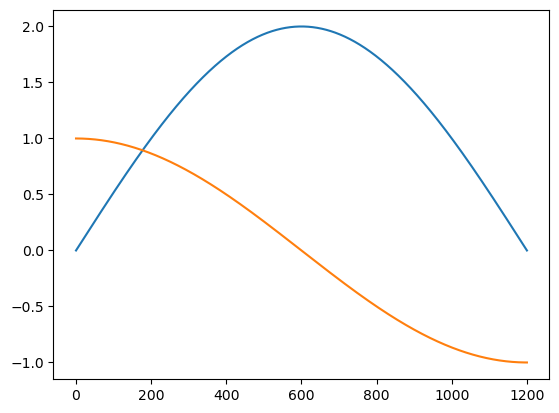

In [33]:
plt.figure()
plt.plot(P)
plt.plot(Z)

Text(0.5, 1.0, 'Input form \n $V=16.76, S=34.69$, $\\mathcal{V}=$$0.87$')

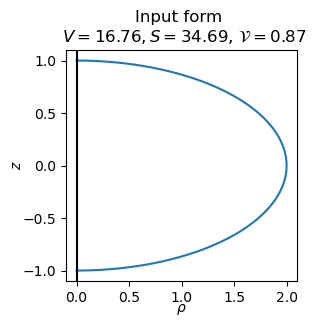

In [34]:
# %matplotlib notebook

Vol0,Sqr0,V_cal0 = get_VolSqr(P_fur, Z_fur)


plt.figure(figsize=(3,3))
plt.plot(P, Z,lw=1.5, ms=8, color = 'C0')
plt.axis('scaled')

plt.axvline(0, color='k')
plt.xlabel(r'$\rho$', labelpad=-2)
plt.ylabel(r'$z$', labelpad=-1)
plt.title(fr'Input form '+'\n'+fr' $V={Vol0:.2f}, S={Sqr0:.2f}$, '+r'$\mathcal{V}=$'+fr'${V_cal0:.2f}$')

In [53]:
H,force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 


### force function

In [31]:
def get_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4):
    V = np.sqrt(P1**2+Z1**2)
    H1 = H1_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
    H2 = H2_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
    H2[0] = H1[0];H2[-1] = H1[-1]
    
    
    K = H1*H2
    H = H1+H2
    
    laplH1 = laplH1_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
    laplH1[0] = 2*(-P1[0]**2*Z4[0]+4*P1[0]*P3[0]*Z2[0]+3*Z2[0]**3)/np.abs(P1[0])**5/P1[0]
    laplH1[-1] = 2*(-P1[-1]**2*Z4[-1]+4*P1[-1]*P3[-1]*Z2[-1]+3*Z2[-1]**3)/np.abs(P1[-1])**5/P1[-1]
    
    laplH2 = laplH2_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
    laplH2[0]=laplH1[0]/3
    laplH2[-1]=laplH1[-1]/3
    
    laplH = laplH1+laplH2
    
    force =  H**3/2 - 2*H*K + laplH
    return force

def get_force_from_ar(P_fur, Z_fur):
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    return get_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4)

In [32]:
def get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4):
    V = np.sqrt(P1**2+Z1**2)
    H1 = H1_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
    H2 = H2_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
    H2[0] = H1[0];H2[-1] = H1[-1]
    
    
    K = H1*H2
    H = H1+H2
    
    laplH1 = laplH1_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
    laplH1[0] = 2*(-P1[0]**2*Z4[0]+4*P1[0]*P3[0]*Z2[0]+3*Z2[0]**3)/np.abs(P1[0])**5/P1[0]
    laplH1[-1] = 2*(-P1[-1]**2*Z4[-1]+4*P1[-1]*P3[-1]*Z2[-1]+3*Z2[-1]**3)/np.abs(P1[-1])**5/P1[-1]
    
    laplH2 = laplH2_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
    laplH2[0]=laplH1[0]/3
    laplH2[-1]=laplH1[-1]/3
    
    laplH = laplH1+laplH2
    
    force =  H**3/2 - 2*H*K + laplH
    return H, force

def get_H_force_from_ar(P_fur, Z_fur):
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    return get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4)

In [33]:
def get_H12(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4):
    V = np.sqrt(P1**2+Z1**2)
    H1 = H1_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
    H2 = H2_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
    H2[0] = H1[0];H2[-1] = H1[-1]
    return H1, H2

def get_H12_from_ar(P_fur, Z_fur):
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    return get_H12(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4)

In [34]:
def get_a_H(P_fur, Z_fur):
    H1,H2 = get_H12_from_ar(P_fur, Z_fur)
    return 1/(np.sqrt(H1**2+H2**2))

### Normal delta

In [18]:
def get_normal_delta_PZ(P_fur, Z_fur, normal_delta_fur):
    normal_delta = get_int_field(normal_delta_fur)
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)    
    V = np.sqrt(P1**2+Z1**2)  
    
    normal_delta_P = get_int_field(normal_delta_fur)*(-Z1/V)
    normal_delta_Z = get_int_field(normal_delta_fur)*(P1/V)
    
    return normal_delta_P,normal_delta_Z

def get_normal_delta_PZ_fur(P_fur, Z_fur, normal_delta_fur):
    normal_delta_P,normal_delta_Z = get_normal_delta_PZ(P_fur, Z_fur, normal_delta_fur)
    normal_delta_P_fur = np.real(np.fft.rfft(get_ext_array(normal_delta_P, 'p'), norm='forward')[:n_int]/(-1j))
    normal_delta_Z_fur = np.fft.rfft(get_ext_array(normal_delta_Z, 'z'), norm='forward')[:n_int].real
    return normal_delta_P_fur, normal_delta_Z_fur

In [19]:
def get_H1_dl_H1_from_ar(P_fur, Z_fur):
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    H1 = P2*Z1-P1*Z2
    H1 /= V**3
    
    dl_H1 = (P3*Z1-Z3*P1)/V**4-3*H1*(P1*P2+Z1*Z2)/V**3
    return H1,dl_H1

### Derivatives of functionals

In [24]:
def get_Energy(P_fur, Z_fur):
    """
    Find Helfrih enegry of shape
    """
    ### find fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)    
    V = np.sqrt(P1**2+Z1**2) 
   
    H,force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4)
    
    energy = H*H*P*V/2 ### density whitout 2pi###
    
    enegry_fur = 1j*np.fft.rfft(get_ext_array(energy,'p'), norm='forward')
    Energy = 8*(enegry_fur.real/np.arange(enegry_fur.shape[0]))[1::2].sum()
    return Energy

In [25]:
def get_VolSqr(P_fur, Z_fur):
    """
    Find Volume and Square of the membrane
    """
    
    ### find fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)    
    V = np.sqrt(P1**2+Z1**2) 
   
    
    vol = -P*P*Z1/2 ### density without 2pi###
    vol_fur = 1j*np.fft.rfft(get_ext_array(vol,'p'), norm='forward')
    Vol = 8*(vol_fur.real/np.arange(vol.shape[0]))[1::2].sum()
    
    sqr = V*P ### density without 2pi###
    sqr_fur = 1j*np.fft.rfft(get_ext_array(sqr,'p'), norm='forward')
    Sqr = 8*(sqr_fur.real/np.arange(sqr.shape[0]))[1::2].sum()
    
    return np.array((Vol,Sqr))

In [26]:
### Scalar prodact ###
Phi_zrho_km = np.load('Phi_zrho_km.npy')

$$
\delta \mathcal{F} =-2\pi \int f_{\kappa } \cdot (\mathbf{l,\delta \psi }) \ \rho vd\tau 
$$

In [27]:
def get_force_proj_N(P,P1,Z,Z1, force, N_ext_basis):
    """
    Find projection force on l*varphi_k basis functions
    """
    V = np.sqrt(P1**2+Z1**2)
    
    ### N part ###
    den = (P* V)*force
    
    den_fur = (1j*np.fft.rfft(get_ext_array(den,'p'), norm='forward')).real[1:800]
    force_N_proj = Phi_zrho_km[:N_ext_basis,:den_fur.shape[0]] @ den_fur
    
    return force_N_proj

$$
\delta V\ =\ 2\pi \int (\mathbf{l,\delta \psi }) \ vPd\tau =\int (\mathbf{l,\delta \psi }) \ dS
$$

In [28]:
def get_Var_Vol_proj_N(P,P1,Z,Z1, N_ext_basis):
    """
    Find projection Vol on l*varphi_k basis functions
    """
    V = np.sqrt(P1**2+Z1**2)
    
    ### N part ###
    den = (P*V)
    den_fur = (1j*np.fft.rfft(get_ext_array(den,'p'), norm='forward')).real[1:800]
    Vol_N_proj = Phi_zrho_km[:N_ext_basis,:den_fur.shape[0]] @ den_fur
    
    return Vol_N_proj

In [29]:
def get_Var_Sqr_proj_N(P,P1,Z,Z1,H, N_ext_basis):
    """
    Find projection Vol on l*varphi_k basis functions
    """
    V = np.sqrt(P1**2+Z1**2)
    
    ### N part ###
    den = (P*V*H)
    den_fur = (1j*np.fft.rfft(get_ext_array(den,'p'), norm='forward')).real[1:800]
    Sqr_N_proj = Phi_zrho_km[:N_ext_basis,:den_fur.shape[0]] @ den_fur
    
    return Sqr_N_proj

## Reparametrization to constant velocity

In [30]:
def make_constant_v_repar(P_fur, Z_fur, N_proj=30):
    """
    Find reparametrization with constan V
    """
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    
    Der_goal_fft = np.fft.rfft(get_ext_array(V), norm='forward')
    Der_goal_fft /= Der_goal_fft[0]
    
    der_oper = 1j*np.pi*np.arange(Der_goal_fft.shape[0])
    Tau_s_goal_fur = Der_goal_fft.real/der_oper
    Tau_s_goal_fur[0]=0.
    
    Tau_s_goal_norm = np.fft.irfft(Tau_s_goal_fur, norm='forward', n=2*N_int)[:N_int+1]

    Tau_s_goal = Tau_int+Tau_s_goal_norm

    P_s_spline =sc.interpolate.make_interp_spline(Tau_s_goal,P,k=7,bc_type=(
        [(2, 0.0),(4, 0.0),(6, 0.0)], 
        [(2, 0.0),(4, 0.0),(6, 0.0)]))
    P_s = P_s_spline(Tau_int)

    Z_s_spline =sc.interpolate.make_interp_spline(Tau_s_goal,Z,k=7,bc_type=(
        [(1, 0.0),(3, 0.0),(5, 0.0)], 
        [(1, 0.0),(3, 0.0),(5, 0.0)]))
    Z_s = Z_s_spline(Tau_int)

    P_s_fft = np.fft.rfft(get_ext_array(P_s,'p'),norm='forward')
    Z_s_fft = np.fft.rfft(get_ext_array(Z_s,'z'),norm='forward')

    P_fur0_s = np.zeros(N_proj)
    Z_fur0_s = np.zeros(N_proj)

    P_fur0_s[:N_proj] = -P_s_fft.imag[:N_proj]
    Z_fur0_s[:N_proj] =  Z_s_fft.real[:N_proj]    
    return P_fur0_s,Z_fur0_s

In [31]:
def make_F_v_repar(P_fur, Z_fur, F,N_proj=30):
    """
    Find reparametrization with constan V
    """
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    
    Der_goal_fft = np.fft.rfft(get_ext_array(V/F), norm='forward')
    Der_goal_fft /= Der_goal_fft[0]
    
    der_oper = 1j*np.pi*np.arange(Der_goal_fft.shape[0])
    Tau_s_goal_fur = Der_goal_fft.real/der_oper
    Tau_s_goal_fur[0]=0.
    
    Tau_s_goal_norm = np.fft.irfft(Tau_s_goal_fur, norm='forward', n=2*N_int)[:N_int+1]

    Tau_s_goal = Tau_int+Tau_s_goal_norm

    P_s_spline =sc.interpolate.make_interp_spline(Tau_s_goal,P,k=7,bc_type=(
        [(2, 0.0),(4, 0.0),(6, 0.0)], 
        [(2, 0.0),(4, 0.0),(6, 0.0)]))
    P_s = P_s_spline(Tau_int)

    Z_s_spline =sc.interpolate.make_interp_spline(Tau_s_goal,Z,k=7,bc_type=(
        [(1, 0.0),(3, 0.0),(5, 0.0)], 
        [(1, 0.0),(3, 0.0),(5, 0.0)]))
    Z_s = Z_s_spline(Tau_int)

    P_s_fft = np.fft.rfft(get_ext_array(P_s,'p'),norm='forward')
    Z_s_fft = np.fft.rfft(get_ext_array(Z_s,'z'),norm='forward')

    P_fur0_s = np.zeros(N_proj)
    Z_fur0_s = np.zeros(N_proj)

    P_fur0_s[:N_proj] = -P_s_fft.imag[:N_proj]
    Z_fur0_s[:N_proj] =  Z_s_fft.real[:N_proj]    
    return P_fur0_s,Z_fur0_s

$$
\tau_s(\tau)\implies \tau_s' =C\cdot V
$$

In [54]:
P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur0)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur0)
V = np.sqrt(P1**2+Z1**2)

In [55]:
Der_goal_fft = np.fft.rfft(get_ext_array(V), norm='forward')

In [56]:
Der_goal_fft /= Der_goal_fft[0]

(0.0, 100.0)

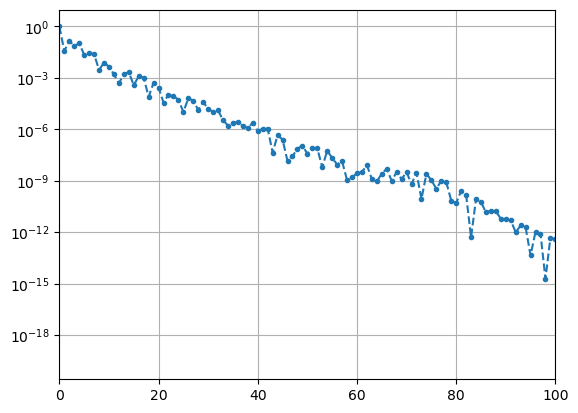

In [57]:
plt.figure()
plt.plot(abs(Der_goal_fft),'.--')
plt.grid()
plt.yscale('log')
plt.xlim(0,100)

In [58]:
der_oper = 1j*np.pi*np.arange(Der_goal_fft.shape[0])
Tau_s_goal_fur = Der_goal_fft.real/der_oper
Tau_s_goal_fur[0]=0.

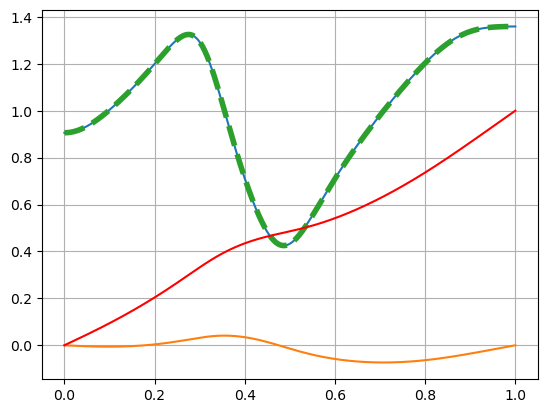

In [59]:
Der_goal_norm = np.fft.irfft(Der_goal_fft, norm='forward', n=2*N_int)[:N_int+1]
Tau_s_goal_norm = np.fft.irfft(Tau_s_goal_fur, norm='forward', n=2*N_int)[:N_int+1]

plt.figure()
plt.plot(Tau_int,Der_goal_norm)
plt.plot(Tau_int,Tau_s_goal_norm)
plt.plot(Tau_int[1:],1+N_int*(Tau_s_goal_norm[1:]-Tau_s_goal_norm[:-1]),'--', lw=4)
plt.plot(Tau_int,Tau_int+Tau_s_goal_norm, color='red')
plt.grid()

In [60]:
Tau_s_goal = Tau_int+Tau_s_goal_norm

<IPython.core.display.Javascript object>


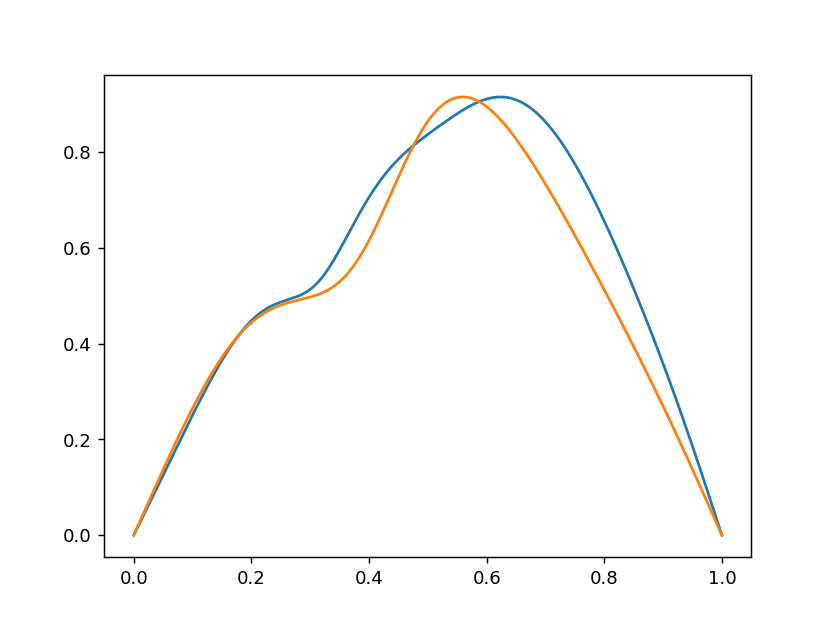

<IPython.core.display.Javascript object>


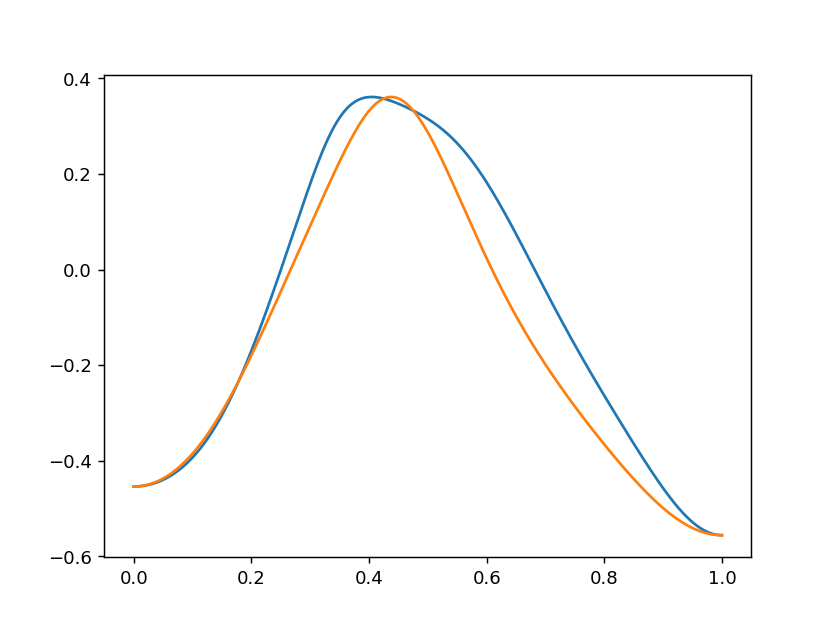

In [214]:
plt.figure()
plt.plot(Tau_int, P)
plt.plot(Tau_s_goal, P)

plt.figure()
plt.plot(Tau_int, Z)
plt.plot(Tau_s_goal, Z)

## linear analys

In [634]:
%matplotlib inline
@interact(k=(0,N))
def plot_delta_P(k):
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1/50
    delta_P = get_int_field(delta_P_fur*(-1j))
    plt.figure()
    plt.plot(P,Z,'--')
    plt.plot(P+delta_P, Z)

interactive(children=(IntSlider(value=50, description='k'), Output()), _dom_classes=('widget-interact',))

In [635]:
%matplotlib inline
@interact(k=(0,N))
def plot_delta_Z(k):
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1/50
    delta_Z = get_int_field(delta_Z_fur)
    plt.figure()
    plt.plot(P,Z,'--')
    plt.plot(P, Z+delta_Z)

interactive(children=(IntSlider(value=50, description='k'), Output()), _dom_classes=('widget-interact',))

In [636]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_force_delta_P(k):
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1/50
    H,force = get_H_force_from_ar(P_fur, Z_fur)
    H_,force_ = get_H_force_from_ar(P_fur+delta_P_fur, Z_fur)
    dH = H_-H; dforce = force_-force
    plt.figure()
    plt.plot(dH)
    plt.plot(dforce)

interactive(children=(IntSlider(value=49, description='k', max=99), Output()), _dom_classes=('widget-interact'…

In [1008]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_force_delta_Z(k):
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1/50
    H,force = get_H_force_from_ar(P_fur, Z_fur)
    H_,force_ = get_H_force_from_ar(P_fur, Z_fur+delta_Z_fur)
    dH = H_-H; dforce = force_-force
    plt.figure()
    plt.plot(dH)
    plt.plot(dforce)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1026]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_force_delta_P(k):
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1/1000
    H,force = get_H_force_from_ar(P_fur, Z_fur)
    H_,force_ = get_H_force_from_ar(P_fur+delta_P_fur, Z_fur)
    dH = H_-H; dforce = force_-force
    plt.figure()
    plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.vlines(k,0,1e1, color='red')
    plt.xlim(0, 3*N)
    plt.yscale('log')
    plt.ylim(1e-8, 1e2)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1028]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_force_delta_Z(k):
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-4
    H,force = get_H_force_from_ar(P_fur, Z_fur)
    H_,force_ = get_H_force_from_ar(P_fur, Z_fur+delta_Z_fur)
    dH = H_-H; dforce = force_-force
    plt.figure()
    plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.vlines(k,0,1e1, color='red')
    plt.xlim(0, 3*N)
    plt.yscale('log')
    plt.ylim(1e-8, 1e2)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1076]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_velo_delta_P(k):
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-4
    
    v_P_fur, v_Z_fur = get_velo_h_fur_full(P_fur, Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_h_fur_full(P_fur+delta_P_fur, Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur), '.--')
    plt.plot(np.abs(dv_Z_fur), '.--')
    plt.vlines(k,0,1e1, color='red')
    plt.vlines(N-1,0,1e1, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-6, 1e1)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1126]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_velo_delta_Z(k):
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-3
    
    v_P_fur, v_Z_fur = get_velo_h_fur_full(P_fur, Z_fur-delta_Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_h_fur_full(P_fur, Z_fur+delta_Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/delta_Z_fur[k], 'o')
    plt.plot(np.abs(dv_Z_fur)/delta_Z_fur[k], 'o')
    
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-5
    
    v_P_fur, v_Z_fur = get_velo_h_fur_full(P_fur, Z_fur-delta_Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_h_fur_full(P_fur, Z_fur+delta_Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/delta_Z_fur[k], '.')
    plt.plot(np.abs(dv_Z_fur)/delta_Z_fur[k], '.')
    
    
    plt.vlines(k,0,1e3, color='red')
    plt.vlines(N-1,0,1e3, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-2, 1e4)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1128]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_div_velo_delta_P(k):
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-4
    
    div_v_fur = get_div_v_force_fur(P_fur-delta_P_fur, Z_fur)
    div_v_fur_ = get_div_v_force_fur(P_fur+delta_P_fur, Z_fur)
    ddiv_v_fur = div_v_fur_ - div_v_fur;
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(ddiv_v_fur)/np.abs(ddiv_v_fur).max(), 'o')
    
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-5
    
    div_v_fur = get_div_v_force_fur(P_fur-delta_P_fur, Z_fur)
    div_v_fur_ = get_div_v_force_fur(P_fur+delta_P_fur, Z_fur)
    ddiv_v_fur = div_v_fur_ - div_v_fur;
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(ddiv_v_fur)/np.abs(ddiv_v_fur).max(), '.')
    
    plt.vlines(k,0,1e1, color='red')
    plt.vlines(N-1+N_ext_sigma,0,1e1, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-6, 1e1)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1129]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_div_velo_delta_Z(k):
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-4
    
    div_v_fur = get_div_v_force_fur(P_fur, Z_fur-delta_Z_fur)
    div_v_fur_ = get_div_v_force_fur(P_fur, Z_fur+delta_Z_fur)
    ddiv_v_fur = div_v_fur_ - div_v_fur;
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(ddiv_v_fur)/np.abs(ddiv_v_fur).max(), 'o')
    
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-5
    
    div_v_fur = get_div_v_force_fur(P_fur, Z_fur-delta_Z_fur)
    div_v_fur_ = get_div_v_force_fur(P_fur, Z_fur+delta_Z_fur)
    ddiv_v_fur = div_v_fur_ - div_v_fur;
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(ddiv_v_fur)/np.abs(ddiv_v_fur).max(), '.')
    
    plt.vlines(k,0,1e1, color='red')
    plt.vlines(N-1+N_ext_sigma,0,1e1, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-6, 1e1)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1079]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_div_velo_delta_P(k):
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=2e-5
    
    div_v_fur = get_div_v_force_fur_by_velo(P_fur, Z_fur)
    div_v_fur_ = get_div_v_force_fur_by_velo(P_fur+delta_P_fur, Z_fur)
    ddiv_v_fur = div_v_fur_ - div_v_fur;
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(ddiv_v_fur), '.--')
    plt.vlines(k,0,1e1, color='red')
    plt.vlines(N-1,0,1e1, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-6, 1e1)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1131]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_sigma_delta_P(k):
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-3
    
    sigma_fur = get_sigma_fur_from_arr(P_fur-delta_P_fur, Z_fur)
    sigma_fur_ = get_sigma_fur_from_arr(P_fur+delta_P_fur, Z_fur)
    dsigma_fur = sigma_fur_ - sigma_fur;
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dsigma_fur)/np.abs(dsigma_fur).max(), 'o')
    
    
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-5
    
    sigma_fur = get_sigma_fur_from_arr(P_fur-delta_P_fur, Z_fur)
    sigma_fur_ = get_sigma_fur_from_arr(P_fur+delta_P_fur, Z_fur)
    dsigma_fur = sigma_fur_ - sigma_fur;
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dsigma_fur)/np.abs(dsigma_fur).max(), '.')    
    
    plt.vlines(k,0,1e1, color='red')
    plt.vlines(N-1,0,1e1, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-5, 2e0)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1133]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_sigma_delta_Z(k):
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-3
    
    sigma_fur = get_sigma_fur_from_arr(P_fur, Z_fur-delta_Z_fur)
    sigma_fur_ = get_sigma_fur_from_arr(P_fur, Z_fur+delta_Z_fur)
    dsigma_fur = sigma_fur_ - sigma_fur;
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dsigma_fur)/np.abs(dsigma_fur).max(), 'o')
    
    
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-5
    
    sigma_fur = get_sigma_fur_from_arr(P_fur, Z_fur-delta_Z_fur)
    sigma_fur_ = get_sigma_fur_from_arr(P_fur, Z_fur+delta_Z_fur)
    dsigma_fur = sigma_fur_ - sigma_fur;
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dsigma_fur)/np.abs(dsigma_fur).max(), '.')    
    
    plt.vlines(k,0,1e1, color='red')
    plt.vlines(N-1+N_ext_sigma,0,1e1, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-5, 2e0)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1134]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_velo_delta_P(k):
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-3
    
    v_P_fur, v_Z_fur = get_velo_fur_full(P_fur-delta_P_fur, Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_fur_full(P_fur+delta_P_fur, Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/np.abs(dv_P_fur).max(), 'o')
    plt.plot(np.abs(dv_Z_fur)/np.abs(dv_Z_fur).max(), 'o')
    
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-5
    
    v_P_fur, v_Z_fur = get_velo_fur_full(P_fur-delta_P_fur, Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_fur_full(P_fur+delta_P_fur, Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/np.abs(dv_P_fur).max(), '.')
    plt.plot(np.abs(dv_Z_fur)/np.abs(dv_Z_fur).max(), '.')    

    
    plt.vlines(k,0,1e1, color='red')
    plt.vlines(N-1,0,1e1, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-5, 2e0)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1137]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_velo_delta_Z(k):
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-3
    
    v_P_fur, v_Z_fur = get_velo_fur_full(P_fur, Z_fur-delta_Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_fur_full(P_fur, Z_fur+delta_Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/delta_Z_fur[k], 'o')
    plt.plot(np.abs(dv_Z_fur)/delta_Z_fur[k], 'o')
    
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-5
    
    v_P_fur, v_Z_fur = get_velo_fur_full(P_fur, Z_fur-delta_Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_fur_full(P_fur, Z_fur+delta_Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/delta_Z_fur[k], '.')
    plt.plot(np.abs(dv_Z_fur)/delta_Z_fur[k], '.')    

    
    plt.vlines(k,0,1e3, color='red')
    plt.vlines(N-1,0,1e3, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-3, 2e3)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1139]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_velo_normal_delta_P(k):
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-3
    
    v_P_fur, v_Z_fur = get_velo_normal_fur_full(P_fur-delta_P_fur, Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_normal_fur_full(P_fur+delta_P_fur, Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/np.abs(dv_P_fur).max(), 'o')
    plt.plot(np.abs(dv_Z_fur)/np.abs(dv_Z_fur).max(), 'o')
    
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-5
    
    v_P_fur, v_Z_fur = get_velo_normal_fur_full(P_fur-delta_P_fur, Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_normal_fur_full(P_fur+delta_P_fur, Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/np.abs(dv_P_fur).max(), '.')
    plt.plot(np.abs(dv_Z_fur)/np.abs(dv_Z_fur).max(), '.')    

    
    plt.vlines(k,0,1e1, color='red')
    plt.vlines(N-1,0,1e1, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-5, 2e0)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1140]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_velo_normal_delta_Z(k):
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-3
    
    v_P_fur, v_Z_fur = get_velo_normal_fur_full(P_fur, Z_fur-delta_Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_normal_fur_full(P_fur, Z_fur+delta_Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/delta_Z_fur[k], 'o')
    plt.plot(np.abs(dv_Z_fur)/delta_Z_fur[k], 'o')
    
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-5
    
    v_P_fur, v_Z_fur = get_velo_normal_fur_full(P_fur, Z_fur-delta_Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_normal_fur_full(P_fur, Z_fur+delta_Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/delta_Z_fur[k], '.')
    plt.plot(np.abs(dv_Z_fur)/delta_Z_fur[k], '.')    

    
    plt.vlines(k,0,1e3, color='red')
    plt.vlines(N-1,0,1e3, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-3, 2e3)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [36]:
def get_normal_delta_PZ(P_fur, Z_fur, normal_delta_fur):
    normal_delta = get_int_field(normal_delta_fur)
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)    
    V = np.sqrt(P1**2+Z1**2)  
    
    normal_delta_P = get_int_field(normal_delta_fur)*(-Z1/V)
    normal_delta_Z = get_int_field(normal_delta_fur)*(P1/V)
    
    return normal_delta_P,normal_delta_Z

def get_normal_delta_PZ_fur(P_fur, Z_fur, normal_delta_fur):
    normal_delta_P,normal_delta_Z = get_normal_delta_PZ(P_fur, Z_fur, normal_delta_fur)
    normal_delta_P_fur = np.real(np.fft.rfft(get_ext_array(normal_delta_P, 'p'), norm='forward')[:n_int]/(-1j))
    normal_delta_Z_fur = np.fft.rfft(get_ext_array(normal_delta_Z, 'z'), norm='forward')[:n_int].real
    return normal_delta_P_fur, normal_delta_Z_fur

In [37]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_delta_n(k):
    normal_delta_fur = np.zeros(N)
    normal_delta_fur[k] = 1/50
    normal_delta_P,normal_delta_Z = get_normal_delta_PZ(P_fur, Z_fur, normal_delta_fur)
    plt.figure()
    plt.plot(P,Z,'--')
    plt.plot(P+normal_delta_P, Z+normal_delta_Z)

interactive(children=(IntSlider(value=17, description='k', max=35), Output()), _dom_classes=('widget-interact'…

### Jacibian

In [93]:
def get_velo_h_fur_1d(pz):
    P_fur = np.zeros(N)
    P_fur[1:N]=pz[:N-1]
    Z_fur = pz[N-1:]
    veloP, veloZ = get_velo_fur(P_fur, Z_fur)
    return np.concatenate([veloP[1:N], veloZ])

In [94]:
import numdifftools as nd

In [95]:
jfun_h = nd.Jacobian(get_velo_h_fur_1d, step=5e-5)

jac_h = jfun_h(np.concatenate([P_fur[1:N],Z_fur]))

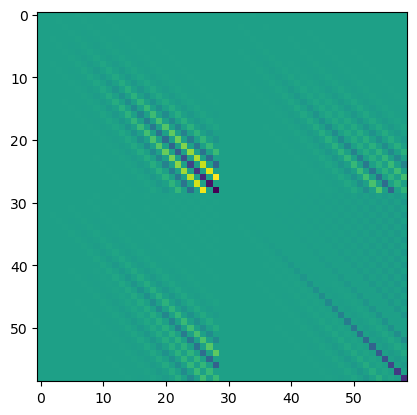

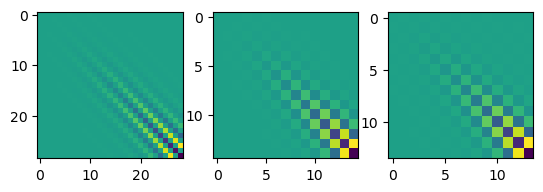

<Figure size 640x480 with 0 Axes>

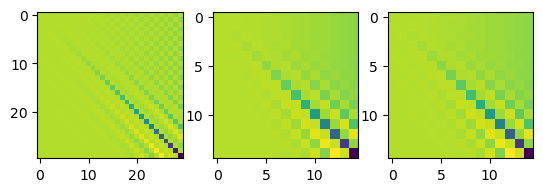

In [106]:
plt.figure()
plt.imshow(jac_h)

fig, axs = plt.subplots(1,3)

axs[0].imshow(jac_h[:N-1,:N-1])
axs[1].imshow(jac_h[:N-1:2,:N-1:2])
axs[2].imshow(jac_h[1:N-1:2,1:N-1:2])


plt.figure()

fig, axs = plt.subplots(1,3)

axs[0].imshow(jac_h[N-1:,N-1:])
axs[1].imshow(jac_h[N-1::2,N-1::2])
axs[2].imshow(jac_h[N::2,N::2])


In [107]:
w_full,vr_full =sc.linalg.eig(jac_h)
w_full_real = w_full[np.abs(np.imag(w_full))<1e-4]
w_full_real = np.real(w_full_real)
np.sort(w_full_real)

array([-3.37115201e+03, -3.00567591e+03, -1.93465075e+03, -1.70992544e+03,
       -1.30564644e+03, -1.15125632e+03, -9.77507582e+02, -8.60879550e+02,
       -7.63220408e+02, -6.66613949e+02, -5.82963317e+02, -5.01731514e+02,
       -4.28879376e+02, -3.62758443e+02, -3.03810325e+02, -2.51569136e+02,
       -2.05658038e+02, -1.65692284e+02, -1.31225515e+02, -1.01908281e+02,
       -7.72396877e+01, -5.69489573e+01, -4.04194458e+01, -2.75489394e+01,
       -1.74816975e+01, -1.04514687e+01, -5.16084870e+00, -2.41078239e+00,
       -1.63707808e-01, -1.14997330e-01, -1.11189896e-01, -1.06870955e-01,
       -1.03429510e-01, -1.00446209e-01, -9.00773186e-02, -7.86008956e-02,
       -7.46405435e-02, -7.45361614e-02, -6.83650706e-02, -6.58347351e-02,
       -6.31650784e-02, -6.27768866e-02, -5.96727931e-02, -5.93780973e-02,
       -3.99005038e-02, -2.76739755e-02,  0.00000000e+00])

In [113]:
w_full[np.abs(np.imag(w_full))>1e-4]

array([-0.28625584+0.29425344j, -0.28625584-0.29425344j,
        0.23197408+0.27015078j,  0.23197408-0.27015078j,
       -0.19400544+0.12826692j, -0.19400544-0.12826692j,
       -0.2640882 +0.19257342j, -0.2640882 -0.19257342j,
        0.0028257 +0.0839935j ,  0.0028257 -0.0839935j ,
       -0.08505429+0.00425514j, -0.08505429-0.00425514j])

<IPython.core.display.Javascript object>


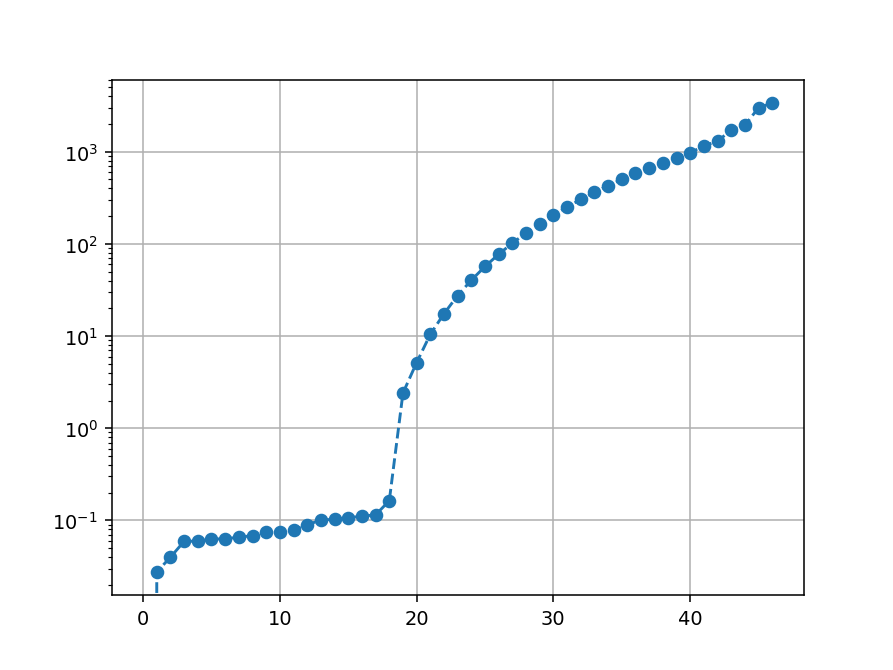

In [110]:
%matplotlib notebook
plt.figure()
plt.plot(-np.sort(w_full_real)[::-1],'o--')

plt.grid()
plt.axhline(0, color='k')
#plt.ylim(-1,10)
plt.yscale('log')

<IPython.core.display.Javascript object>


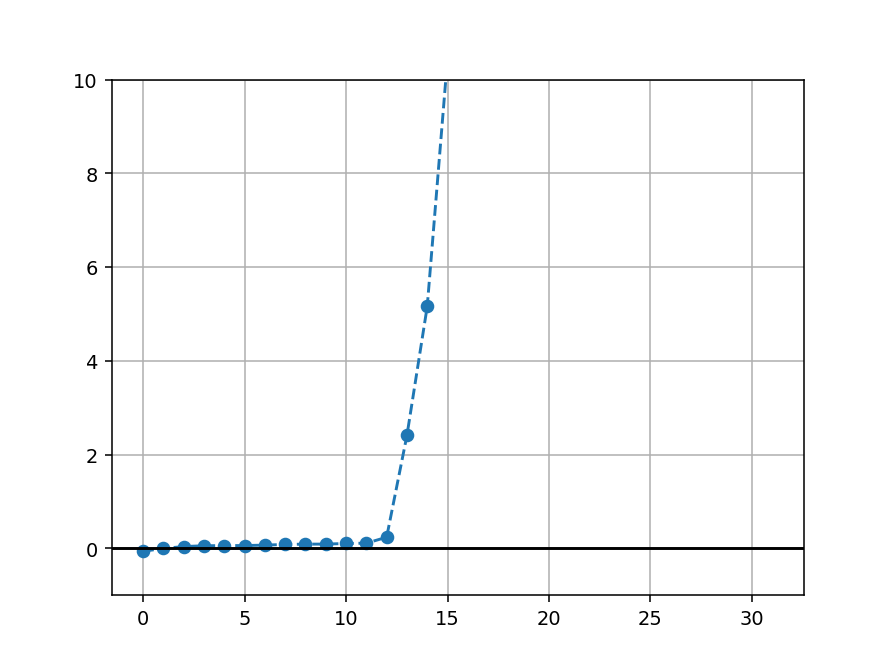

(-1.0, 10.0)

In [191]:
%matplotlib notebook
plt.figure()
plt.plot(-np.sort(w_full_real)[::-1],'o--')
plt.grid()
plt.axhline(0, color='k')
plt.ylim(-1,10)

In [111]:
%matplotlib inline
@interact_manual(m=(0,50))
def plot_eig_j(m):
    plt.figure()
    
    w_m = (np.sort(w_full_real)[::-1])[m]
    plt.title(f'w={w_m}')
    index_m = np.argmin(np.abs(w_full - w_m))
    print(w_full[index_m])
    v_m = np.real(vr_full[:, index_m])
    plt.plot(w_m*v_m,'.--')
    plt.plot(Div_v_sum_oper_fur[:N,:N] @ v_m,'o--')
    
#     v_tau = get_P_with0(v_m[:N-1])*P1_ar_j + v_m[N-1:]*Z1_ar_j
#     v_tau /= V_ar_j
    
#     v_n = -Z1_ar_j*get_P_with0(v_m[:N-1]) + P1_ar_j*v_m[N-1:]
#     v_n /= V_ar_j
#     plt.figure()
#     plt.plot(v_n, 'o--',label=r'$v_n$')
#     plt.plot(v_tau, 'o--',label=r'$v_\tau$')
#     plt.legend()

interactive(children=(IntSlider(value=25, description='m', max=50), Button(description='Run Interact', style=B…

### Jacobian with normal delta

In [612]:
P, P1,P2,P3,P4 = get_int_fields(get_ext_array(P_ar, 'p'))
P[0]=0; P[-1]=0; P2[0]=0;P2[-1]=0; P4[0]=0;P4[-1]=0;
Z, Z1,Z2,Z3,Z4 = get_int_fields(get_ext_array(Z_ar, 'z'))
Z1[0]=0; Z1[-1]=0; Z3[0]=0;Z3[-1]=0

V = np.sqrt(P1**2+Z1**2)

In [613]:
P1_ar = P1[::N_int//N]
Z1_ar = Z1[::N_int//N]
V_ar = V[::N_int//N]

In [614]:
P1_int = P1[::N_int//n_int]
Z1_int = Z1[::N_int//n_int]
V_int = V[::N_int//n_int]

$$
\mathbf{\tau }  =\frac{1}{v}  \begin{pmatrix}
P_{\tau } & Z_{\tau }
\end{pmatrix} , \mathbf{l}  = \frac{1}{v}\begin{pmatrix}
-Z_{\tau } & P_{\tau }
\end{pmatrix}
$$


In [615]:
def get_velo_h_normal(delta_n):
    delta_P_ar = delta_n*(-Z1_ar/V_ar)
    delta_Z_ar = delta_n*(P1_ar/V_ar)
    
    velo_h_rho, velo_h_z = get_velo_h(P_ar+delta_P_ar, Z_ar+delta_Z_ar)
    velo_h_rho_filt = get_N_field(get_ext_array(velo_h_rho,'p'))
    velo_h_z_filt = get_N_field(get_ext_array(velo_h_z,'z'))
    
    velo_norm = -Z1_ar/V_ar* velo_h_rho_filt + P1_ar/V_ar* velo_h_z_filt
    return velo_norm

In [616]:
def get_velo_h_normal_full(delta_n):
    delta_P_ar = delta_n*(-Z1_ar/V_ar)
    delta_Z_ar = delta_n*(P1_ar/V_ar)
    
    velo_h_rho, velo_h_z = get_velo_h(P_ar+delta_P_ar, Z_ar+delta_Z_ar)
    print(velo_h_rho.shape)
    velo_norm = -Z1_int/V_int* velo_h_rho + P1_int/V_int* velo_h_z
    return velo_norm

In [320]:
import numdifftools as nd

In [321]:
jfun_h_n = nd.Jacobian(get_velo_h_normal, step=1e-6)

jac_h_n = jfun_h_n(np.zeros(N+1))

<IPython.core.display.Javascript object>


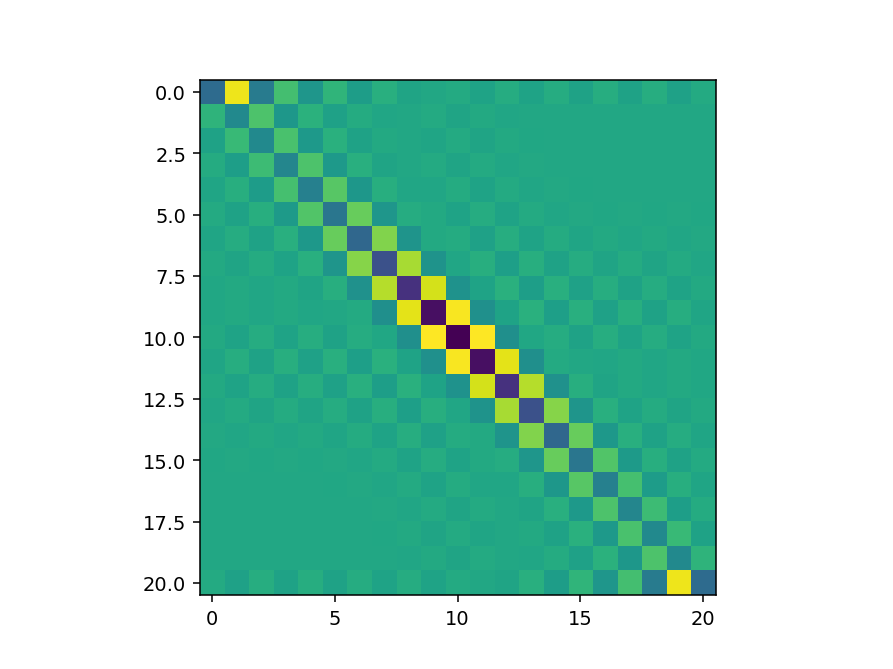

In [322]:
plt.figure()
plt.imshow(jac_h_n)

In [323]:
w_full,vr_full =sc.linalg.eig(jac_h_n)
print(w_full)
w_full_real = w_full[np.abs(np.imag(w_full))<1e-4]
w_full_real = np.real(w_full_real)
np.sort(w_full_real)

[-8.51447629e+02+0.j -7.05710411e+02+0.j -4.47296301e+02+0.j
 -3.63871903e+02+0.j -2.94132740e+02+0.j -2.48759865e+02+0.j
 -2.02552234e+02+0.j -1.65968456e+02+0.j -1.31006856e+02+0.j
 -1.01947257e+02+0.j -7.72321010e+01+0.j -5.69751092e+01+0.j
 -4.03983274e+01+0.j -2.75858364e+01+0.j -1.74177647e+01+0.j
 -1.05044805e+01+0.j -5.02963064e+00+0.j -2.48166229e+00+0.j
  3.73598783e-01+0.j -1.19779298e-01+0.j -3.43624093e-01+0.j]


array([-8.51447629e+02, -7.05710411e+02, -4.47296301e+02, -3.63871903e+02,
       -2.94132740e+02, -2.48759865e+02, -2.02552234e+02, -1.65968456e+02,
       -1.31006856e+02, -1.01947257e+02, -7.72321010e+01, -5.69751092e+01,
       -4.03983274e+01, -2.75858364e+01, -1.74177647e+01, -1.05044805e+01,
       -5.02963064e+00, -2.48166229e+00, -3.43624093e-01, -1.19779298e-01,
        3.73598783e-01])

In [274]:
w_full,vr_full =sc.linalg.eig(jac_h_n)
print(w_full)
w_full_real = w_full[np.abs(np.imag(w_full))<1e-4]
w_full_real = np.real(w_full_real)
np.sort(w_full_real)

[-8.51446040e+02+0.j -7.05709145e+02+0.j -4.47295506e+02+0.j
 -3.63871268e+02+0.j -2.94132249e+02+0.j -2.48759511e+02+0.j
 -2.02552000e+02+0.j -1.65968298e+02+0.j -1.31006754e+02+0.j
 -1.01947192e+02+0.j -7.72320629e+01+0.j -5.69750878e+01+0.j
 -4.03983165e+01+0.j -2.75858313e+01+0.j -1.74177625e+01+0.j
 -1.05044797e+01+0.j -5.02963046e+00+0.j -2.48166226e+00+0.j
  3.73598753e-01+0.j -1.19779315e-01+0.j -3.43624099e-01+0.j]


array([-8.51446040e+02, -7.05709145e+02, -4.47295506e+02, -3.63871268e+02,
       -2.94132249e+02, -2.48759511e+02, -2.02552000e+02, -1.65968298e+02,
       -1.31006754e+02, -1.01947192e+02, -7.72320629e+01, -5.69750878e+01,
       -4.03983165e+01, -2.75858313e+01, -1.74177625e+01, -1.05044797e+01,
       -5.02963046e+00, -2.48166226e+00, -3.43624099e-01, -1.19779315e-01,
        3.73598753e-01])

<IPython.core.display.Javascript object>


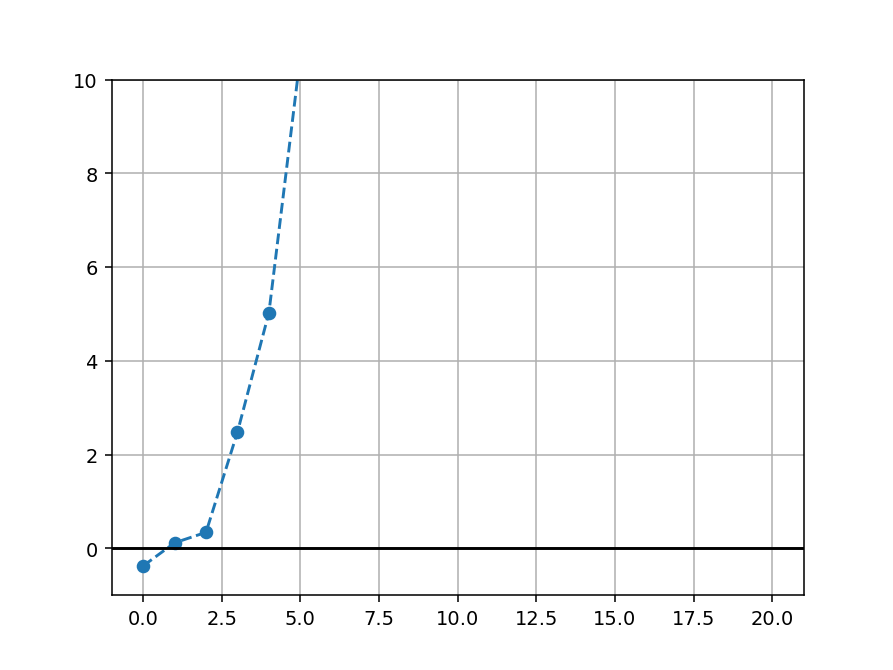

(-1.0, 10.0)

In [324]:
%matplotlib notebook
plt.figure()
plt.plot(-np.sort(w_full_real)[::-1],'o--')
# plt.plot(-np.sort(w_full_real_30_300)[::-1],'o--')

plt.grid()
plt.axhline(0, color='k')
plt.ylim(-1,10)

In [325]:
%matplotlib inline
@interact_manual(m=(0,50))
def plot_eig_j(m):
    plt.figure()
    
    w_m = (-np.sort(w_full_real)[::-1])[m]
    plt.title(f'w={w_m}')
    index_m = np.argmin(np.abs(w_full - w_m))
    v_m = np.real(vr_full[:, m])
    plt.plot(v_m,'.--')
    
#     v_tau = get_P_with0(v_m[:N-1])*P1_ar_j + v_m[N-1:]*Z1_ar_j
#     v_tau /= V_ar_j
    
#     v_n = -Z1_ar_j*get_P_with0(v_m[:N-1]) + P1_ar_j*v_m[N-1:]
#     v_n /= V_ar_j
#     plt.figure()
#     plt.plot(v_n, 'o--',label=r'$v_n$')
#     plt.plot(v_tau, 'o--',label=r'$v_\tau$')
#     plt.legend()
;

interactive(children=(IntSlider(value=25, description='m', max=50), Button(description='Run Interact', style=B…

''

<Figure size 640x480 with 0 Axes>

In [326]:
up_part = np.eye(N+1, dtype=int)
down_part = np.fliplr(np.eye(N+1, dtype=int))[1:-1]
extender_z = np.concatenate((up_part, down_part))
extender_p = np.concatenate((up_part, -down_part))

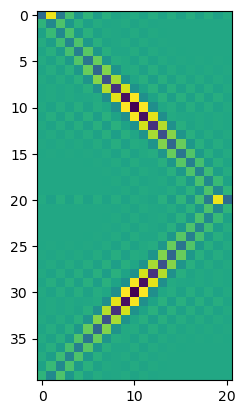

In [327]:
plt.figure()
plt.imshow(extender_z @ jac_h_n)

In [328]:
jac_h_n_fur = np.fft.rfft(extender_z @ jac_h_n, norm='forward', axis=0) @ np.fft.irfft(np.eye(N+1), axis=0, norm='forward', n=2*N)[:N+1,:]

In [274]:
w_full,vr_full =sc.linalg.eig(jac_h_n)
print(w_full)
w_full_real = w_full[np.abs(np.imag(w_full))<1e-4]
w_full_real = np.real(w_full_real)
np.sort(w_full_real)

[-8.51446040e+02+0.j -7.05709145e+02+0.j -4.47295506e+02+0.j
 -3.63871268e+02+0.j -2.94132249e+02+0.j -2.48759511e+02+0.j
 -2.02552000e+02+0.j -1.65968298e+02+0.j -1.31006754e+02+0.j
 -1.01947192e+02+0.j -7.72320629e+01+0.j -5.69750878e+01+0.j
 -4.03983165e+01+0.j -2.75858313e+01+0.j -1.74177625e+01+0.j
 -1.05044797e+01+0.j -5.02963046e+00+0.j -2.48166226e+00+0.j
  3.73598753e-01+0.j -1.19779315e-01+0.j -3.43624099e-01+0.j]


array([-8.51446040e+02, -7.05709145e+02, -4.47295506e+02, -3.63871268e+02,
       -2.94132249e+02, -2.48759511e+02, -2.02552000e+02, -1.65968298e+02,
       -1.31006754e+02, -1.01947192e+02, -7.72320629e+01, -5.69750878e+01,
       -4.03983165e+01, -2.75858313e+01, -1.74177625e+01, -1.05044797e+01,
       -5.02963046e+00, -2.48166226e+00, -3.43624099e-01, -1.19779315e-01,
        3.73598753e-01])

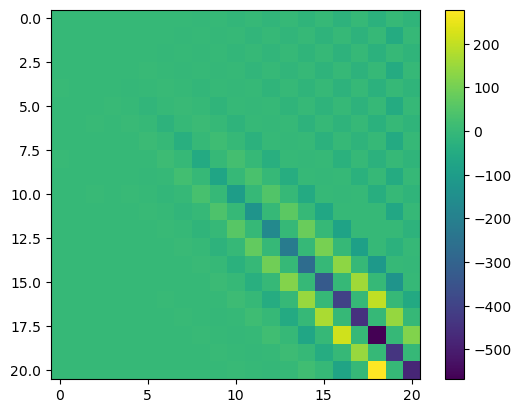

In [329]:
plt.figure()
plt.imshow(jac_h_n_fur.real)
plt.colorbar()

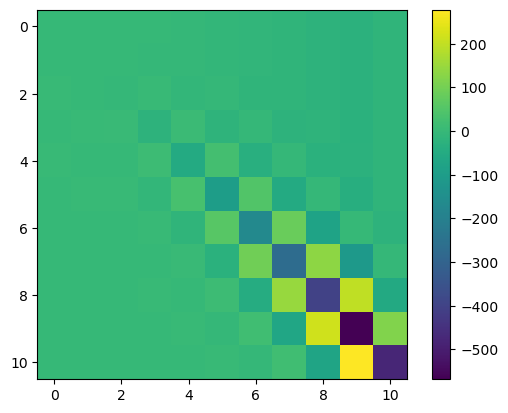

In [330]:
plt.figure()
plt.imshow(jac_h_n_fur.real[::2,::2])
plt.colorbar()

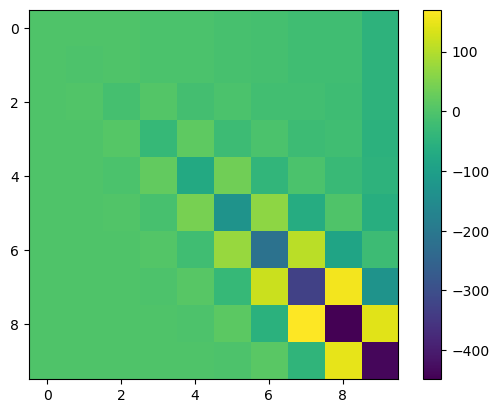

In [345]:
plt.figure()
plt.imshow(jac_h_n_fur.real[1::2,1::2])
plt.colorbar()

In [344]:
w_k,_ =sc.linalg.eig(jac_h_n_fur.real[::2,::2])
w_k.real

array([-8.51447629e+02, -4.47296301e+02, -2.94132740e+02, -2.02552234e+02,
       -1.31006856e+02, -7.72321010e+01, -4.03983274e+01, -1.74177647e+01,
       -5.02963064e+00,  3.73598783e-01, -1.19779298e-01])

In [348]:
w_k,_ =sc.linalg.eig(jac_h_n_fur.real[::2,::2][-9:,-9:])
w_k.real

array([-851.44775447, -447.29823135, -294.12293513, -202.57275211,
         -5.19990204,  -17.38641303,  -40.41135192, -130.98452756,
        -77.25395072])

In [347]:
w_k,_ =sc.linalg.eig(jac_h_n_fur.real[1::2,1::2][-5:,-5:])
w_k.real

array([-705.40751674, -359.42724298,  -97.8704218 , -150.14737134,
       -250.67786312])

In [436]:
np.fft.rfft(get_ext_array(Z_ar))

array([-1.11022302e-16+0.00000000e+00j,  2.00000000e+01-6.66133815e-16j,
        6.90533041e-16+2.19833563e-16j, -3.31983947e-16+4.92920449e-16j,
        1.61792770e-16-1.30428371e-15j,  1.70478510e-16-2.35513869e-16j,
        5.07635351e-16-1.09237794e-15j, -1.01774247e-16-9.00727448e-17j,
       -1.30496709e-16+6.64274160e-17j,  1.38941716e-16-1.09928807e-15j,
       -2.22044605e-16+1.11022302e-16j, -1.38941716e-16-6.55198865e-16j,
        4.55725532e-16+3.07599860e-16j, -2.79294459e-16+8.36633742e-17j,
       -6.35461407e-17+6.83978903e-16j, -6.14567720e-16-2.35513869e-16j,
       -6.05881980e-16+4.72073130e-16j,  9.18899322e-16+3.31256631e-17j,
       -1.22160853e-15-1.72524898e-16j, -1.77635684e-15-2.22044605e-16j,
       -3.33066907e-16+0.00000000e+00j])

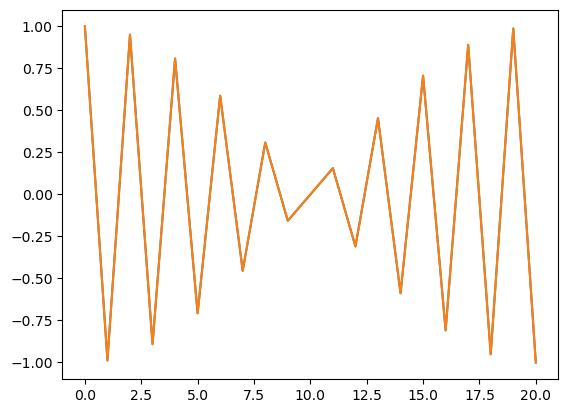

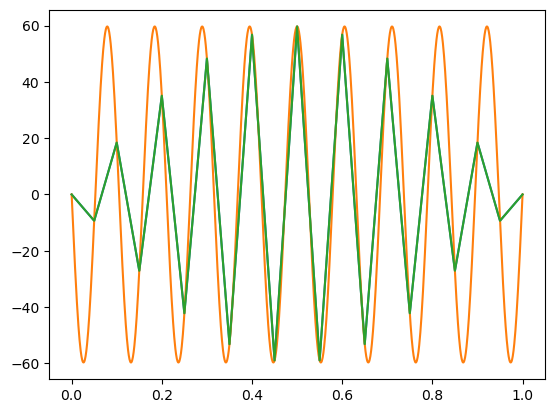

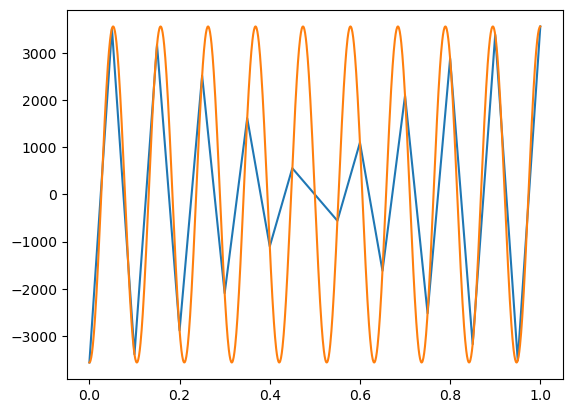

In [465]:
k=19
test_f = np.cos(np.pi*tau_N*k)
plt.plot(test_f)
plt.plot(np.fft.irfft(np.fft.rfft(get_ext_array(test_f), norm='forward'), norm='forward')[:N+1])

plt.figure()

der_oper = 1j*np.pi*np.arange(N+1)

plt.plot(tau_N, -np.sin(np.pi*tau_N*k)*(np.pi*k))
plt.plot(Tau_int,-np.sin(np.pi*Tau_int*k)*(np.pi*k))

plt.plot(tau_N, np.fft.irfft(der_oper*np.fft.rfft(get_ext_array(test_f), norm='forward'), norm='forward')[:N+1])

plt.figure()
plt.plot(tau_N, np.fft.irfft(der_oper**2*np.fft.rfft(get_ext_array(test_f), norm='forward'), norm='forward')[:N+1])
plt.plot(Tau_int,-np.cos(np.pi*Tau_int*k)*(np.pi*k)**2)


<IPython.core.display.Javascript object>


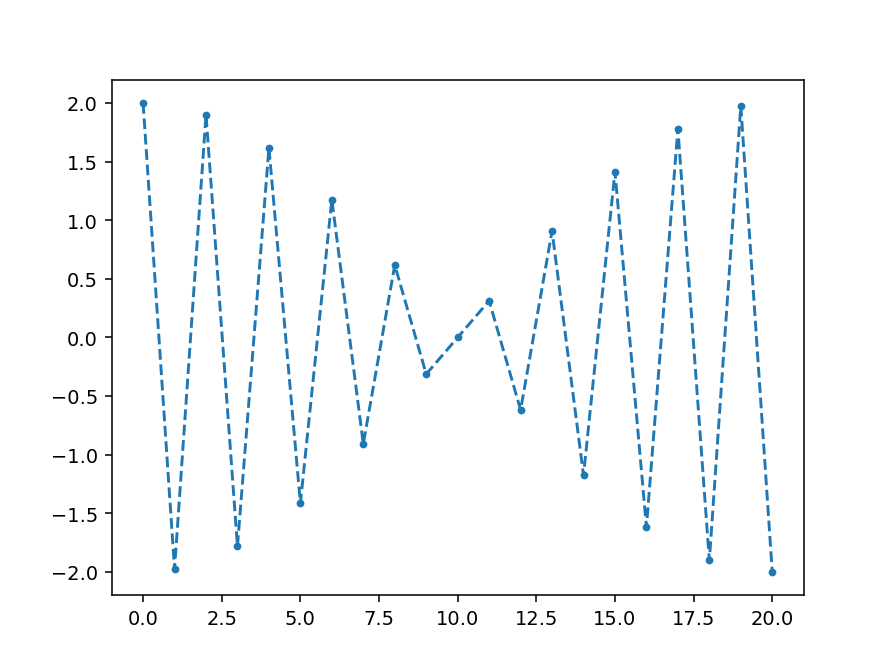

In [627]:
k=19
delta_k = np.zeros(N+1)
delta_k[k]=1.
delta_n_k = np.fft.irfft(delta_k, n=2*N, norm='forward')[0:N+1]
plt.figure()
plt.plot(delta_n_k,'.--')

<IPython.core.display.Javascript object>


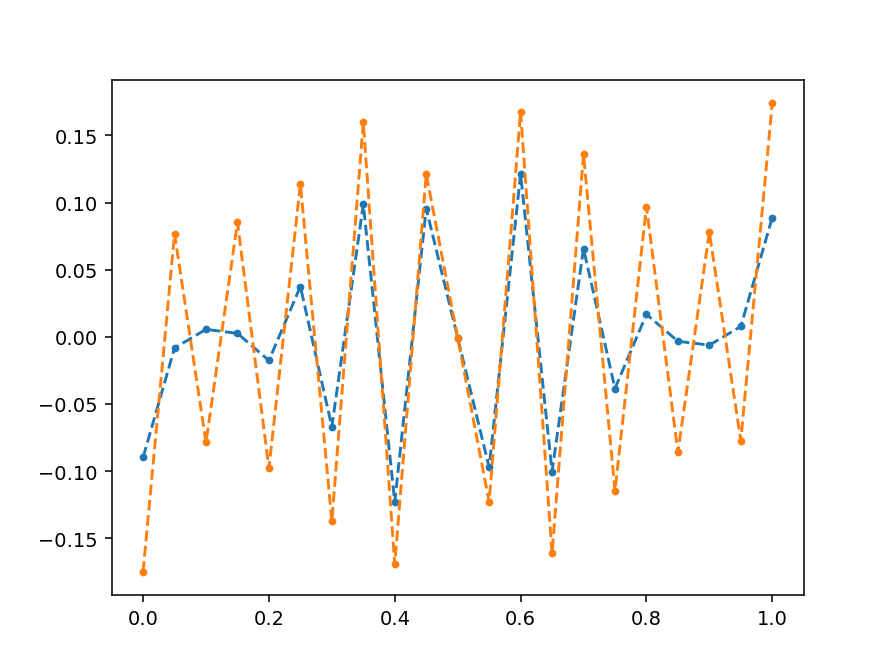

(21,)
(21,)


/tmp/ipykernel_89112/1385853270.py:28: RuntimeWarning: invalid value encountered in multiply
  -Z1.reshape(1,-1)*G_rhorho_tilde_mesh
/tmp/ipykernel_89112/1385853270.py:27: RuntimeWarning: invalid value encountered in subtract
  K_rho =  P1.reshape(1,-1)*G_rhoz_tilde_mesh\


<IPython.core.display.Javascript object>


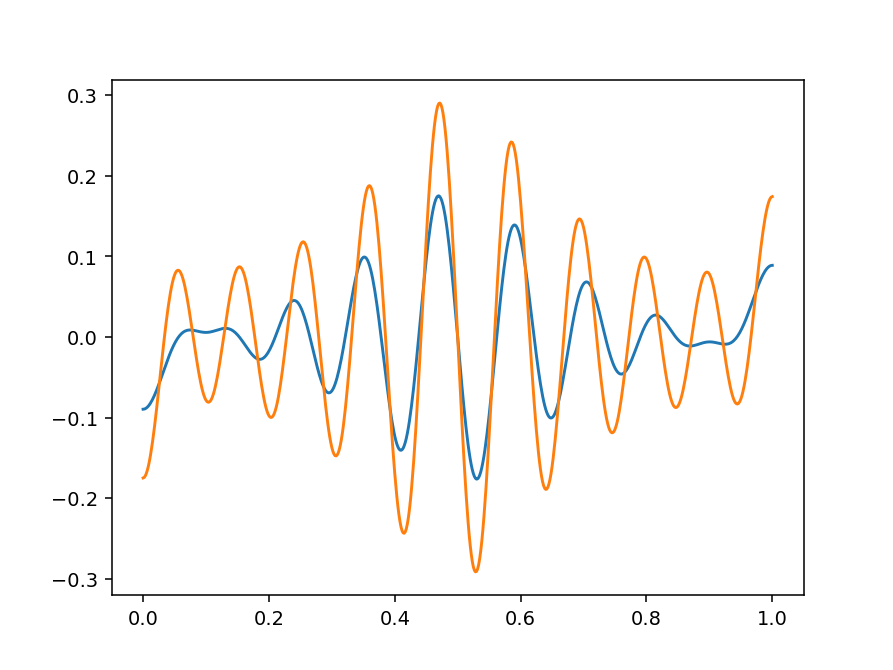

In [628]:
plt.figure()
delta_velo = get_velo_h_normal(delta_n_k*1e-4)-get_velo_h_normal(delta_n_k*0)
#delta_velo = get_N_field(get_ext_array(delta_velo))
plt.plot(tau_N, delta_velo,'.--')

delta_velo_full = get_velo_h_normal_full(delta_n_k*1e-4)-get_velo_h_normal_full(delta_n_k*0)
plt.plot(tau_int, delta_velo_full,'.--')

plt.figure()
delta_velo_cont = np.fft.irfft(np.fft.rfft(get_ext_array(delta_velo), norm='forward'),n=2*N_int, norm='forward')[:N_int+1]

plt.plot(Tau_int, delta_velo_cont)


delta_velo_cont = np.fft.irfft(np.fft.rfft(get_ext_array(delta_velo_full), norm='forward')[:N_int],n=2*N_int, norm='forward')[:N_int+1]

plt.plot(Tau_int, delta_velo_cont)

<IPython.core.display.Javascript object>


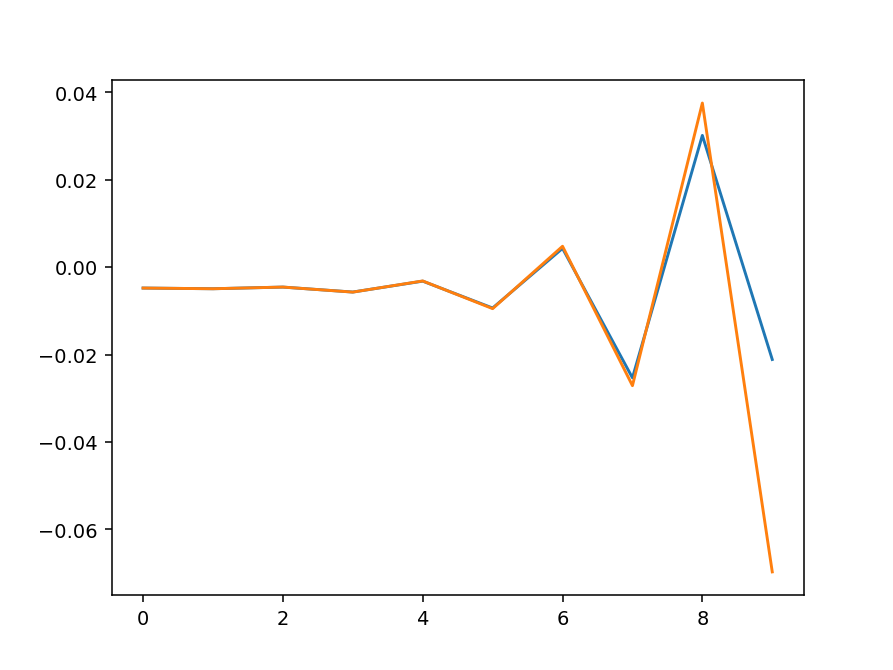

In [629]:
plt.figure()
plt.plot(np.fft.rfft(get_ext_array(delta_velo), norm='forward')[1::2])
plt.plot(np.fft.rfft(get_ext_array(delta_velo_full), norm='forward')[1::2])

### Radau

In [189]:
sol_rad = sc.integrate.solve_ivp(lambda t,pz: get_velo_h_fur_1d(pz), (0., 2), np.concatenate([P_fur[1:N], Z_fur]), 
                                   method='Radau', atol=1e-7, rtol=1e-4);

/tmp/ipykernel_141999/3809236376.py:25: RuntimeWarning: invalid value encountered in subtract
  K_rho =  P1.reshape(1,-1)*G_rhoz_tilde_mesh\
/tmp/ipykernel_141999/3809236376.py:26: RuntimeWarning: invalid value encountered in multiply
  -Z1.reshape(1,-1)*G_rhorho_tilde_mesh


In [116]:
R_Vol0 = (3*Vol0/4/np.pi)**(1/3)
R_Vol0

1.5874010519619075

In [118]:
theta = np.linspace(0,np.pi,500)
P_Vol0 = R_Vol0*np.sin(theta)
Z_Vol0 = R_Vol0*np.cos(theta)

<IPython.core.display.Javascript object>


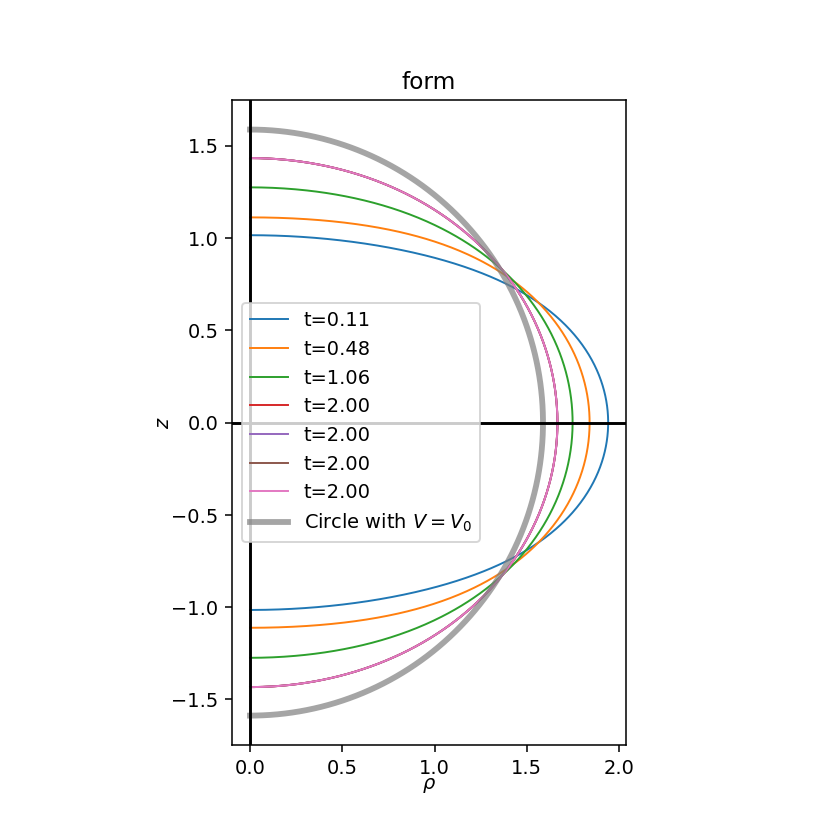

Text(0.5, 1.0, 'form')

In [190]:
plt.figure(figsize=(6,6))
for t_j in [0.1,0.5, 1,2,4,8,10]:#range(len(sol_radau.t)):
    j = np.argmin(np.abs(sol_rad.t-t_j))
    
    P_fur_j = np.zeros(N)
    P_fur_j[1:N] = sol_rad.y[:N-1,j]
    Z_fur_j =sol_rad.y[N-1:,j] 
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    plt.plot(P,Z,lw=1, label=f't={sol_rad.t[j]:.2f}')


plt.plot(P_Vol0,Z_Vol0, lw=3, label=r'Circle with $V=V_0$', alpha=0.7)    
    
    
plt.axis('scaled')
plt.legend()
plt.axvline(0, color='k')
plt.axhline(0, color='k')

plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)
plt.title('form')

<IPython.core.display.Javascript object>


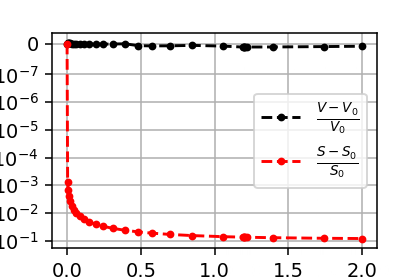

In [192]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur, Z_fur)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_rad.t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1:N] = sol_rad.y[:N-1,j]
    Z_fur_j =sol_rad.y[N-1:,j] 
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_rad.t, Vol_ar/Vol0-1,'.--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_rad.t, Sqr_ar/Sqr0-1,'.--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-7)

<IPython.core.display.Javascript object>


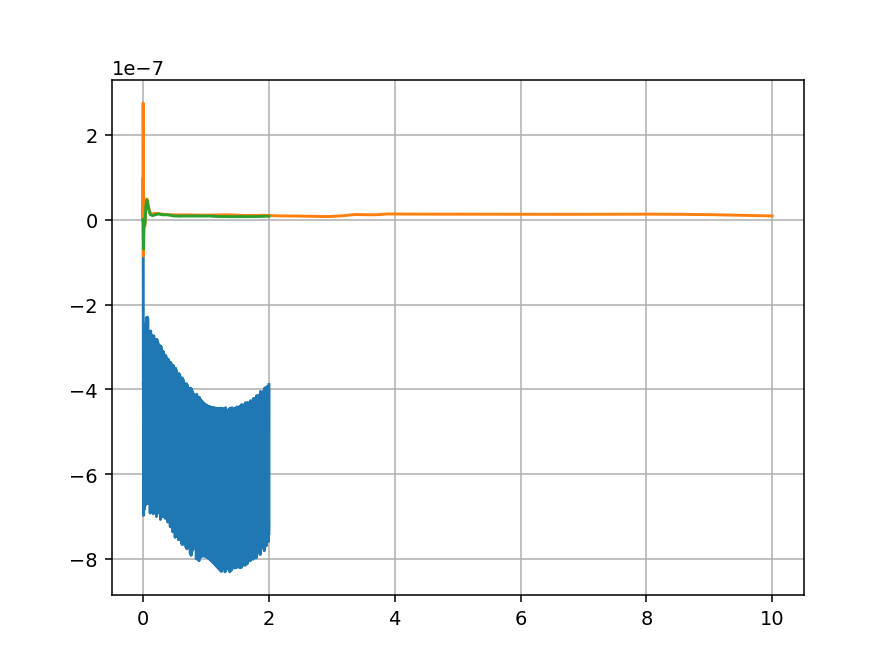

In [210]:
plt.figure()
j=18
plt.plot(sol_rk.t, sol_rk.y[j,:])
plt.plot(sol_bdf.t, sol_bdf.y[j,:])
plt.plot(sol_rad.t, sol_rad.y[j,:])

plt.grid()

## Surface tension work

In [58]:
N_sigma = 80 #Number of harmonic to describe sigma#

In [75]:
def get_div_v_oper_fur(P, P1, P2, Z, Z1, Z2, H):
    """
    Return div_v_i[sigma_j]
    """
    ### fileds ###
    V = np.sqrt(P1**2+Z1**2)
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    ### kernals G ###
    G_tilde_mesh = get_all_G_tilde(P, P_int, Z, Z_int)
    G_rhorho_tilde_mesh = G_tilde_mesh[0,0]
    G_rhoz_tilde_mesh   = G_tilde_mesh[0,1]
    G_zz_tilde_mesh     = G_tilde_mesh[1,1]
    G_zrho_tilde_mesh   = G_tilde_mesh[1,0]
    
    ### Axis expression ###
    G_zz_tilde_mesh[0,0]=2*np.pi;G_zz_tilde_mesh[-1,-1]=2*np.pi
    G_zrho_tilde_mesh[0,0]=0;G_zrho_tilde_mesh[-1,-1]=0
    
    
    ### kernals dG (tilde) ###
    d_rhoG, d_zG = get_dG_tilde(P, P_int, Z, Z_int)
        
    d_rhoG_rhorho = d_rhoG[0,0]; d_rhoG_rhoz = d_rhoG[0,1]
    d_rhoG_zrho   = d_rhoG[1,0]; d_rhoG_zz   = d_rhoG[1,1]
    
    d_zG_rhorho = d_zG[0,0]; d_zG_rhoz = d_zG[0,1]
    d_zG_zrho   = d_zG[1,0]; d_zG_zz   = d_zG[1,1]

    
    ### vector kernals ###
    D_rho = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhorho + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zrho+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhorho+d_rhoG_zrho)+\
            (1/P_int).reshape(-1,1)*(G_rhorho_tilde_mesh)
    D_z = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhoz + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zz+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhoz+d_rhoG_zz)+\
            (1/P_int).reshape(-1,1)*(G_rhoz_tilde_mesh)

    D_z[0,:] = D_z_axis_part(Z_int[0]-Z, P); D_z[-1,:] = D_z_axis_part(Z_int[-1]-Z, P)
    D_rho[0,:] = D_rho_axis_part(Z_int[0]-Z, P);D_rho[-1,:] = D_rho_axis_part(Z_int[-1]-Z, P)
    D_z[0,0] = np.pi*Z2_int[0]/P1_int[0]**2;D_z[-1,-1] = np.pi*Z2_int[-1]/P1_int[-1]**2

    ### normal and tau response ###
    D_n = -Z1.reshape(1,-1)*D_rho + P1.reshape(1,-1)*D_z
    D_tau = P1.reshape(1,-1)*D_rho + Z1.reshape(1,-1)*D_z

    D_n[0,0] = -Z2_int[0]*2*np.pi/P1_int[0]+P1_int[0]*D_z[0,0]
    D_n[-1,-1] = -Z2_int[-1]*2*np.pi/P1_int[-1]+P1_int[-1]*D_z[-1,-1]


    D_tau[1:-1][Kron[1:-1]]=0
    D_n[1:-1][Kron[1:-1]]=0

    ### singular part of tau ###
    D_tau_ln = (P1_int/P_int).reshape(-1,1)*\
                        np.log(8*(P_int/V_int).reshape(-1,1)/np.abs(dtau_int))
    D_tau_ln[0,:]=0;D_tau_ln[-1,:]=0

    D_tau_0 = (P1_int*P2_int+Z1_int*Z2_int)/V_int**2 - 3*P1_int*Z1_int**2/P_int/V_int**2
    D_tau_0[0]=0;D_tau_0[-1]=0

    D_tau_ov = 2/(-dtau_int)
    D_tau_ov[0]=0;D_tau_ov[-1]=0

    D_tau_sing = D_tau_ln + D_tau_ov
    D_tau_sing[1:-1][Kron[1:-1]]=0

    ### Weigted opers ###

    I_ln = (1+tau_int*np.log(8*P_int/V_int/tau_int)+
                      (1-tau_int)*np.log(8*P_int/V_int/(1-tau_int)))
    I_ov = 2*np.log((1-tau_int)/tau_int)



    Int_D_tau_reg_oper = D_tau * weights_simp.reshape(1,-1)
    Int_D_tau_reg_oper[0,0]=0;Int_D_tau_reg_oper[-1,-1]=0

    Int_D_tau_reg_sing_oper = -np.diag(D_tau_sing @ weights_simp)
    Int_D_tau_reg_0_oper = np.diag(D_tau_0*weights_simp[::N_int//n_int])
    Int_D_tau_reg_der_oper = 2*np.diag(weights_simp[::N_int//n_int])



    Int_D_tau_reg_der_oper[0,0] = 2*np.pi*weights_simp[0];Int_D_tau_reg_der_oper[-1,-1] = 2*np.pi*weights_simp[-1]


    Int_D_tau_sing_oper = np.diag(P1_int/P_int*I_ln + I_ov)
    Int_D_tau_sing_oper[0]=0;Int_D_tau_sing_oper[-1]=0


    def get_div_v(sigma_fur):
        sigma, sigma1,sigma2,_,_ = get_int_fields(sigma_fur)

        tan_force = sigma1/V
        norm_force = -H*sigma

        tan_force_der_int = (sigma2/V)[::N_int//n_int]-\
                                    sigma1[::N_int//n_int]*((P1_int*P2_int+Z1_int*Z2_int)/V_int**3)

        Div_v_tau = Int_D_tau_reg_oper      @ tan_force +\
                    Int_D_tau_reg_sing_oper @ tan_force[::N_int//n_int]+\
                    Int_D_tau_reg_0_oper    @ tan_force[::N_int//n_int]+\
                    Int_D_tau_reg_der_oper  @ tan_force_der_int+\
                    Int_D_tau_sing_oper     @ tan_force[::N_int//n_int]

        Div_v_n = D_n * weights_simp.reshape(1,-1)      @ norm_force -\
                         (D_n @ weights_simp) * norm_force[::N_int//n_int]


        Div_v_sum = Div_v_n + Div_v_tau
        Div_v_sum /= 8*np.pi
        return Div_v_sum
    Div_v_sum_oper = np.apply_along_axis(get_div_v, 0,np.eye(N_sigma))

    Div_v_sum_oper_fur = np.fft.rfft(np.apply_along_axis(get_ext_array,0,Div_v_sum_oper), norm='forward', axis=0).real
    return Div_v_sum_oper_fur

In [76]:
def get_div_v_oper(P, P1, P2, Z, Z1, Z2, H):
    """
    Return div_v_i[varphi_j] i - in real space
    """
    ### fileds ###
    V = np.sqrt(P1**2+Z1**2)
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    ### kernals G ###
    G_tilde_mesh = get_all_G_tilde(P, P_int, Z, Z_int)
    G_rhorho_tilde_mesh = G_tilde_mesh[0,0]
    G_rhoz_tilde_mesh   = G_tilde_mesh[0,1]
    G_zz_tilde_mesh     = G_tilde_mesh[1,1]
    G_zrho_tilde_mesh   = G_tilde_mesh[1,0]
    
    ### Axis expression ###
    G_zz_tilde_mesh[0,0]=2*np.pi;G_zz_tilde_mesh[-1,-1]=2*np.pi
    G_zrho_tilde_mesh[0,0]=0;G_zrho_tilde_mesh[-1,-1]=0
    
    
    ### kernals dG (tilde) ###
    d_rhoG, d_zG = get_dG_tilde(P, P_int, Z, Z_int)
        
    d_rhoG_rhorho = d_rhoG[0,0]; d_rhoG_rhoz = d_rhoG[0,1]
    d_rhoG_zrho   = d_rhoG[1,0]; d_rhoG_zz   = d_rhoG[1,1]
    
    d_zG_rhorho = d_zG[0,0]; d_zG_rhoz = d_zG[0,1]
    d_zG_zrho   = d_zG[1,0]; d_zG_zz   = d_zG[1,1]

    
    ### vector kernals ###
    D_rho = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhorho + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zrho+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhorho+d_rhoG_zrho)+\
            (1/P_int).reshape(-1,1)*(G_rhorho_tilde_mesh)
    D_z = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhoz + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zz+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhoz+d_rhoG_zz)+\
            (1/P_int).reshape(-1,1)*(G_rhoz_tilde_mesh)

    D_z[0,:] = D_z_axis_part(Z_int[0]-Z, P); D_z[-1,:] = D_z_axis_part(Z_int[-1]-Z, P)
    D_rho[0,:] = D_rho_axis_part(Z_int[0]-Z, P);D_rho[-1,:] = D_rho_axis_part(Z_int[-1]-Z, P)
    D_z[0,0] = np.pi*Z2_int[0]/P1_int[0]**2;D_z[-1,-1] = np.pi*Z2_int[-1]/P1_int[-1]**2

    ### normal and tau response ###
    D_n = -Z1.reshape(1,-1)*D_rho + P1.reshape(1,-1)*D_z
    D_tau = P1.reshape(1,-1)*D_rho + Z1.reshape(1,-1)*D_z

    D_n[0,0] = -Z2_int[0]*2*np.pi/P1_int[0]+P1_int[0]*D_z[0,0]
    D_n[-1,-1] = -Z2_int[-1]*2*np.pi/P1_int[-1]+P1_int[-1]*D_z[-1,-1]


    D_tau[1:-1][Kron[1:-1]]=0
    D_n[1:-1][Kron[1:-1]]=0

    ### singular part of tau ###
    D_tau_ln = (P1_int/P_int).reshape(-1,1)*\
                        np.log(8*(P_int/V_int).reshape(-1,1)/np.abs(dtau_int))
    D_tau_ln[0,:]=0;D_tau_ln[-1,:]=0

    D_tau_0 = (P1_int*P2_int+Z1_int*Z2_int)/V_int**2 - 3*P1_int*Z1_int**2/P_int/V_int**2
    D_tau_0[0]=0;D_tau_0[-1]=0

    D_tau_ov = 2/(-dtau_int)
    D_tau_ov[0]=0;D_tau_ov[-1]=0

    D_tau_sing = D_tau_ln + D_tau_ov
    D_tau_sing[1:-1][Kron[1:-1]]=0

    ### Weigted opers ###

    I_ln = (1+tau_int*np.log(8*P_int/V_int/tau_int)+
                      (1-tau_int)*np.log(8*P_int/V_int/(1-tau_int)))
    I_ov = 2*np.log((1-tau_int)/tau_int)



    Int_D_tau_reg_oper = D_tau * weights_simp.reshape(1,-1)
    Int_D_tau_reg_oper[0,0]=0;Int_D_tau_reg_oper[-1,-1]=0

    Int_D_tau_reg_sing_oper = -np.diag(D_tau_sing @ weights_simp)
    Int_D_tau_reg_0_oper = np.diag(D_tau_0*weights_simp[::N_int//n_int])
    Int_D_tau_reg_der_oper = 2*np.diag(weights_simp[::N_int//n_int])



    Int_D_tau_reg_der_oper[0,0] = 2*np.pi*weights_simp[0];Int_D_tau_reg_der_oper[-1,-1] = 2*np.pi*weights_simp[-1]


    Int_D_tau_sing_oper = np.diag(P1_int/P_int*I_ln + I_ov)
    Int_D_tau_sing_oper[0]=0;Int_D_tau_sing_oper[-1]=0


    def get_div_v(sigma_fur):
        sigma, sigma1,sigma2,_,_ = get_int_fields(sigma_fur)

        tan_force = sigma1/V
        norm_force = -H*sigma

        tan_force_der_int = (sigma2/V)[::N_int//n_int]-\
                                    sigma1[::N_int//n_int]*((P1_int*P2_int+Z1_int*Z2_int)/V_int**3)

        Div_v_tau = Int_D_tau_reg_oper      @ tan_force +\
                    Int_D_tau_reg_sing_oper @ tan_force[::N_int//n_int]+\
                    Int_D_tau_reg_0_oper    @ tan_force[::N_int//n_int]+\
                    Int_D_tau_reg_der_oper  @ tan_force_der_int+\
                    Int_D_tau_sing_oper     @ tan_force[::N_int//n_int]

        Div_v_n = D_n * weights_simp.reshape(1,-1)      @ norm_force -\
                         (D_n @ weights_simp) * norm_force[::N_int//n_int]


        Div_v_sum = Div_v_n + Div_v_tau
        Div_v_sum /= 8*np.pi
        return Div_v_sum
    Div_v_sum_oper = np.apply_along_axis(get_div_v, 0,np.eye(N_sigma))
    Div_v_sum_oper_fur = np.fft.rfft(np.apply_along_axis(get_ext_array,0,Div_v_sum_oper), norm='forward', axis=0).real
    return Div_v_sum_oper_fur

In [77]:
def get_div_v_oper_from_arr(P_fur, Z_fur):
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)

    H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    
    ### find surface tension ###
    return get_div_v_oper(P, P1, P2, Z, Z1, Z2, H)

In [78]:
def get_div_v_hel(P, P1, P2, Z, Z1, Z2, H, force):
    """
    Return sigma_fur 
    """
    ### fileds ###
    V = np.sqrt(P1**2+Z1**2)
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    ### kernals G ###
    G_tilde_mesh = get_all_G_tilde(P, P_int, Z, Z_int)
    G_rhorho_tilde_mesh = G_tilde_mesh[0,0]
    G_rhoz_tilde_mesh   = G_tilde_mesh[0,1]
    G_zz_tilde_mesh     = G_tilde_mesh[1,1]
    G_zrho_tilde_mesh   = G_tilde_mesh[1,0]
    
    ### Axis expression ###
    G_zz_tilde_mesh[0,0]=2*np.pi;G_zz_tilde_mesh[-1,-1]=2*np.pi
    G_zrho_tilde_mesh[0,0]=0;G_zrho_tilde_mesh[-1,-1]=0
    
    
    ### kernals dG (tilde) ###
    d_rhoG, d_zG = get_dG_tilde(P, P_int, Z, Z_int)
        
    d_rhoG_rhorho = d_rhoG[0,0]; d_rhoG_rhoz = d_rhoG[0,1]
    d_rhoG_zrho   = d_rhoG[1,0]; d_rhoG_zz   = d_rhoG[1,1]
    
    d_zG_rhorho = d_zG[0,0]; d_zG_rhoz = d_zG[0,1]
    d_zG_zrho   = d_zG[1,0]; d_zG_zz   = d_zG[1,1]

    ### vector kernals ###
    D_rho = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhorho + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zrho+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhorho+d_rhoG_zrho)+\
            (1/P_int).reshape(-1,1)*(G_rhorho_tilde_mesh)
    D_z = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhoz + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zz+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhoz+d_rhoG_zz)+\
            (1/P_int).reshape(-1,1)*(G_rhoz_tilde_mesh)

    D_z[0,:] = D_z_axis_part(Z_int[0]-Z, P); D_z[-1,:] = D_z_axis_part(Z_int[-1]-Z, P)
    D_rho[0,:] = D_rho_axis_part(Z_int[0]-Z, P);D_rho[-1,:] = D_rho_axis_part(Z_int[-1]-Z, P)
    D_z[0,0] = np.pi*Z2_int[0]/P1_int[0]**2;D_z[-1,-1] = np.pi*Z2_int[-1]/P1_int[-1]**2

    ### normal and tau response ###
    D_n = -Z1.reshape(1,-1)*D_rho + P1.reshape(1,-1)*D_z
    D_tau = P1.reshape(1,-1)*D_rho + Z1.reshape(1,-1)*D_z

    D_n[0,0] = -Z2_int[0]*2*np.pi/P1_int[0]+P1_int[0]*D_z[0,0]
    D_n[-1,-1] = -Z2_int[-1]*2*np.pi/P1_int[-1]+P1_int[-1]*D_z[-1,-1]


    D_tau[1:-1][Kron[1:-1]]=0
    D_n[1:-1][Kron[1:-1]]=0

    ### singular part of tau ###
    D_tau_ln = (P1_int/P_int).reshape(-1,1)*\
                        np.log(8*(P_int/V_int).reshape(-1,1)/np.abs(dtau_int))
    D_tau_ln[0,:]=0;D_tau_ln[-1,:]=0

    D_tau_0 = (P1_int*P2_int+Z1_int*Z2_int)/V_int**2 - 3*P1_int*Z1_int**2/P_int/V_int**2
    D_tau_0[0]=0;D_tau_0[-1]=0

    D_tau_ov = 2/(-dtau_int)
    D_tau_ov[0]=0;D_tau_ov[-1]=0

    D_tau_sing = D_tau_ln + D_tau_ov
    D_tau_sing[1:-1][Kron[1:-1]]=0

    ### Weigted opers ###

    I_ln = (1+tau_int*np.log(8*P_int/V_int/tau_int)+
                      (1-tau_int)*np.log(8*P_int/V_int/(1-tau_int)))
    I_ov = 2*np.log((1-tau_int)/tau_int)



    Int_D_tau_reg_oper = D_tau * weights_simp.reshape(1,-1)
    Int_D_tau_reg_oper[0,0]=0;Int_D_tau_reg_oper[-1,-1]=0

    Int_D_tau_reg_sing_oper = -np.diag(D_tau_sing @ weights_simp)
    Int_D_tau_reg_0_oper = np.diag(D_tau_0*weights_simp[::N_int//n_int])
    Int_D_tau_reg_der_oper = 2*np.diag(weights_simp[::N_int//n_int])



    Int_D_tau_reg_der_oper[0,0] = 2*np.pi*weights_simp[0];Int_D_tau_reg_der_oper[-1,-1] = 2*np.pi*weights_simp[-1]


    Int_D_tau_sing_oper = np.diag(P1_int/P_int*I_ln + I_ov)
    Int_D_tau_sing_oper[0]=0;Int_D_tau_sing_oper[-1]=0

    ### find div_v from helfrih force ###
    Div_v_force = D_n * weights_simp.reshape(1,-1)      @ force -\
                         (D_n @ weights_simp) * force[::N_int//n_int]
    Div_v_force /= 8*np.pi
    Div_v_force_fur =  np.fft.rfft(get_ext_array(Div_v_force), norm='forward').real
    
    return Div_v_force, Div_v_force_fur

In [79]:
def get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force):
    """
    Return sigma_fur 
    """
    ### fileds ###
    V = np.sqrt(P1**2+Z1**2)
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    ### kernals G ###
    G_tilde_mesh = get_all_G_tilde(P, P_int, Z, Z_int)
    G_rhorho_tilde_mesh = G_tilde_mesh[0,0]
    G_rhoz_tilde_mesh   = G_tilde_mesh[0,1]
    G_zz_tilde_mesh     = G_tilde_mesh[1,1]
    G_zrho_tilde_mesh   = G_tilde_mesh[1,0]
    
    ### Axis expression ###
    G_zz_tilde_mesh[0,0]=2*np.pi;G_zz_tilde_mesh[-1,-1]=2*np.pi
    G_zrho_tilde_mesh[0,0]=0;G_zrho_tilde_mesh[-1,-1]=0
    
    
    ### kernals dG (tilde) ###
    d_rhoG, d_zG = get_dG_tilde(P, P_int, Z, Z_int)
        
    d_rhoG_rhorho = d_rhoG[0,0]; d_rhoG_rhoz = d_rhoG[0,1]
    d_rhoG_zrho   = d_rhoG[1,0]; d_rhoG_zz   = d_rhoG[1,1]
    
    d_zG_rhorho = d_zG[0,0]; d_zG_rhoz = d_zG[0,1]
    d_zG_zrho   = d_zG[1,0]; d_zG_zz   = d_zG[1,1]

    ### vector kernals ###
    D_rho = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhorho + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zrho+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhorho+d_rhoG_zrho)+\
            (1/P_int).reshape(-1,1)*(G_rhorho_tilde_mesh)
    D_z = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhoz + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zz+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhoz+d_rhoG_zz)+\
            (1/P_int).reshape(-1,1)*(G_rhoz_tilde_mesh)

    D_z[0,:] = D_z_axis_part(Z_int[0]-Z, P); D_z[-1,:] = D_z_axis_part(Z_int[-1]-Z, P)
    D_rho[0,:] = D_rho_axis_part(Z_int[0]-Z, P);D_rho[-1,:] = D_rho_axis_part(Z_int[-1]-Z, P)
    D_z[0,0] = np.pi*Z2_int[0]/P1_int[0]**2;D_z[-1,-1] = np.pi*Z2_int[-1]/P1_int[-1]**2

    ### normal and tau response ###
    D_n = -Z1.reshape(1,-1)*D_rho + P1.reshape(1,-1)*D_z
    D_tau = P1.reshape(1,-1)*D_rho + Z1.reshape(1,-1)*D_z

    D_n[0,0] = -Z2_int[0]*2*np.pi/P1_int[0]+P1_int[0]*D_z[0,0]
    D_n[-1,-1] = -Z2_int[-1]*2*np.pi/P1_int[-1]+P1_int[-1]*D_z[-1,-1]


    D_tau[1:-1][Kron[1:-1]]=0
    D_n[1:-1][Kron[1:-1]]=0

    ### singular part of tau ###
    D_tau_ln = (P1_int/P_int).reshape(-1,1)*\
                        np.log(8*(P_int/V_int).reshape(-1,1)/np.abs(dtau_int))
    D_tau_ln[0,:]=0;D_tau_ln[-1,:]=0

    D_tau_0 = (P1_int*P2_int+Z1_int*Z2_int)/V_int**2 - 3*P1_int*Z1_int**2/P_int/V_int**2
    D_tau_0[0]=0;D_tau_0[-1]=0

    D_tau_ov = 2/(-dtau_int)
    D_tau_ov[0]=0;D_tau_ov[-1]=0

    D_tau_sing = D_tau_ln + D_tau_ov
    D_tau_sing[1:-1][Kron[1:-1]]=0

    ### Weigted opers ###

    I_ln = (1+tau_int*np.log(8*P_int/V_int/tau_int)+
                      (1-tau_int)*np.log(8*P_int/V_int/(1-tau_int)))
    I_ov = 2*np.log((1-tau_int)/tau_int)



    Int_D_tau_reg_oper = D_tau * weights_simp.reshape(1,-1)
    Int_D_tau_reg_oper[0,0]=0;Int_D_tau_reg_oper[-1,-1]=0

    Int_D_tau_reg_sing_oper = -np.diag(D_tau_sing @ weights_simp)
    Int_D_tau_reg_0_oper = np.diag(D_tau_0*weights_simp[::N_int//n_int])
    Int_D_tau_reg_der_oper = 2*np.diag(weights_simp[::N_int//n_int])



    Int_D_tau_reg_der_oper[0,0] = 2*np.pi*weights_simp[0];Int_D_tau_reg_der_oper[-1,-1] = 2*np.pi*weights_simp[-1]


    Int_D_tau_sing_oper = np.diag(P1_int/P_int*I_ln + I_ov)
    Int_D_tau_sing_oper[0]=0;Int_D_tau_sing_oper[-1]=0


    def get_div_v(sigma_fur):
        sigma, sigma1,sigma2,_,_ = get_int_fields(sigma_fur)

        tan_force = sigma1/V
        norm_force = -H*sigma

        tan_force_der_int = (sigma2/V)[::N_int//n_int]-\
                                    sigma1[::N_int//n_int]*((P1_int*P2_int+Z1_int*Z2_int)/V_int**3)

        Div_v_tau = Int_D_tau_reg_oper      @ tan_force +\
                    Int_D_tau_reg_sing_oper @ tan_force[::N_int//n_int]+\
                    Int_D_tau_reg_0_oper    @ tan_force[::N_int//n_int]+\
                    Int_D_tau_reg_der_oper  @ tan_force_der_int+\
                    Int_D_tau_sing_oper     @ tan_force[::N_int//n_int]

        Div_v_n = D_n * weights_simp.reshape(1,-1)      @ norm_force -\
                         (D_n @ weights_simp) * norm_force[::N_int//n_int]


        Div_v_sum = Div_v_n + Div_v_tau
        Div_v_sum /= 8*np.pi
        return Div_v_sum
    Div_v_sum_oper = np.apply_along_axis(get_div_v, 0,np.eye(N_sigma))
    Div_v_sum_oper_fur = np.fft.rfft(np.apply_along_axis(get_ext_array,0,Div_v_sum_oper), norm='forward', axis=0).real
    
    
    ### find div_v from helfrih force ###
    Div_v_force = D_n * weights_simp.reshape(1,-1)      @ force -\
                         (D_n @ weights_simp) * force[::N_int//n_int]
    Div_v_force /= 8*np.pi
    Div_v_force_fur =  np.fft.rfft(get_ext_array(Div_v_force), norm='forward').real
    
    sigma_fur = sc.linalg.solve(Div_v_sum_oper_fur[:N_sigma,:],-Div_v_force_fur[N_sigma])
    return sigma_fur

In [80]:
def get_sigma_fur_new(P, P1, P2, Z, Z1, Z2, H, force):
    """
    Return sigma_fur 
    """
    ### fileds ###
    V = np.sqrt(P1**2+Z1**2)
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    ### kernals G ###
    G_tilde_mesh = get_all_G_tilde(P, P_int, Z, Z_int)
    G_rhorho_tilde_mesh = G_tilde_mesh[0,0]
    G_rhoz_tilde_mesh   = G_tilde_mesh[0,1]
    G_zz_tilde_mesh     = G_tilde_mesh[1,1]
    G_zrho_tilde_mesh   = G_tilde_mesh[1,0]
    
    ### Axis expression ###
    G_zz_tilde_mesh[0,0]=2*np.pi;G_zz_tilde_mesh[-1,-1]=2*np.pi
    G_zrho_tilde_mesh[0,0]=0;G_zrho_tilde_mesh[-1,-1]=0
    
    
    ### kernals dG (tilde) ###
    d_rhoG, d_zG = get_dG_tilde(P, P_int, Z, Z_int)
        
    d_rhoG_rhorho = d_rhoG[0,0]; d_rhoG_rhoz = d_rhoG[0,1]
    d_rhoG_zrho   = d_rhoG[1,0]; d_rhoG_zz   = d_rhoG[1,1]
    
    d_zG_rhorho = d_zG[0,0]; d_zG_rhoz = d_zG[0,1]
    d_zG_zrho   = d_zG[1,0]; d_zG_zz   = d_zG[1,1]

    ### vector kernals ###
    D_rho = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhorho + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zrho+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhorho+d_rhoG_zrho)+\
            (1/P_int).reshape(-1,1)*(G_rhorho_tilde_mesh)
    D_z = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhoz + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zz+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhoz+d_rhoG_zz)+\
            (1/P_int).reshape(-1,1)*(G_rhoz_tilde_mesh)

    D_z[0,:] = D_z_axis_part(Z_int[0]-Z, P); D_z[-1,:] = D_z_axis_part(Z_int[-1]-Z, P)
    D_rho[0,:] = D_rho_axis_part(Z_int[0]-Z, P);D_rho[-1,:] = D_rho_axis_part(Z_int[-1]-Z, P)
    D_z[0,0] = np.pi*Z2_int[0]/P1_int[0]**2;D_z[-1,-1] = np.pi*Z2_int[-1]/P1_int[-1]**2

    ### normal and tau response ###
    D_n = -Z1.reshape(1,-1)*D_rho + P1.reshape(1,-1)*D_z
    D_tau = P1.reshape(1,-1)*D_rho + Z1.reshape(1,-1)*D_z

    D_n[0,0] = -Z2_int[0]*2*np.pi/P1_int[0]+P1_int[0]*D_z[0,0]
    D_n[-1,-1] = -Z2_int[-1]*2*np.pi/P1_int[-1]+P1_int[-1]*D_z[-1,-1]


    D_tau[1:-1][Kron[1:-1]]=0
    D_n[1:-1][Kron[1:-1]]=0

    ### singular part of tau ###
    D_tau_ln = (P1_int/P_int).reshape(-1,1)*\
                        np.log(8*(P_int/V_int).reshape(-1,1)/np.abs(dtau_int))
    D_tau_ln[0,:]=0;D_tau_ln[-1,:]=0

    D_tau_0 = (P1_int*P2_int+Z1_int*Z2_int)/V_int**2 - 3*P1_int*Z1_int**2/P_int/V_int**2
    D_tau_0[0]=0;D_tau_0[-1]=0

    D_tau_ov = 2/(-dtau_int)
    D_tau_ov[0]=0;D_tau_ov[-1]=0

    D_tau_sing = D_tau_ln + D_tau_ov
    D_tau_sing[1:-1][Kron[1:-1]]=0

    ### Weigted opers ###

    I_ln = (1+tau_int*np.log(8*P_int/V_int/tau_int)+
                      (1-tau_int)*np.log(8*P_int/V_int/(1-tau_int)))
    I_ov = 2*np.log((1-tau_int)/tau_int)



    Int_D_tau_reg_oper = D_tau * weights_simp.reshape(1,-1)
    Int_D_tau_reg_oper[0,0]=0;Int_D_tau_reg_oper[-1,-1]=0

    Int_D_tau_reg_sing_oper = -np.diag(D_tau_sing @ weights_simp)
    Int_D_tau_reg_0_oper = np.diag(D_tau_0*weights_simp[::N_int//n_int])
    Int_D_tau_reg_der_oper = 2*np.diag(weights_simp[::N_int//n_int])



    Int_D_tau_reg_der_oper[0,0] = 2*np.pi*weights_simp[0];Int_D_tau_reg_der_oper[-1,-1] = 2*np.pi*weights_simp[-1]


    Int_D_tau_sing_oper = np.diag(P1_int/P_int*I_ln + I_ov)
    Int_D_tau_sing_oper[0]=0;Int_D_tau_sing_oper[-1]=0


    def get_div_v(sigma_fur):
        sigma, sigma1,sigma2,_,_ = get_int_fields(sigma_fur)

        tan_force = sigma1/V
        norm_force = -H*sigma

        tan_force_der_int = (sigma2/V)[::N_int//n_int]-\
                                    sigma1[::N_int//n_int]*((P1_int*P2_int+Z1_int*Z2_int)/V_int**3)

        Div_v_tau = Int_D_tau_reg_oper      @ tan_force +\
                    Int_D_tau_reg_sing_oper @ tan_force[::N_int//n_int]+\
                    Int_D_tau_reg_0_oper    @ tan_force[::N_int//n_int]+\
                    Int_D_tau_reg_der_oper  @ tan_force_der_int+\
                    Int_D_tau_sing_oper     @ tan_force[::N_int//n_int]

        Div_v_n = D_n * weights_simp.reshape(1,-1)      @ norm_force -\
                         (D_n @ weights_simp) * norm_force[::N_int//n_int]


        Div_v_sum = Div_v_n + Div_v_tau
        Div_v_sum /= 8*np.pi
        return Div_v_sum
    Div_v_sum_oper = np.apply_along_axis(get_div_v, 0,np.eye(N_sigma))
    
    Div_v_sum_oper[0,:]*=1/np.sqrt(2);Div_v_sum_oper[-1,:]*=1/np.sqrt(2)
    
    ### find div_v from helfrih force ###
    Div_v_force = D_n * weights_simp.reshape(1,-1)      @ force -\
                         (D_n @ weights_simp) * force[::N_int//n_int]
    Div_v_force /= 8*np.pi
    
    Div_v_force[0]*=1/np.sqrt(2);Div_v_force[-1]*=1/np.sqrt(2)
    
    sigma_fur = sc.linalg.lstsq(Div_v_sum_oper, -Div_v_force)[0]
    
    return sigma_fur

In [81]:
def get_sigma_fur_new_from_array_dforce(P, P1, P2, Z, Z1, Z2, H, dforce_arr):
    """
    Return sigma_fur_ij as response sigma_i from j dforce
    dforce_arr : (N_jac, N_int)
    """
    ### fileds ###
    V = np.sqrt(P1**2+Z1**2)
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    ### kernals G ###
    G_tilde_mesh = get_all_G_tilde(P, P_int, Z, Z_int)
    G_rhorho_tilde_mesh = G_tilde_mesh[0,0]
    G_rhoz_tilde_mesh   = G_tilde_mesh[0,1]
    G_zz_tilde_mesh     = G_tilde_mesh[1,1]
    G_zrho_tilde_mesh   = G_tilde_mesh[1,0]
    
    ### Axis expression ###
    G_zz_tilde_mesh[0,0]=2*np.pi;G_zz_tilde_mesh[-1,-1]=2*np.pi
    G_zrho_tilde_mesh[0,0]=0;G_zrho_tilde_mesh[-1,-1]=0
    
    
    ### kernals dG (tilde) ###
    d_rhoG, d_zG = get_dG_tilde(P, P_int, Z, Z_int)
        
    d_rhoG_rhorho = d_rhoG[0,0]; d_rhoG_rhoz = d_rhoG[0,1]
    d_rhoG_zrho   = d_rhoG[1,0]; d_rhoG_zz   = d_rhoG[1,1]
    
    d_zG_rhorho = d_zG[0,0]; d_zG_rhoz = d_zG[0,1]
    d_zG_zrho   = d_zG[1,0]; d_zG_zz   = d_zG[1,1]

    ### vector kernals ###
    D_rho = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhorho + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zrho+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhorho+d_rhoG_zrho)+\
            (1/P_int).reshape(-1,1)*(G_rhorho_tilde_mesh)
    D_z = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhoz + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zz+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhoz+d_rhoG_zz)+\
            (1/P_int).reshape(-1,1)*(G_rhoz_tilde_mesh)

    D_z[0,:] = D_z_axis_part(Z_int[0]-Z, P); D_z[-1,:] = D_z_axis_part(Z_int[-1]-Z, P)
    D_rho[0,:] = D_rho_axis_part(Z_int[0]-Z, P);D_rho[-1,:] = D_rho_axis_part(Z_int[-1]-Z, P)
    D_z[0,0] = np.pi*Z2_int[0]/P1_int[0]**2;D_z[-1,-1] = np.pi*Z2_int[-1]/P1_int[-1]**2

    ### normal and tau response ###
    D_n = -Z1.reshape(1,-1)*D_rho + P1.reshape(1,-1)*D_z
    D_tau = P1.reshape(1,-1)*D_rho + Z1.reshape(1,-1)*D_z

    D_n[0,0] = -Z2_int[0]*2*np.pi/P1_int[0]+P1_int[0]*D_z[0,0]
    D_n[-1,-1] = -Z2_int[-1]*2*np.pi/P1_int[-1]+P1_int[-1]*D_z[-1,-1]


    D_tau[1:-1][Kron[1:-1]]=0
    D_n[1:-1][Kron[1:-1]]=0

    ### singular part of tau ###
    D_tau_ln = (P1_int/P_int).reshape(-1,1)*\
                        np.log(8*(P_int/V_int).reshape(-1,1)/np.abs(dtau_int))
    D_tau_ln[0,:]=0;D_tau_ln[-1,:]=0

    D_tau_0 = (P1_int*P2_int+Z1_int*Z2_int)/V_int**2 - 3*P1_int*Z1_int**2/P_int/V_int**2
    D_tau_0[0]=0;D_tau_0[-1]=0

    D_tau_ov = 2/(-dtau_int)
    D_tau_ov[0]=0;D_tau_ov[-1]=0

    D_tau_sing = D_tau_ln + D_tau_ov
    D_tau_sing[1:-1][Kron[1:-1]]=0

    ### Weigted opers ###

    I_ln = (1+tau_int*np.log(8*P_int/V_int/tau_int)+
                      (1-tau_int)*np.log(8*P_int/V_int/(1-tau_int)))
    I_ov = 2*np.log((1-tau_int)/tau_int)



    Int_D_tau_reg_oper = D_tau * weights_simp.reshape(1,-1)
    Int_D_tau_reg_oper[0,0]=0;Int_D_tau_reg_oper[-1,-1]=0

    Int_D_tau_reg_sing_oper = -np.diag(D_tau_sing @ weights_simp)
    Int_D_tau_reg_0_oper = np.diag(D_tau_0*weights_simp[::N_int//n_int])
    Int_D_tau_reg_der_oper = 2*np.diag(weights_simp[::N_int//n_int])



    Int_D_tau_reg_der_oper[0,0] = 2*np.pi*weights_simp[0];Int_D_tau_reg_der_oper[-1,-1] = 2*np.pi*weights_simp[-1]


    Int_D_tau_sing_oper = np.diag(P1_int/P_int*I_ln + I_ov)
    Int_D_tau_sing_oper[0]=0;Int_D_tau_sing_oper[-1]=0


    def get_div_v(sigma_fur):
        sigma, sigma1,sigma2,_,_ = get_int_fields(sigma_fur)

        tan_force = sigma1/V
        norm_force = -H*sigma

        tan_force_der_int = (sigma2/V)[::N_int//n_int]-\
                                    sigma1[::N_int//n_int]*((P1_int*P2_int+Z1_int*Z2_int)/V_int**3)

        Div_v_tau = Int_D_tau_reg_oper      @ tan_force +\
                    Int_D_tau_reg_sing_oper @ tan_force[::N_int//n_int]+\
                    Int_D_tau_reg_0_oper    @ tan_force[::N_int//n_int]+\
                    Int_D_tau_reg_der_oper  @ tan_force_der_int+\
                    Int_D_tau_sing_oper     @ tan_force[::N_int//n_int]

        Div_v_n = D_n * weights_simp.reshape(1,-1)      @ norm_force -\
                         (D_n @ weights_simp) * norm_force[::N_int//n_int]


        Div_v_sum = Div_v_n + Div_v_tau
        Div_v_sum /= 8*np.pi
        return Div_v_sum
    Div_v_sum_oper = np.apply_along_axis(get_div_v, 0,np.eye(N_sigma))
    
    Div_v_sum_oper[0,:]*=1/np.sqrt(2);Div_v_sum_oper[-1,:]*=1/np.sqrt(2)
    
    ### find div_v from helfrih force ###
    sigma_fur_arr=[]
    for force in dforce_arr:
        Div_v_force = D_n * weights_simp.reshape(1,-1)      @ force -\
                         (D_n @ weights_simp) * force[::N_int//n_int]
        Div_v_force /= 8*np.pi
    
        Div_v_force[0]*=1/np.sqrt(2);Div_v_force[-1]*=1/np.sqrt(2)
    
        sigma_fur = sc.linalg.lstsq(Div_v_sum_oper, -Div_v_force)[0]
        sigma_fur_arr.append(sigma_fur)
    return np.array(sigma_fur_arr)

In [82]:
get_sigma_fur=get_sigma_fur_new

In [83]:
def get_div_v_from_force(P, P1, P2, Z, Z1, Z2, norm_force, tan_force):
    """
    Return div_v induced by force 
    """
    ### fileds ###
    V = np.sqrt(P1**2+Z1**2)
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    ### kernals G ###
    G_tilde_mesh = get_all_G_tilde(P, P_int, Z, Z_int)
    G_rhorho_tilde_mesh = G_tilde_mesh[0,0]
    G_rhoz_tilde_mesh   = G_tilde_mesh[0,1]
    G_zz_tilde_mesh     = G_tilde_mesh[1,1]
    G_zrho_tilde_mesh   = G_tilde_mesh[1,0]
    
    ### Axis expression ###
    G_zz_tilde_mesh[0,0]=2*np.pi;G_zz_tilde_mesh[-1,-1]=2*np.pi
    G_zrho_tilde_mesh[0,0]=0;G_zrho_tilde_mesh[-1,-1]=0
    
    
    ### kernals dG (tilde) ###
    d_rhoG, d_zG = get_dG_tilde(P, P_int, Z, Z_int)
        
    d_rhoG_rhorho = d_rhoG[0,0]; d_rhoG_rhoz = d_rhoG[0,1]
    d_rhoG_zrho   = d_rhoG[1,0]; d_rhoG_zz   = d_rhoG[1,1]
    
    d_zG_rhorho = d_zG[0,0]; d_zG_rhoz = d_zG[0,1]
    d_zG_zrho   = d_zG[1,0]; d_zG_zz   = d_zG[1,1]

    ### vector kernals ###
    D_rho = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhorho + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zrho+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhorho+d_rhoG_zrho)+\
            (1/P_int).reshape(-1,1)*(G_rhorho_tilde_mesh)
    D_z = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhoz + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zz+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhoz+d_rhoG_zz)+\
            (1/P_int).reshape(-1,1)*(G_rhoz_tilde_mesh)

    D_z[0,:] = D_z_axis_part(Z_int[0]-Z, P); D_z[-1,:] = D_z_axis_part(Z_int[-1]-Z, P)
    D_rho[0,:] = D_rho_axis_part(Z_int[0]-Z, P);D_rho[-1,:] = D_rho_axis_part(Z_int[-1]-Z, P)
    D_z[0,0] = np.pi*Z2_int[0]/P1_int[0]**2;D_z[-1,-1] = np.pi*Z2_int[-1]/P1_int[-1]**2

    ### normal and tau response ###
    D_n = -Z1.reshape(1,-1)*D_rho + P1.reshape(1,-1)*D_z
    D_tau = P1.reshape(1,-1)*D_rho + Z1.reshape(1,-1)*D_z

    D_n[0,0] = -Z2_int[0]*2*np.pi/P1_int[0]+P1_int[0]*D_z[0,0]
    D_n[-1,-1] = -Z2_int[-1]*2*np.pi/P1_int[-1]+P1_int[-1]*D_z[-1,-1]


    D_tau[1:-1][Kron[1:-1]]=0
    D_n[1:-1][Kron[1:-1]]=0

    ### singular part of tau ###
    D_tau_ln = (P1_int/P_int).reshape(-1,1)*\
                        np.log(8*(P_int/V_int).reshape(-1,1)/np.abs(dtau_int))
    D_tau_ln[0,:]=0;D_tau_ln[-1,:]=0

    D_tau_0 = (P1_int*P2_int+Z1_int*Z2_int)/V_int**2 - 3*P1_int*Z1_int**2/P_int/V_int**2
    D_tau_0[0]=0;D_tau_0[-1]=0

    D_tau_ov = 2/(-dtau_int)
    D_tau_ov[0]=0;D_tau_ov[-1]=0

    D_tau_sing = D_tau_ln + D_tau_ov
    D_tau_sing[1:-1][Kron[1:-1]]=0

    ### Weigted opers ###

    I_ln = (1+tau_int*np.log(8*P_int/V_int/tau_int)+
                      (1-tau_int)*np.log(8*P_int/V_int/(1-tau_int)))
    I_ov = 2*np.log((1-tau_int)/tau_int)



    Int_D_tau_reg_oper = D_tau * weights_simp.reshape(1,-1)
    Int_D_tau_reg_oper[0,0]=0;Int_D_tau_reg_oper[-1,-1]=0

    Int_D_tau_reg_sing_oper = -np.diag(D_tau_sing @ weights_simp)
    Int_D_tau_reg_0_oper = np.diag(D_tau_0*weights_simp[::N_int//n_int])
    Int_D_tau_reg_der_oper = 2*np.diag(weights_simp[::N_int//n_int])



    Int_D_tau_reg_der_oper[0,0] = 2*np.pi*weights_simp[0];Int_D_tau_reg_der_oper[-1,-1] = 2*np.pi*weights_simp[-1]


    Int_D_tau_sing_oper = np.diag(P1_int/P_int*I_ln + I_ov)
    Int_D_tau_sing_oper[0]=0;Int_D_tau_sing_oper[-1]=0


    def get_div_v(sigma_fur):
        sigma, sigma1,sigma2,_,_ = get_int_fields(sigma_fur)

        tan_force = sigma1/V
        norm_force = -H*sigma

        tan_force_der_int = (sigma2/V)[::N_int//n_int]-\
                                    sigma1[::N_int//n_int]*((P1_int*P2_int+Z1_int*Z2_int)/V_int**3)

        Div_v_tau = Int_D_tau_reg_oper      @ tan_force +\
                    Int_D_tau_reg_sing_oper @ tan_force[::N_int//n_int]+\
                    Int_D_tau_reg_0_oper    @ tan_force[::N_int//n_int]+\
                    Int_D_tau_reg_der_oper  @ tan_force_der_int+\
                    Int_D_tau_sing_oper     @ tan_force[::N_int//n_int]

        Div_v_n = D_n * weights_simp.reshape(1,-1)      @ norm_force -\
                         (D_n @ weights_simp) * norm_force[::N_int//n_int]


        Div_v_sum = Div_v_n + Div_v_tau
        Div_v_sum /= 8*np.pi
        return Div_v_sum
    Div_v_sum_oper = np.apply_along_axis(get_div_v, 0,np.eye(N_sigma))
    Div_v_sum_oper_fur = np.fft.rfft(np.apply_along_axis(get_ext_array,0,Div_v_sum_oper), norm='forward', axis=0).real
    
    
    ### find div_v from helfrih force ###
    Div_v_force = D_n * weights_simp.reshape(1,-1)      @ force -\
                         (D_n @ weights_simp) * force[::N_int//n_int]
    Div_v_force /= 8*np.pi
    Div_v_force_fur =  np.fft.rfft(get_ext_array(Div_v_force), norm='forward').real
    
    sigma_fur = sc.linalg.solve(Div_v_sum_oper_fur[:N_sigma,:],-Div_v_force_fur[:N_sigma])
    return sigma_fur

In [84]:
def get_sigma_fur_from_arr(P_fur, Z_fur):
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)

    H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    
    ### find surface tension ###
    sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force)
    return sigma_fur

## Main function

In [40]:
def get_velo_from_forces(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4, norm_force, tan_force):
    """
    Return velocity induced by normal force and tangent
    """
    
    ### fields prepare ###
    V = np.sqrt(P1**2+Z1**2)
    V_int = V[::N_int//n_int]
    Z_int = Z[::N_int//n_int]
    P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int]
    P1_int = P1[::N_int//n_int]
    
    norm_force_int = norm_force[::N_int//n_int]
    tan_force_int = tan_force[::N_int//n_int]
    
    
    ### kernals G ###
    G_tild_mesh = get_all_G_tilde(P, P_int, Z, Z_int)

    G_rhorho_tilde_mesh = G_tild_mesh[0,0]
    G_rhoz_tilde_mesh   = G_tild_mesh[0,1]
    G_zz_tilde_mesh     = G_tild_mesh[1,1]
    G_zrho_tilde_mesh   = G_tild_mesh[1,0]
    
    ### Axis expression ###
    G_zz_tilde_mesh[0,0]=2*np.pi;G_zz_tilde_mesh[-1,-1]=2*np.pi
    G_zrho_tilde_mesh[0,0]=0;G_zrho_tilde_mesh[-1,-1]=0
    
    ### Normal kernals ###
    K_rho =  P1.reshape(1,-1)*G_rhoz_tilde_mesh\
                     -Z1.reshape(1,-1)*G_rhorho_tilde_mesh    
    K_rho[Kron]=0
    K_rho[0]=0; K_rho[-1]=0

    K_z =  P1.reshape(1,-1)*G_zz_tilde_mesh\
                     -Z1.reshape(1,-1)*G_zrho_tilde_mesh
    K_z[1:-1][Kron[1:-1]]=0

    ### normal response ###
    V_rho_norm = K_rho @ (weights_simp*norm_force) - (norm_force_int.reshape(-1,1)*K_rho) @ weights_simp
    V_rho_norm /= 8*np.pi
    
    V_z_norm = K_z @ (weights_simp*norm_force) - (norm_force_int.reshape(-1,1)*K_z) @ weights_simp
    V_z_norm /= 8*np.pi
    

    ### tan response ###
    
    K_rhotau = Z1.reshape(1,-1)*G_rhoz_tilde_mesh+\
               P1.reshape(1,-1)*G_rhorho_tilde_mesh
    K_rhotau[Kron]=0

    K_rhotau_ln = P1_int.reshape(-1,1)*2*\
                        np.log(8*(P_int/V_int).reshape(-1,1)/np.abs(dtau_int))
    K_rhotau_ln[Kron]=0
    
    K_rhotau_0 = -4*P1_int
    
    I_ln = (1+tau_int*np.log(8*P_int/V_int/tau_int)+
                      (1-tau_int)*np.log(8*P_int/V_int/(1-tau_int)))

    
    I_K_rhotau_ln = 2*P1_int*I_ln

    
    K_ztau = Z1.reshape(1,-1)*G_zz_tilde_mesh+\
               P1.reshape(1,-1)*G_zrho_tilde_mesh
    K_ztau[1:-1][Kron[1:-1]]=0
    
    K_ztau_ln = Z1_int.reshape(-1,1)*2*\
                        np.log(8*(P_int/V_int).reshape(-1,1)/np.abs(dtau_int))
    K_ztau_ln[0,:]=0;K_ztau_ln[-1,:]=0
    K_ztau_ln[1:-1][Kron[1:-1]]=0
    
    K_ztau_0 = 2*Z1_int
    K_ztau_0[0]=0; K_ztau_0[-1]=0
    
    
    I_K_ztau_ln = 2*Z1_int*I_ln
    I_K_ztau_ln[0]=0;I_K_ztau_ln[-1]=0
    
    
    
    V_z_tan = K_ztau @ (weights_simp*tan_force)\
                    -(K_ztau_ln @ weights_simp) * tan_force_int\
                    +K_ztau_0*tan_force_int*weights_simp[::N_int//n_int]\
                    +I_K_ztau_ln*(tan_force_int)
    V_z_tan /= 8*np.pi
    
    V_rho_tan = K_rhotau @ (weights_simp*tan_force)\
                    -(K_rhotau_ln @ weights_simp) * tan_force_int\
                    +K_rhotau_0*tan_force_int*weights_simp[::N_int//n_int]\
                    +I_K_rhotau_ln*(tan_force_int)
    V_rho_tan[0]=0;V_rho_tan[-1]=0
    
    V_rho_tan /= 8*np.pi
    #print(V_z_tan, V_z_norm)
    return V_rho_tan+V_rho_norm, V_z_tan+V_z_norm

In [41]:
def get_velo_l_fur_from_forces_arr(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4, norm_force_arr, tan_force_arr):
    """
    Return velocity induced by normal force and tangent
    """
    ### fields prepare ###
    V = np.sqrt(P1**2+Z1**2);V_int = V[::N_int//n_int]
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]

    
    ### kernals G ###
    G_tild_mesh = get_all_G_tilde(P, P_int, Z, Z_int)

    G_rhorho_tilde_mesh = G_tild_mesh[0,0]
    G_rhoz_tilde_mesh   = G_tild_mesh[0,1]
    G_zz_tilde_mesh     = G_tild_mesh[1,1]
    G_zrho_tilde_mesh   = G_tild_mesh[1,0]
    
    ### Axis expression ###
    G_zz_tilde_mesh[0,0]=2*np.pi;G_zz_tilde_mesh[-1,-1]=2*np.pi
    G_zrho_tilde_mesh[0,0]=0;G_zrho_tilde_mesh[-1,-1]=0
    
    ### Normal kernals ###
    K_rho =  P1.reshape(1,-1)*G_rhoz_tilde_mesh\
                     -Z1.reshape(1,-1)*G_rhorho_tilde_mesh    
    K_rho[Kron]=0
    K_rho[0]=0; K_rho[-1]=0

    K_z =  P1.reshape(1,-1)*G_zz_tilde_mesh\
                     -Z1.reshape(1,-1)*G_zrho_tilde_mesh
    K_z[1:-1][Kron[1:-1]]=0

    ### normal response ###
    V_rho_norm_arr = [];V_z_norm_arr = []
    for norm_force in norm_force_arr:
        norm_force_int = norm_force[::N_int//n_int]

        
        V_rho_norm = K_rho @ (weights_simp*norm_force) - (norm_force_int.reshape(-1,1)*K_rho) @ weights_simp
        V_rho_norm /= 8*np.pi

        V_z_norm = K_z @ (weights_simp*norm_force) - (norm_force_int.reshape(-1,1)*K_z) @ weights_simp
        V_z_norm /= 8*np.pi
        V_rho_norm_arr.append(V_rho_norm);V_z_norm_arr.append(V_z_norm)
    V_rho_norm_arr = np.array(V_rho_norm_arr);V_z_norm_arr = np.array(V_z_norm_arr)

    
    ### tan kernals ###
    K_rhotau = Z1.reshape(1,-1)*G_rhoz_tilde_mesh+\
               P1.reshape(1,-1)*G_rhorho_tilde_mesh
    K_rhotau[Kron]=0

    K_rhotau_ln = P1_int.reshape(-1,1)*2*\
                        np.log(8*(P_int/V_int).reshape(-1,1)/np.abs(dtau_int))
    K_rhotau_ln[Kron]=0
    
    K_rhotau_0 = -4*P1_int
    
    I_ln = (1+tau_int*np.log(8*P_int/V_int/tau_int)+
                      (1-tau_int)*np.log(8*P_int/V_int/(1-tau_int)))

    
    I_K_rhotau_ln = 2*P1_int*I_ln

    
    K_ztau = Z1.reshape(1,-1)*G_zz_tilde_mesh+\
               P1.reshape(1,-1)*G_zrho_tilde_mesh
    K_ztau[1:-1][Kron[1:-1]]=0
    
    K_ztau_ln = Z1_int.reshape(-1,1)*2*\
                        np.log(8*(P_int/V_int).reshape(-1,1)/np.abs(dtau_int))
    K_ztau_ln[0,:]=0;K_ztau_ln[-1,:]=0
    K_ztau_ln[1:-1][Kron[1:-1]]=0
    
    K_ztau_0 = 2*Z1_int
    K_ztau_0[0]=0; K_ztau_0[-1]=0
    
    
    I_K_ztau_ln = 2*Z1_int*I_ln
    I_K_ztau_ln[0]=0;I_K_ztau_ln[-1]=0
    
    ### tan response ###
    
    
    
    V_rho_tan_arr = [];V_z_tan_arr = []
    for tan_force in tan_force_arr:
    
        tan_force_int = tan_force[::N_int//n_int]
        V_z_tan = K_ztau @ (weights_simp*tan_force)\
                        -(K_ztau_ln @ weights_simp) * tan_force_int\
                        +K_ztau_0*tan_force_int*weights_simp[::N_int//n_int]\
                        +I_K_ztau_ln*(tan_force_int)
        V_z_tan /= 8*np.pi

        V_rho_tan = K_rhotau @ (weights_simp*tan_force)\
                        -(K_rhotau_ln @ weights_simp) * tan_force_int\
                        +K_rhotau_0*tan_force_int*weights_simp[::N_int//n_int]\
                        +I_K_rhotau_ln*(tan_force_int)
        V_rho_tan[0]=0;V_rho_tan[-1]=0
    
        V_rho_tan /= 8*np.pi
        V_rho_tan_arr.append(V_rho_tan);V_z_tan_arr.append(V_z_tan)
    V_rho_tan_arr = np.array(V_rho_tan_arr);V_z_tan_arr = np.array(V_z_tan_arr)
    
    
    ### Result ###
    V_rho_arr = V_rho_tan_arr+V_rho_norm_arr
    V_z_arr = V_z_tan_arr+V_z_norm_arr

    l_rho = (-Z1_int/V_int).reshape(1,-1); l_z = (P1_int/V_int).reshape(1,-1)
    V_normal_arr = V_rho_arr*l_rho+V_z_arr*l_z
    
    V_normal_fur_arr=[]
    for V_normal in V_normal_arr:
        V_normal_fur = np.fft.rfft(get_ext_array(V_normal,'z'), norm='forward').real
        V_normal_fur_arr.append(V_normal_fur)
    
    return np.array(V_normal_fur_arr)

In [42]:
def get_velo(P_fur, Z_fur):
    """
    Find full velocity at n_int points
    """
    ### find fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)

    H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    
    ### find surface tension ###
    sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force)
    sigma, sigma1,_,_,_ = get_int_fields(sigma_fur)
    tan_force_sigma = sigma1/V
    norm_force_sigma = -H*sigma
    
    V_rho, V_z = get_velo_from_forces(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4, force+norm_force_sigma, tan_force_sigma)

    return V_rho, V_z

In [43]:
def get_velo_fur(P_fur, Z_fur):
    """
    Find N furier components of velocity 
    """
    V_rho, V_z = get_velo(P_fur, Z_fur)
    
    V_rho_fur = np.fft.rfft(get_ext_array(V_rho,'p'), norm='forward')[:N]
    V_z_fur = np.fft.rfft(get_ext_array(V_z,'z'), norm='forward')[:N]
    return (V_rho_fur/(-1j)).real, V_z_fur.real

def get_velo_fur_full(P_fur, Z_fur):
    """
    Find all n_int furier components of velocity 
    """
    V_rho, V_z = get_velo(P_fur, Z_fur)
    
    V_rho_fur = np.fft.rfft(get_ext_array(V_rho,'p'), norm='forward')
    V_z_fur = np.fft.rfft(get_ext_array(V_z,'z'), norm='forward')
    return (V_rho_fur/(-1j)).real, V_z_fur.real

In [44]:
def get_velo_normal_fur_full(P_fur, Z_fur): 
    """
    Find all n_int furier components from normal velocity 
    """
    V_rho, V_z = get_velo(P_fur, Z_fur)
    
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int] 
    V_int = V[::N_int//n_int]

    V_normal = V_rho*(-Z1_int/V_int)+V_z*(P1_int/V_int)
    V_rho_normal = V_normal*(-Z1_int/V_int)
    V_z_normal = V_normal*(P1_int/V_int)
    
    V_rho_normal_fur = np.fft.rfft(get_ext_array(V_rho_normal,'p'), norm='forward')
    V_z_normal_fur = np.fft.rfft(get_ext_array(V_z_normal,'z'), norm='forward')
    return (V_rho_normal_fur/(-1j)).real, V_z_normal_fur.real

def get_velo_normal_fur(P_fur, Z_fur): 
    """
    Find N furier components from normal velocity 
    """    
    V_rho, V_z = get_velo(P_fur, Z_fur)
    
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    V_normal = V_rho*(-Z1_int/V_int)+V_z*(P1_int/V_int)
    V_rho_normal = V_normal*(-Z1_int/V_int)
    V_z_normal = V_normal*(P1_int/V_int)
    
    V_rho_normal_fur = np.fft.rfft(get_ext_array(V_rho_normal,'p'), norm='forward')
    V_z_normal_fur = np.fft.rfft(get_ext_array(V_z_normal,'z'), norm='forward')
    return (V_rho_normal_fur/(-1j)).real[:N], V_z_normal_fur.real[:N]

In [45]:
def get_corr_velo(P_fur,Z_fur,velo):
    """
    Find corrected velo consevating V along dynamics 
    """    
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    H1,_ = get_H12_from_ar(P_fur,Z_fur)
    
    e_tau = np.array([P1[::N_int//n_int],Z1[::N_int//n_int]])/V[::N_int//n_int]
    e_n = np.array([-Z1[::N_int//n_int],P1[::N_int//n_int]])/V[::N_int//n_int]

    velo_n = (velo*e_n).sum(axis=0)

    Der_velo_tau = - H1[::N_int//n_int]*V[::N_int//n_int]*velo_n

    Der_velo_tau_fft = np.fft.rfft(get_ext_array(Der_velo_tau), norm='forward')

    der_oper = 1j*np.pi*np.arange(Der_velo_tau_fft.shape[0])
    velo_tau_fft = Der_velo_tau_fft.real/der_oper
    velo_tau_fft[0]=0.

    velo_tau = np.fft.irfft(velo_tau_fft, norm='forward', n=2*n_int)[:n_int+1]

    velo_corr = e_tau*velo_tau + e_n*velo_n
    return velo_corr

In [46]:
def get_corr_velo_fur(P_fur,Z_fur):
    """
    Find N furier components from corrected velocity adiabatic
    """
    V_rho, V_z = get_velo(P_fur, Z_fur)
    velo = np.array([V_rho, V_z])
    velo_corr = get_corr_velo(P_fur,Z_fur,velo)

    V_rho_fur = np.fft.rfft(get_ext_array(velo_corr[0],'p'), norm='forward')
    V_z_fur = np.fft.rfft(get_ext_array(velo_corr[1],'z'), norm='forward')
    return (V_rho_fur/(-1j)).real[:N], V_z_fur.real[:N]    

def get_corr_velo_fur_full(P_fur,Z_fur):
    """
    Find N furier components from corrected velocity adiabatic
    """
    V_rho, V_z = get_velo(P_fur, Z_fur)
    velo = np.array([V_rho, V_z])
    velo_corr = get_corr_velo(P_fur,Z_fur,velo)

    V_rho_fur = np.fft.rfft(get_ext_array(velo_corr[0],'p'), norm='forward')
    V_z_fur = np.fft.rfft(get_ext_array(velo_corr[1],'z'), norm='forward')
    return (V_rho_fur/(-1j)).real, V_z_fur.real    

In [47]:
def get_velo_norm_fur(P_fur, Z_fur): 
    """
    Find N furier components of normal velocity 
    """
    V_rho, V_z = get_velo(P_fur, Z_fur)
    
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    V_normal = V_rho*(-Z1_int/V_int)+V_z*(P1_int/V_int)

    V_normal_fur = np.fft.rfft(get_ext_array(V_normal,'z'), norm='forward')
    return V_normal_fur.real[:N]

def get_velo_norm_fur_full(P_fur, Z_fur): 
    """
    Find N furier components of normal velocity 
    """
    V_rho, V_z = get_velo(P_fur, Z_fur)
    
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    V_normal = V_rho*(-Z1_int/V_int)+V_z*(P1_int/V_int)

    V_normal_fur = np.fft.rfft(get_ext_array(V_normal,'z'), norm='forward')
    return V_normal_fur.real

$$
P,Z += l \delta N
$$

In [48]:
def get_velo_norm_with_dN_fur_full_(P_fur, Z_fur, dN): 
    """
    Find N furier components of normal velocity 
    """
    ### find initial fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    l_rho = -Z1/V;l_z = P1/V;
    
    ### find new fields ###
    P_new = P+l_rho*dN;Z_new = Z+l_z*dN
    
    P_rfft_new = np.fft.rfft(get_ext_array(P_new,'p'), norm='forward')
    P_rfft_new[abs(P_rfft_new)<1e-13]=0
    Z_rfft_new = np.fft.rfft(get_ext_array(Z_new,'z'), norm='forward')
    Z_rfft_new[abs(Z_rfft_new)<1e-13]=0
    
    
    P, P1,P2,P3,P4 = get_int_fields(P_rfft_new)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_rfft_new)   
    V = np.sqrt(P1**2+Z1**2)
    l_rho = -Z1/V;l_z = P1/V;    

    H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    
    ### find surface tension ###
    sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force)
    sigma, sigma1,_,_,_ = get_int_fields(sigma_fur)
    tan_force_sigma = sigma1/V
    norm_force_sigma = -H*sigma
    
    V_rho, V_z = get_velo_from_forces(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4, force+norm_force_sigma, tan_force_sigma)
    
    
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    V_normal = V_rho*(-Z1_int/V_int)+V_z*(P1_int/V_int)

    V_normal_fur = np.fft.rfft(get_ext_array(V_normal,'z'), norm='forward')
    return V_normal_fur.real

In [49]:
def get_velo_norm_with_dN_without_var_force_fur_full_(P_fur, Z_fur, dN): 
    """
    Find N furier components of normal velocity 
    """
    ### find initial fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    l_rho = -Z1/V;l_z = P1/V;
    
    H_, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    
    ### find new fields ###
    P_new = P+l_rho*dN;Z_new = Z+l_z*dN
    
    P_rfft_new = np.fft.rfft(get_ext_array(P_new,'p'), norm='forward')
    P_rfft_new[abs(P_rfft_new)<1e-11]=0
    Z_rfft_new = np.fft.rfft(get_ext_array(Z_new,'z'), norm='forward')
    Z_rfft_new[abs(Z_rfft_new)<1e-11]=0
    
    
    P, P1,P2,P3,P4 = get_int_fields(P_rfft_new)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_rfft_new)   
    V = np.sqrt(P1**2+Z1**2)
    l_rho = -Z1/V;l_z = P1/V;    

    H, force_ = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    
    ### find surface tension ###
    sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force)
    sigma, sigma1,_,_,_ = get_int_fields(sigma_fur)
    tan_force_sigma = sigma1/V
    norm_force_sigma = -H*sigma
    
    V_rho, V_z = get_velo_from_forces(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4, force+norm_force_sigma, tan_force_sigma)
    
    
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    V_normal = V_rho*(-Z1_int/V_int)+V_z*(P1_int/V_int)

    V_normal_fur = np.fft.rfft(get_ext_array(V_normal,'z'), norm='forward')
    return V_normal_fur.real

In [50]:
def get_var_velo_norm_fur_with_dforce_arr(P_fur, Z_fur, dforce_arr): 
    """
    
    """
    ### find fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    H, _ = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    
    ### find surface tension ###
    sigma_fur_arr = get_sigma_fur_new_from_array_dforce(P, P1, P2, Z, Z1, Z2, H, dforce_arr)
    ### induced forces ###
    norm_force_sigma_arr=[];tan_force_sigma_arr=[]
    for sigma_fur in sigma_fur_arr:
        sigma, sigma1,_,_,_ = get_int_fields(sigma_fur)
        tan_force_sigma = sigma1/V
        norm_force_sigma = -H*sigma
        norm_force_sigma_arr.append(norm_force_sigma);tan_force_sigma_arr.append(tan_force_sigma)
    norm_force_sigma_arr=np.array(norm_force_sigma_arr);tan_force_sigma_arr=np.array(tan_force_sigma_arr)
    
    ### Full force ###
    norm_force_arr = dforce_arr + norm_force_sigma_arr
    tan_force_arr = tan_force_sigma_arr
    return get_velo_l_fur_from_forces_arr(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4, norm_force_arr, tan_force_arr)

In [51]:
def get_var_velo_norm_fur_with_dforce(P_fur, Z_fur, dforce): 
    """
    """
    ### find initial fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    
    H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    
    ### find surface tension ###
    sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, dforce)
    sigma, sigma1,_,_,_ = get_int_fields(sigma_fur)
    tan_force_sigma = sigma1/V
    norm_force_sigma = -H*sigma

    V_rho, V_z = get_velo_from_forces(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4, dforce+norm_force_sigma, tan_force_sigma)
    
    
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    V_normal = V_rho*(-Z1_int/V_int)+V_z*(P1_int/V_int)

    V_normal_fur = np.fft.rfft(get_ext_array(V_normal,'z'), norm='forward')
    return V_normal_fur.real

In [52]:
def get_velo_norm_fur_full_with_dN_fur(P_fur, Z_fur, dN_fur):
    return get_velo_norm_with_dN_fur_full_(P_fur, Z_fur, get_int_field(dN_fur))

def get_velo_norm_without_dforce_with_dN_fur(P_fur, Z_fur, dN_fur):
    return get_velo_norm_with_dN_without_var_force_fur_full_(P_fur, Z_fur, get_int_field(dN_fur))

In [53]:
def get_dforce_with_dN_fur_full_(P_fur, Z_fur, dN): 
    """
    Find N furier components of normal velocity 
    """
    ### find initial fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    l_rho = -Z1/V;l_z = P1/V;
    H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    ### find new fields ###
    P_new = P+l_rho*dN;Z_new = Z+l_z*dN
    
    P_rfft_new = np.fft.rfft(get_ext_array(P_new,'p'), norm='forward')
    P_rfft_new[abs(P_rfft_new)<1e-11]=0
    Z_rfft_new = np.fft.rfft(get_ext_array(Z_new,'z'), norm='forward')
    Z_rfft_new[abs(Z_rfft_new)<1e-11]=0
    
    
    P, P1,P2,P3,P4 = get_int_fields(P_rfft_new)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_rfft_new)   
    V = np.sqrt(P1**2+Z1**2)
    l_rho = -Z1/V;l_z = P1/V;    

    H_, force_ = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    
    return force_-force

In [54]:
def get_dforce_kernals_dN(P_fur,Z_fur):
    ### find fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    
    ker0 = -3/(2.*P**4) + (3*P1**4)/(2.*P**4*V**4) + (Z1*(-2*P1**2 + Z1**2)*(P2*Z1 - P1*Z2))/(P**3*V**6) - (3*(P2*Z1 - P1*Z2)*(P2**2*Z1**3 + 2*P1*Z1**2*(P3*Z1 - 4*P2*Z2) + 2*P1**3*(P3*Z1 + 3*P2*Z2) - 2*P1**4*Z3 + P1**2*Z1*(-6*P2**2 + 7*Z2**2 - 2*Z1*Z3)))/(P*V**10) + (P2**2*Z1**4 + 2*P1*Z1**3*(P3*Z1 - 4*P2*Z2) + 2*P1**3*Z1*(P3*Z1 + 2*P2*Z2) + P1**4*(Z2**2 - 2*Z1*Z3) + P1**2*Z1**2*(-5*P2**2 + 7*Z2**2 - 2*Z1*Z3))/(P**2*V**8) + (Z1**4*(21*P2**4 - 6*P3**2*Z1**2 + 4*P2*Z1*(-2*P4*Z1 + 21*P3*Z2) + P2**2*(-174*Z2**2 + 32*Z1*Z3)) - 2*P1**6*(3*Z3**2 + 4*Z2*Z4) - 2*P1**2*Z1**2*(87*P2**4 + 87*Z2**4 + 8*P2*Z1*(P4*Z1 + 4*P3*Z2) - 58*Z1*Z2**2*Z3 + P2**2*(-411*Z2**2 + 26*Z1*Z3) + 3*Z1**2*(2*P3**2 + Z3**2) + 4*Z1**2*Z2*Z4) - P1**4*(-21*Z2**4 + 4*P2*Z1*(2*P4*Z1 + 37*P3*Z2) - 116*Z1*Z2**2*Z3 + 6*P2**2*(29*Z2**2 + 14*Z1*Z3) + 6*Z1**2*(P3**2 + 2*Z3**2) + 16*Z1**2*Z2*Z4) + 4*P1**5*(8*P3*Z2**2 + Z2*(2*P4*Z1 + 21*P2*Z3) + Z1*(3*P3*Z3 + 2*P2*Z4)) + 4*P1**3*Z1*(29*P2**2*P3*Z1 + 87*P2**3*Z2 + Z1*(4*P4*Z1*Z2 + P3*(-13*Z2**2 + 6*Z1*Z3)) + 4*P2*(-27*Z2**3 - 4*Z1*Z2*Z3 + Z1**2*Z4)) + 4*P1*Z1**3*(29*P2**2*P3*Z1 - 108*P2**3*Z2 + Z1*(2*P4*Z1*Z2 + 3*P3*(-7*Z2**2 + Z1*Z3)) + P2*(87*Z2**3 - 37*Z1*Z2*Z3 + 2*Z1**2*Z4)))/(2.*V**12)
    ker1 = (-2*P1**3 + P1*Z1**2)/(2.*P**3*V**4) + (-2*P1**3*P2 + 7*P1*P2*Z1**2 - 8*P1**2*Z1*Z2 + Z1**3*Z2)/(2.*P**2*V**6) + (4*P1**4*P3 - 48*P1**2*P2*Z1*Z2 + 2*Z1**3*(-2*P3*Z1 + 9*P2*Z2) + P1*Z1**2*(21*P2**2 - 30*Z2**2 + 8*Z1*Z3) + P1**3*(-12*P2**2 + 3*Z2**2 + 8*Z1*Z3))/(2.*P*V**8) + (2*P1**5*P4 + P1**3*(30*P2**3 + 4*Z1*(P4*Z1 - 4*P3*Z2) + P2*(9*Z2**2 - 16*Z1*Z3)) + P1*Z1**2*(9*P2**3 + 2*Z1*(P4*Z1 - 8*P3*Z2) + 8*P2*(9*Z2**2 - 2*Z1*Z3)) + P1**4*(-20*P2*P3 - 4*Z2*Z3 + 2*Z1*Z4) + Z1**3*(-4*P2*P3*Z1 + 9*P2**2*Z2 + 30*Z2**3 - 20*Z1*Z2*Z3 + 2*Z1**2*Z4) + P1**2*Z1*(-24*P2*P3*Z1 + 72*P2**2*Z2 + 9*Z2**3 - 24*Z1*Z2*Z3 + 4*Z1**2*Z4))/(2.*V**10)
    ker2 = -(-2*P1**2 + Z1**2)/(2.*P**2*V**4) + (3*P2*(2*P1**2 - Z1**2) + 9*P1*Z1*Z2)/(P*V**6) + (8*P1**3*P3 + 2*P1*Z1*(4*P3*Z1 - 33*P2*Z2) + Z1**2*(3*P2**2 - 30*Z2**2 + 8*Z1*Z3) + P1**2*(-30*P2**2 + 3*Z2**2 + 8*Z1*Z3))/(2.*V**8)
    ker3 = (-2*P1)/(P*V**4) + (6*(P1*P2 + Z1*Z2))/V**6
    ker4 = -V**(-4)
    
    return np.vstack([ker0, ker1, ker2,ker3,ker4])

def get_dforce_kernals_Limited_dN(P_fur,Z_fur):
    ### find initial fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    
    ker1 = -(P1*(2*P1**2 - Z1**2))/(2.*P**3*V**4) - (P1**2*(P1*P2 + 4*Z1*Z2))/(P**2*V**6) + (P1**3*(4*P1*P3 + 3*Z2**2))/(2.*P*V**8)
    ker2 = P1**2/(P**2*V**4)
    ker3 = (-2*P1)/(P*V**4)
    
    return np.vstack([ker1, ker2,ker3])

In [55]:
def get_Var_vl_from_dforce(P_fur,Z_fur, N_jac):
    
    ### find initial fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    Kernals_matr = get_dforce_kernals_dN(P_fur,Z_fur)

    K_arr = np.arange(N_jac).reshape(-1,1)

    Der0 = 2*np.cos(np.pi*K_arr*Tau_int)
    Der1 = -2*np.sin(np.pi*K_arr*Tau_int)*(np.pi*K_arr)
    Der2 = -2*np.cos(np.pi*K_arr*Tau_int)*(np.pi*K_arr)**2
    Der3 = 2*np.sin(np.pi*K_arr*Tau_int)*(np.pi*K_arr)**3
    Der4 = 2*np.cos(np.pi*K_arr*Tau_int)*(np.pi*K_arr)**4

    Der_matr = np.swapaxes(np.array([Der0,Der1,Der2,Der3,Der4]),0,1)

    dforce_matr_elem = Kernals_matr.reshape(-1,5,N_int+1)*Der_matr
    
    dforce_matr=(dforce_matr_elem).sum(axis=1)
    
    dforce0 = (-16*K_arr**4*np.pi**4)/(3.*P1[0]**4) - (16*K_arr**2*np.pi**2*(4*P1[0]*P3[0] + 3*Z2[0]**2))/(3.*P1[0]**6) + (64*Z2[0]*(4*P1[0]*P3[0]*Z2[0] + 3*Z2[0]**3 - P1[0]**2*Z4[0]))/(3.*P1[0]**8)
    dforcem1 = (-16*K_arr**4*np.pi**4)/(3.*P1[-1]**4) - (16*K_arr**2*np.pi**2*(4*P1[-1]*P3[-1] + 3*Z2[-1]**2))/(3.*P1[-1]**6) + (64*Z2[-1]*(4*P1[-1]*P3[-1]*Z2[-1] + 3*Z2[-1]**3 - P1[-1]**2*Z4[-1]))/(3.*P1[-1]**8)
    dforcem1 *= (-1)**(K_arr)
    dforce_matr[:,0]=dforce0.reshape(-1)
    dforce_matr[:,-1]=dforcem1.reshape(-1)
    
    dforce_matr[0]/=2
    
    
    Var_vl_from_dforce = np.apply_along_axis(lambda dforce: get_var_velo_norm_fur_with_dforce(P_fur, Z_fur, dforce),1,dforce_matr)
    
    return Var_vl_from_dforce ### old version ###

In [56]:
def get_Var_vl_from_dforce(P_fur,Z_fur, N_jac):
    ### find initial fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    Kernals_matr = get_dforce_kernals_dN(P_fur,Z_fur)

    K_arr = np.arange(N_jac).reshape(-1,1)
    Der0 = 2*np.cos(np.pi*K_arr*Tau_int)
    Der1 = -2*np.sin(np.pi*K_arr*Tau_int)*(np.pi*K_arr)
    Der2 = -2*np.cos(np.pi*K_arr*Tau_int)*(np.pi*K_arr)**2
    Der3 = 2*np.sin(np.pi*K_arr*Tau_int)*(np.pi*K_arr)**3
    Der4 = 2*np.cos(np.pi*K_arr*Tau_int)*(np.pi*K_arr)**4

    Der_matr = np.swapaxes(np.array([Der0,Der1,Der2,Der3,Der4]),0,1)

    dforce_matr_elem = Kernals_matr.reshape(-1,5,N_int+1)*Der_matr
    
    dforce_matr=(dforce_matr_elem).sum(axis=1)
    
    dforce0 = (-16*K_arr**4*np.pi**4)/(3.*P1[0]**4) - (16*K_arr**2*np.pi**2*(4*P1[0]*P3[0] + 3*Z2[0]**2))/(3.*P1[0]**6) + (64*Z2[0]*(4*P1[0]*P3[0]*Z2[0] + 3*Z2[0]**3 - P1[0]**2*Z4[0]))/(3.*P1[0]**8)
    dforcem1 = (-16*K_arr**4*np.pi**4)/(3.*P1[-1]**4) - (16*K_arr**2*np.pi**2*(4*P1[-1]*P3[-1] + 3*Z2[-1]**2))/(3.*P1[-1]**6) + (64*Z2[-1]*(4*P1[-1]*P3[-1]*Z2[-1] + 3*Z2[-1]**3 - P1[-1]**2*Z4[-1]))/(3.*P1[-1]**8)
    dforcem1 *= (-1)**(K_arr)
    dforce_matr[:,0]=dforce0.reshape(-1)
    dforce_matr[:,-1]=dforcem1.reshape(-1)
    
    dforce_matr[0]/=2 ### first basis function is 1 ###
    return get_var_velo_norm_fur_with_dforce_arr(P_fur, Z_fur, dforce_matr)

In [57]:
def get_dforce_arr(P_fur,Z_fur, N_jac):
    ### find initial fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    Kernals_matr = get_dforce_kernals_dN(P_fur,Z_fur)

    K_arr = np.arange(N_jac).reshape(-1,1)
    Der0 = 2*np.cos(np.pi*K_arr*Tau_int)
    Der1 = -2*np.sin(np.pi*K_arr*Tau_int)*(np.pi*K_arr)
    Der2 = -2*np.cos(np.pi*K_arr*Tau_int)*(np.pi*K_arr)**2
    Der3 = 2*np.sin(np.pi*K_arr*Tau_int)*(np.pi*K_arr)**3
    Der4 = 2*np.cos(np.pi*K_arr*Tau_int)*(np.pi*K_arr)**4

    Der_matr = np.swapaxes(np.array([Der0,Der1,Der2,Der3,Der4]),0,1)

    dforce_matr_elem = Kernals_matr.reshape(-1,5,N_int+1)*Der_matr
    
    dforce_matr=(dforce_matr_elem).sum(axis=1)
    
    dforce0 = (-16*K_arr**4*np.pi**4)/(3.*P1[0]**4) - (16*K_arr**2*np.pi**2*(4*P1[0]*P3[0] + 3*Z2[0]**2))/(3.*P1[0]**6) + (64*Z2[0]*(4*P1[0]*P3[0]*Z2[0] + 3*Z2[0]**3 - P1[0]**2*Z4[0]))/(3.*P1[0]**8)
    dforcem1 = (-16*K_arr**4*np.pi**4)/(3.*P1[-1]**4) - (16*K_arr**2*np.pi**2*(4*P1[-1]*P3[-1] + 3*Z2[-1]**2))/(3.*P1[-1]**6) + (64*Z2[-1]*(4*P1[-1]*P3[-1]*Z2[-1] + 3*Z2[-1]**3 - P1[-1]**2*Z4[-1]))/(3.*P1[-1]**8)
    dforcem1 *= (-1)**(K_arr)
    dforce_matr[:,0]=dforce0.reshape(-1)
    dforce_matr[:,-1]=dforcem1.reshape(-1)
    
    dforce_matr[0]/=2 ### first basis function is 1 ###
    return dforce_matr

In [58]:
def get_J(P_fur,Z_fur, N_jac):
    Var_vl_from_dforce = get_Var_vl_from_dforce(P_fur,Z_fur, N_jac)
    step_arr = np.logspace(-7.5,-5.5,N_jac)[::-1]

    jac_fun = nd.Jacobian(lambda x: get_velo_norm_without_dforce_with_dN_fur(P_fur, Z_fur, x), step=step_arr)

    Var_vl_without_dforce = jac_fun(np.zeros(N_jac))
    J_split = Var_vl_without_dforce + Var_vl_from_dforce.T
    return J_split

In [59]:
def get_J(P_fur,Z_fur, N_jac):
    Var_vl_from_dforce = get_Var_vl_from_dforce(P_fur,Z_fur, N_jac)
    step_arr = np.logspace(-6.5,-6,N_jac)[::-1]

    jac_fun = nd.Jacobian(lambda x: get_velo_norm_without_dforce_with_dN_fur(P_fur, Z_fur, x), step=step_arr)

    Var_vl_without_dforce = jac_fun(np.zeros(N_jac))
    J_split = Var_vl_without_dforce + Var_vl_from_dforce.T
    return J_split

In [60]:
def get_Var_force_dN(P_fur,Z_fur, N_jac):
    ### find initial fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    Kernals_matr = get_dforce_kernals_dN(P_fur,Z_fur)

    K_arr = np.arange(N_jac).reshape(-1,1)
    Der0 = 2*np.cos(np.pi*K_arr*Tau_int)
    Der1 = -2*np.sin(np.pi*K_arr*Tau_int)*(np.pi*K_arr)
    Der2 = -2*np.cos(np.pi*K_arr*Tau_int)*(np.pi*K_arr)**2
    Der3 = 2*np.sin(np.pi*K_arr*Tau_int)*(np.pi*K_arr)**3
    Der4 = 2*np.cos(np.pi*K_arr*Tau_int)*(np.pi*K_arr)**4

    Der_matr = np.swapaxes(np.array([Der0,Der1,Der2,Der3,Der4]),0,1)

    dforce_matr_elem = Kernals_matr.reshape(-1,5,N_int+1)*Der_matr
    
    dforce_matr=(dforce_matr_elem).sum(axis=1)
    
    dforce0 = (-16*K_arr**4*np.pi**4)/(3.*P1[0]**4) - (16*K_arr**2*np.pi**2*(4*P1[0]*P3[0] + 3*Z2[0]**2))/(3.*P1[0]**6) + (64*Z2[0]*(4*P1[0]*P3[0]*Z2[0] + 3*Z2[0]**3 - P1[0]**2*Z4[0]))/(3.*P1[0]**8)
    dforcem1=(-16*K_arr**4*np.pi**4)/(3.*P1[-1]**4) - (16*K_arr**2*np.pi**2*(4*P1[-1]*P3[-1] + 3*Z2[-1]**2))/(3.*P1[-1]**6) + (64*Z2[-1]*(4*P1[-1]*P3[-1]*Z2[-1] + 3*Z2[-1]**3 - P1[-1]**2*Z4[-1]))/(3.*P1[-1]**8)
    dforcem1 *= (-1)**(K_arr)
    dforce_matr[:,0]=dforce0.reshape(-1)
    dforce_matr[:,-1]=dforcem1.reshape(-1)
    
    dforce_matr[0]/=2 ### first basis function is 1 ###
    Var_force_fur = np.apply_along_axis(lambda dforce: np.fft.rfft(get_ext_array(dforce), norm='forward').real,1,dforce_matr)
    return Var_force_fur

### Developing ###

In [520]:
Var_force_fur = np.apply_along_axis(lambda dforce: np.fft.rfft(get_ext_array(dforce), norm='forward').real,1,dforce_matr)

In [479]:
Var_force_lim_fur = np.apply_along_axis(lambda dforce: np.fft.rfft(get_ext_array(dforce), norm='forward').real,1,dforce_lim_matr)

dforce_reg_matr =dforce_matr  -dforce_lim_matr

Var_force_reg_fur = np.apply_along_axis(lambda dforce: np.fft.rfft(get_ext_array(dforce), norm='forward').real,1,dforce_reg_matr)

Kernals_lim_matr = get_dforce_kernals_Limited_dN(Pfur_0,Zfur_0)

dforce_lim_matr_elem = Kernals_matr.reshape(-1,5,N_int+1)[:,1:-1,:]*Der_matr[:,1:-1]

dforce_lim_matr = dforce_lim_matr_elem.sum(axis=1)

dforce_lim_0 = -10/3*K_arr**4*np.pi**4/P1[0]**4-4*(K_arr*np.pi)*2/3/P1[0]**6*(P1[0]*P3[0]-3*Z2[0]**2)

dforce_lim_m1 = -10/3*K_arr**4*np.pi**4/P1[-1]**4-4*(K_arr*np.pi)*2/3/P1[-1]**6*(P1[-1]*P3[-1]-3*Z2[-1]**2)

dforce_lim_matr[:,0]=dforce_lim_0.reshape(-1)
dforce_lim_matr[:,-1]=dforce_lim_m1.reshape(-1)

<IPython.core.display.Javascript object>


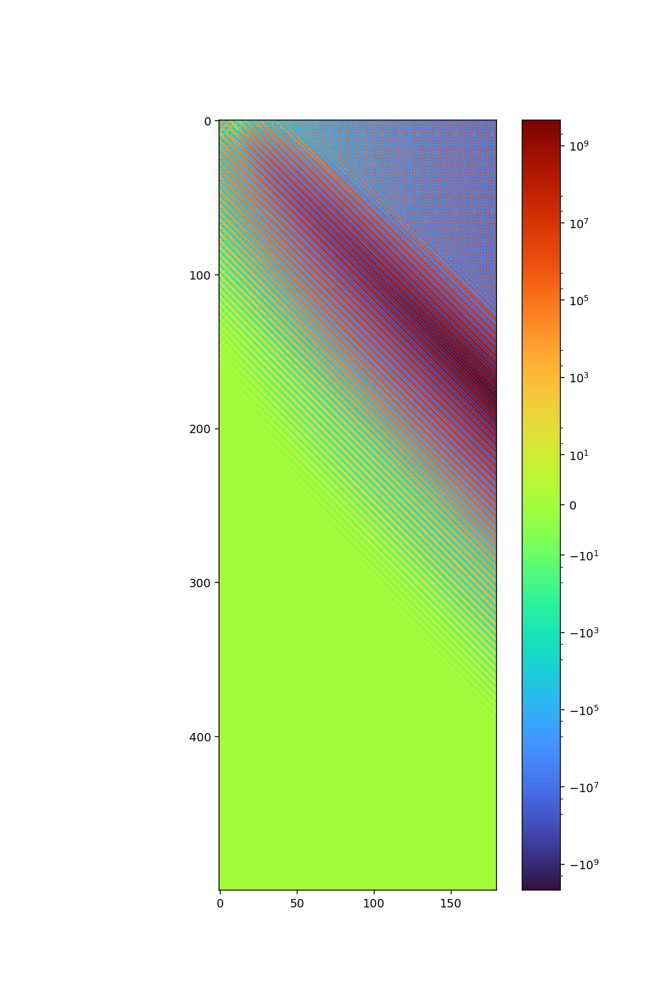

In [521]:
import matplotlib.colors as colors
lnrwidth=1e0
gain=np.max(np.abs(Var_force_fur))

plt.figure(figsize=(8,12))

plt.imshow(Var_force_fur.T[:500], norm=colors.AsinhNorm(linear_width=lnrwidth,
                                             vmin=-gain, vmax=gain), cmap='turbo')
plt.colorbar()

<IPython.core.display.Javascript object>


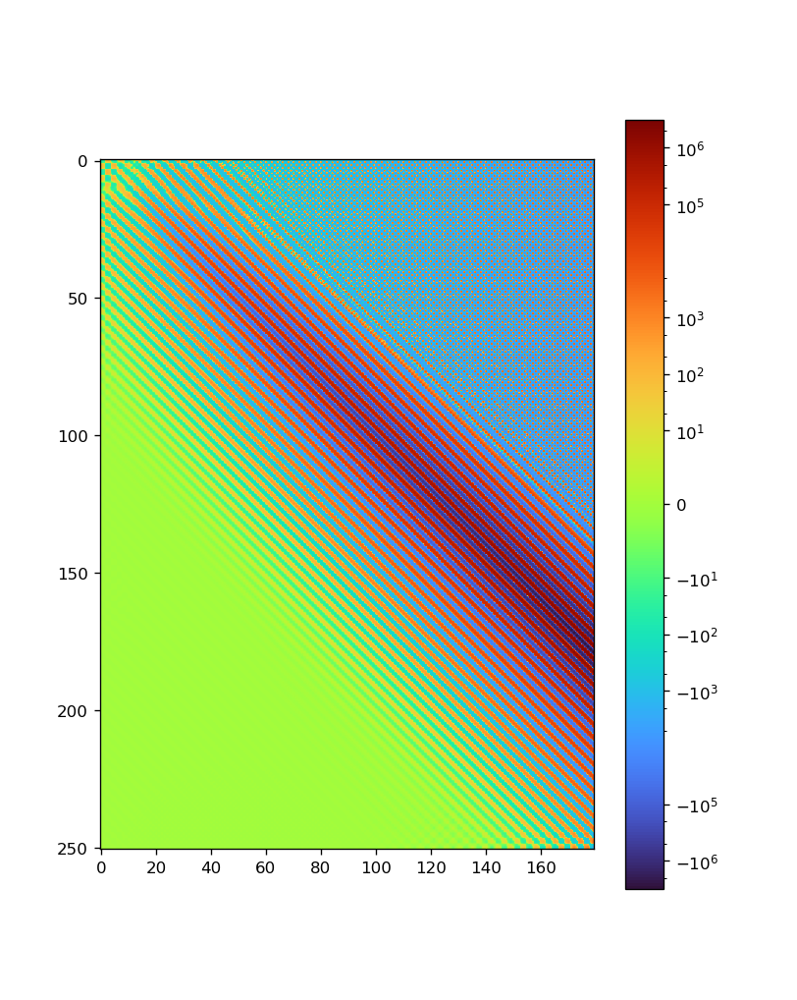

In [611]:
import matplotlib.colors as colors
lnrwidth=1e0
gain=np.max(abs(Var_vl_from_dforce))

plt.figure()

plt.imshow(Var_vl_from_dforce.T, norm=colors.AsinhNorm(linear_width=lnrwidth,
                                             vmin=-gain, vmax=gain), cmap='turbo')
plt.colorbar()

In [597]:
step_arr = np.logspace(-7,-6,N_jac)[::-1]

jac_fun = nd.Jacobian(lambda x: get_velo_norm_without_dforce_with_dN_fur(Pfur_0, Zfur_0, x), step=step_arr)

Var_vl_without_dforce = jac_fun(np.zeros(N_jac))

<IPython.core.display.Javascript object>


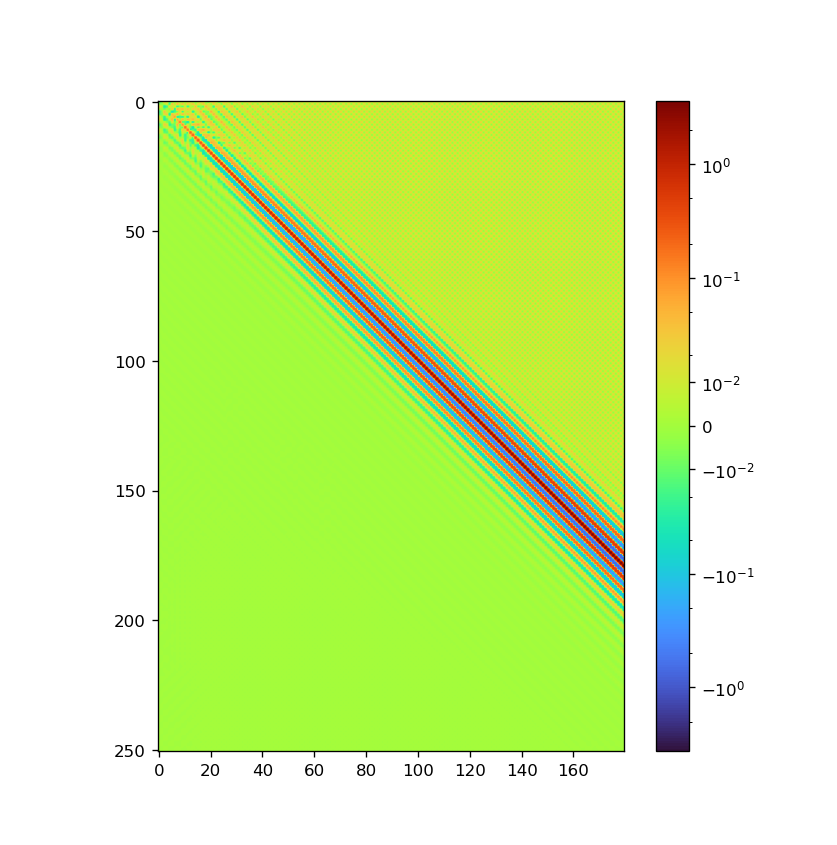

In [612]:
import matplotlib.colors as colors
lnrwidth=1e-2
gain=np.max(abs(Var_vl_without_dforce))

plt.figure()

plt.imshow(Var_vl_without_dforce, norm=colors.AsinhNorm(linear_width=lnrwidth,
                                             vmin=-gain, vmax=gain), cmap='turbo')
plt.colorbar()

In [580]:
J_split = Var_vl_without_dforce + Var_vl_from_dforce.T

In [599]:
J_split_new = Var_vl_without_dforce + Var_vl_from_dforce.T

<IPython.core.display.Javascript object>


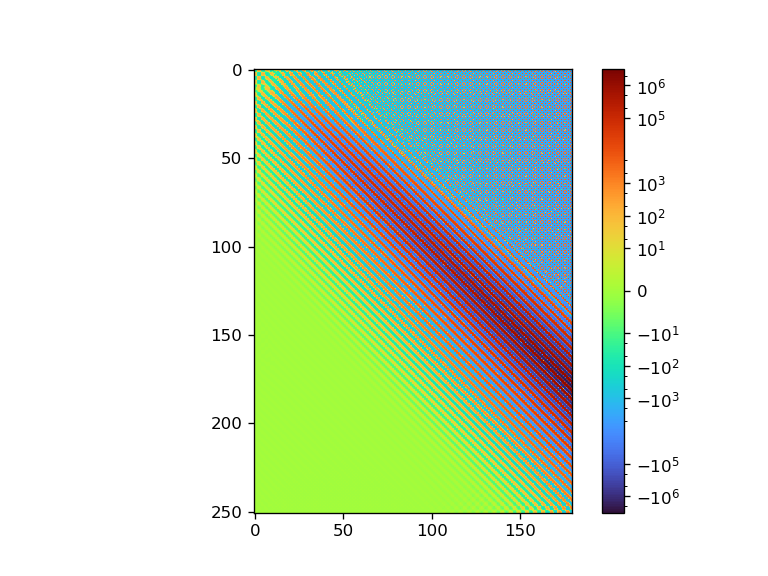

In [581]:
import matplotlib.colors as colors
lnrwidth=1e0
gain=np.max(abs(J_split))

plt.figure()

plt.imshow(J_split, norm=colors.AsinhNorm(linear_width=lnrwidth,
                                             vmin=-gain, vmax=gain), cmap='turbo')
plt.colorbar()

<IPython.core.display.Javascript object>


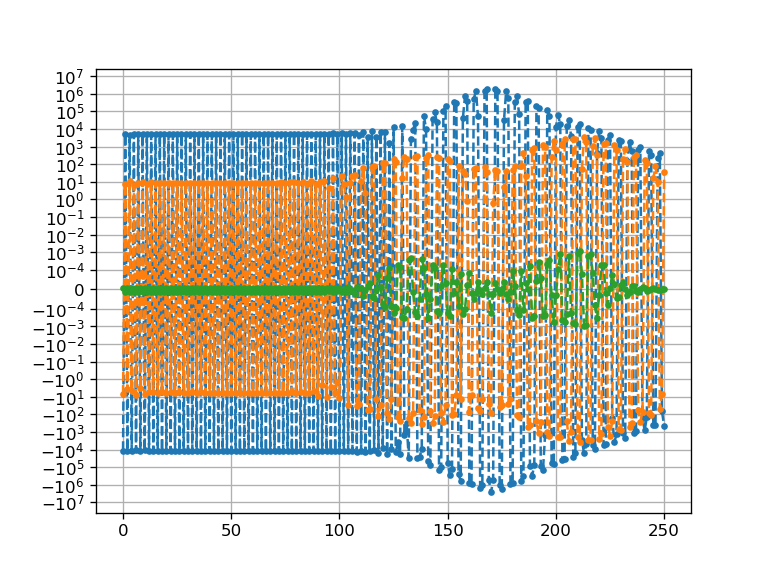

In [607]:
j=170
plt.figure()
plt.plot(J_split[:,j],'.--')
plt.plot(J_split[:,j]-J[:,j],'.--')
plt.plot(J_split_new[:,j]-J_split[:,j],'.--')

plt.yscale('symlog', linthresh=1e-4)
plt.grid()

<IPython.core.display.Javascript object>


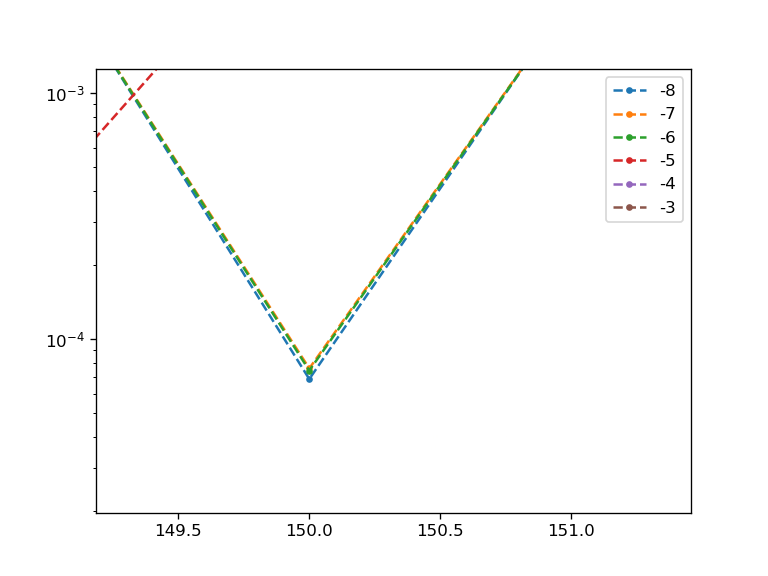

In [213]:
j=10
for log_step in [-8,-7,-6,-5,-4,-3]:
    step=10**log_step
    dn_fur = np.zeros(j+1)
    dn_fur[j]=step
    dvelo = get_velo_norm_fur_full_with_dN_fur(Pfur_0, Zfur_0, dn_fur)-get_velo_norm_fur_full_with_dN_fur(Pfur_0, Zfur_0, -dn_fur)
    grad = dvelo/2/step

    plt.plot(abs(grad),'.--', label=f'{log_step}')
plt.yscale('log') 
plt.legend()

In [550]:
step_arr = np.logspace(-7.5,-5.5,N_jac)[::-1]

In [551]:
jac_fun = nd.Jacobian(lambda x: get_velo_norm_fur_full_with_dN_fur(Pfur_0, Zfur_0, x), step=step_arr)

In [112]:
jac_fun = nd.Jacobian(lambda x: get_velo_norm_fur_full_with_dN_fur(Pfur_0, Zfur_0, x), step=1e-6)

## Stability matrix

In [74]:
pz = np.load('stoma_equilib_Vcal=4.153e-01_N=200.npy')
Pfur_0,Zfur_0 =  get_PZ_fur_from_pz(pz)
N = len(Pfur_0)

In [28]:
N_jac = 180
N_sigma=200

In [29]:
# N=80

# j_N = np.arange(N+1)
# tau_N = j_N/N

n_int = 250
N_int = n_int*10

Tau_int = np.arange(N_int+1)/(N_int);tau_int = np.arange(n_int+1)/(n_int)

dtau_int = tau_int.reshape(-1,1) - Tau_int.reshape(1,-1) 

weights_simp1 = np.zeros_like(Tau_int);weights_simp2 = np.zeros_like(Tau_int)

weights_simp1 +=1;weights_simp1[0]=1/2; weights_simp1[-1]=1/2

weights_simp2[::2] +=1;weights_simp2[::2][0]=1/2; weights_simp2[::2][-1]=1/2

weights_simp = 4/3*weights_simp1 - 2/3*weights_simp2
weights_simp /= N_int

Kron = (np.abs(dtau_int)<1e-7)
AKron = ~Kron

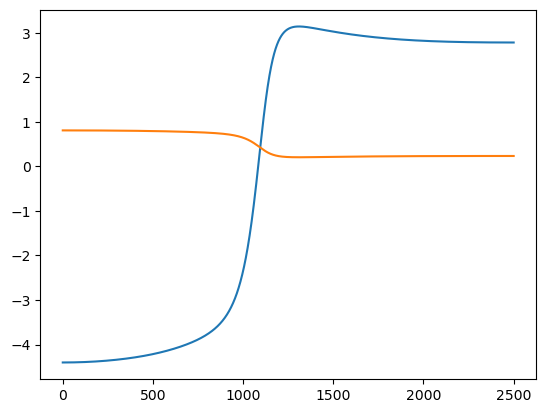

In [83]:
P, P1,P2,P3,P4 = get_int_fields(-1j*Pfur_0)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Zfur_0)
V = np.sqrt(P1**2+Z1**2)
l_rho = -Z1/V;l_z = P1/V;
H, force =get_H_force_from_ar(Pfur_0,Zfur_0)

plt.figure()
plt.plot(H)
plt.plot(force)

<IPython.core.display.Javascript object>


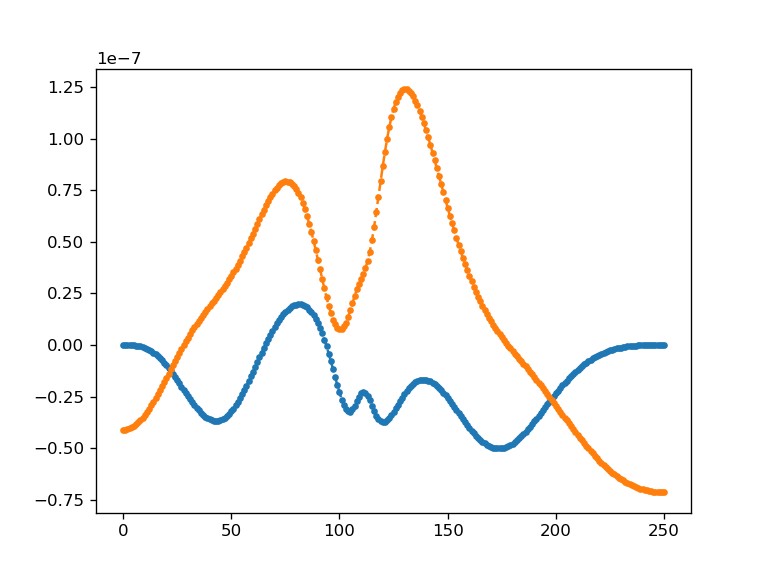

In [658]:
plt.figure()
plt.plot(get_velo(Pfur_0, Zfur_0)[0],'.--')
plt.plot(get_velo(Pfur_0, Zfur_0)[1],'.--')

<IPython.core.display.Javascript object>


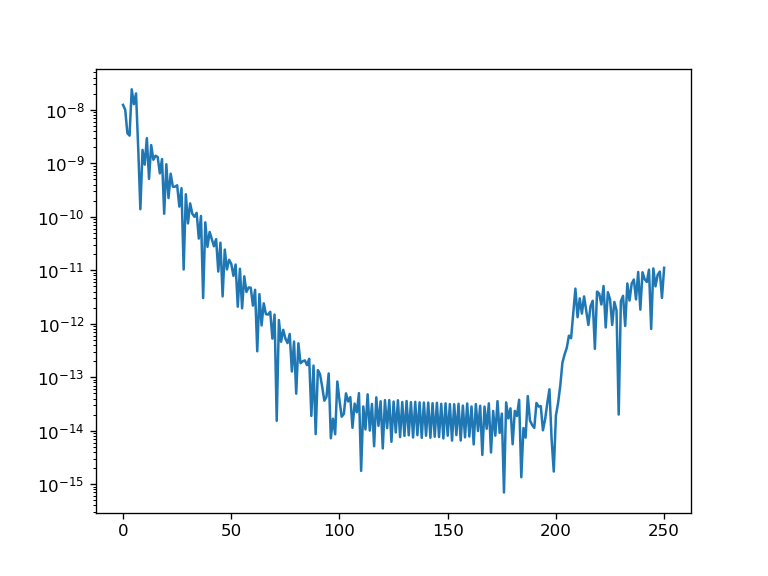

In [659]:
plt.figure()
plt.plot(abs(get_velo_norm_fur_full(Pfur_0, Zfur_0)))
plt.yscale('log')

In [717]:
J = get_J(Pfur_0,Zfur_0, N_jac)

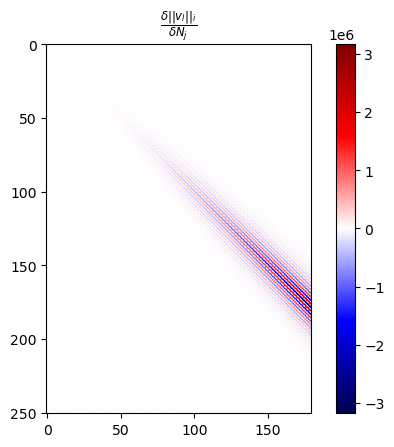

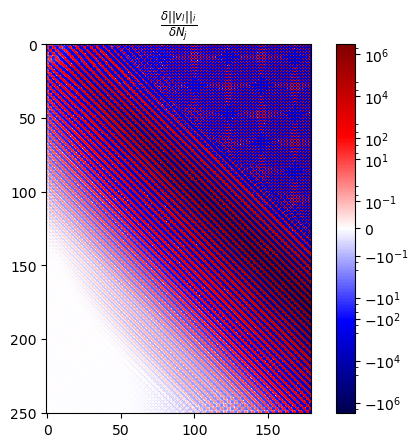

In [68]:

plt.figure()
plt.title(r'$\frac{\delta ||v_l||_i}{\delta N_j}$')
plt.imshow(J, norm=colors.CenteredNorm(0), cmap='seismic')
plt.colorbar()




lnrwidth=1e-2
gain=np.max(abs(J))

plt.figure()
plt.title(r'$\frac{\delta ||v_l||_i}{\delta N_j}$')
plt.imshow(J, norm=colors.AsinhNorm(linear_width=lnrwidth,
                                             vmin=-gain, vmax=gain), cmap='seismic')
plt.colorbar()

In [69]:
w,U = sc.linalg.eig(J[:N_jac])

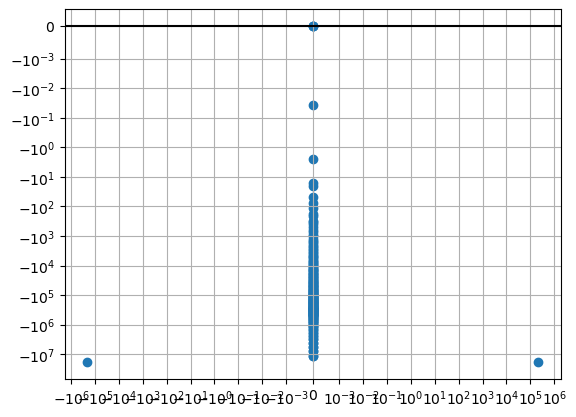

In [70]:
plt.figure()
plt.scatter(w.imag, w.real)
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.xscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

In [71]:
N_jac_arr = np.arange(6,N_jac,1)

w_arr = np.zeros((6,len(N_jac_arr)))

for i in tqdm(range(len(N_jac_arr))):
    N_jac_ = N_jac_arr[i]
    w_,U_ = sc.linalg.eig(J[:N_jac_,:N_jac_])
    w_arr[:,i]=np.sort(w_.real)[-6:]

  0%|          | 0/174 [00:00<?, ?it/s]

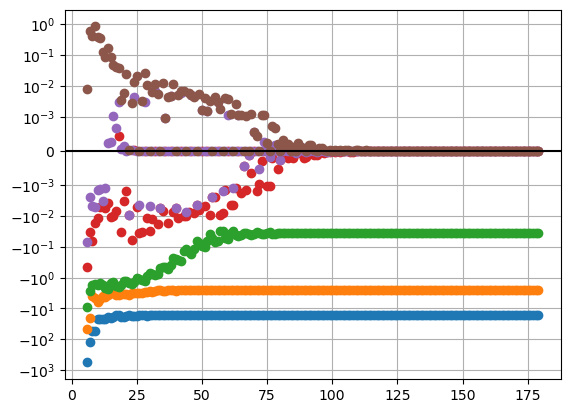

In [72]:
plt.figure()
for i in range(6):
    plt.plot(N_jac_arr,w_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

In [723]:

N_jac_arr = np.arange(10,N_jac,1)

s_arr = np.zeros((10,len(N_jac_arr)))

for i in tqdm(range(len(N_jac_arr))):
    N_jac_ = N_jac_arr[i]
    s = sc.linalg.svdvals(J[:,:N_jac_])
    s_arr[:,i]=np.sort(s.real)[:10]

  0%|          | 0/170 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


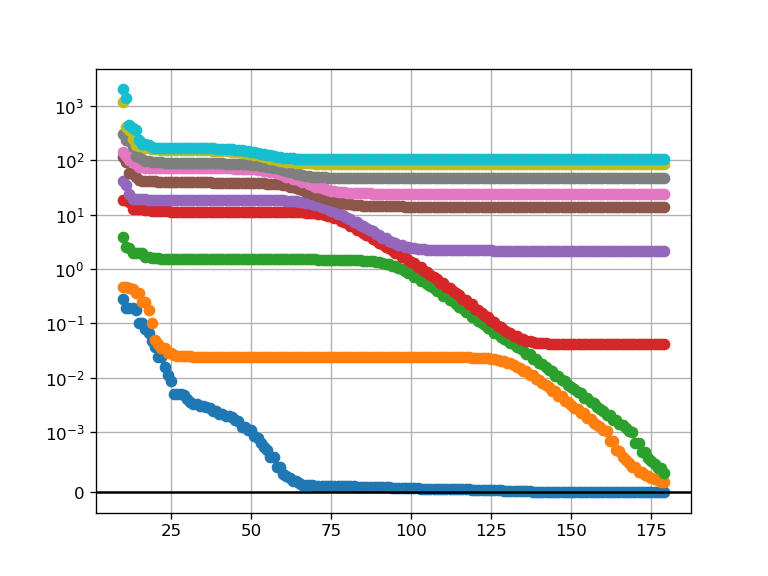

In [724]:
plt.figure()
for i in range(10):
    plt.plot(N_jac_arr,s_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

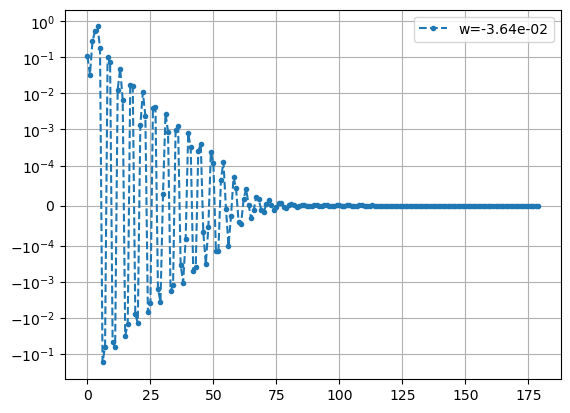

<Figure size 640x480 with 0 Axes>

interactive(children=(IntSlider(value=3, description='m', max=6), IntSlider(value=50, description='scale', min…

In [77]:
@interact(m=(0,6), scale=(10,100,10))
def plot_m_pert(m,scale):
    w_m = np.sort(w)[::-1][m]
    #index_m = np.argmin(np.abs(w - w_m))
    index_m, = np.where(np.isclose(w, w_m))
    
    v_m = U[:, index_m].real.reshape(-1)
    plt.figure()
    plt.plot(v_m, '.--',label=f'w={w_m.real:.2e}')
    plt.yscale('symlog', linthresh=1e-4)
    plt.legend(loc='upper right')
    plt.grid()
    
    v_m /= scale
    dN = get_int_field(v_m)
    plt.figure()
    
    P_corr = P+l_rho*dN; Z_corr = Z+l_z*dN
    plt.plot(np.hstack([-P[::-1],P]),np.hstack([Z[::-1],Z]),'--')
    plt.plot(np.hstack([-P_corr[::-1],P_corr]),np.hstack([Z_corr[::-1],Z_corr]))
    
    plt.title(f'w={w_m.real:.2e}')
    plt.axvline(0, color='k', lw=1)
    plt.axis('scaled')
    
    

#### In natural gauge

In [80]:
Pfur_0_g,Zfur_0_g = make_constant_v_repar(Pfur_0,Zfur_0, 700)

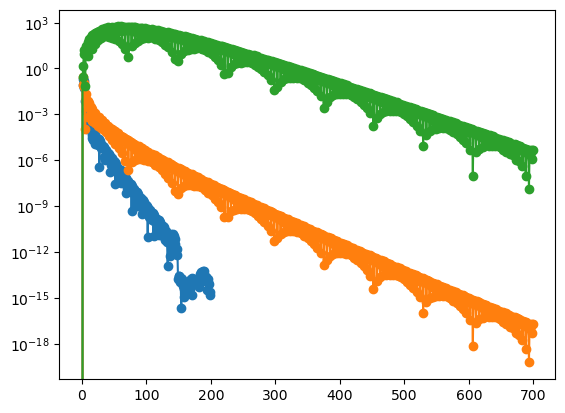

In [81]:
plt.figure()
plt.plot(abs(Pfur_0),'o-')
plt.plot(abs(Pfur_0_g),'o-')
plt.plot(np.arange(len(Pfur_0_g))**4*abs(Pfur_0_g),'o-')

plt.yscale('log')

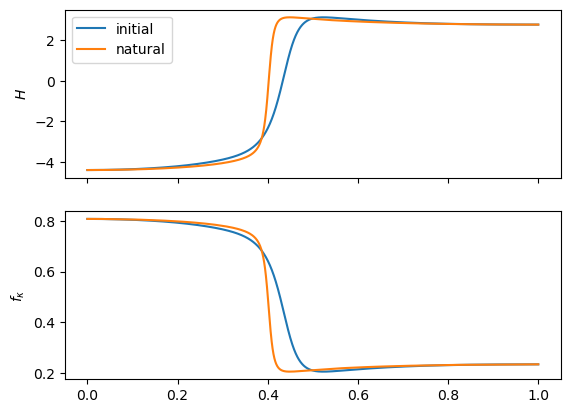

In [84]:
H_g, force_g =get_H_force_from_ar(Pfur_0_g,Zfur_0_g)

fig,axs = plt.subplots(2,1, sharex=True)
axs[0].plot(Tau_int,H)
axs[0].plot(Tau_int,H_g)
axs[0].set_ylabel(r'$H$')
axs[1].plot(Tau_int,force)
axs[1].plot(Tau_int,force_g)
axs[1].set_ylabel(r'$f_\kappa$')

axs[0].legend(['initial','natural'])

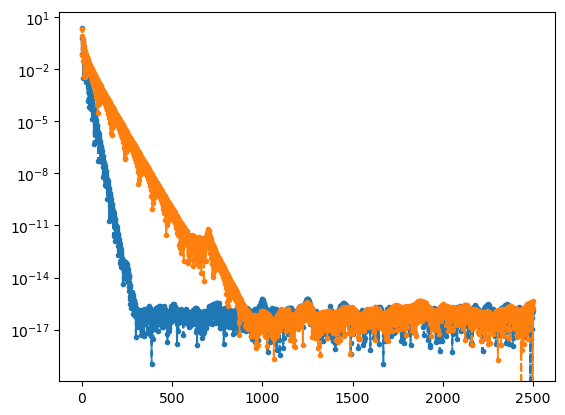

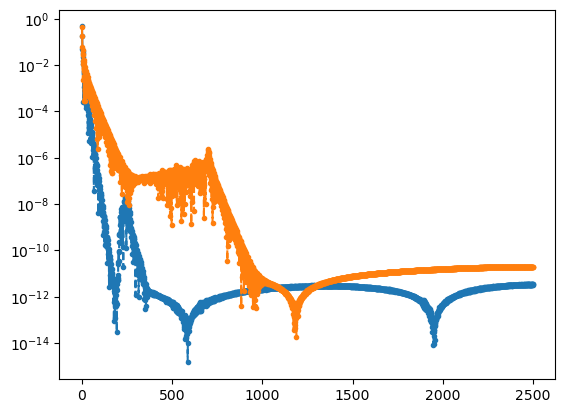

In [89]:
plt.figure()
plt.plot(abs(np.fft.rfft(get_ext_array(H), norm='forward').real),'.--')
plt.plot(abs(np.fft.rfft(get_ext_array(H_g), norm='forward').real),'.--')
plt.yscale('log')

plt.figure()
plt.plot(abs(np.fft.rfft(get_ext_array(force), norm='forward').real),'.--')
plt.plot(abs(np.fft.rfft(get_ext_array(force_g), norm='forward').real),'.--')
plt.yscale('log')

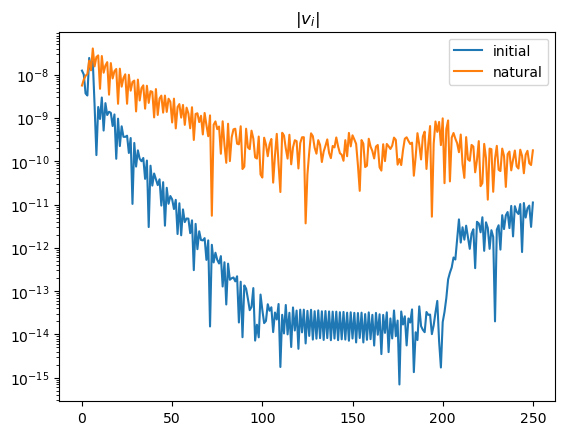

In [85]:
plt.figure()
plt.title(r'$|v_i|$')
plt.plot(abs(get_velo_norm_fur_full(Pfur_0, Zfur_0)))
plt.plot(abs(get_velo_norm_fur_full(Pfur_0_g, Zfur_0_g)))
plt.legend(['initial','natural'])
plt.yscale('log')

In [158]:
dforce_arr = get_dforce_arr(Pfur_0,Zfur_0, N_jac)
dforce_arr_g = get_dforce_arr(Pfur_0_g,Zfur_0_g, N_jac)


<IPython.core.display.Javascript object>


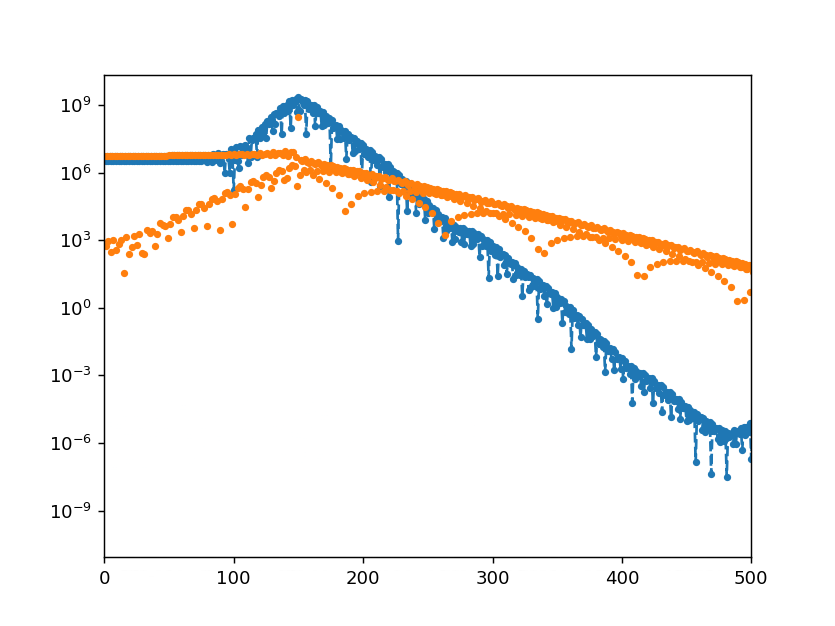

<IPython.core.display.Javascript object>


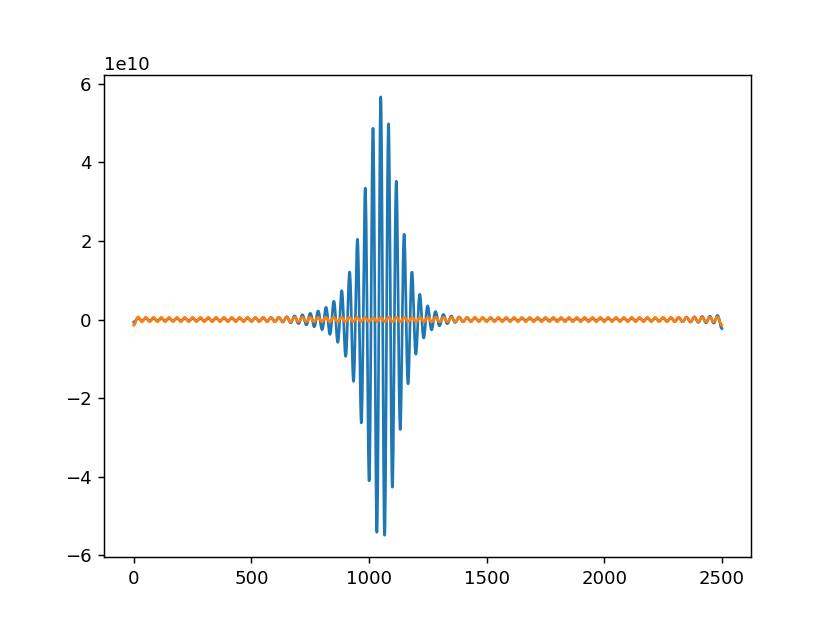

In [167]:
plt.figure()
j=150
plt.plot(abs(Var_force[:,j]),'.--')
plt.plot(abs(Var_force_g[:,j]),'.')
plt.yscale('log')
plt.xlim(0,500)

plt.figure()
plt.plot(dforce_arr[j])
plt.plot(dforce_arr_g[j])

In [149]:
Var_vl_from_dforce = get_Var_vl_from_dforce(Pfur_0,Zfur_0, N_jac).T

In [150]:
Var_vl_from_dforce_g = get_Var_vl_from_dforce(Pfur_0_g,Zfur_0_g, N_jac).T

<IPython.core.display.Javascript object>


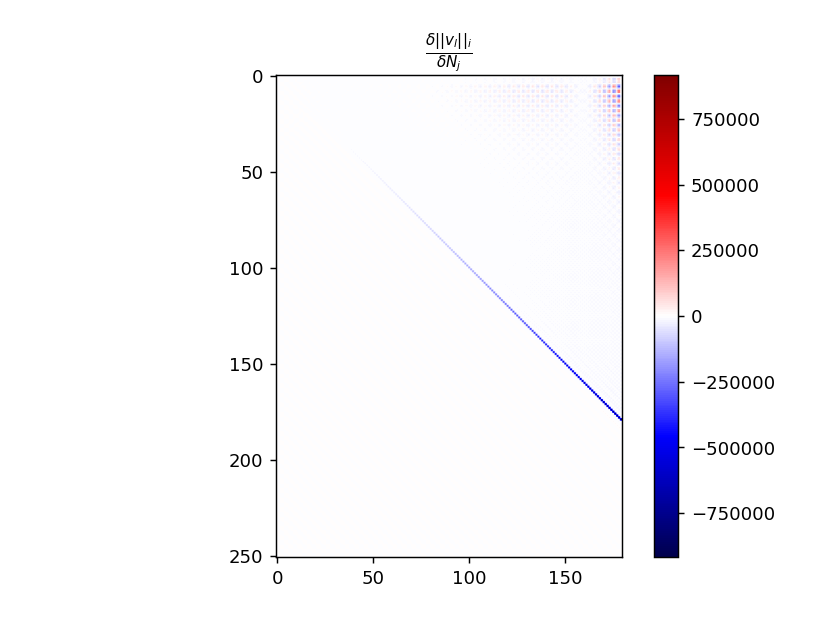

<IPython.core.display.Javascript object>


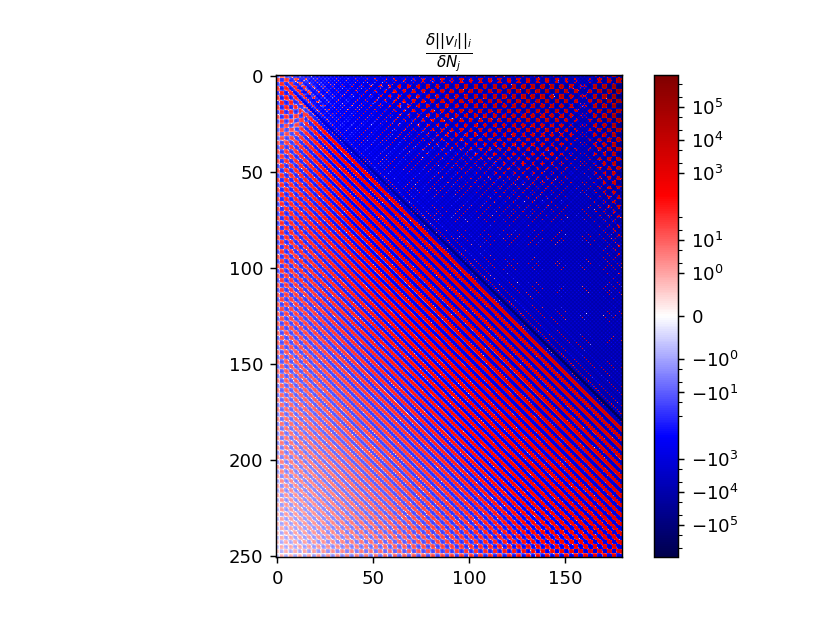

In [151]:
%matplotlib notebook
plt.figure()
plt.title(r'$\frac{\delta ||v_l||_i}{\delta N_j}$')
plt.imshow(Var_vl_from_dforce_g, norm=colors.CenteredNorm(0), cmap='seismic')
plt.colorbar()

import matplotlib.colors as colors
lnrwidth=1e-1
gain=np.max(abs(Var_vl_from_dforce_g))

plt.figure()
plt.title(r'$\frac{\delta ||v_l||_i}{\delta N_j}$')
plt.imshow(Var_vl_from_dforce_g, norm=colors.AsinhNorm(linear_width=lnrwidth,
                                             vmin=-gain, vmax=gain), cmap='seismic')
plt.colorbar()

<IPython.core.display.Javascript object>


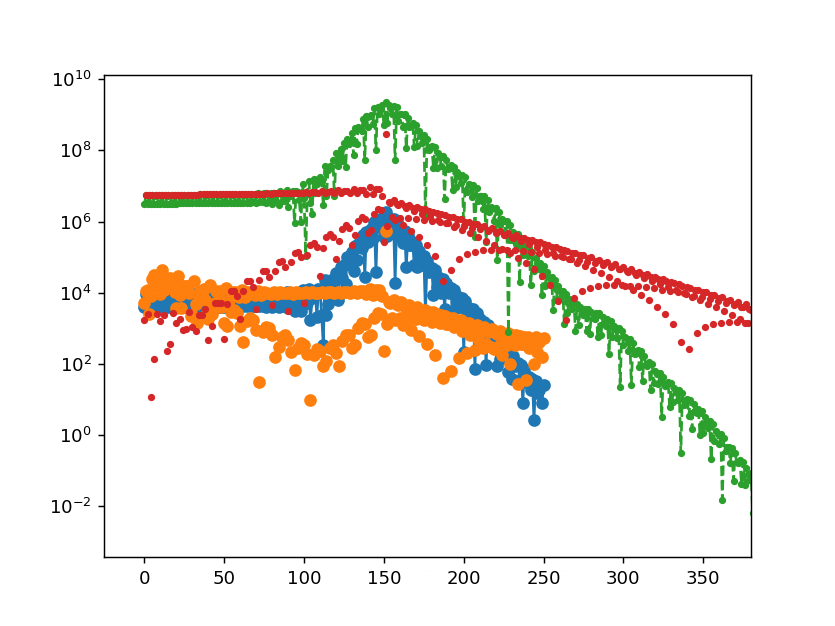

(0.0, 500.0)

In [157]:
plt.figure()
j=151
plt.plot(abs(Var_vl_from_dforce[:,j]),'o-')
plt.plot(abs(Var_vl_from_dforce_g[:,j]),'o')

plt.plot(abs(Var_force[:,j]),'.--')
plt.plot(abs(Var_force_g[:,j]),'.')
plt.yscale('log')
plt.xlim(0,500)

In [742]:
jac_fun = nd.Jacobian(lambda x: get_velo_norm_fur_full_with_dN_fur(Pfur_0_g, Zfur_0_g, x), step=1e-6)
J_g_old = jac_fun(np.zeros(N_jac))

In [130]:
J_g_ = get_J(Pfur_0_g,Zfur_0_g, N_jac)

<IPython.core.display.Javascript object>


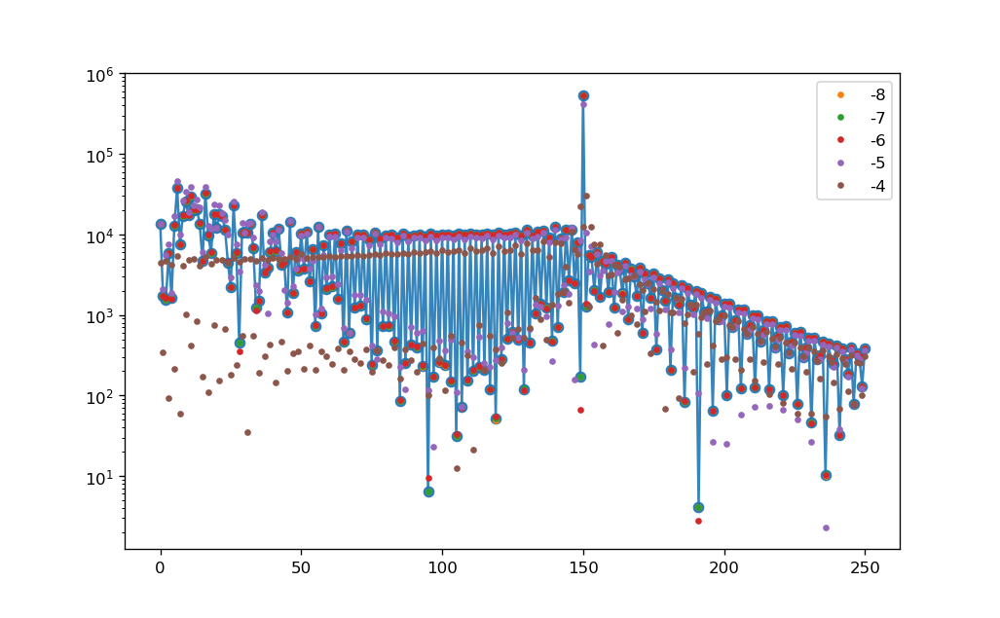

In [145]:
plt.figure()
j=150
plt.plot(abs(J_g[:,j]),'o-',alpha=0.9)

for log_step in [-8,-7,-6,-5,-4]:
    step=10**log_step
    dn_fur = np.zeros(j+1)
    dn_fur[j]=step
    dvelo = get_velo_norm_fur_full_with_dN_fur(Pfur_0_g, Zfur_0_g, dn_fur)-get_velo_norm_fur_full_with_dN_fur(Pfur_0_g, Zfur_0_g, -dn_fur)
    grad = dvelo/2/step

    plt.plot(abs(grad),'.', label=f'{log_step}')
plt.yscale('log') 
plt.legend()


#plt.plot(J[:,j],'.--')


<IPython.core.display.Javascript object>


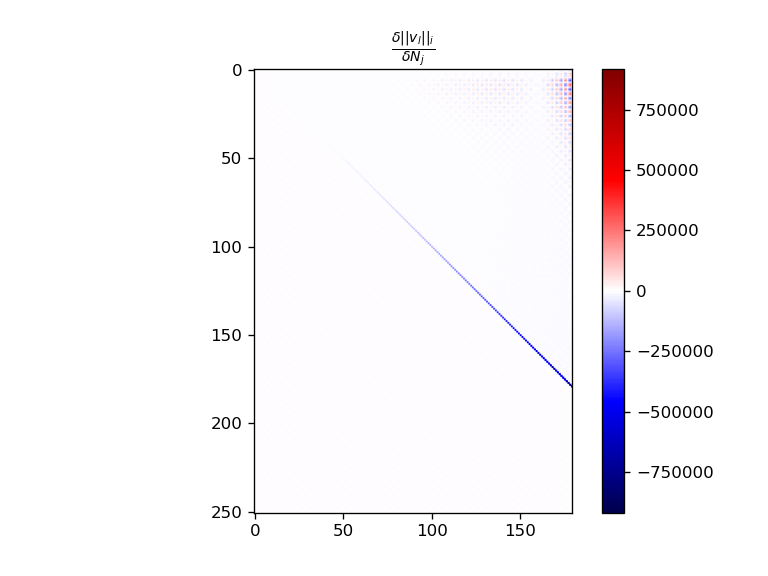

<IPython.core.display.Javascript object>


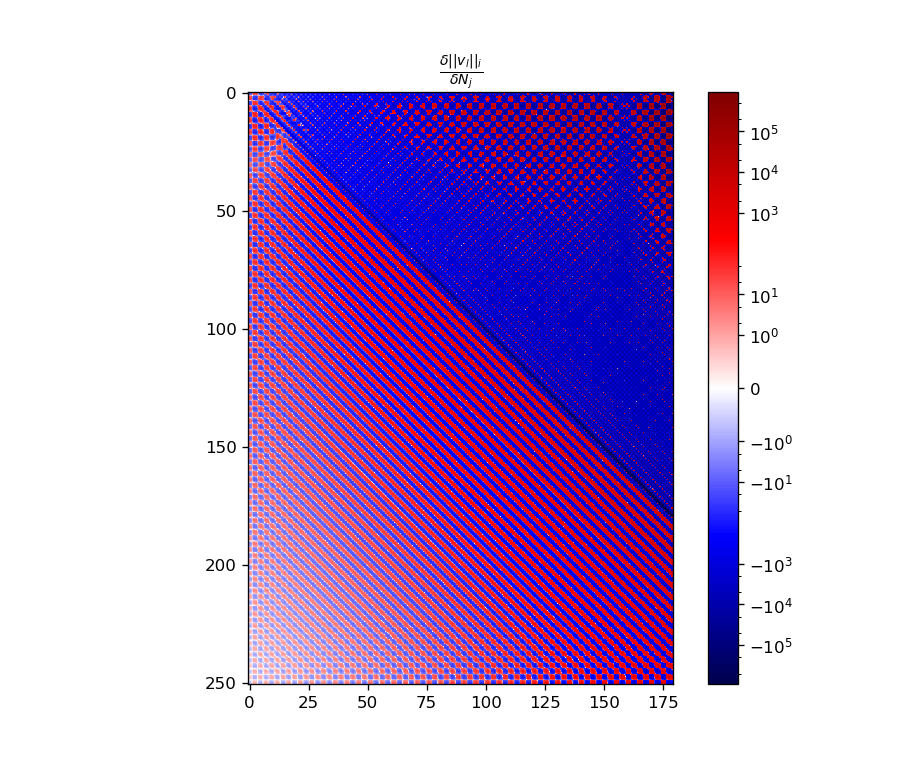

In [92]:
%matplotlib notebook
plt.figure()
plt.title(r'$\frac{\delta ||v_l||_i}{\delta N_j}$')
plt.imshow(J_g, norm=colors.CenteredNorm(0), cmap='seismic')
plt.colorbar()

import matplotlib.colors as colors
lnrwidth=1e-1
gain=np.max(abs(J_g))

plt.figure()
plt.title(r'$\frac{\delta ||v_l||_i}{\delta N_j}$')
plt.imshow(J_g, norm=colors.AsinhNorm(linear_width=lnrwidth,
                                             vmin=-gain, vmax=gain), cmap='seismic')
plt.colorbar()

In [110]:
Var_force_g = get_Var_force_dN(Pfur_0_g,Zfur_0_g, N_jac).T

In [115]:
Var_force = get_Var_force_dN(Pfur_0,Zfur_0, N_jac).T

<IPython.core.display.Javascript object>


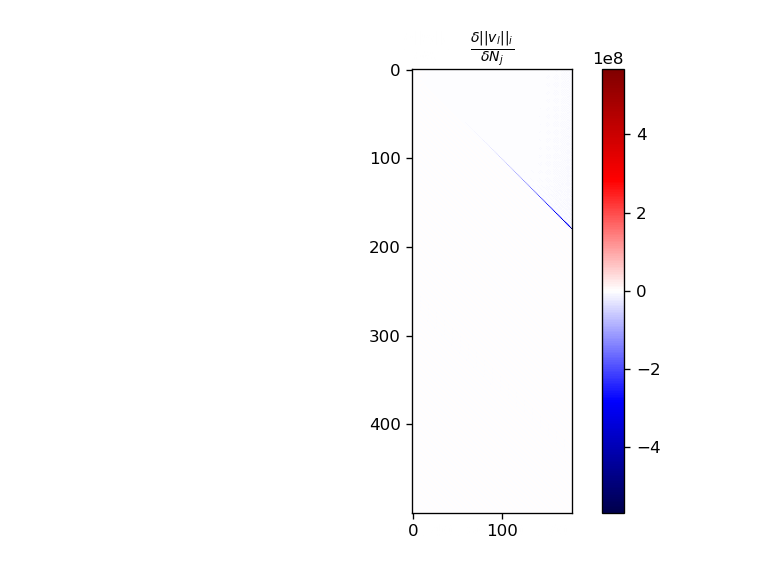

<IPython.core.display.Javascript object>


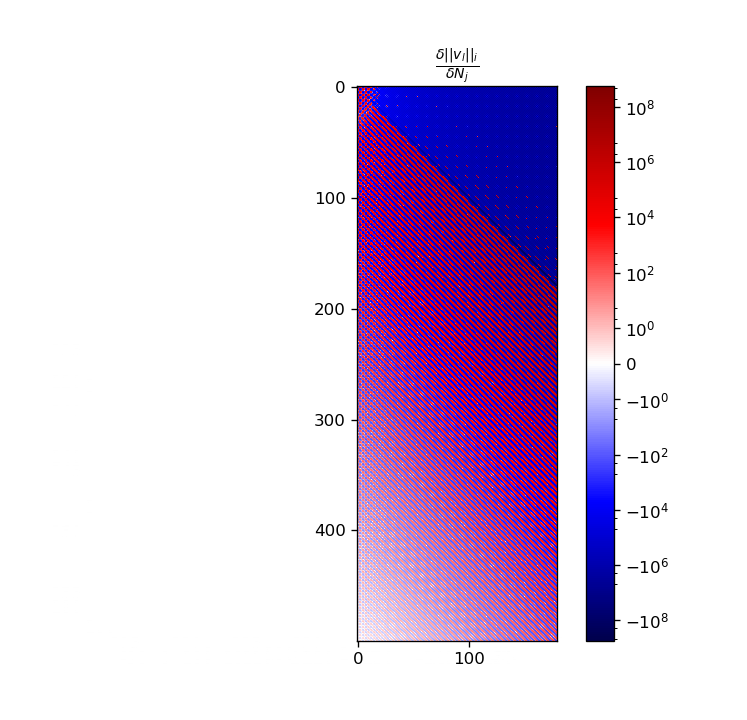

In [111]:
%matplotlib notebook
plt.figure()
plt.title(r'$\frac{\delta ||v_l||_i}{\delta N_j}$')
plt.imshow(Var_force_g[:500], norm=colors.CenteredNorm(0), cmap='seismic')
plt.colorbar()

import matplotlib.colors as colors
lnrwidth=1e-1
gain=np.max(abs(Var_force_g))

plt.figure()
plt.title(r'$\frac{\delta ||v_l||_i}{\delta N_j}$')
plt.imshow(Var_force_g[:500], norm=colors.AsinhNorm(linear_width=lnrwidth,
                                             vmin=-gain, vmax=gain), cmap='seismic')
plt.colorbar()

<IPython.core.display.Javascript object>


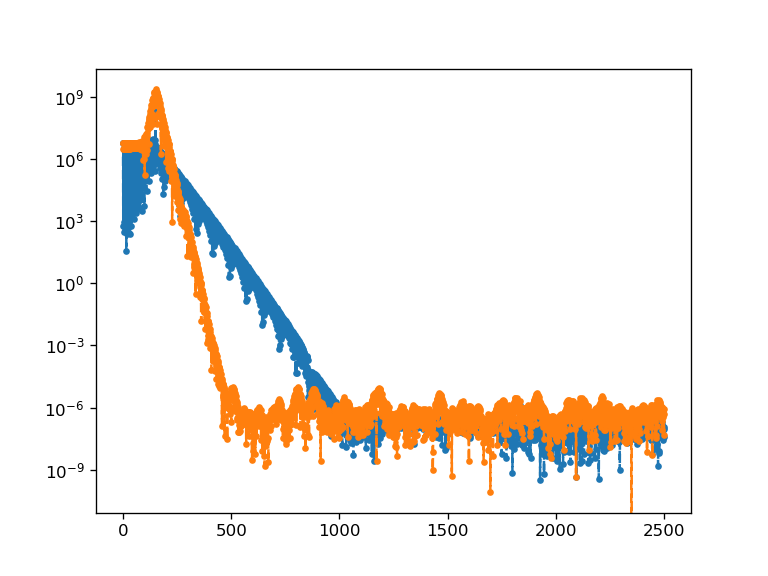

In [121]:
plt.figure()
j=150
plt.plot(abs(Var_force_g[:,j]),'.--')
plt.plot(abs(Var_force[:,j]),'.--')

plt.yscale('log')

In [775]:
w_g_old,U_g_old = sc.linalg.eig(J_g_old[:N_jac])

In [122]:
w_g,U_g = sc.linalg.eig(J_g[:N_jac])

<IPython.core.display.Javascript object>


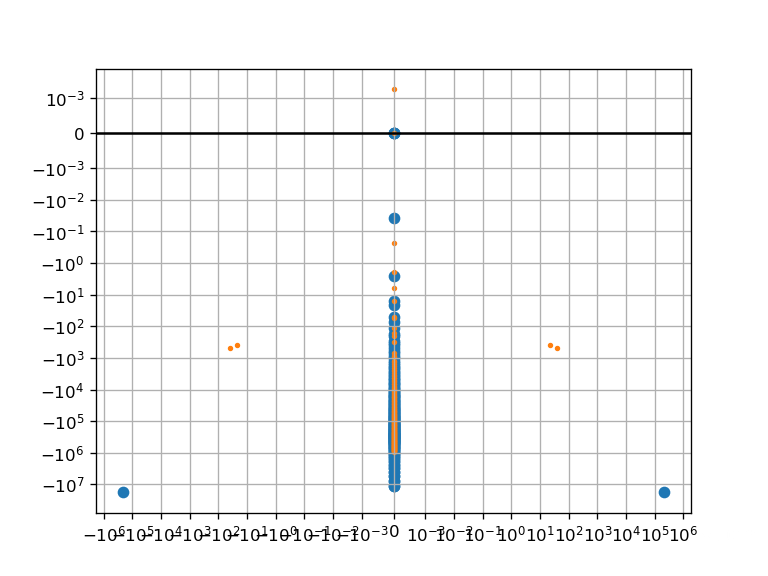

In [126]:
plt.figure()
plt.scatter(w.imag, w.real)
plt.scatter(w_g.imag, w_g.real, s=5)
#plt.scatter(w_g_old.imag, w_g_old.real)

#plt.legend(['initial','natural', 'natural old'])

plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.xscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

In [127]:
N_jac_arr = np.arange(6,N_jac,1)

w_arr = np.zeros((6,len(N_jac_arr)))

for i in tqdm(range(len(N_jac_arr))):
    N_jac_ = N_jac_arr[i]
    w_,U_ = sc.linalg.eig(J_g[:N_jac_,:N_jac_])
    w_arr[:,i]=np.sort(w_.real)[-6:]

  0%|          | 0/174 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


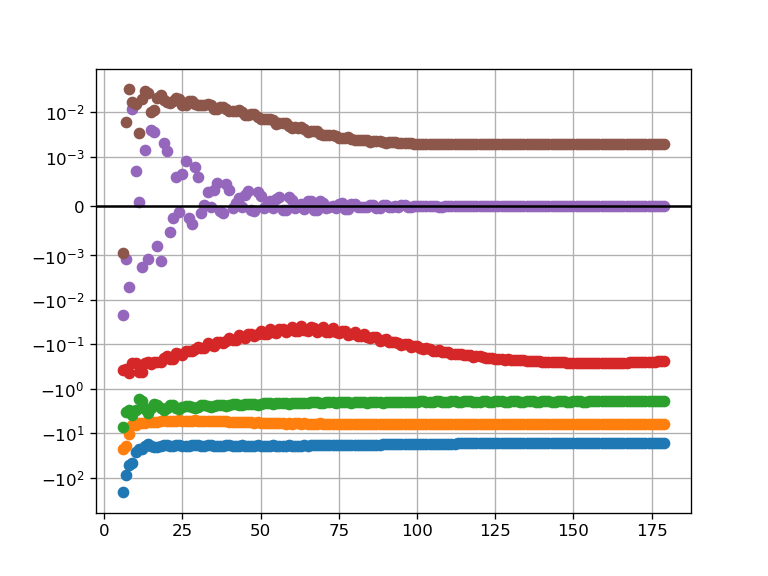

In [128]:
plt.figure()
for i in range(6):
    plt.plot(N_jac_arr,w_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

<IPython.core.display.Javascript object>


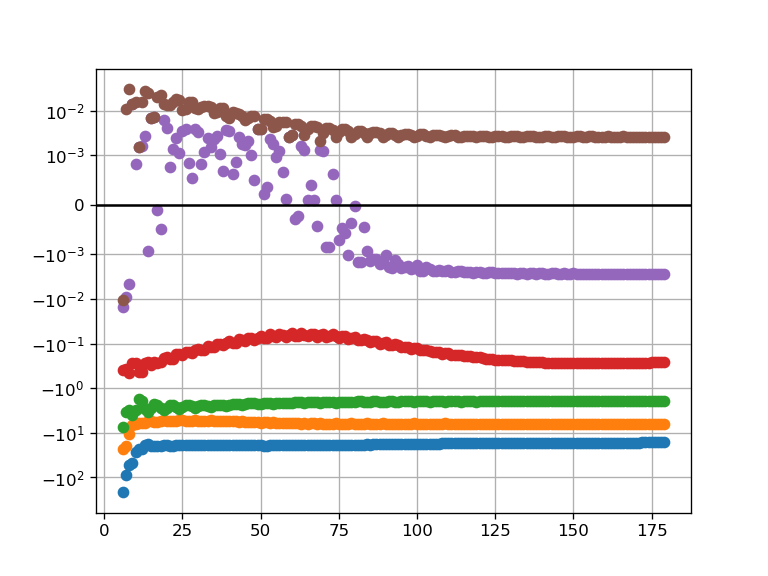

In [737]:
plt.figure()
for i in range(6):
    plt.plot(N_jac_arr,w_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

<IPython.core.display.Javascript object>


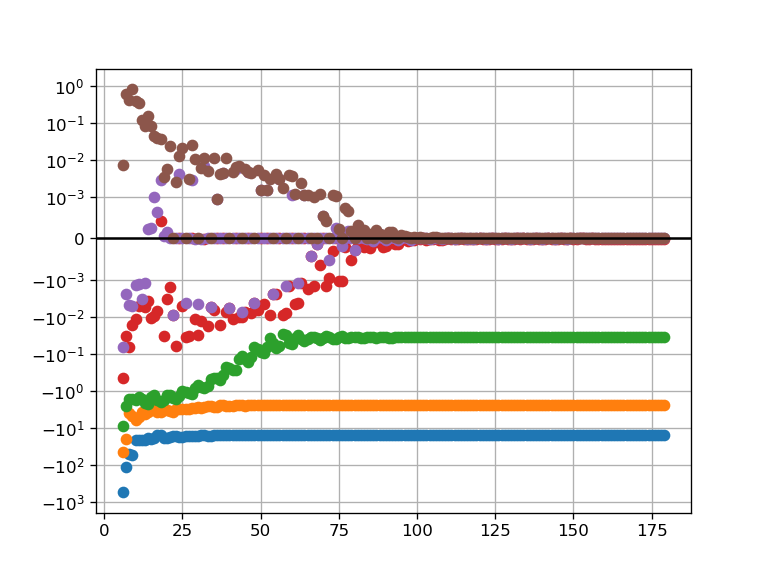

In [664]:
plt.figure()
for i in range(6):
    plt.plot(N_jac_arr,w_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

In [665]:

N_jac_arr = np.arange(10,N_jac,1)

s_arr = np.zeros((10,len(N_jac_arr)))

for i in tqdm(range(len(N_jac_arr))):
    N_jac_ = N_jac_arr[i]
    s = sc.linalg.svdvals(J[:,:N_jac_])
    s_arr[:,i]=np.sort(s.real)[:10]

  0%|          | 0/170 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


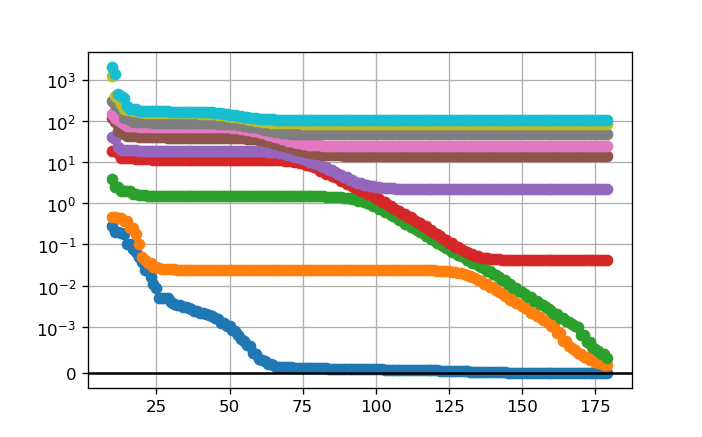

In [666]:
plt.figure()
for i in range(10):
    plt.plot(N_jac_arr,s_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

In [681]:
@interact(m=(0,6), scale=(10,100,10))
def plot_m_pert(m,scale):
    w_m = np.sort(w)[::-1][m]
    #index_m = np.argmin(np.abs(w - w_m))
    index_m, = np.where(np.isclose(w, w_m))
    
    v_m = U[:, index_m].real.reshape(-1)
    plt.figure()
    plt.plot(v_m, '.--',label=f'w={w_m.real:.2e}')
    plt.yscale('symlog', linthresh=1e-4)
    plt.legend(loc='upper right')
    plt.grid()
    
    v_m /= scale
    dN = get_int_field(v_m)
    plt.figure()
    
    P_corr = P+l_rho*dN; Z_corr = Z+l_z*dN
    plt.plot(np.hstack([-P[::-1],P]),np.hstack([Z[::-1],Z]),'--')
    plt.plot(np.hstack([-P_corr[::-1],P_corr]),np.hstack([Z_corr[::-1],Z_corr]))
    
    plt.title(f'w={w_m.real:.2e}')
    plt.axvline(0, color='k', lw=1)
    plt.axis('scaled')
    
    

interactive(children=(IntSlider(value=3, description='m', max=6), IntSlider(value=50, description='scale', min…

#### 1d loc gauge

In [169]:
H1,dl_H1 = get_H1_dl_H1_from_ar(Pfur_0, Zfur_0)
_,H2 = get_H12_from_ar(Pfur_0, Zfur_0)
a_loc = 1/(H1**4 + dl_H1**2)**(1/4)

In [170]:
Pfur_0_g_loc,Zfur_0_g_loc = make_F_v_repar(Pfur_0, Zfur_0, a_loc,N_proj=400)

<IPython.core.display.Javascript object>


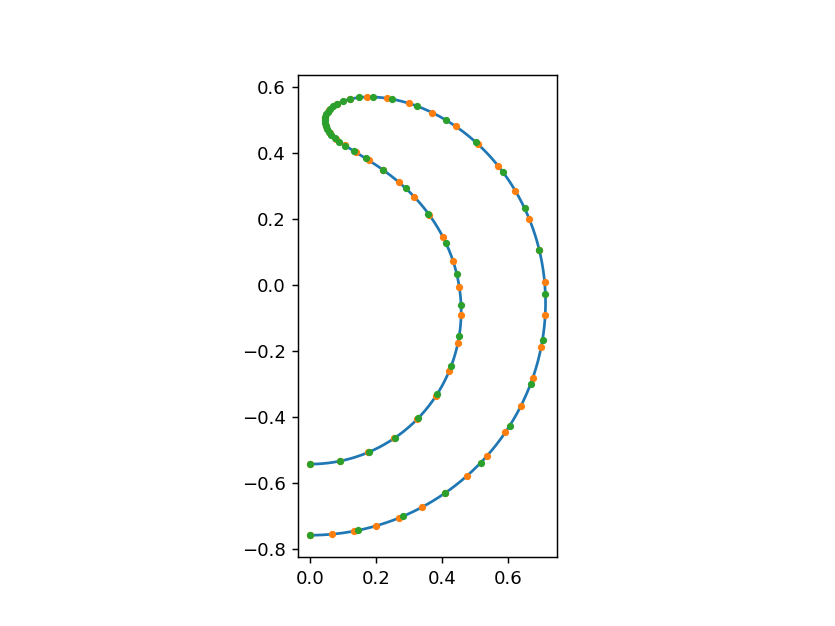

(-0.03566062604715081,
 0.748873146990167,
 -0.8255019841589056,
 0.6348591024176173)

In [171]:
P0= get_int_field(-1j*Pfur_0);Z0 = get_int_field(Zfur_0)
P0_g_loc= get_int_field(-1j*Pfur_0_g_loc);Z0_g_loc = get_int_field(Zfur_0_g_loc)

plt.figure()
plt.plot(P0,Z0)

plt.plot(P0[::50],Z0[::50],'.')
plt.plot(P0_g_loc[::50], Z0_g_loc[::50],'.')
plt.axis('scaled')

<IPython.core.display.Javascript object>


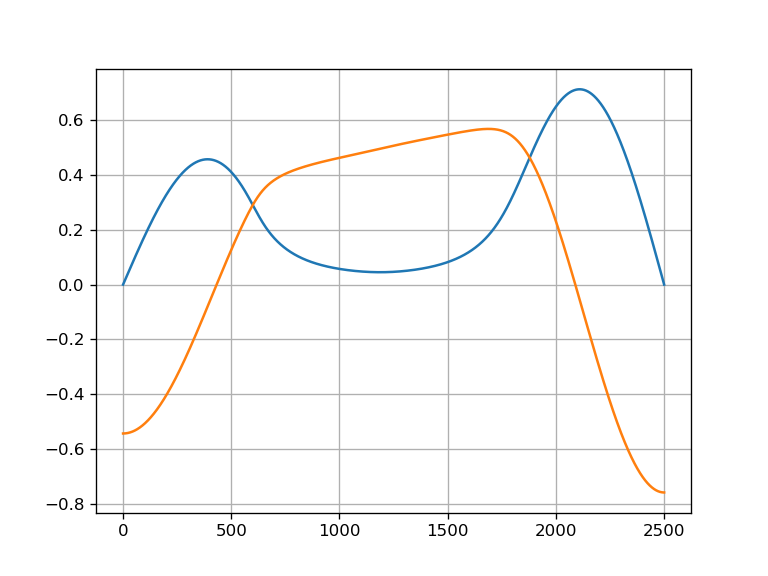

In [765]:
plt.figure()
plt.plot(P0_g_loc)
plt.plot(Z0_g_loc)
plt.grid()

<IPython.core.display.Javascript object>


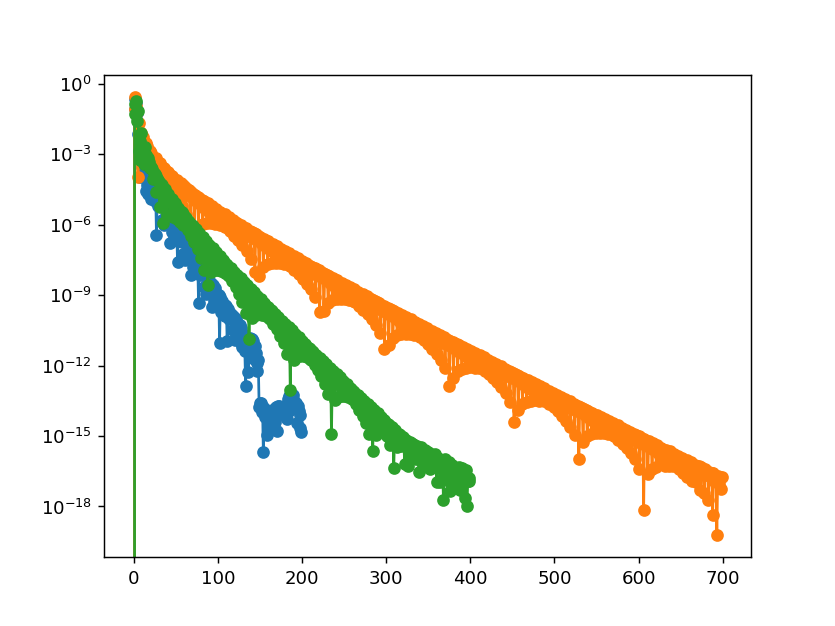

In [172]:
plt.figure()
plt.plot(abs(Pfur_0),'o-')
plt.plot(abs(Pfur_0_g),'o-')
plt.plot(abs(Pfur_0_g_loc),'o-')

plt.yscale('log')

<IPython.core.display.Javascript object>


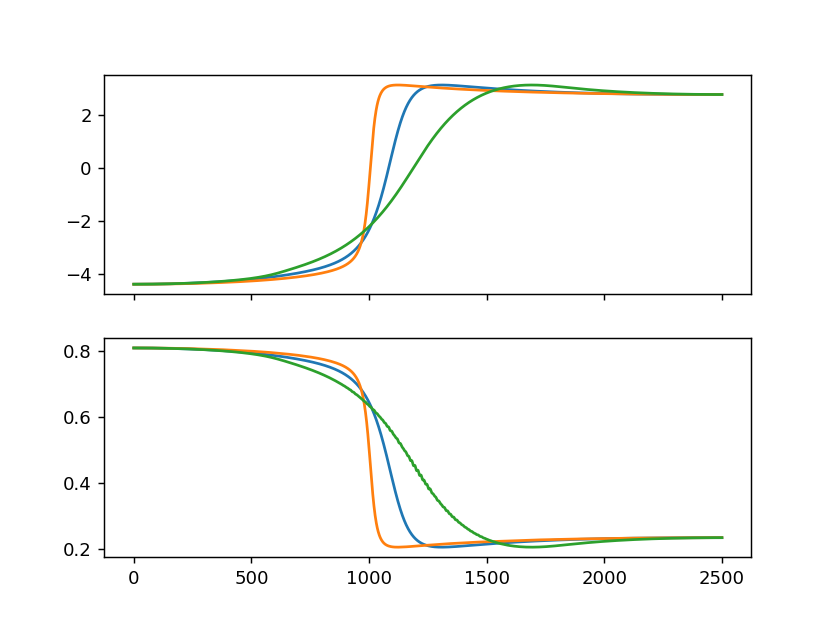

In [173]:
H_g_loc, force_g_loc =get_H_force_from_ar(Pfur_0_g_loc[:],Zfur_0_g_loc[:])

fig,axs = plt.subplots(2,1, sharex=True)
axs[0].plot(H)
axs[0].plot(H_g)
axs[0].plot(H_g_loc)

axs[1].plot(force)
axs[1].plot(force_g)
axs[1].plot(force_g_loc)


<IPython.core.display.Javascript object>


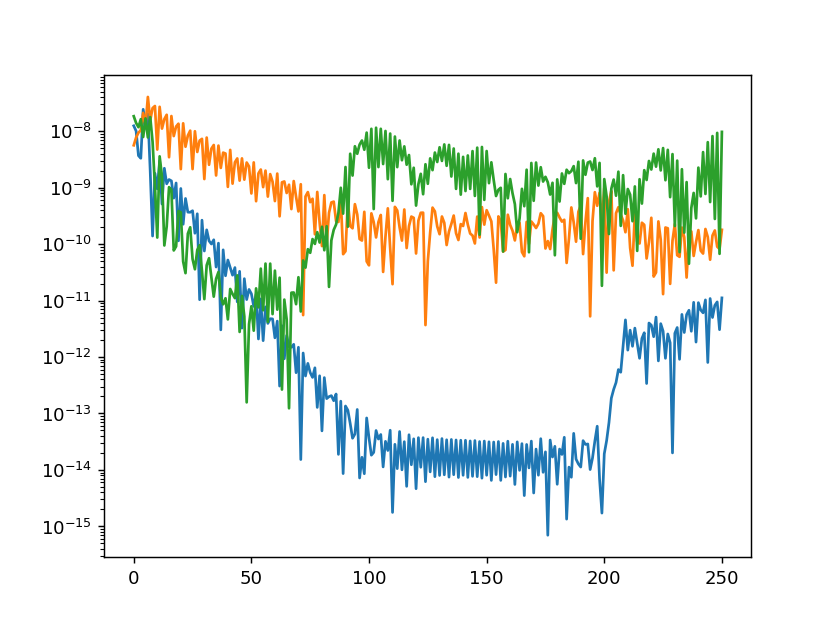

In [174]:
plt.figure()
plt.plot(abs(get_velo_norm_fur_full(Pfur_0, Zfur_0)))
plt.plot(abs(get_velo_norm_fur_full(Pfur_0_g, Zfur_0_g)))
plt.plot(abs(get_velo_norm_fur_full(Pfur_0_g_loc, Zfur_0_g_loc)))

plt.yscale('log')

In [739]:
jac_fun = nd.Jacobian(lambda x: get_velo_norm_fur_full_with_dN_fur(Pfur_0_g_loc, Zfur_0_g_loc, x), step=1e-6)

In [175]:
J_g_loc = get_J(Pfur_0_g_loc,Zfur_0_g_loc, N_jac)

<IPython.core.display.Javascript object>


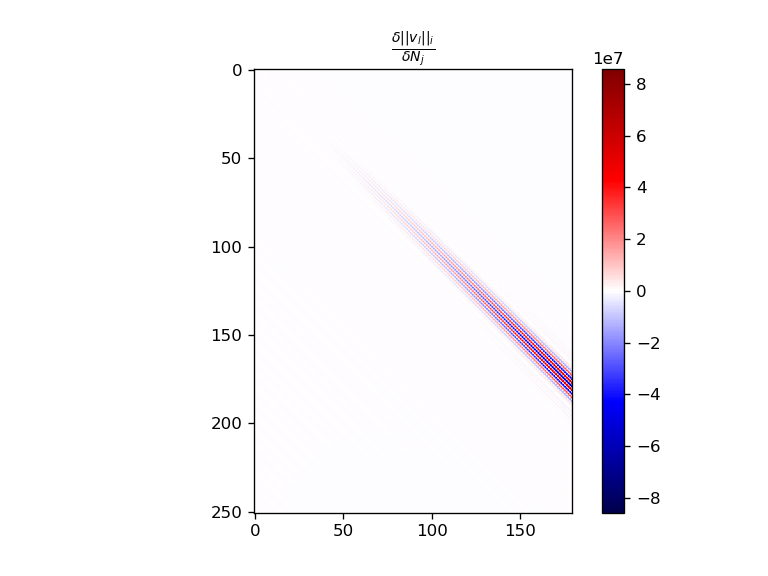

<IPython.core.display.Javascript object>


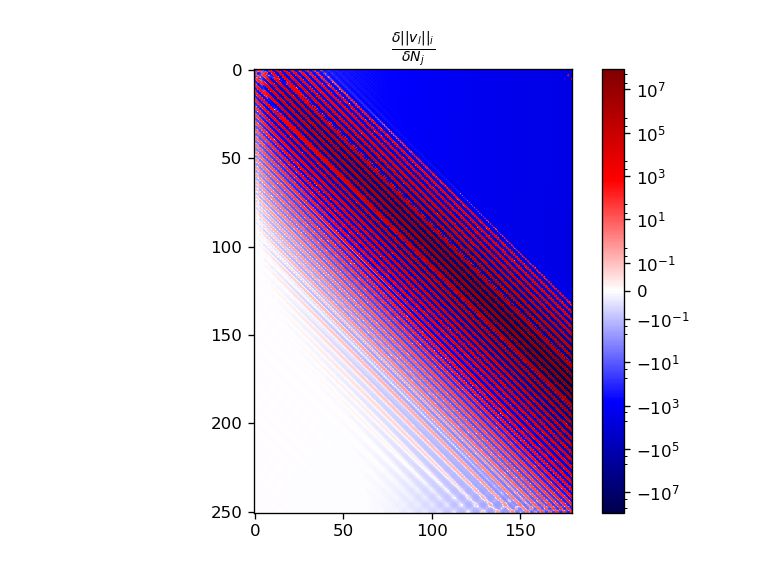

In [771]:
plt.figure()
plt.title(r'$\frac{\delta ||v_l||_i}{\delta N_j}$')
plt.imshow(J_g_loc, norm=colors.CenteredNorm(0), cmap='seismic')
plt.colorbar()




import matplotlib.colors as colors
lnrwidth=1e-2
gain=np.max(abs(J_g_loc))

plt.figure()
plt.title(r'$\frac{\delta ||v_l||_i}{\delta N_j}$')
plt.imshow(J_g_loc, norm=colors.AsinhNorm(linear_width=lnrwidth,
                                             vmin=-gain, vmax=gain), cmap='seismic')
plt.colorbar()

In [176]:
w_g_loc,U_g_loc = sc.linalg.eig(J_g_loc[:N_jac])

<IPython.core.display.Javascript object>


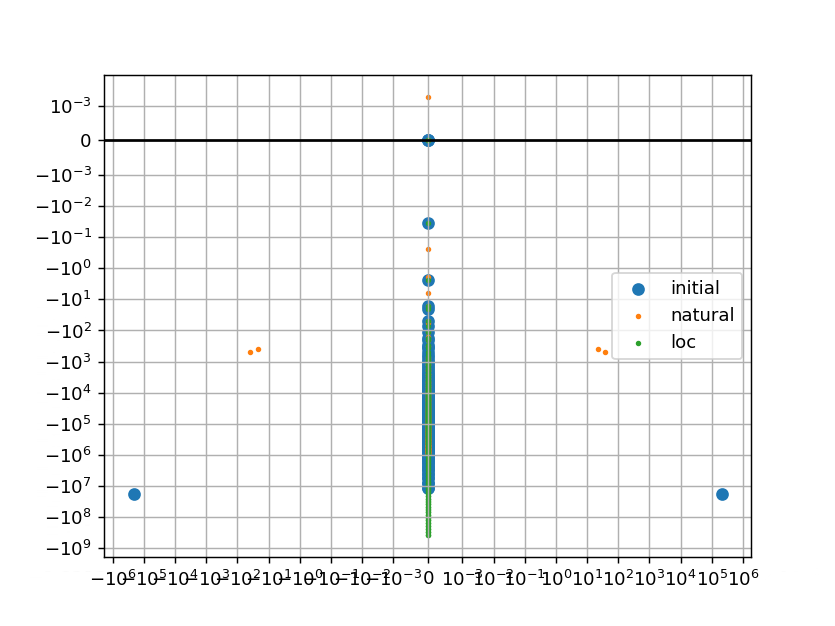

In [177]:
plt.figure()
plt.scatter(w.imag, w.real)
plt.scatter(w_g.imag, w_g.real,s=4)
plt.scatter(w_g_loc.imag, w_g_loc.real,s=4)

plt.legend(['initial','natural','loc'])

plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.xscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

In [178]:
N_jac_arr = np.arange(6,N_jac,1)

w_arr = np.zeros((6,len(N_jac_arr)))

for i in tqdm(range(len(N_jac_arr))):
    N_jac_ = N_jac_arr[i]
    w_,U_ = sc.linalg.eig(J_g_loc[:N_jac_,:N_jac_])
    w_arr[:,i]=np.sort(w_.real)[-6:]

  0%|          | 0/174 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


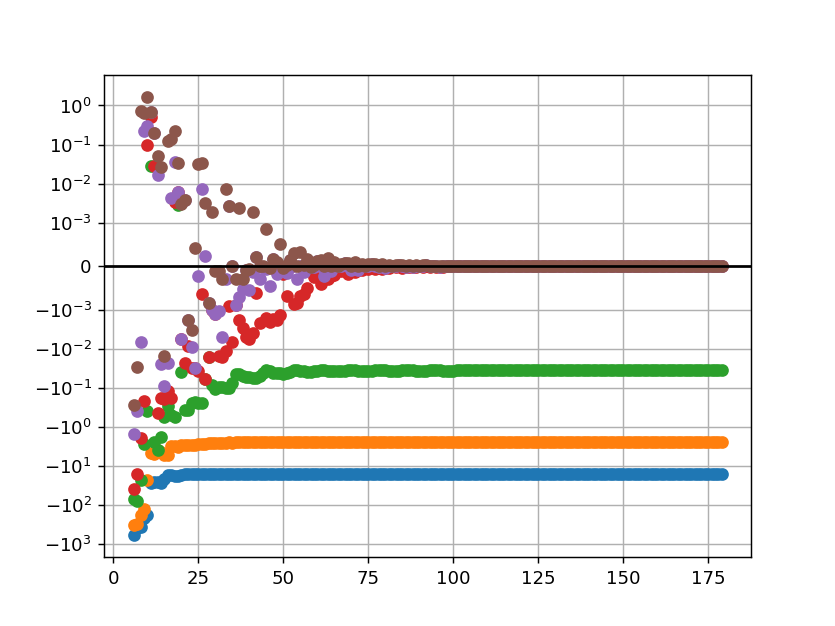

In [179]:
plt.figure()
for i in range(6):
    plt.plot(N_jac_arr,w_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

In [723]:

N_jac_arr = np.arange(10,N_jac,1)

s_arr = np.zeros((10,len(N_jac_arr)))

for i in tqdm(range(len(N_jac_arr))):
    N_jac_ = N_jac_arr[i]
    s = sc.linalg.svdvals(J_g_loc[:,:N_jac_])
    s_arr[:,i]=np.sort(s.real)[:10]

  0%|          | 0/170 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


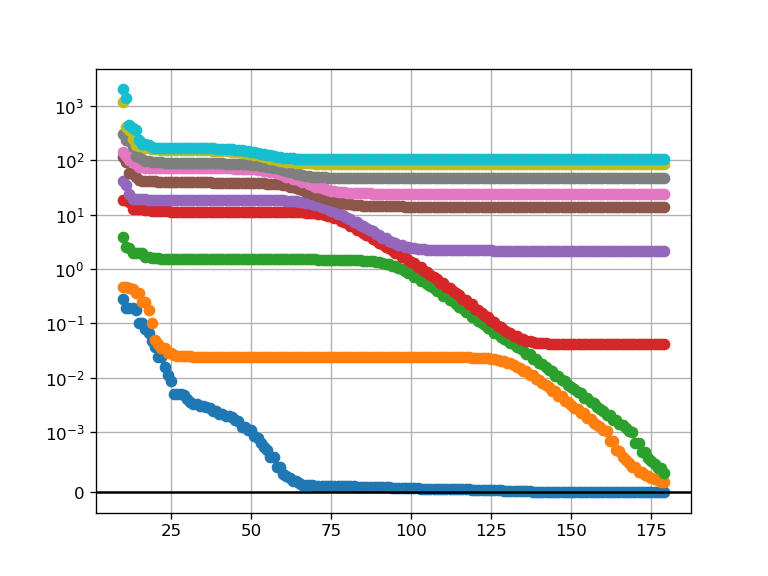

In [724]:
plt.figure()
for i in range(10):
    plt.plot(N_jac_arr,s_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

##### old

In [741]:
w,U = sc.linalg.eig(J[:N_jac])

In [742]:
np.sort(w.real)[-5:]

array([-2.73653074e+00, -4.93599221e-02, -1.03874769e-03,  1.64529480e-05,
        5.09268935e-04])

In [702]:
np.sort(w.real)[-5:]

array([-2.73999232e+00, -4.94078104e-02, -8.36450607e-04,  1.69485552e-05,
        3.73592112e-04])

In [ ]:
array([-2.76461965e+00, -5.10789916e-02, -3.58865195e-03,  2.91852782e-04,
        8.85350663e-04])

<IPython.core.display.Javascript object>


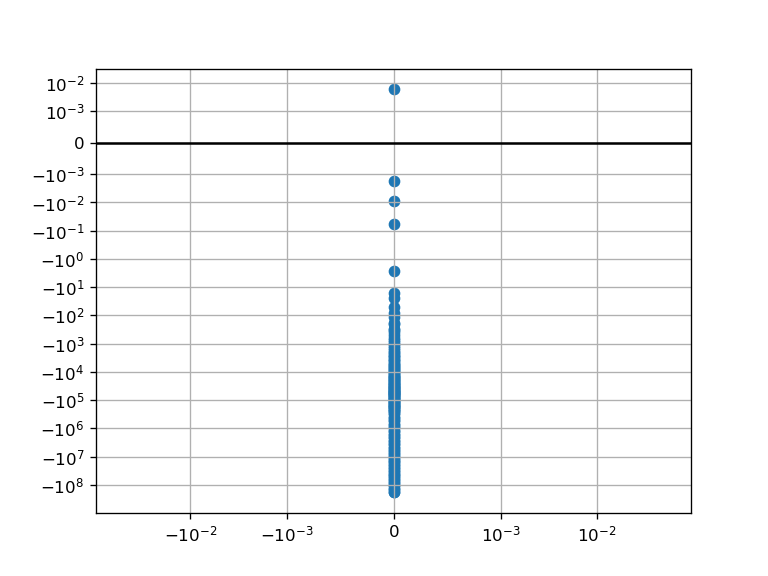

In [611]:
plt.figure()
plt.scatter(w.imag, w.real)
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.xscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

In [743]:

N_jac_arr = np.arange(6,150,1)

w_arr = np.zeros((6,len(N_jac_arr)))

for i in tqdm(range(len(N_jac_arr))):
    N_jac_ = N_jac_arr[i]
    w,U = sc.linalg.eig(J[:N_jac_,:N_jac_])
    w_arr[:,i]=np.sort(w.real)[-6:]

  0%|          | 0/144 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


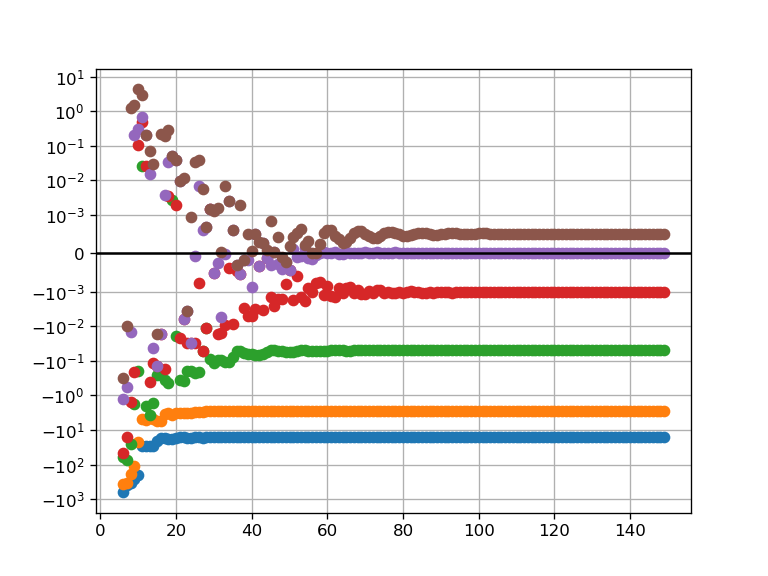

In [744]:
plt.figure()
for i in range(6):
    plt.plot(N_jac_arr,w_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

<IPython.core.display.Javascript object>


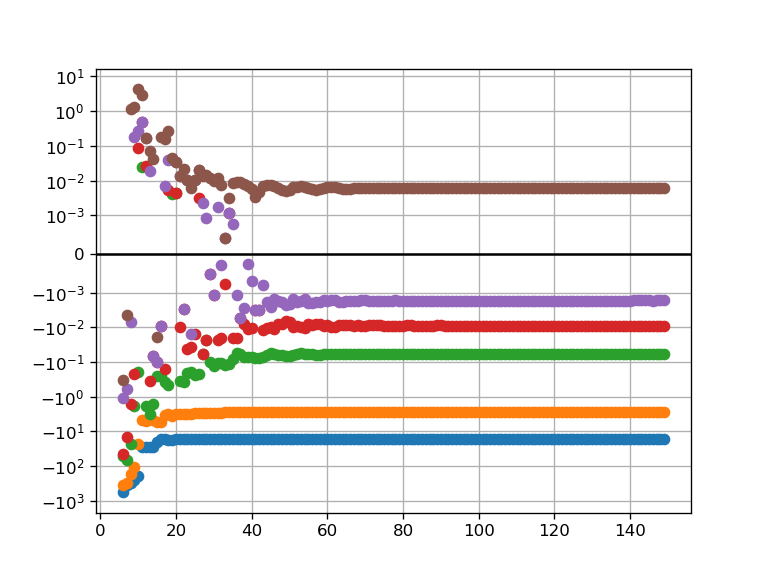

In [613]:
plt.figure()
for i in range(6):
    plt.plot(N_jac_arr,w_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

In [745]:

N_jac_arr = np.arange(10,150,1)

s_arr = np.zeros((10,len(N_jac_arr)))

for i in tqdm(range(len(N_jac_arr))):
    N_jac_ = N_jac_arr[i]
    s = sc.linalg.svdvals(J[:,:N_jac_])
    s_arr[:,i]=np.sort(s.real)[:10]

  0%|          | 0/140 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


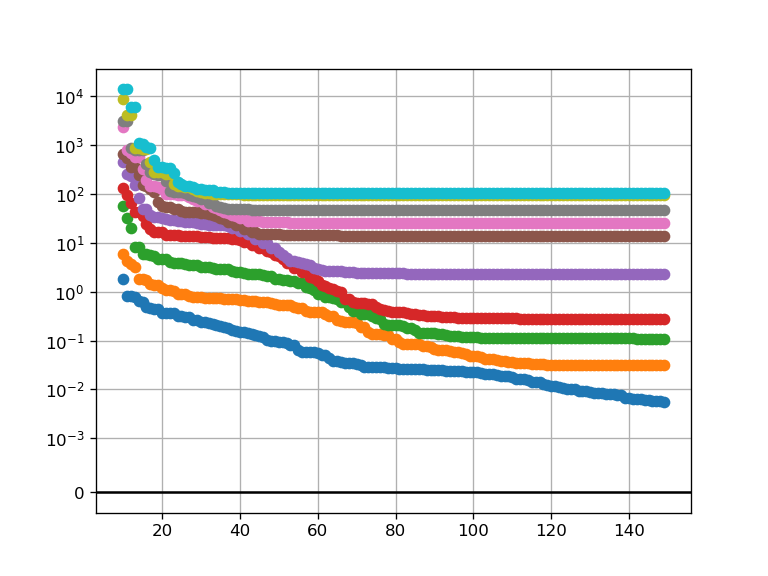

In [746]:
plt.figure()
for i in range(10):
    plt.plot(N_jac_arr,s_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

#### 2d loc gauge

In [180]:
H1,H2 = get_H12_from_ar(Pfur_0, Zfur_0)
a_loc = 1/(H1**2 + H2**2)**(1/2)

In [190]:
Pfur_0_g_loc,Zfur_0_g_loc = make_F_v_repar(Pfur_0, Zfur_0, a_loc,N_proj=350)

<IPython.core.display.Javascript object>


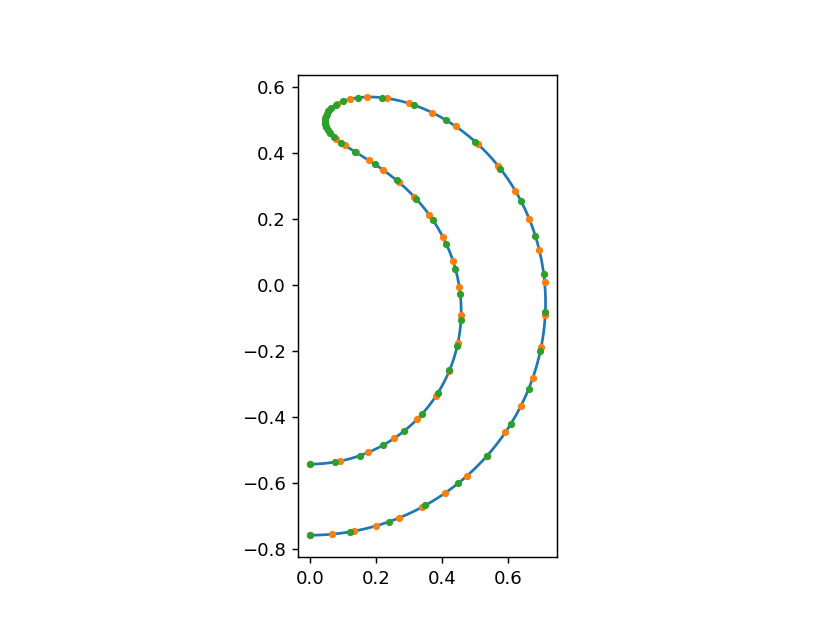

(-0.03566062604715081,
 0.748873146990167,
 -0.8255019841589056,
 0.6348591024176173)

In [186]:
P0= get_int_field(-1j*Pfur_0);Z0 = get_int_field(Zfur_0)
P0_g_loc= get_int_field(-1j*Pfur_0_g_loc);Z0_g_loc = get_int_field(Zfur_0_g_loc)

plt.figure()
plt.plot(P0,Z0)

plt.plot(P0[::50],Z0[::50],'.')
plt.plot(P0_g_loc[::50], Z0_g_loc[::50],'.')
plt.axis('scaled')

<IPython.core.display.Javascript object>


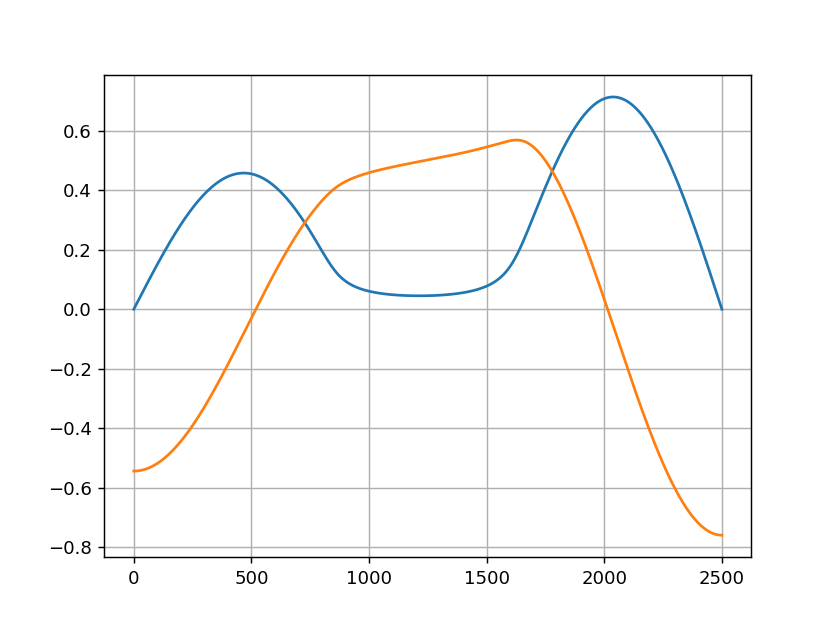

In [187]:
plt.figure()
plt.plot(P0_g_loc)
plt.plot(Z0_g_loc)
plt.grid()

<IPython.core.display.Javascript object>


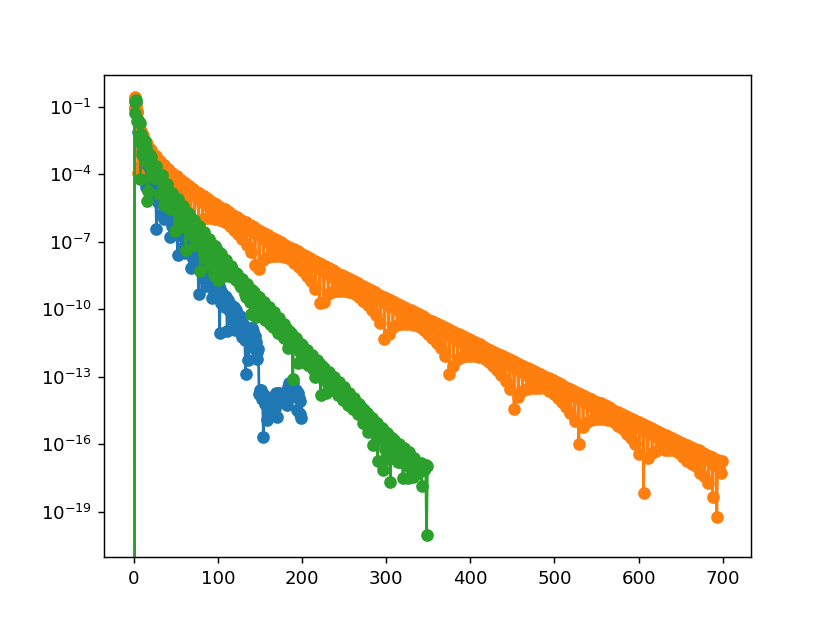

In [191]:
plt.figure()
plt.plot(abs(Pfur_0),'o-')
plt.plot(abs(Pfur_0_g),'o-')
plt.plot(abs(Pfur_0_g_loc),'o-')

plt.yscale('log')

<IPython.core.display.Javascript object>


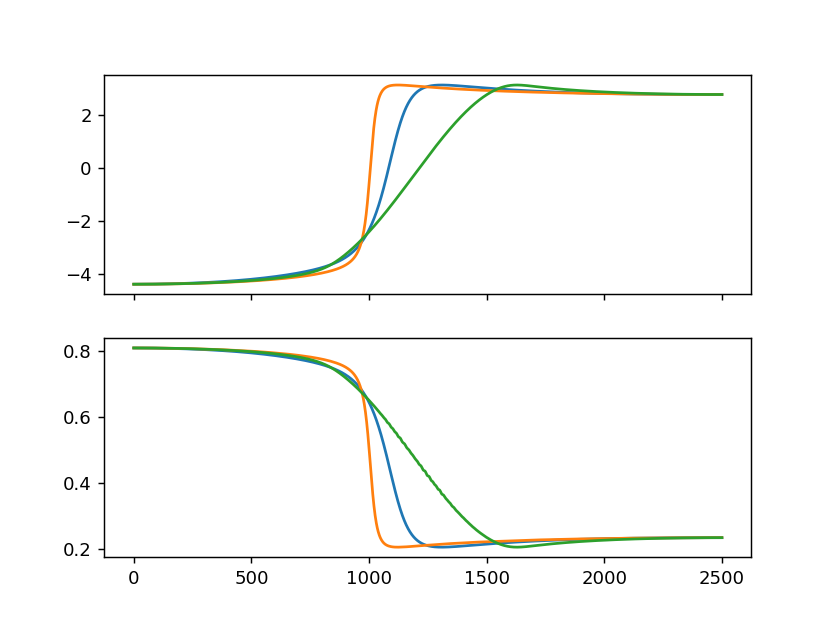

In [192]:
H_g_loc, force_g_loc =get_H_force_from_ar(Pfur_0_g_loc[:],Zfur_0_g_loc[:])

fig,axs = plt.subplots(2,1, sharex=True)
axs[0].plot(H)
axs[0].plot(H_g)
axs[0].plot(H_g_loc)

axs[1].plot(force)
axs[1].plot(force_g)
axs[1].plot(force_g_loc)


<IPython.core.display.Javascript object>


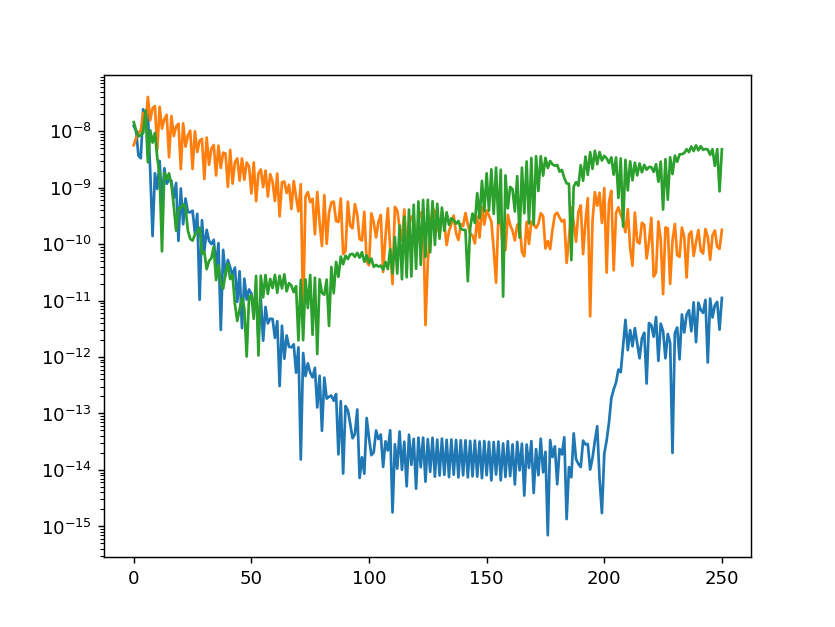

In [193]:
plt.figure()
plt.plot(abs(get_velo_norm_fur_full(Pfur_0, Zfur_0)))
plt.plot(abs(get_velo_norm_fur_full(Pfur_0_g, Zfur_0_g)))
plt.plot(abs(get_velo_norm_fur_full(Pfur_0_g_loc, Zfur_0_g_loc)))

plt.yscale('log')

In [194]:
J_g_loc = get_J(Pfur_0_g_loc,Zfur_0_g_loc, N_jac)

<IPython.core.display.Javascript object>


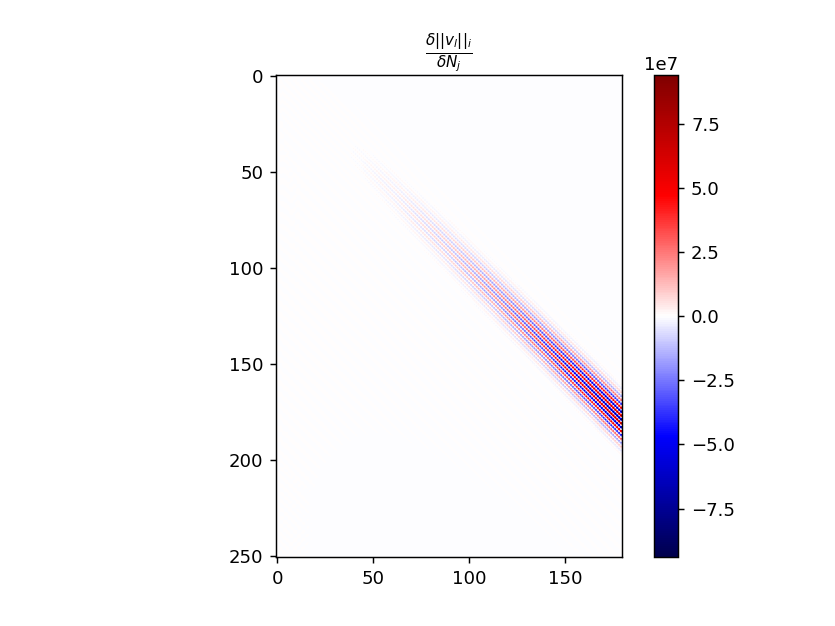

<IPython.core.display.Javascript object>


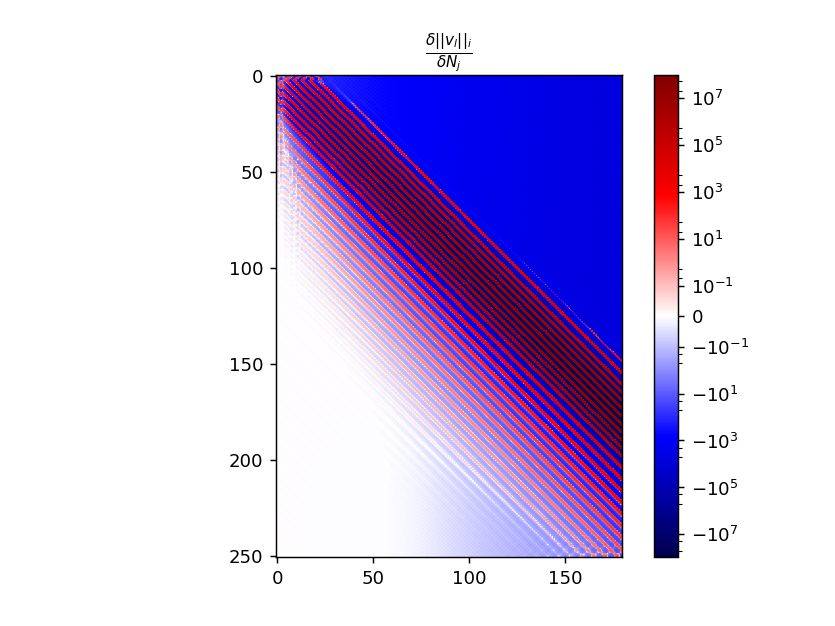

In [195]:
plt.figure()
plt.title(r'$\frac{\delta ||v_l||_i}{\delta N_j}$')
plt.imshow(J_g_loc, norm=colors.CenteredNorm(0), cmap='seismic')
plt.colorbar()




import matplotlib.colors as colors
lnrwidth=1e-2
gain=np.max(abs(J_g_loc))

plt.figure()
plt.title(r'$\frac{\delta ||v_l||_i}{\delta N_j}$')
plt.imshow(J_g_loc, norm=colors.AsinhNorm(linear_width=lnrwidth,
                                             vmin=-gain, vmax=gain), cmap='seismic')
plt.colorbar()

In [196]:
w_g_loc,U_g_loc = sc.linalg.eig(J_g_loc[:N_jac])

<IPython.core.display.Javascript object>


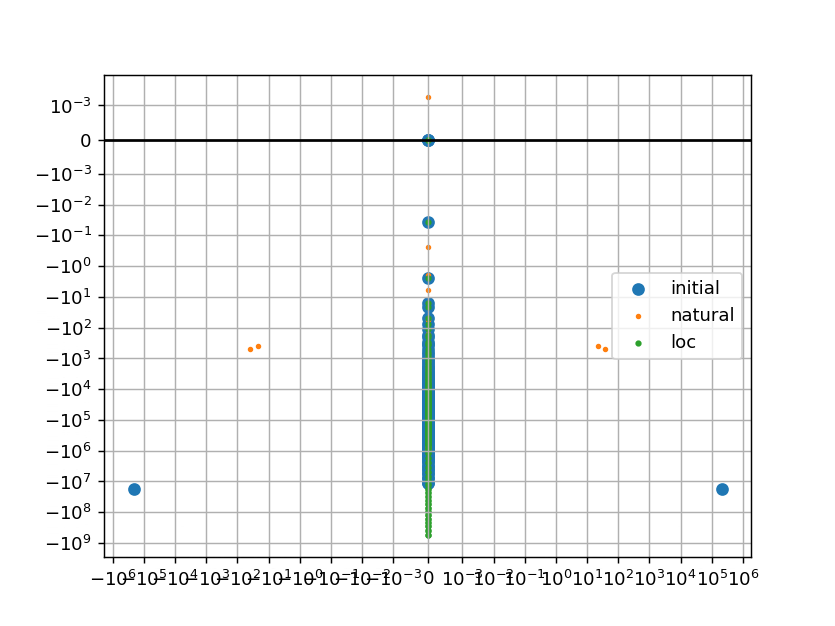

In [197]:
plt.figure()
plt.scatter(w.imag, w.real)
plt.scatter(w_g.imag, w_g.real,s=4)
plt.scatter(w_g_loc.imag, w_g_loc.real,s=6)

plt.legend(['initial','natural','loc'])

plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.xscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

In [198]:
N_jac_arr = np.arange(6,N_jac,1)

w_arr = np.zeros((6,len(N_jac_arr)))

for i in tqdm(range(len(N_jac_arr))):
    N_jac_ = N_jac_arr[i]
    w_,U_ = sc.linalg.eig(J_g_loc[:N_jac_,:N_jac_])
    w_arr[:,i]=np.sort(w_.real)[-6:]

  0%|          | 0/174 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


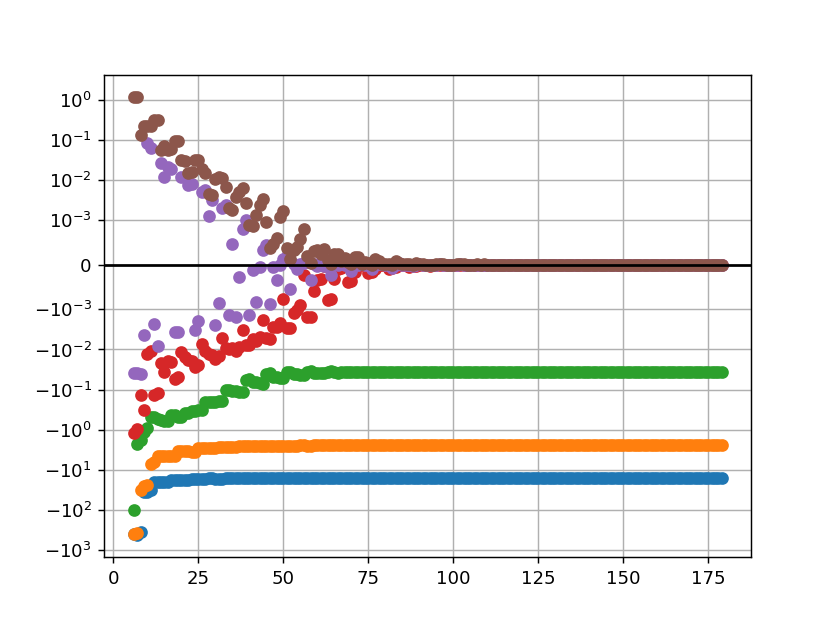

In [199]:
plt.figure()
for i in range(6):
    plt.plot(N_jac_arr,w_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

In [200]:

N_jac_arr = np.arange(10,N_jac,1)

s_arr = np.zeros((10,len(N_jac_arr)))

for i in tqdm(range(len(N_jac_arr))):
    N_jac_ = N_jac_arr[i]
    s = sc.linalg.svdvals(J_g_loc[:,:N_jac_])
    s_arr[:,i]=np.sort(s.real)[:10]

  0%|          | 0/170 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


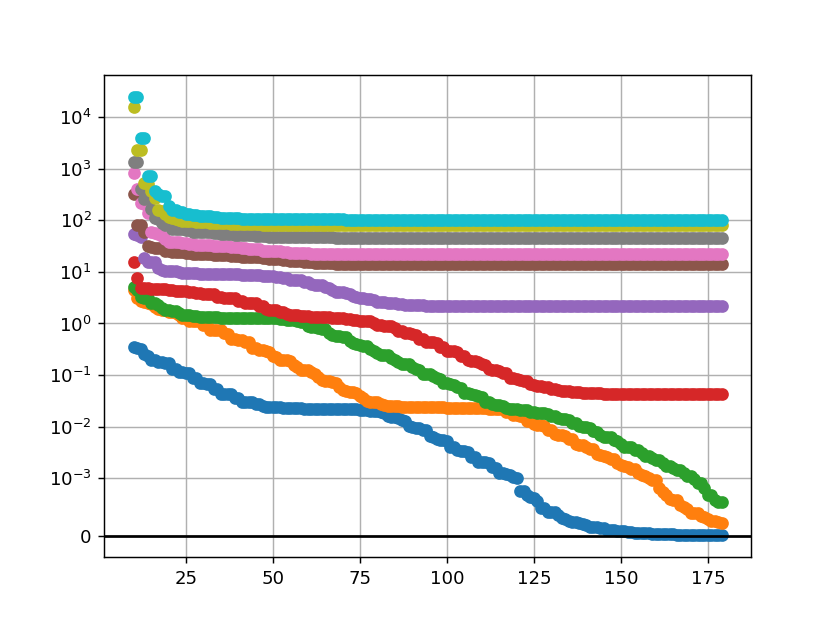

In [201]:
plt.figure()
for i in range(10):
    plt.plot(N_jac_arr,s_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

##### old

In [759]:
jac_fun = nd.Jacobian(lambda x: get_velo_norm_fur_full_with_dN_fur(Pfur_0_g_loc, Zfur_0_g_loc, x), step=1e-6)

In [631]:
N_jac = 150

In [632]:
N_sigma=170

In [633]:
n_int

200

In [634]:
N_int

2000

In [760]:
J = jac_fun(np.zeros(N_jac))

<IPython.core.display.Javascript object>


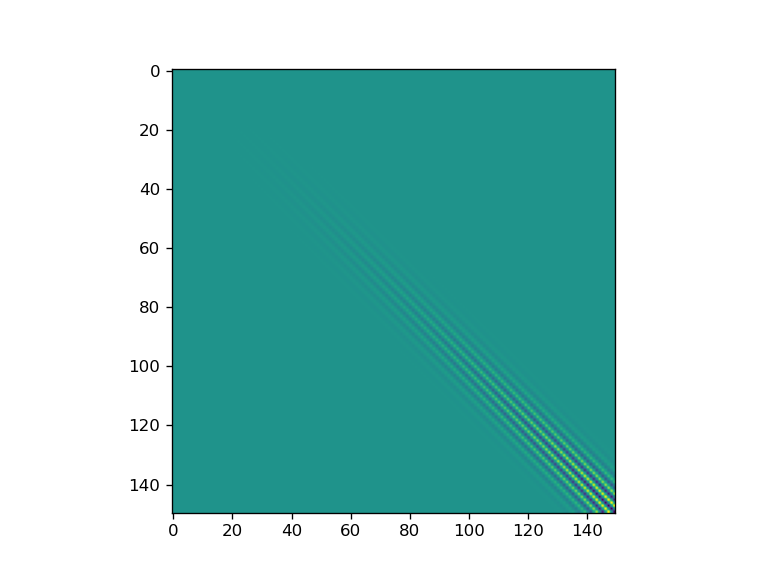

In [636]:
plt.figure()
plt.imshow((J[:N_jac]))

In [761]:
w,U = sc.linalg.eig(J[:N_jac])

In [638]:
np.sort(w.real)[-5:]

array([-2.76287503e+00, -5.10007167e-02, -4.21160628e-03,  2.91554782e-04,
        9.88888094e-04])

In [762]:
np.sort(w.real)[-5:]

array([-2.73815752e+00, -4.94488339e-02, -1.02406731e-03,  1.64752696e-05,
        5.00329621e-04])

In [ ]:
array([-2.76461965e+00, -5.10789916e-02, -3.58865195e-03,  2.91852782e-04,
        8.85350663e-04])

<IPython.core.display.Javascript object>


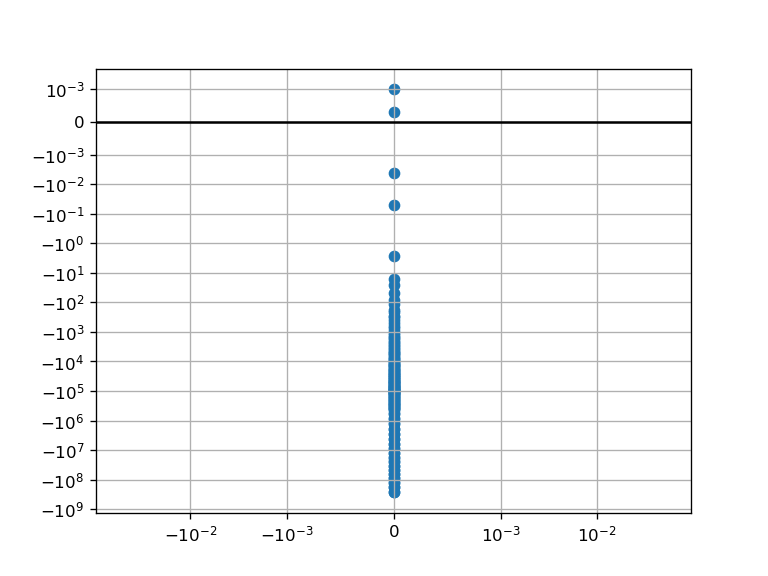

In [639]:
plt.figure()
plt.scatter(w.imag, w.real)
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.xscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

In [763]:

N_jac_arr = np.arange(6,150,1)

w_arr = np.zeros((6,len(N_jac_arr)))

for i in tqdm(range(len(N_jac_arr))):
    N_jac_ = N_jac_arr[i]
    w,U = sc.linalg.eig(J[:N_jac_,:N_jac_])
    w_arr[:,i]=np.sort(w.real)[-6:]

  0%|          | 0/144 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


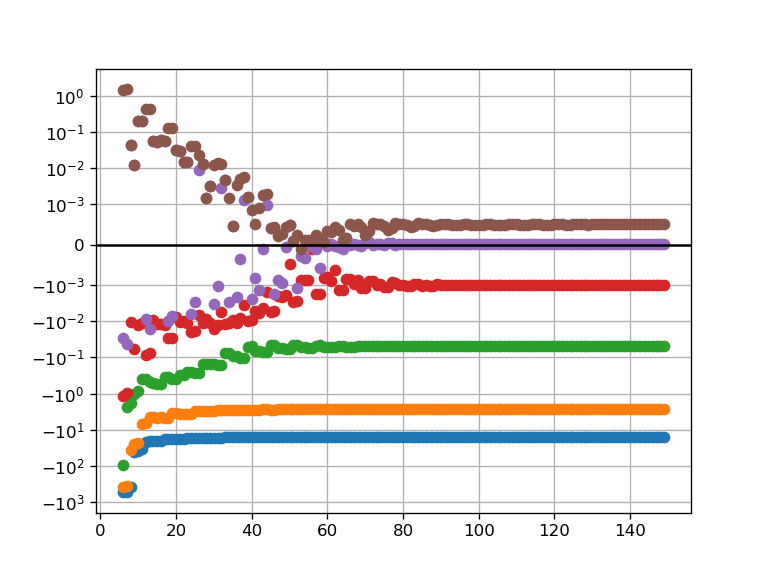

In [764]:
plt.figure()
for i in range(6):
    plt.plot(N_jac_arr,w_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

<IPython.core.display.Javascript object>


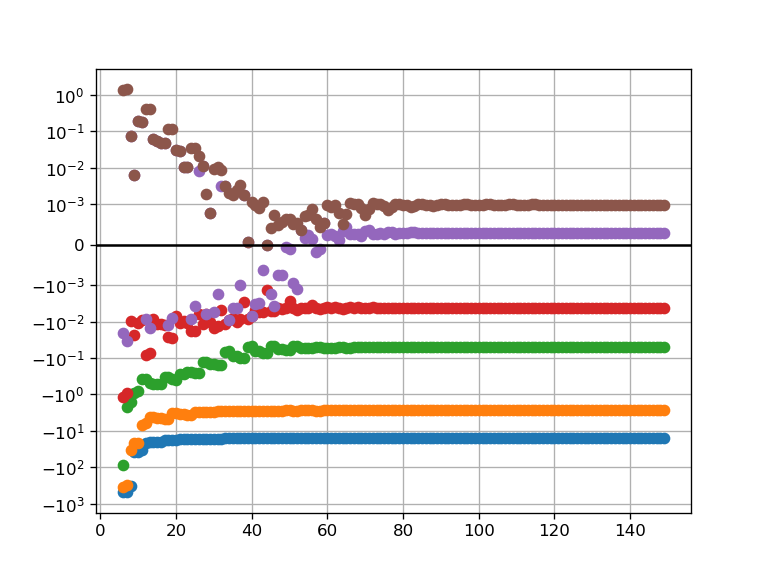

In [641]:
plt.figure()
for i in range(6):
    plt.plot(N_jac_arr,w_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

In [765]:

N_jac_arr = np.arange(10,150,1)

s_arr = np.zeros((10,len(N_jac_arr)))

for i in tqdm(range(len(N_jac_arr))):
    N_jac_ = N_jac_arr[i]
    s = sc.linalg.svdvals(J[:,:N_jac_])
    s_arr[:,i]=np.sort(s.real)[:10]

  0%|          | 0/140 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


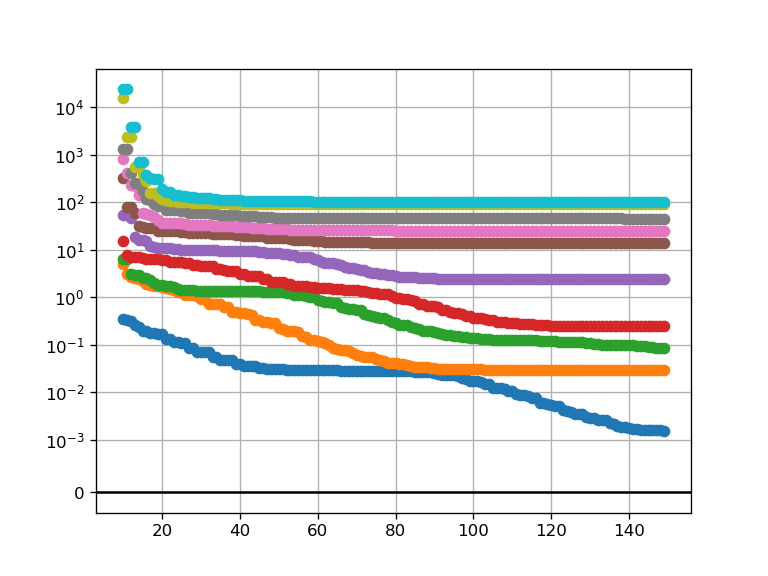

In [766]:
plt.figure()
for i in range(10):
    plt.plot(N_jac_arr,s_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

#### 2d h gauge

In [202]:
H1,H2 = get_H12_from_ar(Pfur_0, Zfur_0)
a_loc = 1/(H1**2 + H2**2)**(1/2)/np.sqrt(2)
P0= get_int_field(-1j*Pfur_0);Z0 = get_int_field(Zfur_0)
a_h = (Z0[0]-Z0[-1])/2;
alpha = 1.5
a_reg = 2/(1/a_h+alpha*1/a_loc)

In [285]:
H1,H2 = get_H12_from_ar(Pfur_0, Zfur_0)
a_loc = 1/(H1**2 + H2**2)**(1/2)/np.sqrt(2)
P0= get_int_field(-1j*Pfur_0);Z0 = get_int_field(Zfur_0)
a_h = (Z0[0]-Z0[-1])/2;
alpha = 0.1
a_reg = 2/(1/a_h+alpha*1/a_loc)

<IPython.core.display.Javascript object>


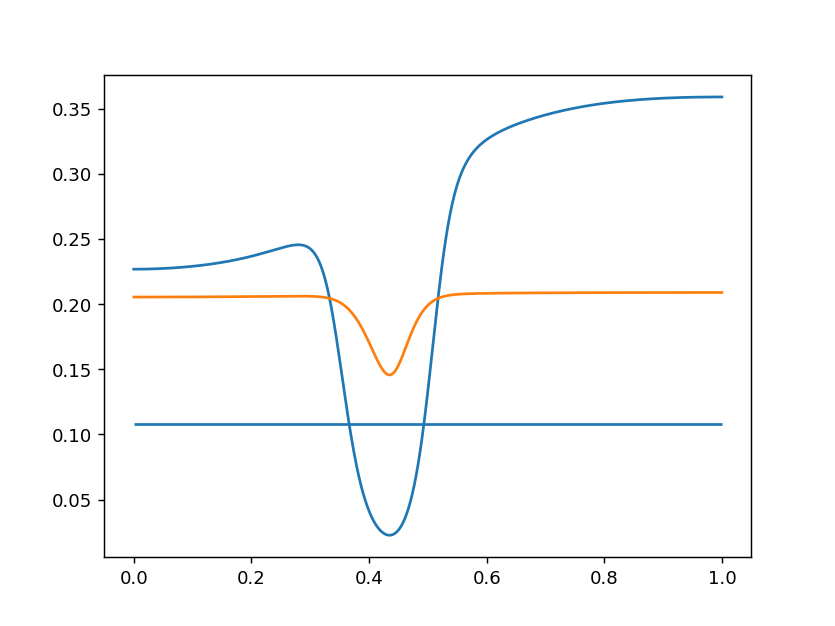

In [286]:
plt.figure()
plt.plot(Tau_int,a_loc)
plt.hlines(a_h,0,1)
plt.plot(Tau_int,a_reg)

In [288]:
Pfur_0_g_loc,Zfur_0_g_loc = make_F_v_repar(Pfur_0, Zfur_0, a_reg,N_proj=400)

<IPython.core.display.Javascript object>


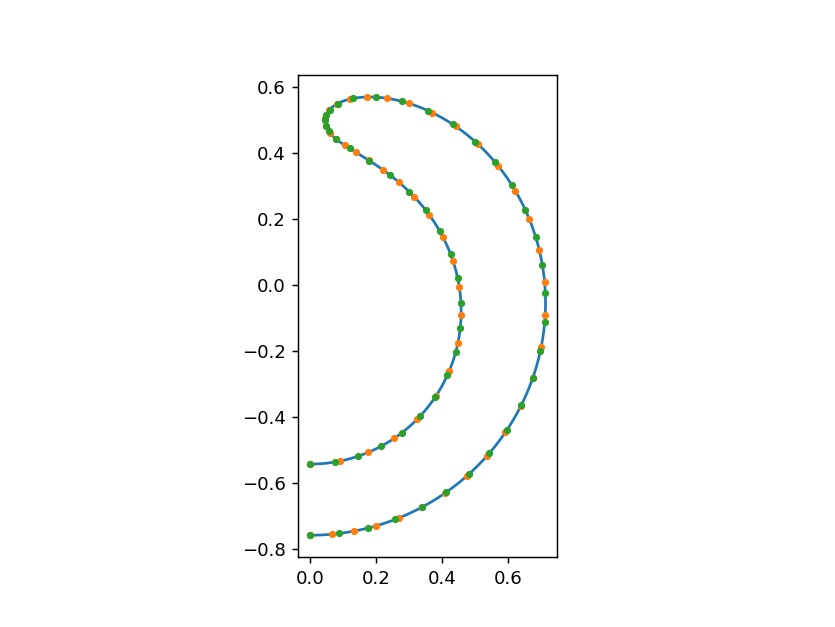

(-0.03566062604715084,
 0.748873146990167,
 -0.8255019841589056,
 0.6348591024176173)

In [209]:

P0_g_loc= get_int_field(-1j*Pfur_0_g_loc);Z0_g_loc = get_int_field(Zfur_0_g_loc)

plt.figure()
plt.plot(P0,Z0)

plt.plot(P0[::50],Z0[::50],'.')
plt.plot(P0_g_loc[::50], Z0_g_loc[::50],'.')
plt.axis('scaled')

<IPython.core.display.Javascript object>


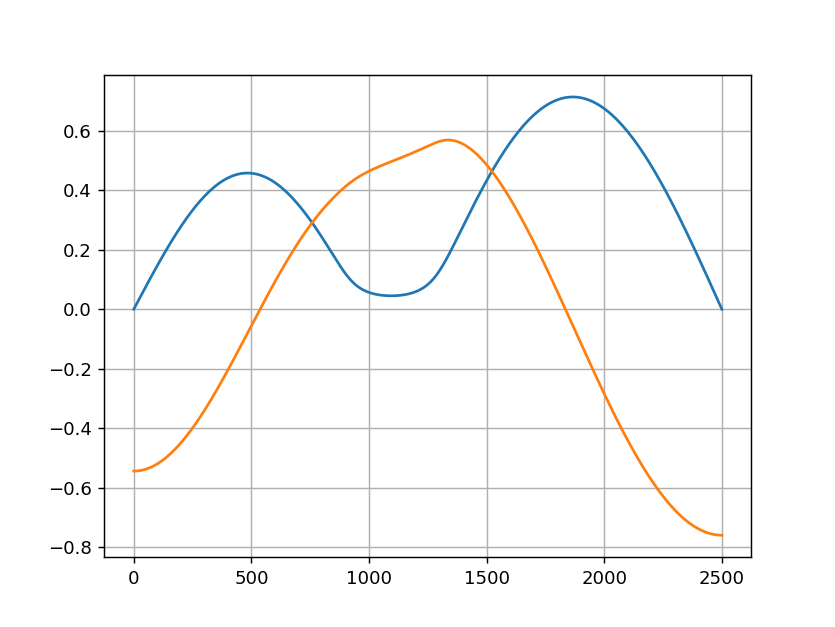

In [289]:
plt.figure()
plt.plot(P0_g_loc)
plt.plot(Z0_g_loc)
plt.grid()

<IPython.core.display.Javascript object>


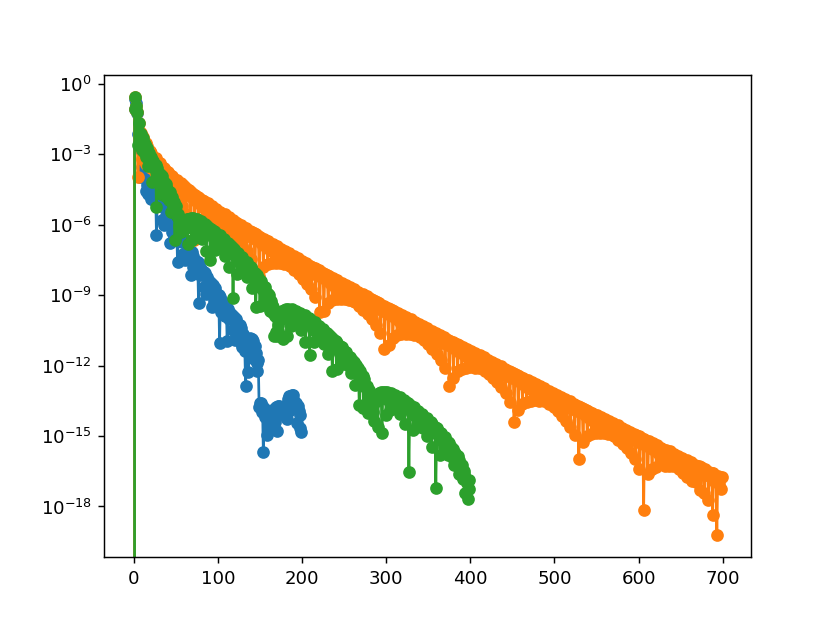

In [290]:
plt.figure()
plt.plot(abs(Pfur_0),'o-')
plt.plot(abs(Pfur_0_g),'o-')
plt.plot(abs(Pfur_0_g_loc),'o-')

plt.yscale('log')

<IPython.core.display.Javascript object>


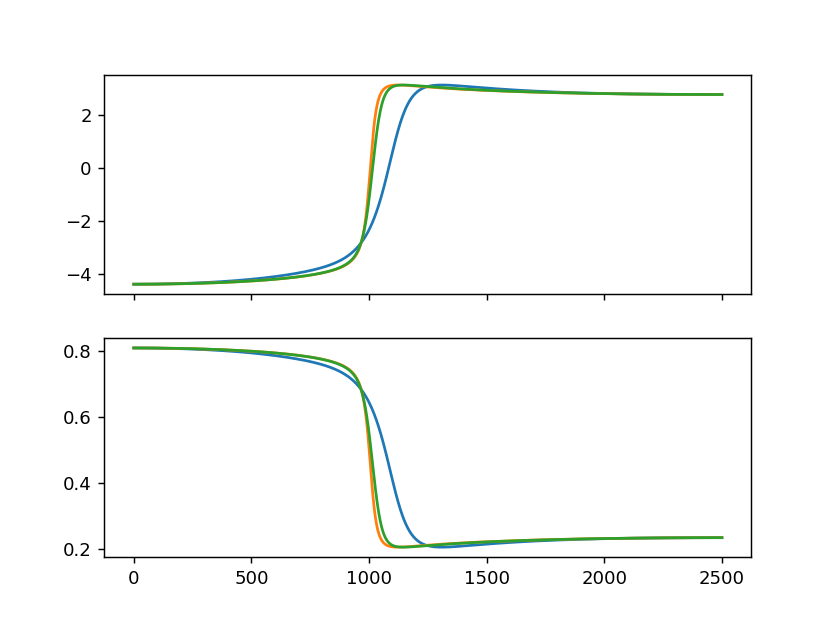

In [291]:
H_g_loc, force_g_loc =get_H_force_from_ar(Pfur_0_g_loc[:],Zfur_0_g_loc[:])

fig,axs = plt.subplots(2,1, sharex=True)
axs[0].plot(H)
axs[0].plot(H_g)
axs[0].plot(H_g_loc)

axs[1].plot(force)
axs[1].plot(force_g)
axs[1].plot(force_g_loc)


<IPython.core.display.Javascript object>


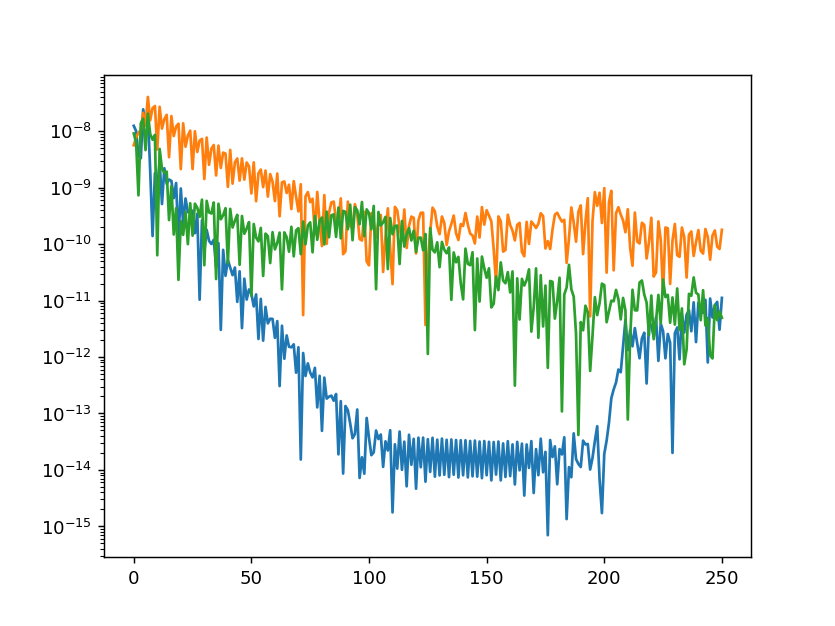

In [292]:
plt.figure()
plt.plot(abs(get_velo_norm_fur_full(Pfur_0, Zfur_0)))
plt.plot(abs(get_velo_norm_fur_full(Pfur_0_g, Zfur_0_g)))
plt.plot(abs(get_velo_norm_fur_full(Pfur_0_g_loc, Zfur_0_g_loc)))

plt.yscale('log')

In [739]:
jac_fun = nd.Jacobian(lambda x: get_velo_norm_fur_full_with_dN_fur(Pfur_0_g_loc, Zfur_0_g_loc, x), step=1e-6)

In [214]:
J_g_loc = get_J(Pfur_0_g_loc,Zfur_0_g_loc, N_jac)

In [234]:
J_g_loc_ = get_J(Pfur_0_g_loc,Zfur_0_g_loc, N_jac)

In [253]:
J_g_loc__ = get_J(Pfur_0_g_loc,Zfur_0_g_loc, N_jac)

In [267]:
J_g_loc___ = get_J(Pfur_0_g_loc,Zfur_0_g_loc, N_jac)

In [293]:
J_g_loc____ = get_J(Pfur_0_g_loc,Zfur_0_g_loc, N_jac)

<IPython.core.display.Javascript object>


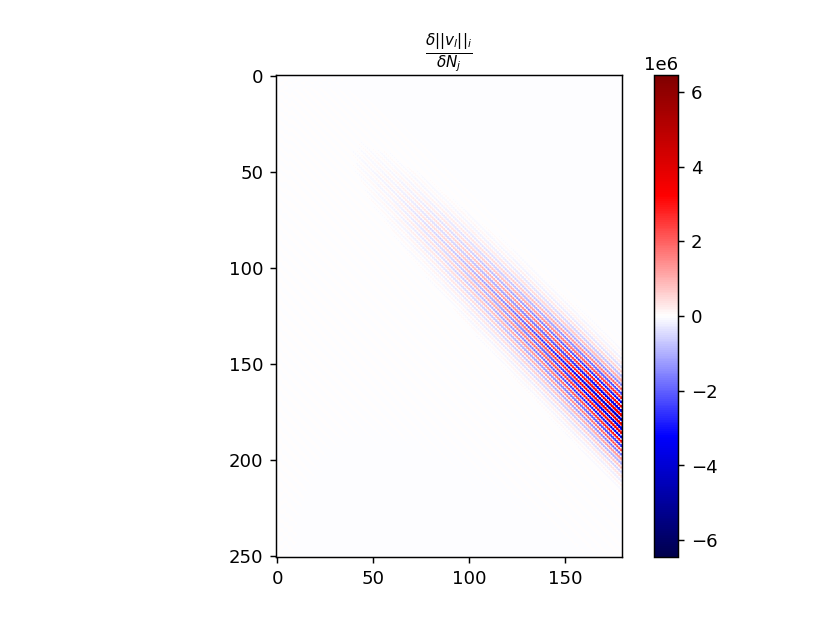

<IPython.core.display.Javascript object>


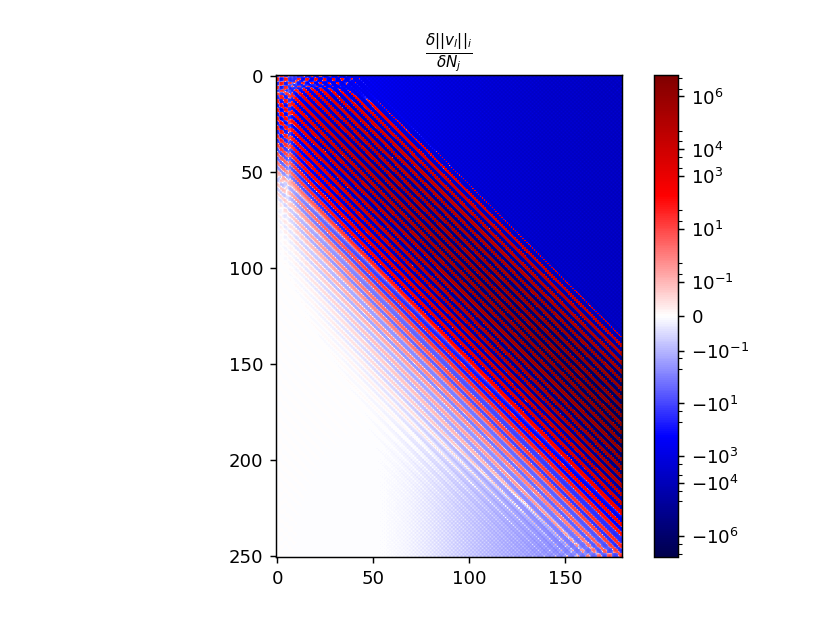

In [215]:
plt.figure()
plt.title(r'$\frac{\delta ||v_l||_i}{\delta N_j}$')
plt.imshow(J_g_loc, norm=colors.CenteredNorm(0), cmap='seismic')
plt.colorbar()




import matplotlib.colors as colors
lnrwidth=1e-2
gain=np.max(abs(J_g_loc))

plt.figure()
plt.title(r'$\frac{\delta ||v_l||_i}{\delta N_j}$')
plt.imshow(J_g_loc, norm=colors.AsinhNorm(linear_width=lnrwidth,
                                             vmin=-gain, vmax=gain), cmap='seismic')
plt.colorbar()

In [216]:
w_g_loc,U_g_loc = sc.linalg.eig(J_g_loc[:N_jac])

In [235]:
w_g_loc_,U_g_loc_ = sc.linalg.eig(J_g_loc_[:N_jac])

<IPython.core.display.Javascript object>


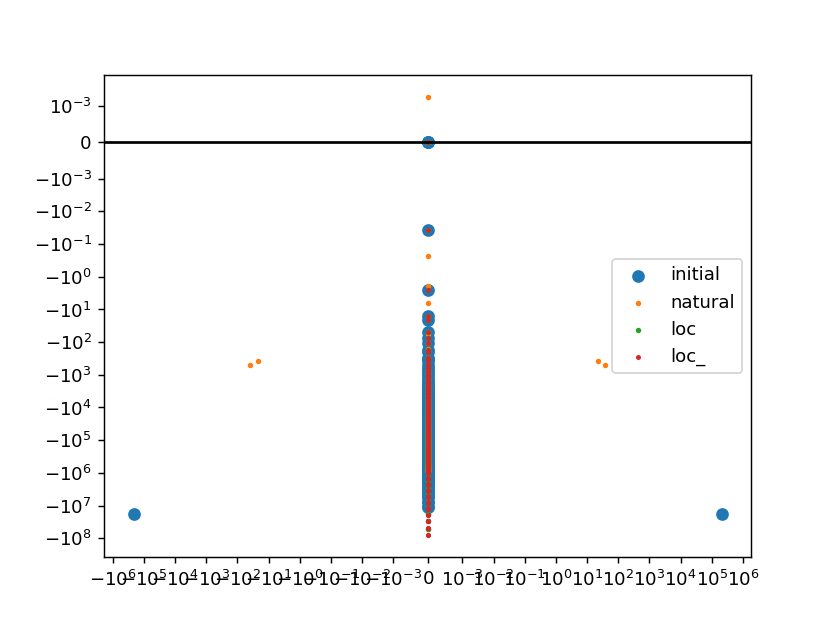

In [238]:
plt.figure()
plt.scatter(w.imag, w.real)
plt.scatter(w_g.imag, w_g.real,s=4)
plt.scatter(w_g_loc.imag, w_g_loc.real,s=4)
plt.scatter(w_g_loc_.imag, w_g_loc_.real,s=3)

plt.legend(['initial','natural','loc','loc_'])

#plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.xscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

In [294]:
N_jac_arr = np.arange(6,N_jac,1)

w_arr____ = np.zeros((6,len(N_jac_arr)))

for i in tqdm(range(len(N_jac_arr))):
    N_jac_ = N_jac_arr[i]
    w_,U_ = sc.linalg.eig(J_g_loc____[:N_jac_,:N_jac_])
    w_arr____[:,i]=np.sort(w_.real)[-6:]

  0%|          | 0/174 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


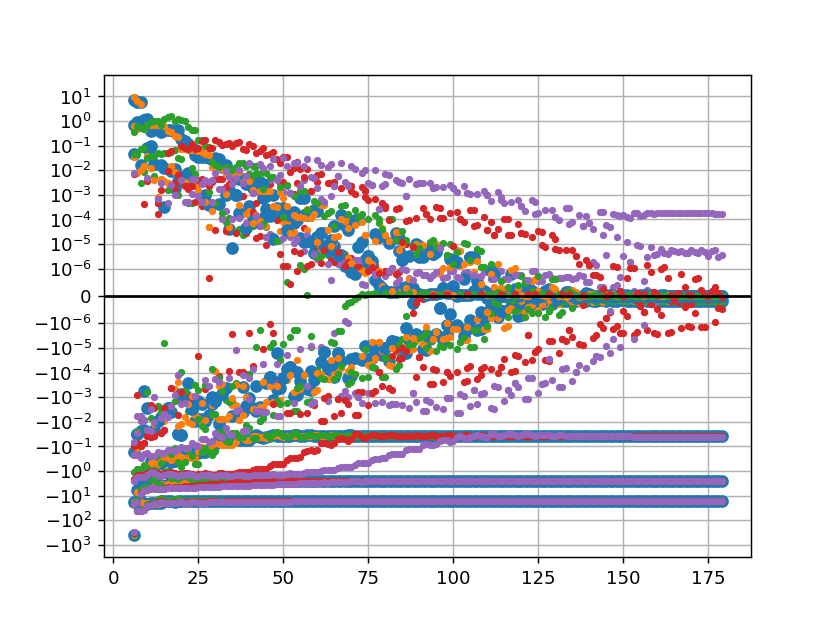

In [295]:
plt.figure()
for i in range(6):
    plt.plot(N_jac_arr,w_arr[i,:],'o', color='C0')
    plt.plot(N_jac_arr,w_arr_[i,:],'.', color='C1')
    plt.plot(N_jac_arr,w_arr__[i,:],'.', color='C2')
    plt.plot(N_jac_arr,w_arr___[i,:],'.', color='C3')
    plt.plot(N_jac_arr,w_arr____[i,:],'.', color='C4')
plt.grid()
plt.yscale('symlog', linthresh=1e-6)
plt.axhline(0, color='k')

<IPython.core.display.Javascript object>


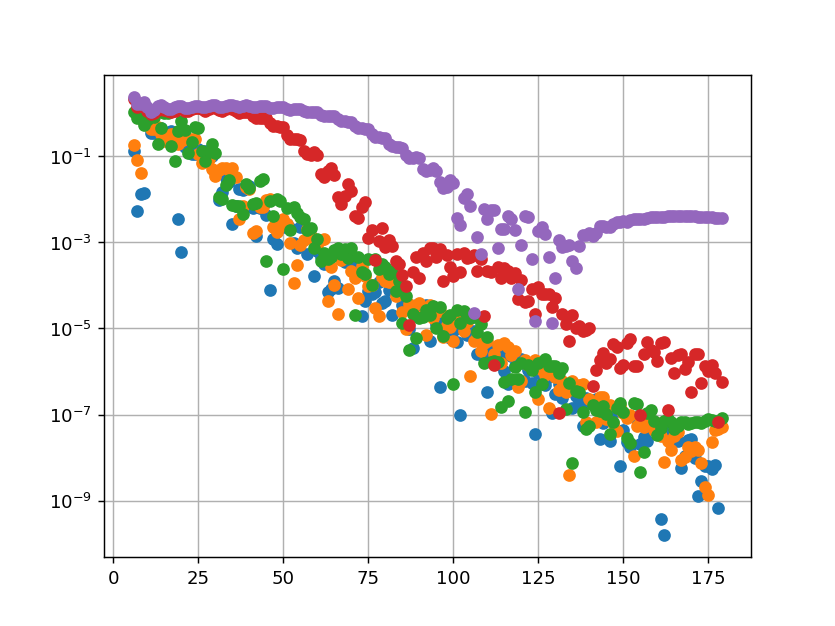

In [296]:
plt.figure()
for i in [2]:
    plt.plot(N_jac_arr,abs(w_arr[i,-1]-w_arr[i,:]),'o', color='C0')
    plt.plot(N_jac_arr,abs(w_arr[i,-1]-w_arr_[i,:]),'o', color='C1')
    plt.plot(N_jac_arr,abs(w_arr[i,-1]-w_arr__[i,:]),'o', color='C2')
    plt.plot(N_jac_arr,abs(w_arr[i,-1]-w_arr___[i,:]),'o', color='C3')
    plt.plot(N_jac_arr,abs(w_arr[i,-1]-w_arr____[i,:]),'o', color='C4')
plt.grid()
plt.yscale('log')
#plt.axhline(0, color='k')

In [220]:

N_jac_arr = np.arange(10,N_jac,1)

s_arr = np.zeros((10,len(N_jac_arr)))

for i in tqdm(range(len(N_jac_arr))):
    N_jac_ = N_jac_arr[i]
    s = sc.linalg.svdvals(J_g_loc[:,:N_jac_])
    s_arr[:,i]=np.sort(s.real)[:10]

  0%|          | 0/170 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


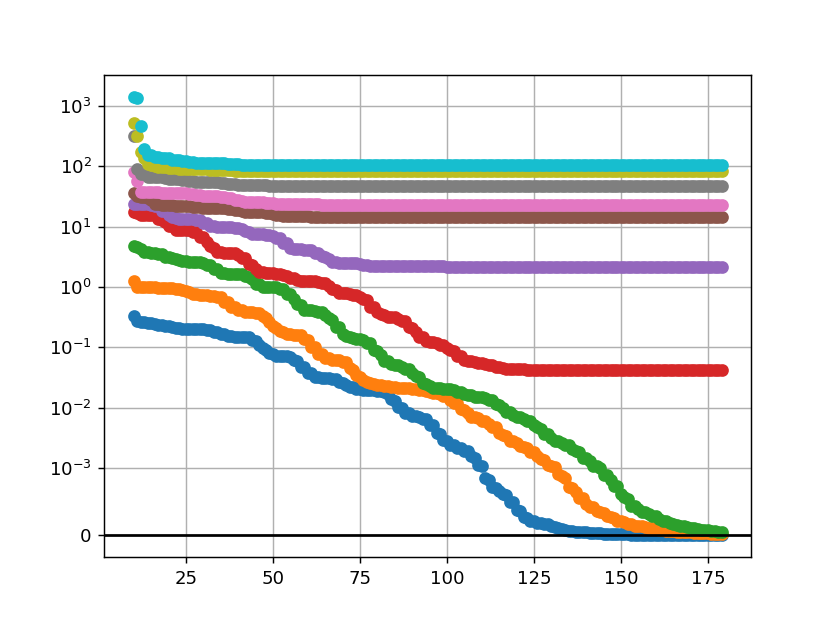

In [221]:
plt.figure()
for i in range(10):
    plt.plot(N_jac_arr,s_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

##### old

<IPython.core.display.Javascript object>


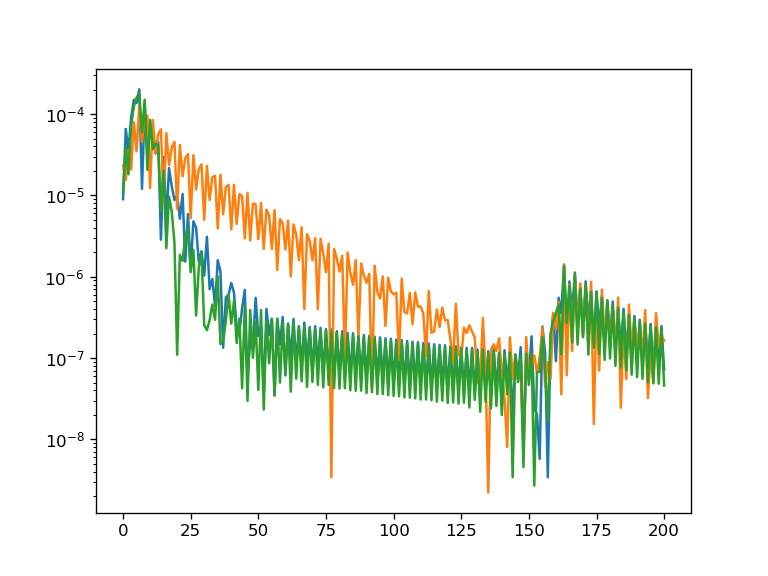

In [774]:
plt.figure()
plt.plot(abs(get_velo_norm_fur_full(Pfur_0, Zfur_0)))
plt.plot(abs(get_velo_norm_fur_full(Pfur_0_g, Zfur_0_g)))
plt.plot(abs(get_velo_norm_fur_full(Pfur_0_g_loc, Zfur_0_g_loc)))

plt.yscale('log')

In [775]:
jac_fun = nd.Jacobian(lambda x: get_velo_norm_fur_full_with_dN_fur(Pfur_0_g_loc, Zfur_0_g_loc, x), step=1e-6)

In [776]:
N_jac = 150

In [777]:
N_sigma=170

In [679]:
n_int

200

In [680]:
N_int

2000

In [778]:
J = jac_fun(np.zeros(N_jac))

<IPython.core.display.Javascript object>


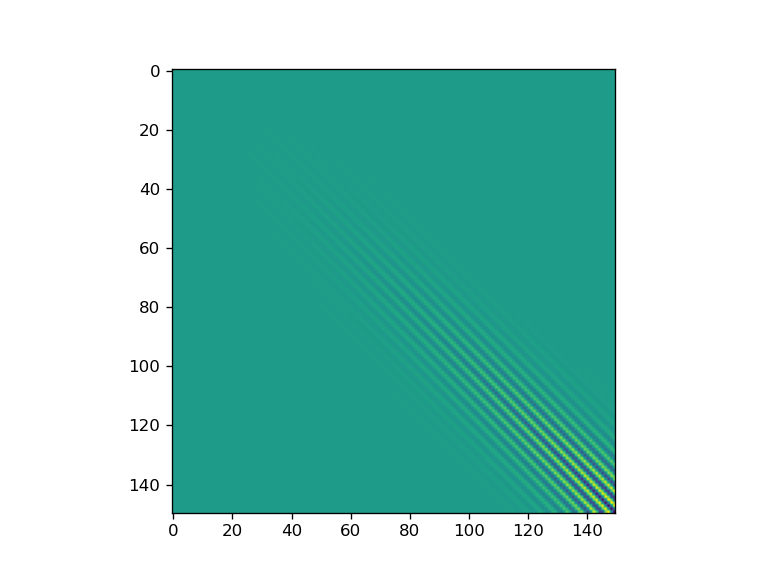

In [779]:
plt.figure()
plt.imshow((J[:N_jac]))

In [780]:
w,U = sc.linalg.eig(J[:N_jac])

In [781]:
np.sort(w.real)[-5:]

array([-2.74066727e+00, -4.96208341e-02, -1.01278857e-03,  1.60011864e-05,
        4.87011075e-04])

In [683]:
np.sort(w.real)[-5:]

array([-2.76546203e+00, -5.11922231e-02, -4.02743584e-03,  2.91109855e-04,
        9.65722711e-04])

In [ ]:
array([-2.76461965e+00, -5.10789916e-02, -3.58865195e-03,  2.91852782e-04,
        8.85350663e-04])

<IPython.core.display.Javascript object>


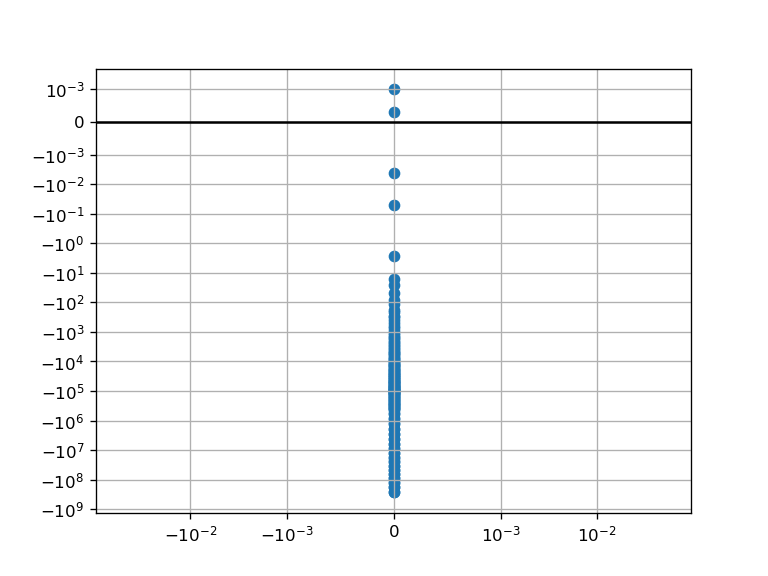

In [639]:
plt.figure()
plt.scatter(w.imag, w.real)
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.xscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

In [782]:

N_jac_arr = np.arange(6,150,1)

w_arr = np.zeros((6,len(N_jac_arr)))

for i in tqdm(range(len(N_jac_arr))):
    N_jac_ = N_jac_arr[i]
    w,U = sc.linalg.eig(J[:N_jac_,:N_jac_])
    w_arr[:,i]=np.sort(w.real)[-6:]

  0%|          | 0/144 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


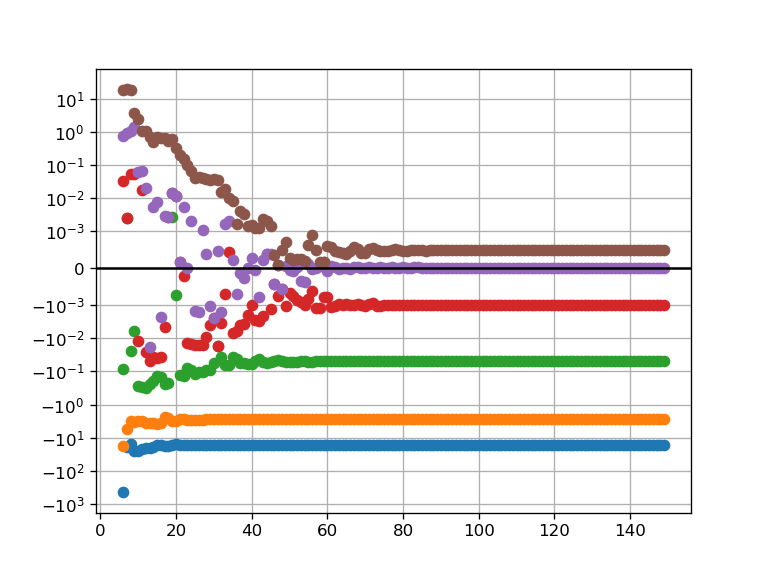

In [783]:
plt.figure()
for i in range(6):
    plt.plot(N_jac_arr,w_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

<IPython.core.display.Javascript object>


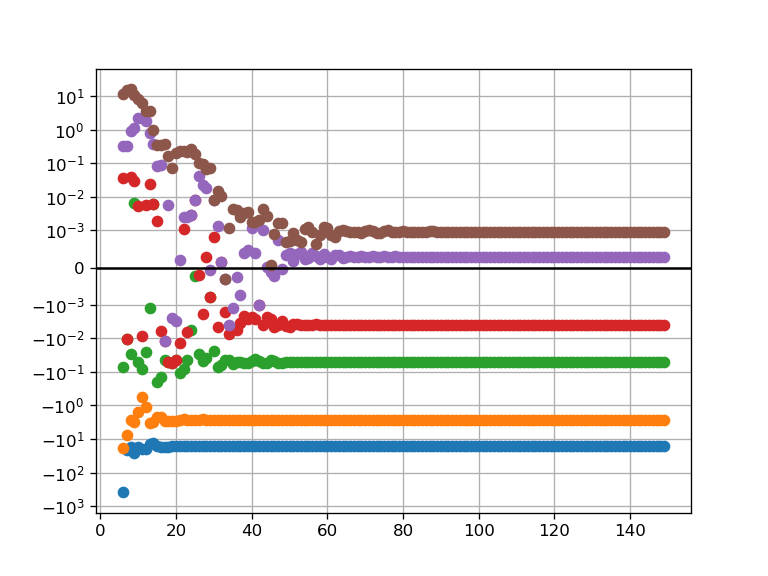

In [663]:
plt.figure()
for i in range(6):
    plt.plot(N_jac_arr,w_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

<IPython.core.display.Javascript object>


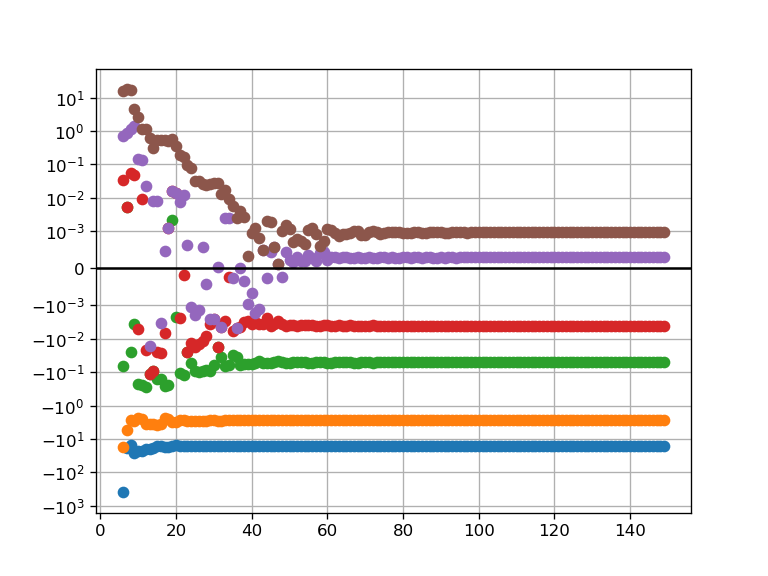

In [686]:
plt.figure()
for i in range(6):
    plt.plot(N_jac_arr,w_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

In [687]:

N_jac_arr = np.arange(10,150,1)

s_arr = np.zeros((10,len(N_jac_arr)))

for i in tqdm(range(len(N_jac_arr))):
    N_jac_ = N_jac_arr[i]
    s = sc.linalg.svdvals(J[:,:N_jac_])
    s_arr[:,i]=np.sort(s.real)[:10]

  0%|          | 0/140 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


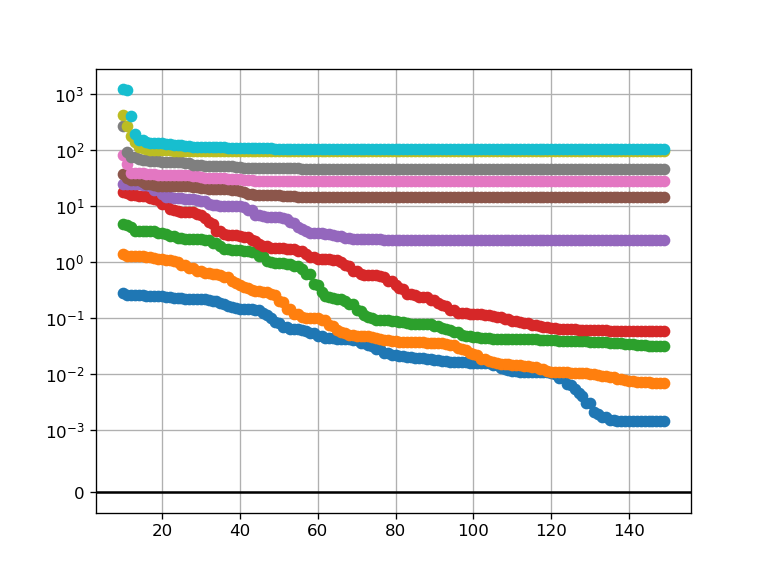

In [688]:
plt.figure()
for i in range(10):
    plt.plot(N_jac_arr,s_arr[i,:],'o')
plt.grid()
plt.yscale('symlog', linthresh=1e-3)
plt.axhline(0, color='k')

## For branch

In [301]:
pz = np.load('stoma_equilib_Vcal=4.253e-01_N=200.npy')
Pfur_0,Zfur_0 =  get_PZ_fur_from_pz(pz)
N = len(Pfur_0)

In [354]:
Vol,Sqr = get_VolSqr(Pfur_0,Zfur_0)
Vcal = Vol/4/np.pi*3/(Sqr/4/np.pi)**(3/2)
Vcal

0.4252839313757316

In [362]:
Sigma, Pressure = get_Sigma_Pressure_from_arr(Pfur_0,Zfur_0)

In [337]:
P, P1,P2,P3,P4 = get_int_fields(-1j*Pfur_0)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Zfur_0)
V = np.sqrt(P1**2+Z1**2)
l_rho = -Z1/V;l_z = P1/V;
H, force =get_H_force_from_ar(Pfur_0,Zfur_0)

<IPython.core.display.Javascript object>


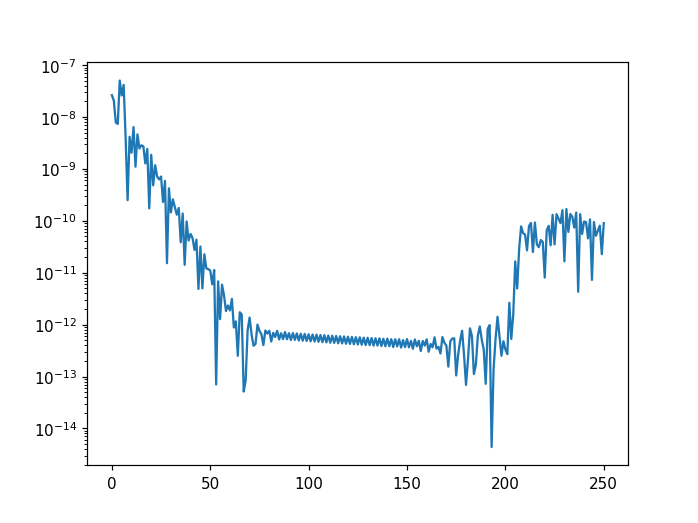

In [302]:
plt.figure()
plt.plot(abs(get_velo_norm_fur_full(Pfur_0, Zfur_0)))
plt.yscale('log')

In [303]:
J = get_J(Pfur_0,Zfur_0, N_jac)

In [304]:
w,U = sc.linalg.eig(J[:N_jac])

In [309]:
np.sort(w)[::-1][:8]

array([ 3.35144700e-07+0.00000000e+00j, -2.04193416e-08+1.09037523e-08j,
       -2.04193416e-08-1.09037523e-08j, -4.04613640e-02+0.00000000e+00j,
       -2.67189554e+00+0.00000000e+00j, -1.67698994e+01+0.00000000e+00j,
       -2.14388646e+01+0.00000000e+00j, -5.09406122e+01+0.00000000e+00j])

In [310]:
H1,H2 = get_H12_from_ar(Pfur_0, Zfur_0)
a_loc = 1/(H1**2 + H2**2)**(1/2)/np.sqrt(2)
P0= get_int_field(-1j*Pfur_0);Z0 = get_int_field(Zfur_0)
a_h = (Z0[0]-Z0[-1])/2;
alpha = 2
a_reg = 2/(1/a_h+alpha*1/a_loc)

<IPython.core.display.Javascript object>


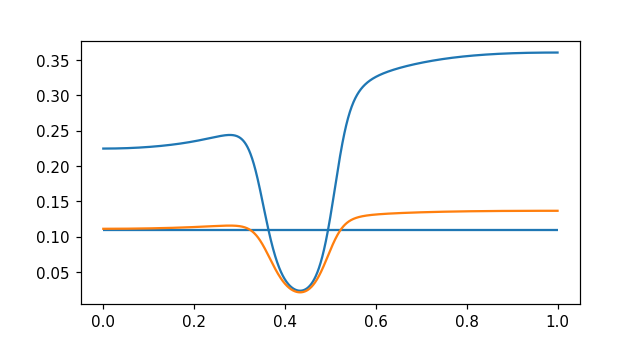

In [311]:
plt.figure()
plt.plot(Tau_int,a_loc)
plt.hlines(a_h,0,1)
plt.plot(Tau_int,a_reg)

In [318]:
Pfur_0_g_loc,Zfur_0_g_loc = make_F_v_repar(Pfur_0, Zfur_0, a_reg,N_proj=300)

<IPython.core.display.Javascript object>


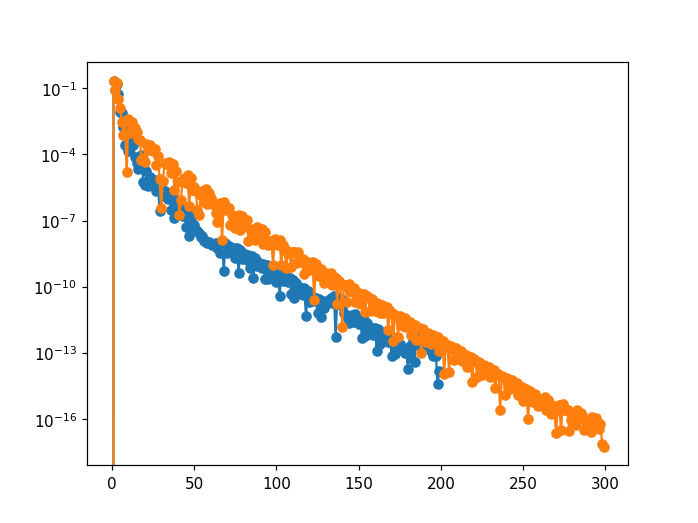

In [319]:
plt.figure()
plt.plot(abs(Pfur_0),'o-')
plt.plot(abs(Pfur_0_g_loc),'o-')

plt.yscale('log')

<IPython.core.display.Javascript object>


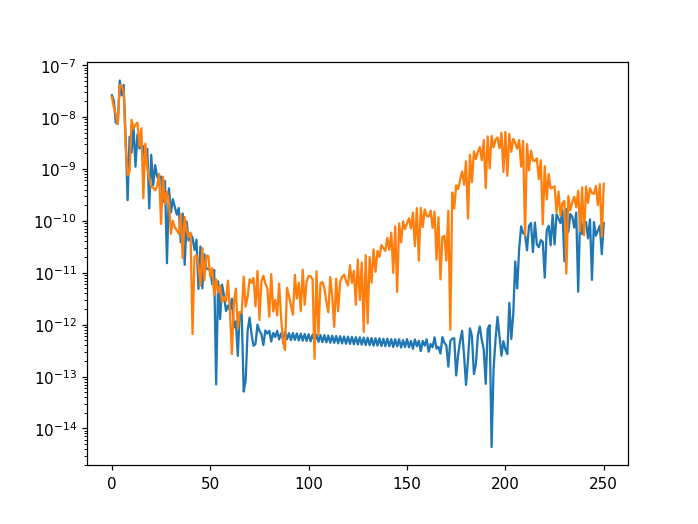

In [320]:
plt.figure()
plt.plot(abs(get_velo_norm_fur_full(Pfur_0, Zfur_0)))
plt.plot(abs(get_velo_norm_fur_full(Pfur_0_g_loc, Zfur_0_g_loc)))

plt.yscale('log')

In [321]:
J_g_loc = get_J(Pfur_0_g_loc,Zfur_0_g_loc, N_jac)

In [322]:
w_g_loc,U_g_loc = sc.linalg.eig(J_g_loc[:N_jac])

In [325]:
np.sort(w.real)[::-1][:8]

array([ 3.35144700e-07, -2.04193416e-08, -2.04193416e-08, -4.04613640e-02,
       -2.67189554e+00, -1.67698994e+01, -2.14388646e+01, -5.09406122e+01])

In [328]:
np.sort(w_g_loc.real)[::-1][:8]

array([ 3.53738529e-07, -1.33482336e-08, -2.43697437e-08, -4.04614201e-02,
       -2.67189549e+00, -1.67698994e+01, -2.14388649e+01, -5.09406123e+01])

In [333]:
N_jac_arr = np.arange(10,N_jac,1)

w_arr = np.zeros((10,len(N_jac_arr)))

for i in tqdm(range(len(N_jac_arr))):
    N_jac_ = N_jac_arr[i]
    w_,U_ = sc.linalg.eig(J_g_loc[:N_jac_,:N_jac_])
    w_arr[:,i]=np.sort(w_.real)[-10:]

  0%|          | 0/170 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


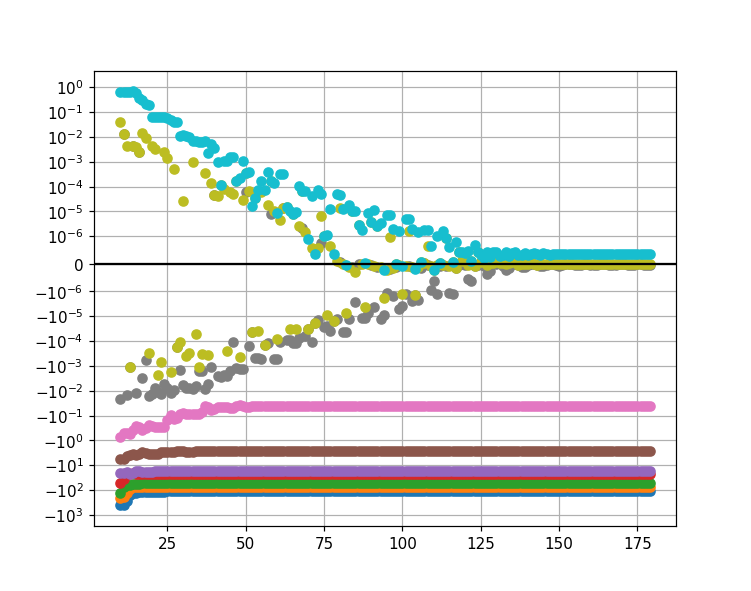

In [334]:
plt.figure()
for i in range(10):
    plt.plot(N_jac_arr,w_arr[i,:],'o')

plt.grid()
plt.yscale('symlog', linthresh=1e-6)
plt.axhline(0, color='k')

In [343]:
Div_v_sigma = get_div_v_oper_from_arr(Pfur_0, Zfur_0)
Div_v_sigma_g_loc = get_div_v_oper_from_arr(Pfur_0_g_loc, Zfur_0_g_loc)

<IPython.core.display.Javascript object>


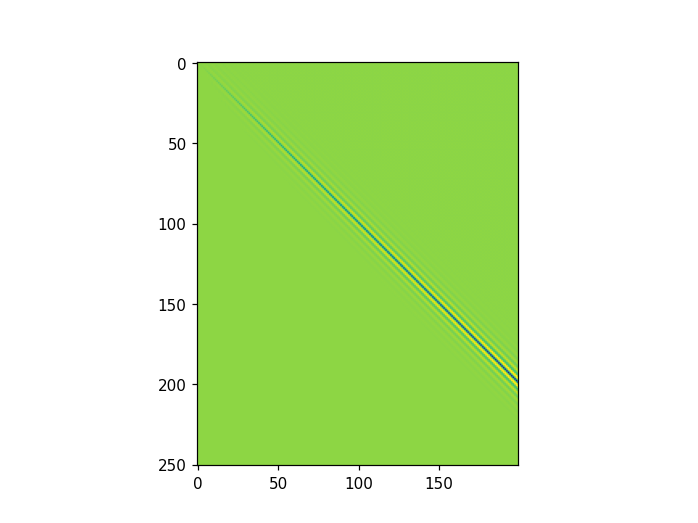

<IPython.core.display.Javascript object>


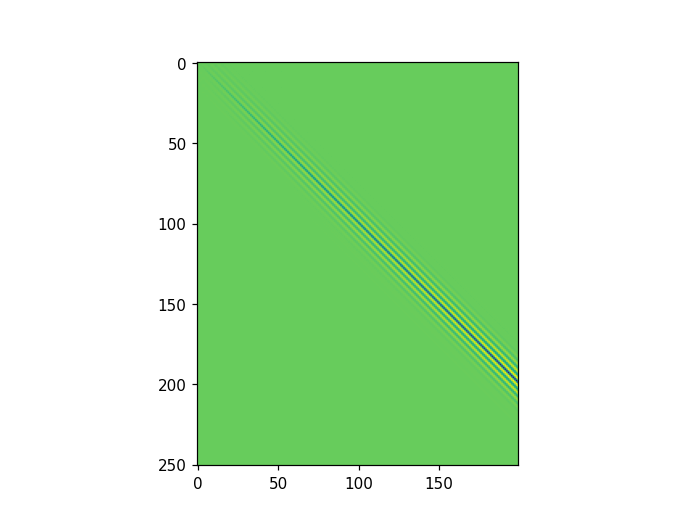

In [344]:
plt.figure()
plt.imshow(Div_v_sigma)
plt.figure()
plt.imshow(Div_v_sigma_g_loc)

In [348]:
w_sigma = sc.linalg.eigvals(Div_v_sigma[:N_sigma,:N_sigma])
w_sigma_g_loc = sc.linalg.eigvals(Div_v_sigma_g_loc[:N_sigma,:N_sigma])

In [349]:
np.sort(w_sigma.real)[::-1][:8]

array([-3.30771508e-04, -2.49708148e-02, -5.05557749e-01, -8.40062117e-01,
       -9.80647869e-01, -1.15105044e+00, -1.37960515e+00, -1.49510572e+00])

In [350]:
np.sort(w_sigma_g_loc.real)[::-1][:8]

array([-3.30771491e-04, -2.49708148e-02, -5.05557749e-01, -8.40062117e-01,
       -9.80647869e-01, -1.15105044e+00, -1.37960515e+00, -1.49510572e+00])

In [365]:
data={'Vol':Vol,'Sqr':Sqr,'Vcal':Vcal, 'Sigma':Sigma,'Pressure':Pressure}
data['initial']={'pz':pz,'J':J, 'w':np.sort(w.real)[::-1][:8], 'w_sigma':np.sort(w_sigma.real)[::-1][:8]}
data['g_loc']={'pz':get_pz_from_PZ_fur(Pfur_0_g_loc, Zfur_0_g_loc),
               'J':J_g_loc, 'w':np.sort(w_g_loc.real)[::-1][:8], 'w_sigma':np.sort(w_sigma_g_loc.real)[::-1][:8]}


In [368]:
np.save(f'stoma_equilib_data_Vcal={Vcal:.3e}.npy', data)

In [372]:
data = np.load('stoma_equilib_data_Vcal=4.253e-01.npy', allow_pickle=True).item()

In [373]:
data

{'Vol': 1.0694837296512265,
 'Sqr': 8.942952618820184,
 'Vcal': 0.4252839313757316,
 'Sigma': -0.08691572245908316,
 'Pressure': 0.48452249604914,
 'initial': {'pz': array([-5.23424741e-04,  2.18725883e-01,  9.20814886e-02, -8.57393232e-02,
         -3.02068013e-01,  1.46093450e-01, -3.76876480e-03,  5.55639744e-02,
         -2.31765282e-02, -7.81157404e-03, -3.51152589e-02,  7.44655783e-03,
         -1.91532088e-04,  1.69047018e-03,  2.15574974e-03, -2.74140618e-04,
          1.21311342e-03, -1.69153391e-03, -2.29647888e-04, -1.45348039e-04,
         -3.21008626e-04,  2.61504520e-04, -5.64839194e-06,  3.75552158e-04,
          2.28540820e-04, -2.74465485e-04, -2.05238264e-04, -7.27548211e-05,
         -3.25721330e-05,  4.04051921e-05, -3.78024574e-06,  2.18928006e-05,
          1.12721462e-04, -3.92568116e-05,  7.92605514e-05, -9.36075502e-05,
         -1.63368307e-05, -5.33725102e-06,  5.91715599e-06,  3.89003855e-06,
          1.02637458e-06,  1.67831568e-05,  1.50288698e-05,  3.495

In [350]:
%%bash
find . -name 'stoma_equilib_Vcal=*_N=200.npy'

./stoma_equilib_Vcal=5.251e-01_N=200.npy
./stoma_equilib_Vcal=6.298e-01_N=200.npy
./stoma_equilib_Vcal=4.453e-01_N=200.npy
./stoma_equilib_Vcal=4.353e-01_N=200.npy
./stoma_equilib_Vcal=4.852e-01_N=200.npy
./stoma_equilib_Vcal=5.949e-01_N=200.npy
./stoma_equilib_Vcal=5.450e-01_N=200.npy
./stoma_equilib_Vcal=6.487e-01_N=200.npy
./stoma_equilib_Vcal=6.567e-01_N=200.npy
./stoma_equilib_Vcal=5.650e-01_N=200.npy
./stoma_equilib_Vcal=5.151e-01_N=200.npy
./stoma_equilib_Vcal=5.749e-01_N=200.npy
./stoma_equilib_Vcal=4.153e-01_N=200.npy
./stoma_equilib_Vcal=6.198e-01_N=200.npy
./stoma_equilib_Vcal=4.951e-01_N=200.npy
./stoma_equilib_Vcal=6.477e-01_N=200.npy
./stoma_equilib_Vcal=6.507e-01_N=200.npy
./stoma_equilib_Vcal=5.999e-01_N=200.npy
./stoma_equilib_Vcal=6.457e-01_N=200.npy
./stoma_equilib_Vcal=6.397e-01_N=200.npy
./stoma_equilib_Vcal=5.899e-01_N=200.npy
./stoma_equilib_Vcal=5.799e-01_N=200.npy
./stoma_equilib_Vcal=5.350e-01_N=200.npy
./stoma_equilib_Vcal=6.587e-01_N=200.npy
./stoma_equilib_

In [313]:
names = [
'./stoma_equilib_Vcal=5.251e-01_N=200.npy',
'./stoma_equilib_Vcal=6.298e-01_N=200.npy',
'./stoma_equilib_Vcal=4.453e-01_N=200.npy',
'./stoma_equilib_Vcal=4.353e-01_N=200.npy',
'./stoma_equilib_Vcal=4.852e-01_N=200.npy',
'./stoma_equilib_Vcal=5.949e-01_N=200.npy',
'./stoma_equilib_Vcal=5.450e-01_N=200.npy',
'./stoma_equilib_Vcal=6.567e-01_N=200.npy',
'./stoma_equilib_Vcal=5.650e-01_N=200.npy',
'./stoma_equilib_Vcal=5.151e-01_N=200.npy',
'./stoma_equilib_Vcal=5.749e-01_N=200.npy',
'./stoma_equilib_Vcal=4.153e-01_N=200.npy',
'./stoma_equilib_Vcal=6.198e-01_N=200.npy',
'./stoma_equilib_Vcal=4.951e-01_N=200.npy',
'./stoma_equilib_Vcal=5.999e-01_N=200.npy',
'./stoma_equilib_Vcal=6.397e-01_N=200.npy',
'./stoma_equilib_Vcal=5.899e-01_N=200.npy',
'./stoma_equilib_Vcal=5.799e-01_N=200.npy',
'./stoma_equilib_Vcal=5.350e-01_N=200.npy',
'./stoma_equilib_Vcal=6.587e-01_N=200.npy',
'./stoma_equilib_Vcal=4.752e-01_N=200.npy',
'./stoma_equilib_Vcal=6.148e-01_N=200.npy',
'./stoma_equilib_Vcal=4.552e-01_N=200.npy',
'./stoma_equilib_Vcal=5.849e-01_N=200.npy',
'./stoma_equilib_Vcal=6.348e-01_N=200.npy',
'./stoma_equilib_Vcal=6.497e-01_N=200.npy',
'./stoma_equilib_Vcal=6.607e-01_N=200.npy',
'./stoma_equilib_Vcal=5.550e-01_N=200.npy',
'./stoma_equilib_Vcal=4.652e-01_N=200.npy',
'./stoma_equilib_Vcal=5.051e-01_N=200.npy',
'./stoma_equilib_Vcal=4.253e-01_N=200.npy',
'./stoma_equilib_Vcal=6.248e-01_N=200.npy',
'./stoma_equilib_Vcal=6.447e-01_N=200.npy',
'./stoma_equilib_Vcal=6.048e-01_N=200.npy',
'./stoma_equilib_Vcal=6.098e-01_N=200.npy',
'./stoma_equilib_Vcal=6.547e-01_N=200.npy'
]

In [391]:
import os

In [402]:
for name in tqdm(names):
    pz = np.load(name)
    Pfur_0,Zfur_0 =  get_PZ_fur_from_pz(pz)
    N = len(Pfur_0)
    Vol,Sqr = get_VolSqr(Pfur_0,Zfur_0)
    Vcal = Vol/4/np.pi*3/(Sqr/4/np.pi)**(3/2)
    data_path = f'stoma_equilib_data_Vcal={Vcal:.3e}.npy'
    print(data_path)
    if os.path.exists(data_path):
        print('Already exist')
        continue
    Sigma, Pressure = get_Sigma_Pressure_from_arr(Pfur_0,Zfur_0)

    J = get_J(Pfur_0,Zfur_0, N_jac)

    w,U = sc.linalg.eig(J[:N_jac])

    H1,H2 = get_H12_from_ar(Pfur_0, Zfur_0)
    a_loc = 1/(H1**2 + H2**2)**(1/2)/np.sqrt(2)
    P0= get_int_field(-1j*Pfur_0);Z0 = get_int_field(Zfur_0)
    a_h = (Z0[0]-Z0[-1])/2;
    alpha = 2
    a_reg = 2/(1/a_h+alpha*1/a_loc)

    Pfur_0_g_loc,Zfur_0_g_loc = make_F_v_repar(Pfur_0, Zfur_0, a_reg,N_proj=300)

    J_g_loc = get_J(Pfur_0_g_loc,Zfur_0_g_loc, N_jac)

    w_g_loc,U_g_loc = sc.linalg.eig(J_g_loc[:N_jac])

    Div_v_sigma = get_div_v_oper_from_arr(Pfur_0, Zfur_0)
    Div_v_sigma_g_loc = get_div_v_oper_from_arr(Pfur_0_g_loc, Zfur_0_g_loc)

    w_sigma = sc.linalg.eigvals(Div_v_sigma[:N_sigma,:N_sigma])
    w_sigma_g_loc = sc.linalg.eigvals(Div_v_sigma_g_loc[:N_sigma,:N_sigma])

    data={'Vol':Vol,'Sqr':Sqr,'Vcal':Vcal, 'Sigma':Sigma,'Pressure':Pressure}
    print(data)

    data['initial']={'pz':pz,'J':J, 'w':np.sort(w.real)[::-1][:8], 'w_sigma':np.sort(w_sigma.real)[::-1][:8]}
    data['g_loc']={'pz':get_pz_from_PZ_fur(Pfur_0_g_loc, Zfur_0_g_loc),
               'J':J_g_loc, 'w':np.sort(w_g_loc.real)[::-1][:8], 'w_sigma':np.sort(w_sigma_g_loc.real)[::-1][:8]}

    np.save(data_path, data)

  0%|          | 0/34 [00:00<?, ?it/s]

stoma_equilib_data_Vcal=5.251e-01.npy
Already exist
stoma_equilib_data_Vcal=6.298e-01.npy
Already exist
stoma_equilib_data_Vcal=4.453e-01.npy
Already exist
stoma_equilib_data_Vcal=4.353e-01.npy
Already exist
stoma_equilib_data_Vcal=4.852e-01.npy
Already exist
stoma_equilib_data_Vcal=5.949e-01.npy
Already exist
stoma_equilib_data_Vcal=5.450e-01.npy
Already exist
stoma_equilib_data_Vcal=5.650e-01.npy
Already exist
stoma_equilib_data_Vcal=5.151e-01.npy
Already exist
stoma_equilib_data_Vcal=5.749e-01.npy
Already exist
stoma_equilib_data_Vcal=4.153e-01.npy
Already exist
stoma_equilib_data_Vcal=6.198e-01.npy
Already exist
stoma_equilib_data_Vcal=4.951e-01.npy
Already exist
stoma_equilib_data_Vcal=5.999e-01.npy
Already exist
stoma_equilib_data_Vcal=6.397e-01.npy
Already exist
stoma_equilib_data_Vcal=6.544e-01.npy
{'Vol': 1.1580902946175295, 'Sqr': 7.075416422901692, 'Vcal': 0.6543959468860371, 'Sigma': -1.1446389766679679, 'Pressure': 4.662153385229516}
stoma_equilib_data_Vcal=5.899e-01.npy
A

_________________
sym

In [34]:
def get_PZ_fur_from_pz_sym(pz_sym):
    N_ = len(pz_sym)
    P_fur = np.zeros(N_); Z_fur = np.zeros(N_)
    P_fur[1::2]=pz_sym[::2]
    Z_fur[1::2]=pz_sym[1::2]
    return P_fur, Z_fur


def get_pz_sym_from_PZ_fur(P_fur, Z_fur):
    N_ = len(Z_fur)
    pz_sym = np.zeros(N)
    pz_sym[::2]=P_fur[:N][1::2]
    pz_sym[1::2]=Z_fur[:N][1::2]
    return pz_sym

In [403]:
%%bash
find . -name 'oblate_equilib_Vcal=*_N=75.npy'

./oblate_equilib_Vcal=5.312e-01_N=75.npy
./oblate_equilib_Vcal=5.372e-01_N=75.npy
./oblate_equilib_Vcal=5.938e-01_N=75.npy
./oblate_equilib_Vcal=4.990e-01_N=75.npy
./oblate_equilib_Vcal=5.331e-01_N=75.npy
./oblate_equilib_Vcal=5.231e-01_N=75.npy
./oblate_equilib_Vcal=4.978e-01_N=75.npy
./oblate_equilib_Vcal=5.280e-01_N=75.npy
./oblate_equilib_Vcal=5.534e-01_N=75.npy
./oblate_equilib_Vcal=5.028e-01_N=75.npy
./oblate_equilib_Vcal=5.432e-01_N=75.npy
./oblate_equilib_Vcal=5.129e-01_N=75.npy
./oblate_equilib_Vcal=5.251e-01_N=75.npy
./oblate_equilib_Vcal=5.332e-01_N=75.npy
./oblate_equilib_Vcal=5.110e-01_N=75.npy
./oblate_equilib_Vcal=5.210e-01_N=75.npy
./oblate_equilib_Vcal=5.271e-01_N=75.npy
./oblate_equilib_Vcal=5.412e-01_N=75.npy
./oblate_equilib_Vcal=5.070e-01_N=75.npy
./oblate_equilib_Vcal=5.786e-01_N=75.npy
./oblate_equilib_Vcal=5.030e-01_N=75.npy
./oblate_equilib_Vcal=5.130e-01_N=75.npy
./oblate_equilib_Vcal=5.170e-01_N=75.npy
./oblate_equilib_Vcal=5.179e-01_N=75.npy
./oblate_equilib

In [97]:
names_oblate = [
'./oblate_equilib_Vcal=5.312e-01_N=75.npy',
'./oblate_equilib_Vcal=5.372e-01_N=75.npy',
'./oblate_equilib_Vcal=5.938e-01_N=75.npy',
'./oblate_equilib_Vcal=4.990e-01_N=75.npy',
'./oblate_equilib_Vcal=5.331e-01_N=75.npy',
'./oblate_equilib_Vcal=5.231e-01_N=75.npy',
'./oblate_equilib_Vcal=4.978e-01_N=75.npy',
'./oblate_equilib_Vcal=5.280e-01_N=75.npy',
'./oblate_equilib_Vcal=5.534e-01_N=75.npy',
'./oblate_equilib_Vcal=5.028e-01_N=75.npy',
'./oblate_equilib_Vcal=5.432e-01_N=75.npy',
'./oblate_equilib_Vcal=5.129e-01_N=75.npy',
'./oblate_equilib_Vcal=5.251e-01_N=75.npy',
'./oblate_equilib_Vcal=5.332e-01_N=75.npy',
'./oblate_equilib_Vcal=5.110e-01_N=75.npy',
'./oblate_equilib_Vcal=5.210e-01_N=75.npy',
'./oblate_equilib_Vcal=5.271e-01_N=75.npy',
'./oblate_equilib_Vcal=5.412e-01_N=75.npy',
'./oblate_equilib_Vcal=5.070e-01_N=75.npy',
'./oblate_equilib_Vcal=5.786e-01_N=75.npy',
'./oblate_equilib_Vcal=5.030e-01_N=75.npy',
'./oblate_equilib_Vcal=5.130e-01_N=75.npy',
'./oblate_equilib_Vcal=5.170e-01_N=75.npy',
'./oblate_equilib_Vcal=5.179e-01_N=75.npy',
'./oblate_equilib_Vcal=5.685e-01_N=75.npy',
'./oblate_equilib_Vcal=6.036e-01_N=75.npy',
'./oblate_equilib_Vcal=5.483e-01_N=75.npy',
'./oblate_equilib_Vcal=5.584e-01_N=75.npy',
'./oblate_equilib_Vcal=5.392e-01_N=75.npy',
'./oblate_equilib_Vcal=5.010e-01_N=75.npy',
'./oblate_equilib_Vcal=5.150e-01_N=75.npy',
'./oblate_equilib_Vcal=5.311e-01_N=75.npy',
'./oblate_equilib_Vcal=5.382e-01_N=75.npy',
'./oblate_equilib_Vcal=5.090e-01_N=75.npy',
'./oblate_equilib_Vcal=5.836e-01_N=75.npy',
'./oblate_equilib_Vcal=5.352e-01_N=75.npy',
'./oblate_equilib_Vcal=5.634e-01_N=75.npy',
'./oblate_equilib_Vcal=5.230e-01_N=75.npy',
'./oblate_equilib_Vcal=5.986e-01_N=75.npy',
'./oblate_equilib_Vcal=5.291e-01_N=75.npy',
'./oblate_equilib_Vcal=5.190e-01_N=75.npy',
'./oblate_equilib_Vcal=5.735e-01_N=75.npy',
'./oblate_equilib_Vcal=5.887e-01_N=75.npy',
'./oblate_equilib_Vcal=5.078e-01_N=75.npy',
'./oblate_equilib_Vcal=5.050e-01_N=75.npy'
]

In [ ]:
names_oblate = [
'./oblate_equilib_Vcal=5.312e-01_N=75.npy',
'./oblate_equilib_Vcal=5.372e-01_N=75.npy',
'./oblate_equilib_Vcal=5.938e-01_N=75.npy',
'./oblate_equilib_Vcal=4.990e-01_N=75.npy',
'./oblate_equilib_Vcal=5.331e-01_N=75.npy',
'./oblate_equilib_Vcal=5.231e-01_N=75.npy',
'./oblate_equilib_Vcal=4.978e-01_N=75.npy',
'./oblate_equilib_Vcal=5.280e-01_N=75.npy',
'./oblate_equilib_Vcal=5.534e-01_N=75.npy',
'./oblate_equilib_Vcal=5.028e-01_N=75.npy',
'./oblate_equilib_Vcal=5.432e-01_N=75.npy',
'./oblate_equilib_Vcal=5.129e-01_N=75.npy',
'./oblate_equilib_Vcal=5.251e-01_N=75.npy',
'./oblate_equilib_Vcal=5.332e-01_N=75.npy',
'./oblate_equilib_Vcal=5.110e-01_N=75.npy',
'./oblate_equilib_Vcal=5.210e-01_N=75.npy',
'./oblate_equilib_Vcal=5.271e-01_N=75.npy',
'./oblate_equilib_Vcal=5.412e-01_N=75.npy',
'./oblate_equilib_Vcal=5.070e-01_N=75.npy',
'./oblate_equilib_Vcal=5.786e-01_N=75.npy',
'./oblate_equilib_Vcal=5.030e-01_N=75.npy',
'./oblate_equilib_Vcal=5.130e-01_N=75.npy',
'./oblate_equilib_Vcal=5.170e-01_N=75.npy',
'./oblate_equilib_Vcal=5.179e-01_N=75.npy',
'./oblate_equilib_Vcal=5.685e-01_N=75.npy',
'./oblate_equilib_Vcal=6.036e-01_N=75.npy',
'./oblate_equilib_Vcal=5.483e-01_N=75.npy',
'./oblate_equilib_Vcal=5.584e-01_N=75.npy',
'./oblate_equilib_Vcal=5.392e-01_N=75.npy',
'./oblate_equilib_Vcal=5.010e-01_N=75.npy',
'./oblate_equilib_Vcal=5.150e-01_N=75.npy',
'./oblate_equilib_Vcal=5.311e-01_N=75.npy',
'./oblate_equilib_Vcal=5.382e-01_N=75.npy',
'./oblate_equilib_Vcal=5.090e-01_N=75.npy',
'./oblate_equilib_Vcal=5.836e-01_N=75.npy',
'./oblate_equilib_Vcal=5.352e-01_N=75.npy',
'./oblate_equilib_Vcal=5.634e-01_N=75.npy',
'./oblate_equilib_Vcal=5.230e-01_N=75.npy',
'./oblate_equilib_Vcal=5.986e-01_N=75.npy',
'./oblate_equilib_Vcal=5.291e-01_N=75.npy',
'./oblate_equilib_Vcal=5.190e-01_N=75.npy',
'./oblate_equilib_Vcal=5.735e-01_N=75.npy',
'./oblate_equilib_Vcal=5.887e-01_N=75.npy',
'./oblate_equilib_Vcal=5.078e-01_N=75.npy',
'./oblate_equilib_Vcal=5.050e-01_N=75.npy'
]

In [391]:
import os

In [ ]:
for name in tqdm(names_oblate):
    pz = np.load(name)
    Pfur_0,Zfur_0 =  get_PZ_fur_from_pz_sym(pz)
    N = len(Pfur_0)
    Vol,Sqr = get_VolSqr(Pfur_0,Zfur_0)
    Vcal = Vol/4/np.pi*3/(Sqr/4/np.pi)**(3/2)
    data_path = f'oblate_equilib_data_Vcal={Vcal:.3e}.npy'
    print(data_path)
    if os.path.exists(data_path):
        print('Already exist')
        continue
    Sigma, Pressure = get_Sigma_Pressure_from_arr(Pfur_0,Zfur_0)

    J = get_J(Pfur_0,Zfur_0, N_jac)

    w,U = sc.linalg.eig(J[:N_jac])

    

    Div_v_sigma = get_div_v_oper_from_arr(Pfur_0, Zfur_0)

    w_sigma = sc.linalg.eigvals(Div_v_sigma[:N_sigma,:N_sigma])


    data={'Vol':Vol,'Sqr':Sqr,'Vcal':Vcal, 'Sigma':Sigma,'Pressure':Pressure}
    print(data)

    data['initial']={'pz':pz,'J':J, 'w':np.sort(w.real)[::-1][:8], 'w_sigma':np.sort(w_sigma.real)[::-1][:8]}

    np.save(data_path, data)

  0%|          | 0/45 [00:00<?, ?it/s]

oblate_equilib_data_Vcal=5.312e-01.npy
Already exist
oblate_equilib_data_Vcal=5.372e-01.npy
Already exist
oblate_equilib_data_Vcal=5.938e-01.npy
Already exist
oblate_equilib_data_Vcal=4.990e-01.npy


## Stoma analysis

In [310]:
%%bash
touch stoma_data_names.txt
find . -name 'stoma_equilib_data_Vcal=*.npy' > stoma_data_names.txt

In [328]:
stoma_data_names = np.loadtxt('stoma_data_names.txt', dtype=str)

Vcal_arr_data = [float(data_path.replace('./stoma_equilib_data_Vcal=','').replace('.npy','')) for data_path in stoma_data_names]

Vcal_index_sort = np.argsort(Vcal_arr_data)
stoma_data_names = stoma_data_names[Vcal_index_sort]

In [331]:
j_c = np.argmin(abs(np.array(Vcal_arr_data)[Vcal_index_sort]-0.5899))
j_c

19

In [340]:
data_path = stoma_data_names[12]
data = np.load(data_path, allow_pickle=True).item()
Vcal = data['Vcal']
print(Vcal)
Sqr = data['Sqr']
Sigma = data['Sigma']
Pressure = data['Pressure']
pz = data['initial']['pz']
P_fur_,Z_fur_ = get_PZ_fur_from_pz(pz)
Energy = get_Energy(P_fur_,Z_fur_)
w_slow_all = data['initial']['w'][:9]
h0 = get_int_field(Z_fur_)[0]    
w_sigma = data['initial']['w_sigma'][:4]

0.5350475457915901


<IPython.core.display.Javascript object>


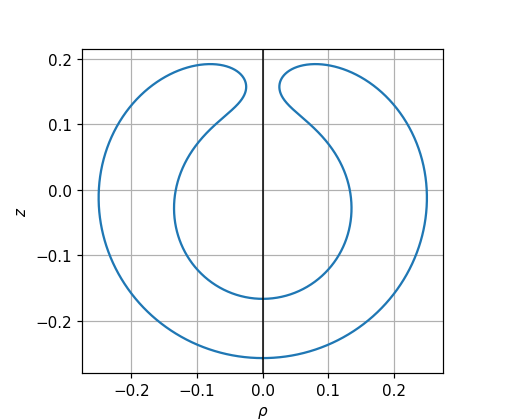

Text(0, 0.5, '$z$')

In [341]:
%matplotlib notebook
fig, ax = plt.subplots(figsize=(6,6))
ax.grid()



P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_)
V = np.sqrt(P1**2+Z1**2)
l_rho = -Z1/V;l_z = P1/V;
H, force =get_H_force_from_ar(P_fur_,Z_fur_)


line_0,= plt.plot((1/Sqr)**(1/2)*np.hstack([-P[::-1],P]),(1/Sqr)**(1/2)*np.hstack([Z[::-1],Z]),'-')


plt.axvline(0, color='k', lw=1)


ax.axis('scaled')

#ax.set_title(fr'$V={Vcal:.2f}$')
ax.set_xlabel(r'$\rho$')
ax.set_ylabel(r'$z$')



In [362]:
Vcal_arr = []
Sqr_arr = []
Energy_arr = []
Pressure_arr = []
Sigma_arr = []

w_slow_all_arr = []
w_sigma_arr = []



for data_path in stoma_data_names:
    #data_path = 'stoma_equilib_data_Vcal='+name[21:30]+'.npy'
    data = np.load(data_path, allow_pickle=True).item()
    Vcal = data['Vcal']
    Sqr = data['Sqr']
    Sigma = data['Sigma']
    Pressure = data['Pressure']
    pz = data['initial']['pz']
    P_fur_,Z_fur_ = get_PZ_fur_from_pz(pz)
    Energy = get_Energy(P_fur_,Z_fur_)
    w_slow_all = data['initial']['w'][:9]
    h0 = get_int_field(Z_fur_)[0]    
    w_sigma = data['initial']['w_sigma'][:4]

    Sqr_arr.append(Sqr)
    Vcal_arr.append(Vcal)
    Energy_arr.append(Energy)
    Pressure_arr.append(Pressure)
    Sigma_arr.append(Sigma)
    w_slow_all_arr.append(w_slow_all)
    w_sigma_arr.append(w_sigma)

Vcal_index_sort = np.argsort(Vcal_arr)
Vcal_arr = np.array(Vcal_arr)[Vcal_index_sort]
Sqr_arr = np.array(Sqr_arr)[Vcal_index_sort]
Sigma_arr = np.array(Sigma_arr)[Vcal_index_sort]
Pressure_arr = np.array(Pressure_arr)[Vcal_index_sort]

Energy_arr = np.array(Energy_arr)[Vcal_index_sort]
w_slow_all_arr = np.array(w_slow_all_arr)[Vcal_index_sort]

w_sigma_arr = np.array(w_sigma_arr)[Vcal_index_sort]


In [115]:
# Vcal_arr = []
# Sqr_arr = []

# Energy_arr = []
# w_slow_arr = []
# w_slow_2_arr = []

# w_sigma_arr = []
# w_sigma_2_arr = []
# w_sigma_3_arr = []

# for name in names:
#     data_path = 'stoma_equilib_data_Vcal='+name[21:30]+'.npy'
#     data = np.load(data_path, allow_pickle=True).item()
#     Vcal = data['Vcal']
#     Sqr = data['Sqr']
#     Sigma = data['Sigma']
#     Pressure = data['Pressure']
#     pz = data['initial']['pz']
#     P_fur_,Z_fur_ = get_PZ_fur_from_pz(pz)
#     Energy = get_Energy(P_fur_,Z_fur_)
    
    
    
#     w_slow = data['initial']['w'][3]
#     w_slow_2 = data['initial']['w'][4]
    
#     w_sigma = data['initial']['w_sigma'][0]
#     w_sigma_2 = data['initial']['w_sigma'][1]
#     w_sigma_3 = data['initial']['w_sigma'][2]
#     Sqr_arr.append(Sqr)
#     Vcal_arr.append(Vcal)
#     Energy_arr.append(Energy)
#     w_slow_arr.append(w_slow)
#     w_slow_2_arr.append(w_slow_2)
    
#     w_sigma_arr.append(w_sigma)
#     w_sigma_2_arr.append(w_sigma_2)
#     w_sigma_3_arr.append(w_sigma_3)
# Vcal_arr = np.array(Vcal_arr)
# Sqr_arr = np.array(Sqr_arr)

# Energy_arr = np.array(Energy_arr)
# w_slow_arr = np.array(w_slow_arr)
# w_slow_2_arr = np.array(w_slow_2_arr)
# w_sigma_arr = np.array(w_sigma_arr)
# w_sigma_2_arr = np.array(w_sigma_2_arr)
# w_sigma_3_arr = np.array(w_sigma_3_arr)

<IPython.core.display.Javascript object>


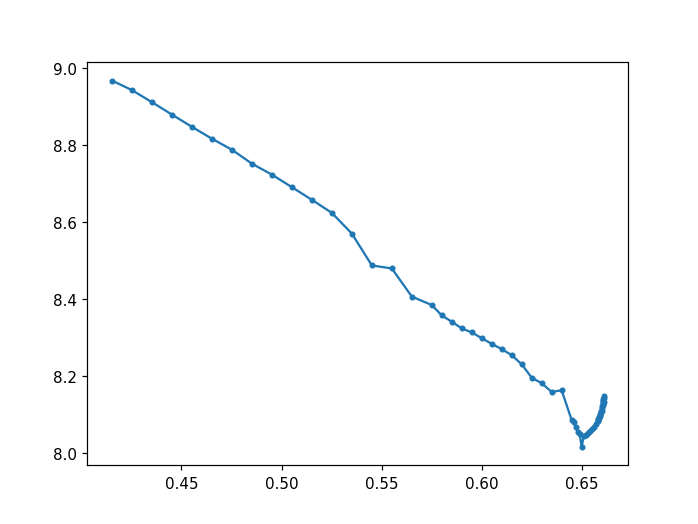

In [220]:
plt.figure()
plt.plot(Vcal_arr, Sqr_arr,'.-')

<IPython.core.display.Javascript object>


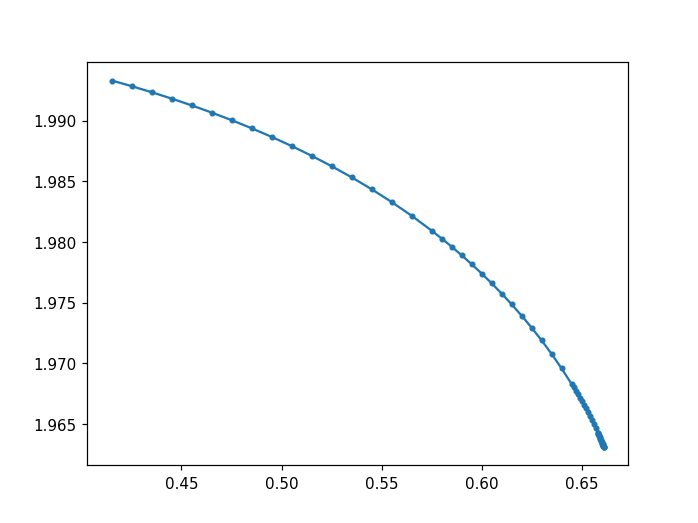

In [221]:
%matplotlib notebook
plt.figure()
plt.plot(Vcal_arr, Energy_arr/8/np.pi,'.-')

In [363]:
w_slow_all_arr_resize = w_slow_all_arr.T*(Sqr_arr**(3/2))

In [364]:
w_sorted=[]
for i in range(w_slow_all_arr_resize.shape[1]):
    w_arr_ = w_slow_all_arr_resize[:,i]
    w_sorted.append(np.sort(w_arr_[abs(w_arr_)>1])[::-1][:4])
w_sorted = np.array(w_sorted)

<IPython.core.display.Javascript object>


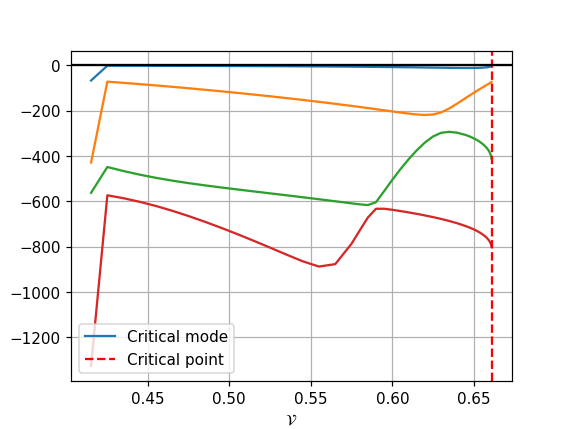

In [375]:
%matplotlib notebook
plt.figure(figsize=(5,3))
#for i in range(6):
#    plt.plot(Vcal_arr, w_slow_all_arr_resize[i],'.', color='C0')
plt.plot(Vcal_arr,w_sorted[:,0],'-',label='Critical mode')
for i in range(1,4):
    plt.plot(Vcal_arr,w_sorted[:,i],'-')
plt.grid()
#plt.plot(Vcal_arr_sorted, w_unstable_sorted,'.-', color='blue')
#plt.plot(Vcal_arr,np.array(h0_arr)/Sqr_arr**(1/2),'.', color='blue')
plt.axvline(Vcal_arr[-1]+5e-4/2, color='red', label='Critical point',ls='--')
plt.axhline(0, color='k')

#plt.axvline(0.503, color='red', ls='dashed', label='Self-intersection')
plt.xlabel(r'$\mathcal{V}$')
plt.ylabel(r'$\lambda S^{3/2}$')
plt.legend(loc='lower left')





#plt.yscale('symlog')

$$

$$

<IPython.core.display.Javascript object>


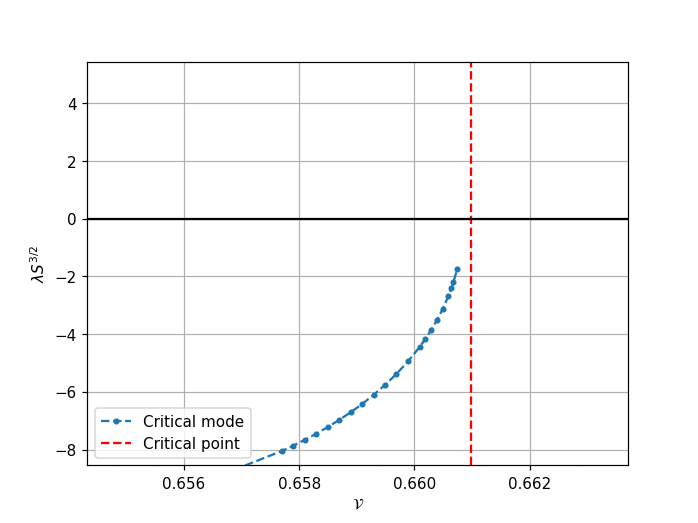

In [229]:
%matplotlib notebook
plt.figure()
#for i in range(6):
#    plt.plot(Vcal_arr, w_slow_all_arr_resize[i],'.', color='C0')
plt.plot(Vcal_arr,w_sorted[:,0],'.--',label='Critical mode')
for i in range(1,4):
    plt.plot(Vcal_arr,w_sorted[:,i],'.--')
plt.grid()
#plt.plot(Vcal_arr_sorted, w_unstable_sorted,'.-', color='blue')
#plt.plot(Vcal_arr,np.array(h0_arr)/Sqr_arr**(1/2),'.', color='blue')
plt.axvline(Vcal_arr[-1]+5e-4/2, color='red', label='Critical point',ls='--')
plt.axhline(0, color='k')

#plt.axvline(0.503, color='red', ls='dashed', label='Self-intersection')
plt.xlabel(r'$\mathcal{V}$')
plt.ylabel(r'$\lambda S^{3/2}$')
plt.legend(loc='lower left')





#plt.yscale('symlog')

<IPython.core.display.Javascript object>


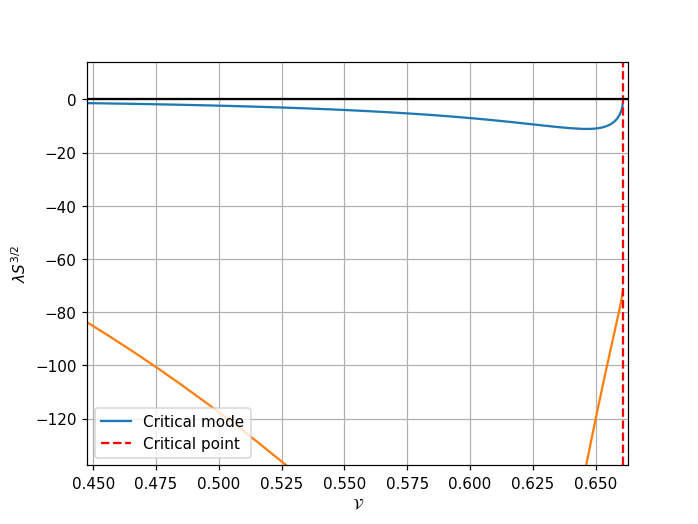

In [225]:
%matplotlib notebook
plt.figure()
#for i in range(6):
#    plt.plot(Vcal_arr, w_slow_all_arr_resize[i],'.', color='C0')
plt.plot(Vcal_arr,w_sorted[:,0],'-',label='Critical mode')
for i in range(1,4):
    plt.plot(Vcal_arr,w_sorted[:,i],'-')
plt.grid()
#plt.plot(Vcal_arr_sorted, w_unstable_sorted,'.-', color='blue')
#plt.plot(Vcal_arr,np.array(h0_arr)/Sqr_arr**(1/2),'.', color='blue')
plt.axvline(Vcal_arr[-1]+5e-4/2, color='red', label='Critical point',ls='--')
plt.axhline(0, color='k')

#plt.axvline(0.503, color='red', ls='dashed', label='Self-intersection')
plt.xlabel(r'$\mathcal{V}$')
plt.ylabel(r'$\lambda S^{3/2}$')
plt.legend(loc='lower left')





#plt.yscale('symlog')

<IPython.core.display.Javascript object>


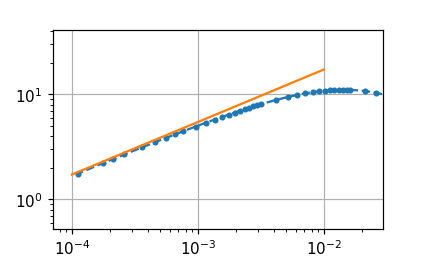

interactive(children=(FloatSlider(value=0.00014998, description='dv', max=0.0003, step=2e-08), FloatSlider(val…

In [376]:
%matplotlib notebook
plt.figure()
plt.grid()
plt.xscale('log')
plt.yscale('log')
line,=plt.plot(Vcal_arr[-1]-Vcal_arr,-w_sorted[:,0],'.--',label='Critical mode')
x_arr = np.logspace(-4,-2,100)
y_arr = x_arr**(1/2) 
line2, = plt.plot(x_arr, y_arr)

@interact(dv=(0,3e-4,2e-8), alpha=(0,0.6,0.01), dz=(0,10,0.05))
def plotm(dv, alpha,dz):
    line.set_xdata(Vcal_arr[-1]+dv-Vcal_arr)
    y_arr = x_arr**alpha*np.exp(dz)
    line2.set_ydata(y_arr)
    #plt.axhline(0, color='k')
    #plt.axvline(0, color='k')
    

In [377]:
np.exp(5.15)

172.43149031685434

<IPython.core.display.Javascript object>


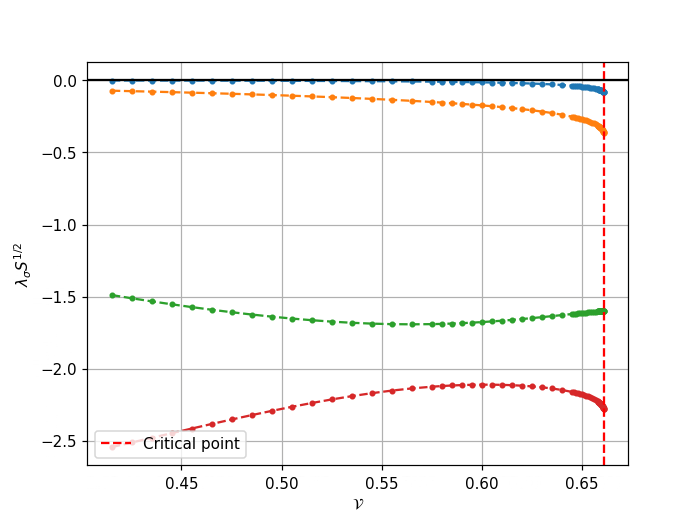

In [228]:
plt.figure()
#for i in range(6):
#    plt.plot(Vcal_arr, w_slow_all_arr_resize[i],'.', color='C0')
for i in range(4):
    plt.plot(Vcal_arr,w_sigma_arr[:,i]*np.sqrt(Sqr_arr),'.--')
plt.grid()
#plt.plot(Vcal_arr_sorted, w_unstable_sorted,'.-', color='blue')
#plt.plot(Vcal_arr,np.array(h0_arr)/Sqr_arr**(1/2),'.', color='blue')
plt.axvline(Vcal_arr[-1]+5e-4/2, color='red', label='Critical point',ls='--')
plt.axhline(0, color='k')
plt.xlabel(r'$\mathcal{V}$')
plt.ylabel(r'$\lambda_\sigma S^{1/2}$')
plt.legend(loc='lower left')

<IPython.core.display.Javascript object>


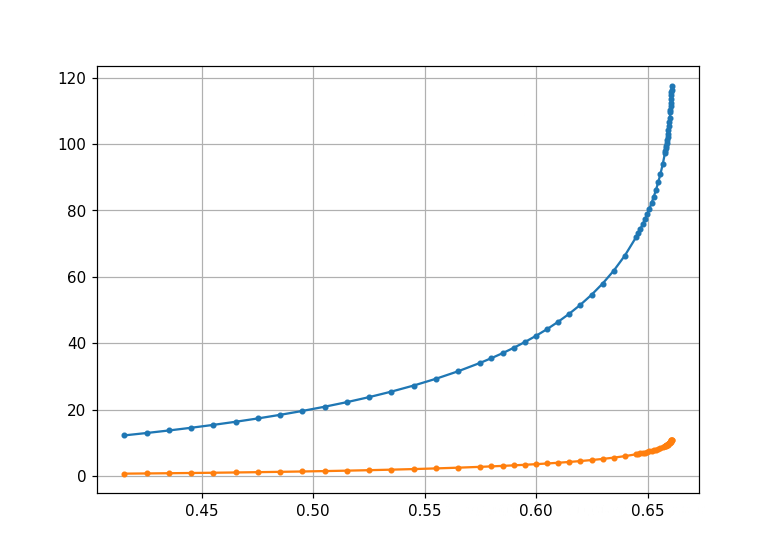

In [230]:
plt.figure()
plt.plot(Vcal_arr, Pressure_arr*(Sqr_arr)**(3/2),'.-')

plt.plot(Vcal_arr, -Sigma_arr*(Sqr_arr),'.-')
#plt.plot(Vcal_arr, Energy_arr/8/np.pi,'.-')

plt.grid()

<IPython.core.display.Javascript object>


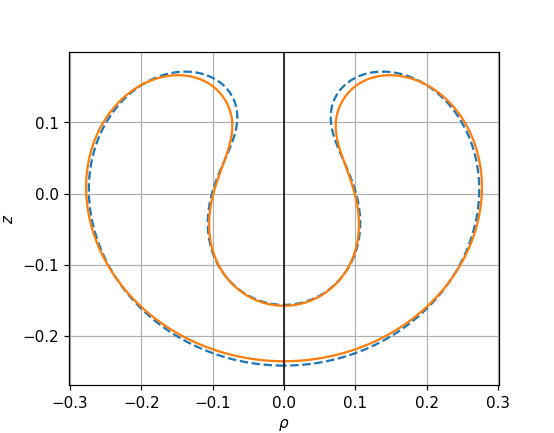

interactive(children=(IntSlider(value=31, description='j', max=63), IntSlider(value=3, description='m', max=6)…

In [372]:
%matplotlib notebook
fig, ax = plt.subplots(figsize=(6,6))
ax.grid()
j=-1
m=3
scale=100

data_path = stoma_data_names[Vcal_index_sort[j]]
data = np.load(data_path, allow_pickle=True).item()

Vcal = data['Vcal']
Sqr = data['Sqr']
Sigma = data['Sigma']
Pressure = data['Pressure']

pz = data['initial']['pz']
P_fur_,Z_fur_ = get_PZ_fur_from_pz(pz)


P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_)
V = np.sqrt(P1**2+Z1**2)
l_rho = -Z1/V;l_z = P1/V;
H, force =get_H_force_from_ar(P_fur_,Z_fur_)

J = data['initial']['J']

w,U = sc.linalg.eig(J[:J.shape[1]])

w *= Sqr**(3/2)
w_m = np.sort(w)[::-1][m]
#index_m = np.argmin(np.abs(w - w_m))
index_m, = np.where(np.isclose(w, w_m))

v_m = U[:, index_m].real.reshape(-1)

v_m /= scale
dN = get_int_field(v_m)
#plt.figure()

P_corr = P+l_rho*dN; Z_corr = Z+l_z*dN
line_0,= plt.plot((1/Sqr)**(1/2)*np.hstack([-P[::-1],P]),(1/Sqr)**(1/2)*np.hstack([Z[::-1],Z]),'--')
line_pert,=plt.plot((1/Sqr)**(1/2)*np.hstack([-P_corr[::-1],P_corr]),(1/Sqr)**(1/2)*np.hstack([Z_corr[::-1],Z_corr]))


plt.axvline(0, color='k', lw=1)


ax.axis('scaled')

#ax.set_title(f'$v={Vcal:.2e}$'+'\n'+f'w={w_m.real:.2e}')
ax.set_xlabel(r'$\rho$')
ax.set_ylabel(r'$z$')


@interact(j=(0,len(stoma_data_names)-1),m=(0,6), scale=(20,1000,40))
def plot_m_pert(j,m,scale):
    data_path = stoma_data_names[Vcal_index_sort[j]]
    data = np.load(data_path, allow_pickle=True).item()
    
    Vcal = data['Vcal']
    Sqr = data['Sqr']
    Sigma = data['Sigma']
    Pressure = data['Pressure']
    
    pz = data['initial']['pz']
    P_fur_,Z_fur_ = get_PZ_fur_from_pz(pz)
    
    
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_)
    V = np.sqrt(P1**2+Z1**2)
    l_rho = -Z1/V;l_z = P1/V;
    H, force =get_H_force_from_ar(P_fur_,Z_fur_)
    
    
    
    J = data['initial']['J']
    
    
    
    
    w,U = sc.linalg.eig(J[:J.shape[1]])
    
    w *= Sqr**(3/2)
    w_m = np.sort(w[abs(w)>1e-4])[::-1][m]
    #index_m = np.argmin(np.abs(w - w_m))
    index_m, = np.where(np.isclose(w, w_m))
    
    v_m = U[:, index_m].real.reshape(-1)
    #plt.figure()
    #plt.plot(v_m, '.--',label=f'w={w_m.real:.2e}')
    #plt.yscale('symlog', linthresh=1e-4)
    #plt.legend(loc='upper right')
    #plt.grid()
    
    v_m /= scale
    dN = get_int_field(v_m)
    dN *= -dN[0]/np.abs(dN[0])
    #plt.figure()
    
    P_corr = P+l_rho*dN; Z_corr = Z+l_z*dN
    #plt.plot((1/Sqr)**(1/2)*np.hstack([-P[::-1],P]),(1/Sqr)**(1/2)*np.hstack([Z[::-1],Z]),'--')
    #plt.plot((1/Sqr)**(1/2)*np.hstack([-P_corr[::-1],P_corr]),(1/Sqr)**(1/2)*np.hstack([Z_corr[::-1],Z_corr]))
    
    
    line_0.set_ydata((1/Sqr)**(1/2)*np.hstack([Z[::-1],Z]));line_0.set_xdata((1/Sqr)**(1/2)*np.hstack([-P[::-1],P]))
    line_pert.set_ydata((1/Sqr)**(1/2)*np.hstack([Z_corr[::-1],Z_corr]));line_pert.set_xdata((1/Sqr)**(1/2)*np.hstack([-P_corr[::-1],P_corr]))
    #ax.set_title( r'$\mathcal{V}=$'+f'{Vcal:.2e}'+'\n'+fr'$\lambda=${w_m.real:.2e}')

## Oblate analysis

In [24]:
def get_PZ_fur_from_pz_sym(pz_sym):
    N_ = len(pz_sym)
    P_fur = np.zeros(N_); Z_fur = np.zeros(N_)
    P_fur[1::2]=pz_sym[::2]
    Z_fur[1::2]=pz_sym[1::2]
    return P_fur, Z_fur


def get_pz_sym_from_PZ_fur(P_fur, Z_fur):
    N_ = len(Z_fur)
    pz_sym = np.zeros(N)
    pz_sym[::2]=P_fur[:N][1::2]
    pz_sym[1::2]=Z_fur[:N][1::2]
    return pz_sym

In [379]:
%%bash
touch oblate_data_names.txt
find . -name 'oblate_equilib_data_Vcal=*.npy' > oblate_data_names.txt

In [380]:
oblate_data_names = np.loadtxt('oblate_data_names.txt', dtype=str)

In [381]:
oblate_data_names = np.loadtxt('oblate_data_names.txt', dtype=str)

Vcal_arr_data = [float(data_path.replace('./oblate_equilib_data_Vcal=','').replace('.npy','')) for data_path in oblate_data_names]

Vcal_index_sort = np.argsort(Vcal_arr_data)
oblate_data_names = oblate_data_names[Vcal_index_sort]

In [355]:
j_c = np.argmin(abs(np.array(Vcal_arr_data)[Vcal_index_sort]-0.51))
j_c

8

In [360]:
data_path = oblate_data_names[9]
data = np.load(data_path, allow_pickle=True).item()
Vcal = data['Vcal']
print(Vcal)
Sqr = data['Sqr']
Sigma = data['Sigma']
Pressure = data['Pressure']
pz = data['initial']['pz']
P_fur_,Z_fur_ = get_PZ_fur_from_pz_sym(pz)
Energy = get_Energy(P_fur_,Z_fur_)
w_slow_all = data['initial']['w'][:9]
h0 = get_int_field(Z_fur_)[0]    
w_sigma = data['initial']['w_sigma'][:4]

0.5109992034287378


<IPython.core.display.Javascript object>


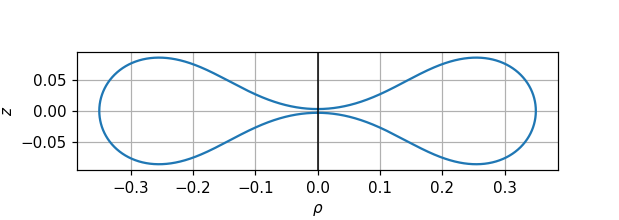

Text(0, 0.5, '$z$')

In [361]:
%matplotlib notebook
fig, ax = plt.subplots(figsize=(6,2))
ax.grid()



P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_)
V = np.sqrt(P1**2+Z1**2)
l_rho = -Z1/V;l_z = P1/V;
H, force =get_H_force_from_ar(P_fur_,Z_fur_)


line_0,= plt.plot((1/Sqr)**(1/2)*np.hstack([-P[::-1],P]),(1/Sqr)**(1/2)*np.hstack([Z[::-1],Z]),'-')


plt.axvline(0, color='k', lw=1)


ax.axis('scaled')

#ax.set_title(fr'$V={Vcal:.2f}$')
ax.set_xlabel(r'$\rho$')
ax.set_ylabel(r'$z$')



In [383]:
Vcal_arr = []
Sqr_arr = []
Energy_arr = []
Pressure_arr = []
Sigma_arr = []

w_slow_all_arr = []
w_sigma_arr = []
h0_arr = []



for data_path in oblate_data_names:
    data = np.load(data_path, allow_pickle=True).item()
    Vcal = data['Vcal']
    Sqr = data['Sqr']
    Sigma = data['Sigma']
    Pressure = data['Pressure']
    pz = data['initial']['pz']
    P_fur_,Z_fur_ = get_PZ_fur_from_pz_sym(pz)
    Energy = get_Energy(P_fur_,Z_fur_)
    w_slow_all = data['initial']['w'][:9]
    h0 = get_int_field(Z_fur_)[0]    
    w_sigma = data['initial']['w_sigma'][:4]

    Sqr_arr.append(Sqr)
    Vcal_arr.append(Vcal)
    Energy_arr.append(Energy)
    Pressure_arr.append(Pressure)
    Sigma_arr.append(Sigma)
    w_slow_all_arr.append(w_slow_all)
    w_sigma_arr.append(w_sigma)
    h0_arr.append(h0)

Vcal_index_sort = np.argsort(Vcal_arr)
Vcal_arr = np.array(Vcal_arr)[Vcal_index_sort]
Sqr_arr = np.array(Sqr_arr)[Vcal_index_sort]
Sigma_arr = np.array(Sigma_arr)[Vcal_index_sort]
Pressure_arr = np.array(Pressure_arr)[Vcal_index_sort]

Energy_arr = np.array(Energy_arr)[Vcal_index_sort]
w_slow_all_arr = np.array(w_slow_all_arr)[Vcal_index_sort]

w_sigma_arr = np.array(w_sigma_arr)[Vcal_index_sort]


<IPython.core.display.Javascript object>


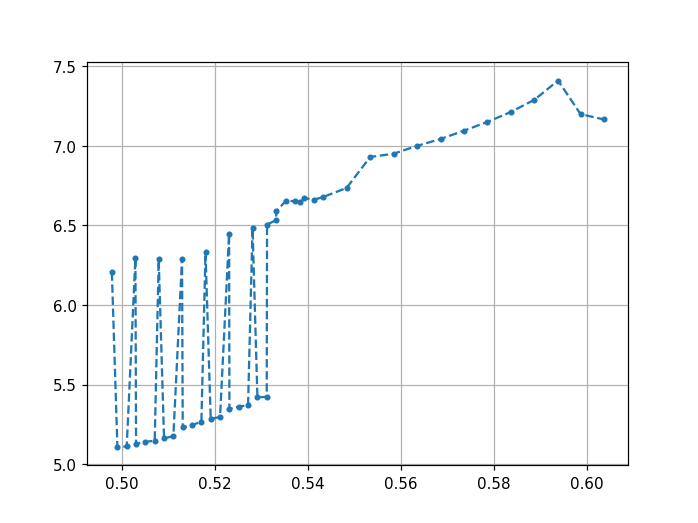

In [279]:
plt.figure()
plt.plot(Vcal_arr, Sqr_arr,'.--')
plt.grid()

In [384]:
w_slow_all_arr_resize = w_slow_all_arr.T*(Sqr_arr**(3/2))

In [385]:
w_sorted=[]
for i in range(w_slow_all_arr_resize.shape[1]):
    w_arr_ = w_slow_all_arr_resize[:,i]
    w_sorted.append(np.sort(w_arr_[abs(w_arr_)>1e-5])[::-1][:4])
w_sorted = np.array(w_sorted)

In [391]:
10/(0.505-0.517)

-833.3333333333326

<IPython.core.display.Javascript object>


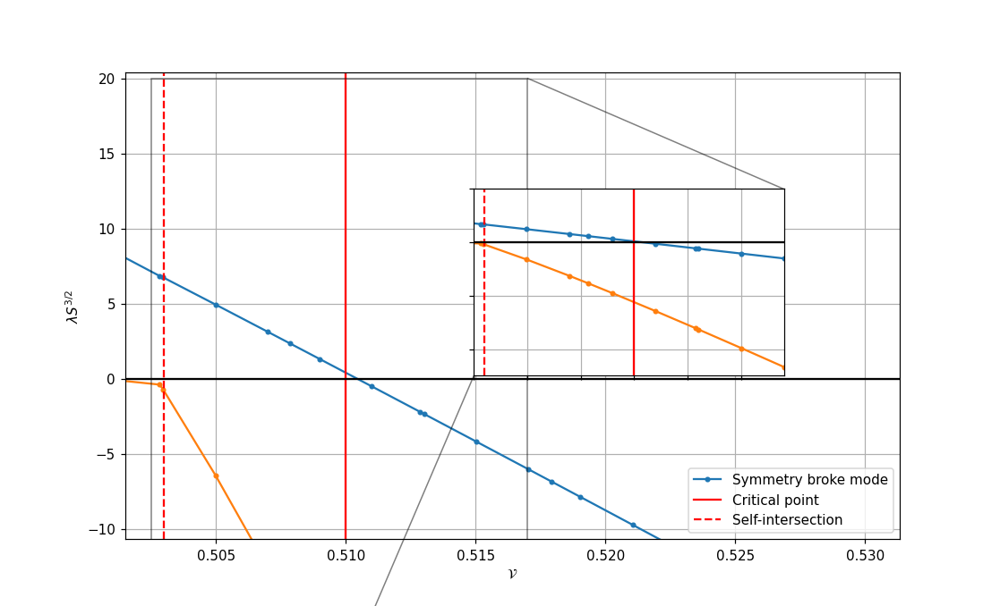

(<matplotlib.patches.Rectangle at 0x7f1d8b162150>,
 (<matplotlib.patches.ConnectionPatch at 0x7f1d8b155090>,
  <matplotlib.patches.ConnectionPatch at 0x7f1d8b188490>))

In [390]:
%matplotlib notebook
plt.figure()
#for i in range(6):
#    plt.plot(Vcal_arr, w_slow_all_arr_resize[i],'.', color='C0')
plt.plot(Vcal_arr,w_sorted[:,0],'.-',label='Symmetry broke mode')
for i in range(1,4):
    plt.plot(Vcal_arr,w_sorted[:,i],'.-')
plt.grid()
#plt.plot(Vcal_arr_sorted, w_unstable_sorted,'.-', color='blue')
#plt.plot(Vcal_arr,np.array(h0_arr)/Sqr_arr**(1/2),'.', color='blue')
plt.axvline(0.51, color='red', label='Critical point')
plt.axhline(0, color='k')

plt.axvline(0.503, color='red', ls='dashed', label='Self-intersection')
plt.xlabel(r'$\mathcal{V}$')
plt.ylabel(r'$\lambda S^{3/2}$')
plt.legend(loc='lower right')



# inset axes....
ax = plt.gca()
x1, x2, y1, y2 = 0.5025, 0.517, -50, 20  # subregion of the original image
axins = ax.inset_axes(
    [0.45, 0.35, 0.4, 0.4],
    xlim=(x1, x2), ylim=(y1, y2), xticklabels=[], yticklabels=[])
axins.plot(Vcal_arr,w_sorted[:,0],'.-')
axins.plot(Vcal_arr,w_sorted[:,1],'.-')
axins.axvline(0.503, color='red', ls='dashed')

axins.axvline(0.51, color='red')
axins.axhline(0, color='k')
axins.grid()
ax.indicate_inset_zoom(axins, edgecolor="black")

#plt.yscale('symlog')

<IPython.core.display.Javascript object>


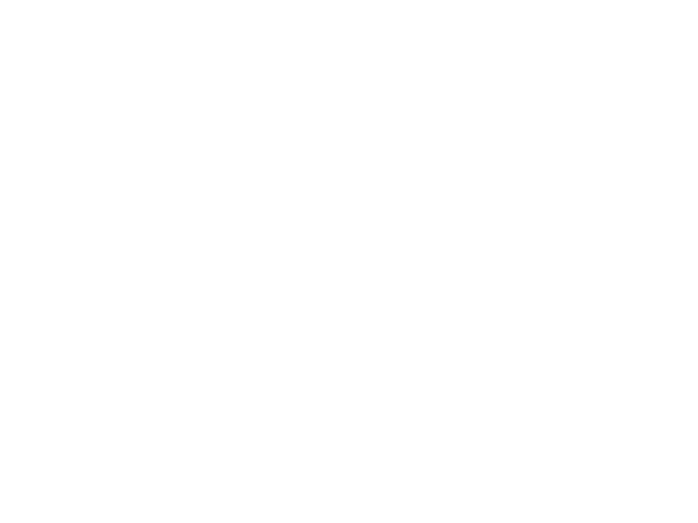

NameError: name 'Vcal_arr_s' is not defined

In [389]:
%matplotlib notebook
plt.figure()
#for i in range(6):
#    plt.plot(Vcal_arr, w_slow_all_arr_resize[i],'.', color='C0')
plt.plot(Vcal_arr_s,w_sorted[:,0],'.-',label='Symmetry broke mode')
for i in range(1,4):
    plt.plot(Vcal_arr_s,w_sorted[:,i],'.-')
plt.grid()
#plt.plot(Vcal_arr_sorted, w_unstable_sorted,'.-', color='blue')
#plt.plot(Vcal_arr,np.array(h0_arr)/Sqr_arr**(1/2),'.', color='blue')
plt.axvline(0.51, color='red', label='Critical point')
plt.axhline(0, color='k')

plt.axvline(0.503, color='red', ls='dashed', label='Self-intersection')
plt.xlabel(r'$\mathcal{V}$')
plt.ylabel(r'$\lambda S^{3/2}$')
plt.legend(loc='lower left')



# inset axes....
ax = plt.gca()
x1, x2, y1, y2 = 0.5025, 0.517, -50, 20  # subregion of the original image
axins = ax.inset_axes(
    [0.45, 0.35, 0.4, 0.4],
    xlim=(x1, x2), ylim=(y1, y2), xticklabels=[], yticklabels=[])
axins.plot(Vcal_arr_s,w_sorted[:,0],'.-')
axins.plot(Vcal_arr_s,w_sorted[:,1],'.-')
axins.axvline(0.503, color='red', ls='dashed')

axins.axvline(0.51, color='red')
axins.axhline(0, color='k')
axins.grid()
ax.indicate_inset_zoom(axins, edgecolor="black")

#plt.yscale('symlog')

<IPython.core.display.Javascript object>


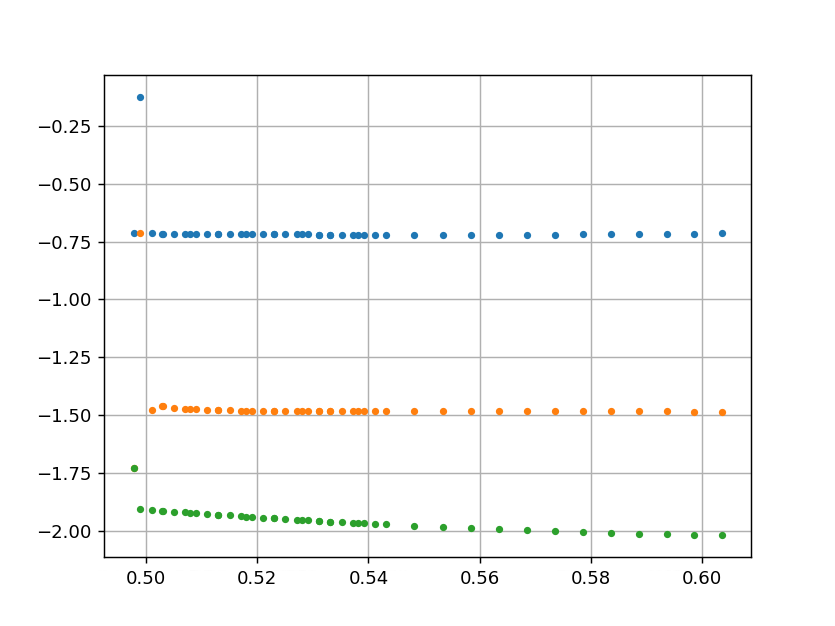

In [217]:
plt.figure()
plt.plot(Vcal_arr, w_sigma_arr*(Sqr_arr)**(+1/2),'.')
plt.plot(Vcal_arr, w_sigma_2_arr*(Sqr_arr)**(+1/2),'.')
plt.plot(Vcal_arr, w_sigma_3_arr*(Sqr_arr)**(+1/2),'.')

#plt.plot(Vcal_arr, w_sigma_2_arr/Sqr_arr,'.')
#plt.plot(Vcal_arr, w_sigma_3_arr/Sqr_arr,'.')

plt.grid()
#plt.yscale('symlog',linthresh=1e-4)

<IPython.core.display.Javascript object>


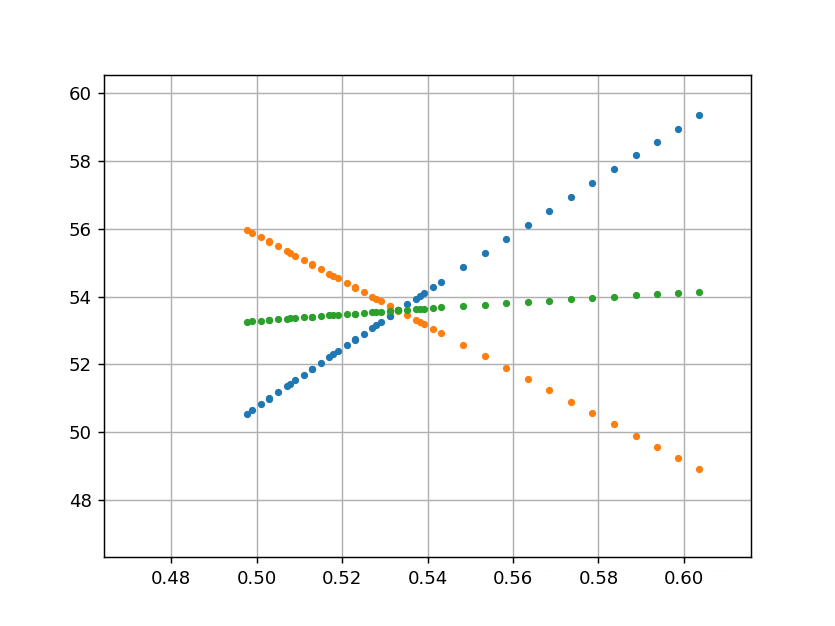

In [232]:
plt.figure()
#plt.plot(Vcal_arr, Pressure_arr*(Sqr_arr)**(3/2),'.')

plt.plot(Vcal_arr, -Sigma_arr*(Sqr_arr),'.')
plt.plot(Vcal_arr, Energy_arr,'.')
plt.plot(Vcal_arr, (Energy_arr-Sigma_arr*(Sqr_arr))/2,'.')

plt.grid()

<IPython.core.display.Javascript object>


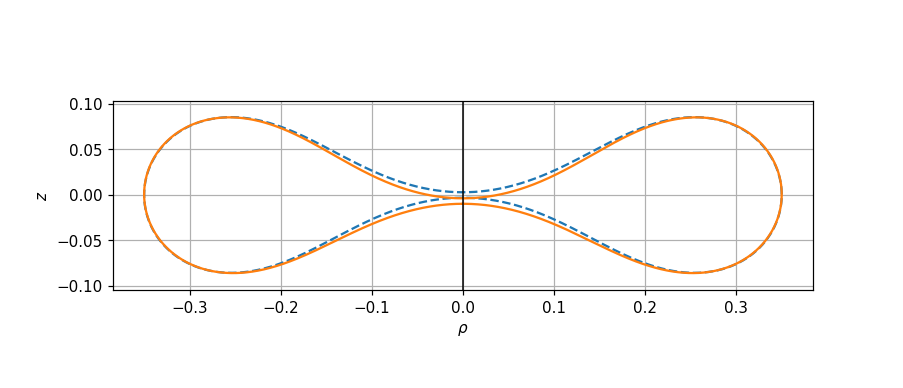

interactive(children=(IntSlider(value=22, description='j', max=44), IntSlider(value=3, description='m', max=6)…

In [398]:
%matplotlib notebook
fig, ax = plt.subplots(figsize=(8,3))
ax.grid()
j=-1
m=3
scale=100

data_path = oblate_data_names[j]
data = np.load(data_path, allow_pickle=True).item()

Vcal = data['Vcal']
Sqr = data['Sqr']
Sigma = data['Sigma']
Pressure = data['Pressure']

pz = data['initial']['pz']
P_fur_,Z_fur_ = get_PZ_fur_from_pz_sym(pz)


P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_)
V = np.sqrt(P1**2+Z1**2)
l_rho = -Z1/V;l_z = P1/V;
H, force =get_H_force_from_ar(P_fur_,Z_fur_)

J = data['initial']['J']

w,U = sc.linalg.eig(J[:J.shape[1]])

w *= Sqr**(3/2)
w_m = np.sort(w)[::-1][m]
#index_m = np.argmin(np.abs(w - w_m))
index_m, = np.where(np.isclose(w, w_m))

v_m = U[:, index_m].real.reshape(-1)

v_m /= scale
dN = get_int_field(v_m)
#plt.figure()

P_corr = P+l_rho*dN; Z_corr = Z+l_z*dN
line_0,= plt.plot((1/Sqr)**(1/2)*np.hstack([-P[::-1],P]),(1/Sqr)**(1/2)*np.hstack([Z[::-1],Z]),'--')
line_pert,=plt.plot((1/Sqr)**(1/2)*np.hstack([-P_corr[::-1],P_corr]),(1/Sqr)**(1/2)*np.hstack([Z_corr[::-1],Z_corr]))


plt.axvline(0, color='k', lw=1)


ax.axis('scaled')

#ax.set_title(f'$v={Vcal:.2e}$'+'\n'+f'w={w_m.real:.2e}')
ax.set_xlabel(r'$\rho$')
ax.set_ylabel(r'$z$')

@interact(j=(0,len(oblate_data_names)-1),m=(0,6), scale=(20,1000,40))
def plot_m_pert(j,m,scale):
    data_path = oblate_data_names[j]
    data = np.load(data_path, allow_pickle=True).item()
    
    Vcal = data['Vcal']
    Sqr = data['Sqr']
    Sigma = data['Sigma']
    Pressure = data['Pressure']
    
    pz = data['initial']['pz']
    P_fur_,Z_fur_ = get_PZ_fur_from_pz_sym(pz)
    
    
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_)
    V = np.sqrt(P1**2+Z1**2)
    l_rho = -Z1/V;l_z = P1/V;
    H, force =get_H_force_from_ar(P_fur_,Z_fur_)
    
    
    
    J = data['initial']['J']
    
    
    
    
    w,U = sc.linalg.eig(J[:J.shape[1]])
    
    w *= Sqr**(3/2)
    w_m = np.sort(w[abs(w)>1e-4])[::-1][m]
    #index_m = np.argmin(np.abs(w - w_m))
    index_m, = np.where(np.isclose(w, w_m))
    
    v_m = U[:, index_m].real.reshape(-1)
    #plt.figure()
    #plt.plot(v_m, '.--',label=f'w={w_m.real:.2e}')
    #plt.yscale('symlog', linthresh=1e-4)
    #plt.legend(loc='upper right')
    #plt.grid()
    
    v_m /= scale
    dN = get_int_field(v_m)
    dN *= -dN[0]/np.abs(dN[0])
    #plt.figure()
    
    P_corr = P+l_rho*dN; Z_corr = Z+l_z*dN
    #plt.plot((1/Sqr)**(1/2)*np.hstack([-P[::-1],P]),(1/Sqr)**(1/2)*np.hstack([Z[::-1],Z]),'--')
    #plt.plot((1/Sqr)**(1/2)*np.hstack([-P_corr[::-1],P_corr]),(1/Sqr)**(1/2)*np.hstack([Z_corr[::-1],Z_corr]))
    
    
    line_0.set_ydata((1/Sqr)**(1/2)*np.hstack([Z[::-1],Z]));line_0.set_xdata((1/Sqr)**(1/2)*np.hstack([-P[::-1],P]))
    line_pert.set_ydata((1/Sqr)**(1/2)*np.hstack([Z_corr[::-1],Z_corr]));line_pert.set_xdata((1/Sqr)**(1/2)*np.hstack([-P_corr[::-1],P_corr]))
    #ax.set_title( r'$\mathcal{V}=$'+f'{Vcal:.2e}'+'\n'+fr'$\lambda=${w_m.real:.2e}')

## Prolate analysis

In [20]:
%%bash
touch prolate_data_names.txt
find . -name 'prolate_equilib_data_Vcal=*.npy' > prolate_data_names.txt

In [22]:
prolate_data_names = np.loadtxt('prolate_data_names.txt', dtype=str)
Vcal_arr_data = [float(data_path.replace('./prolate_equilib_data_Vcal=','').replace('.npy','')) for data_path in prolate_data_names]

Vcal_index_sort = np.argsort(Vcal_arr_data)
prolate_data_names = prolate_data_names[Vcal_index_sort]

NameError: name 'get_div_v_oper_from_arr' is not defined

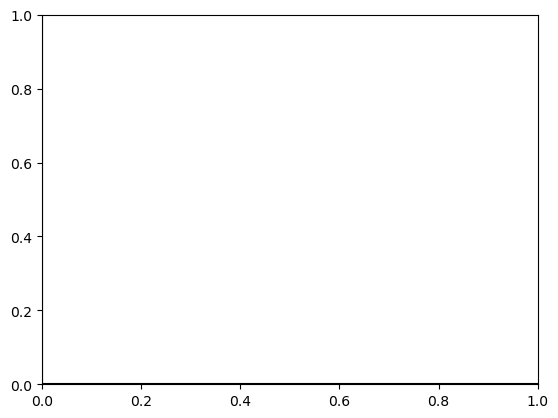

In [35]:
plt.figure()
plt.axhline(0, color='k')
plt.axvline(0, color='k')
for num in [5,10,30,60,100,130]:
    data_path = prolate_data_names[num]
    data = np.load(data_path, allow_pickle=True).item()
    Vcal = data['Vcal']
    Sqr = data['Sqr']
    Vol = data['Vol']
    Sigma = data['Sigma']
    Pressure = data['Pressure']
    pz = data['initial']['pz']
    P_fur_,Z_fur_ = get_PZ_fur_from_pz_sym(pz)
    Energy = get_Energy(P_fur_,Z_fur_)
    #w_slow_all = data['initial']['w']
    J = data['initial']['J']
    w,U = sc.linalg.eig(J[:J.shape[1]])
    #w_slow_all = np.sort(w_slow_all.real)[-50:]
    Div_v_sigma = get_div_v_oper_from_arr(P_fur_, Z_fur_)
    w_sigma,V_sigma = sc.linalg.eig(Div_v_sigma[:60,:60])
    
    h0 = get_int_field(Z_fur_)[0]; R0 = get_int_field(-1j*P_fur_)[N_int//2]
    print(Sigma*R0**2)
    w*=R0**3
    w_sigma*=R0
    print(R0)
    
    w_sigma_index_sort = np.argsort(-w_sigma.real)
    w_sigma_sorted = w_sigma[w_sigma_index_sort]
    V_sigma_sorted = V_sigma[:, w_sigma_index_sort]
    k=0
    dsigma = get_int_field(V_sigma_sorted[:,k])
    plt.plot(dsigma/abs(dsigma).max()*dsigma[N_int//2], label=f'h0/R0={h0/R0:.1e}, w={h0/R0:.1e}')
plt.legend()

In [237]:
def get_root_amount(vfur):
    dv = get_int_field(vfur)
    return (dv[1:]*dv[:-1]<0).sum()

In [263]:
roots_sigma = np.apply_along_axis(get_root_amount,0,V_sigma_sorted)
roots = np.apply_along_axis(get_root_amount,0,U_sorted)

In [264]:
roots_cop = roots.copy()
w_sorted_cop = w_sorted.copy()
L0_over_R0_cop =  h0/R0

<IPython.core.display.Javascript object>


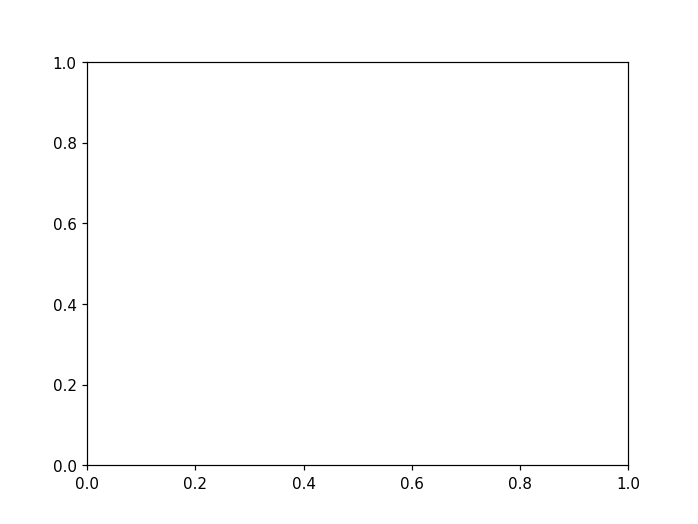

ValueError: x and y must have same first dimension, but have shapes (200,) and (180,)

In [308]:
plt.figure()
plt.plot(roots/(h0/R0),-w_sorted.real,'o-')
plt.plot(roots_cop/L0_over_R0_cop,-w_sorted_cop.real,'o-')

# plt.yscale('log')
plt.grid()

<IPython.core.display.Javascript object>


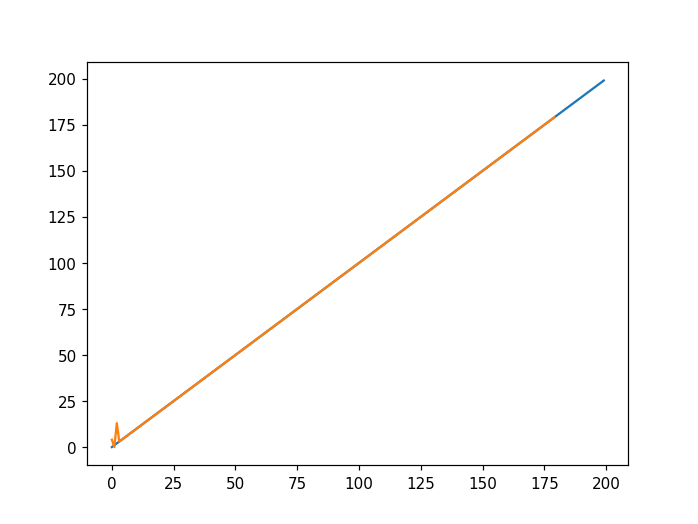

In [240]:
plt.figure()
plt.plot(roots_sigma)
plt.plot(roots)

In [39]:
Vcal_arr = [];Sqr_arr = [];Vol_arr = [];Energy_arr = []
Pressure_arr = [];Sigma_arr = []

w_slow_arr = []
w_sigma_arr = []
h0_arr = []; R0_arr = []




for data_path in tqdm(prolate_data_names):
    data = np.load(data_path, allow_pickle=True).item()
    Vcal = data['Vcal']
    Sqr = data['Sqr']
    Vol = data['Vol']
    Sigma = data['Sigma']
    Pressure = data['Pressure']
    pz = data['initial']['pz']
    P_fur_,Z_fur_ = get_PZ_fur_from_pz_sym(pz)
    Energy = get_Energy(P_fur_,Z_fur_)
    #w_slow_all = data['initial']['w']
    J = data['initial']['J']
    w_slow_all,U = sc.linalg.eig(J[:J.shape[1]])
    w_slow_all = np.sort(w_slow_all.real)[-50:]
    h0 = get_int_field(Z_fur_)[0]; R0 = get_int_field(-1j*P_fur_)[N_int//2]
    
    
    #Div_v_sigma = get_div_v_oper_from_arr(P_fur_, Z_fur_)
    #w_sigma = np.sort(sc.linalg.eigvals(Div_v_sigma[:N_sigma,:N_sigma]).real)[-140:]
    
    
    #w_sigma = data['initial']['w_sigma']

    Vcal_arr.append(Vcal);Sqr_arr.append(Sqr);Vol_arr.append(Vol);Energy_arr.append(Energy)
    Pressure_arr.append(Pressure);Sigma_arr.append(Sigma)
    w_slow_arr.append(w_slow_all);#w_sigma_arr.append(w_sigma)
    h0_arr.append(h0);R0_arr.append(R0)

    
Vcal_arr = np.array(Vcal_arr);Sqr_arr = np.array(Sqr_arr);Vol_arr = np.array(Vol_arr)
h0_arr = np.array(h0_arr);R0_arr = np.array(R0_arr)

Sigma_arr = np.array(Sigma_arr);Pressure_arr = np.array(Pressure_arr)
Energy_arr = np.array(Energy_arr)

w_slow_arr = np.array(w_slow_arr)
w_sigma_arr = np.array(w_sigma_arr)


  0%|          | 0/70 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


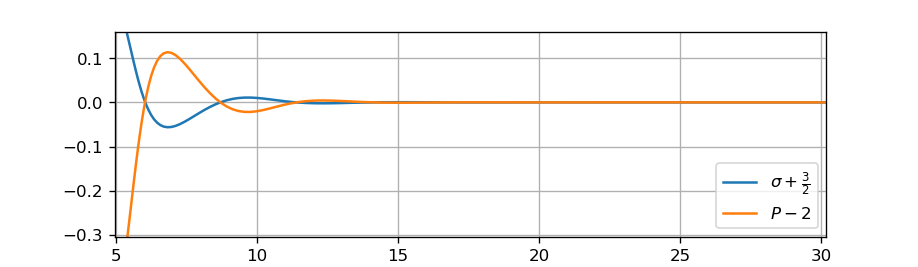

In [127]:
plt.figure()
plt.plot(h0_arr/R0_arr, Sigma_arr*R0_arr**2+3/2,'-', label=r'$\sigma +\frac{3}{2}$')
plt.plot(h0_arr/R0_arr, Pressure_arr*R0_arr**3-2,'-', label=r'$P -2$')
plt.legend()
plt.grid()

<IPython.core.display.Javascript object>


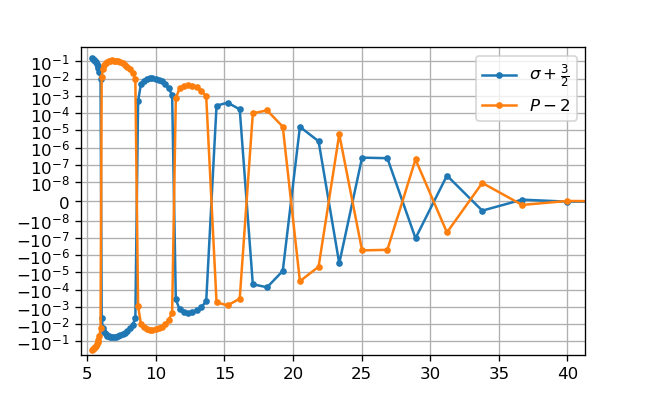

In [131]:
plt.figure()
plt.plot(h0_arr/R0_arr, Sigma_arr*R0_arr**2+3/2,'.-', label=r'$\sigma +\frac{3}{2}$')
plt.plot(h0_arr/R0_arr, Pressure_arr*R0_arr**3-2,'.-', label=r'$P -2$')
plt.legend()
plt.grid()
plt.yscale('symlog', linthresh=1e-8)

In [108]:
w_slow_arr_resize = w_slow_arr.T*R_0_arr**3

w_sorted=[]
for i in range(w_slow_arr_resize.shape[1]):
    w_arr_ = w_slow_arr_resize[:,i]
    w_sorted.append(np.sort(w_arr_[abs(w_arr_)>6e-6])[::-1][:5])
w_sorted = np.array(w_sorted)
w_sigma_arr_resize = w_sigma_arr*R_0_arr.reshape(-1,1)
w_sigma_arr_resize = w_sigma_arr_resize[:,::-1]

In [109]:
w_slow_arr_resize = w_slow_arr.T*R_0_arr**3

w_sorted=[]
for i in range(w_slow_arr_resize.shape[1]):
    w_arr_ = w_slow_arr_resize[:,i]
    w_sorted.append(np.sort(w_arr_[::-1]))
w_sorted = np.array(w_sorted)[:,::-1]

<IPython.core.display.Javascript object>


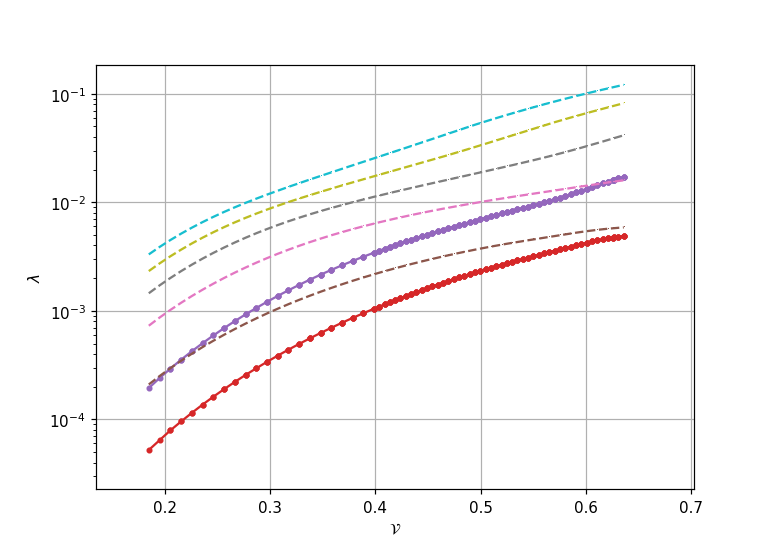

In [53]:
%matplotlib notebook
plt.figure()
#for i in range(6):
#    plt.plot(Vcal_arr, w_slow_all_arr_resize[i],'.', color='C0')
plt.plot(Vcal_arr,-w_sorted[:,0],'.-',label='Slowest mode')
for i in range(1,5):
    plt.plot(Vcal_arr,-w_sorted[:,i],'.-')
plt.grid()


for i in range(5):
    plt.plot(Vcal_arr,-w_sigma_arr_resize[:,i],',--')

#plt.plot(Vcal_arr_sorted, w_unstable_sorted,'.-', color='blue')
#plt.plot(Vcal_arr,np.array(h0_arr)/Sqr_arr**(1/2),'.', color='blue')
#plt.axvline(0.51, color='red', label='Critical point')
plt.axhline(0, color='k')
plt.axvline(0, color='k')

#plt.axvline(0.503, color='red', ls='dashed', label='Self-intersection')
plt.xlabel(r'$\mathcal{V}$')
plt.ylabel(r'$\lambda$')
#plt.legend(loc='left')


plt.yscale('log')
#plt.yscale('symlog')

<IPython.core.display.Javascript object>


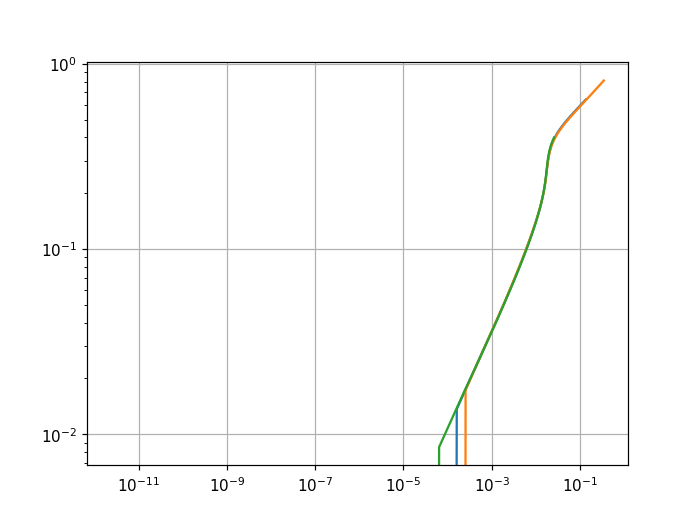

<IPython.core.display.Javascript object>


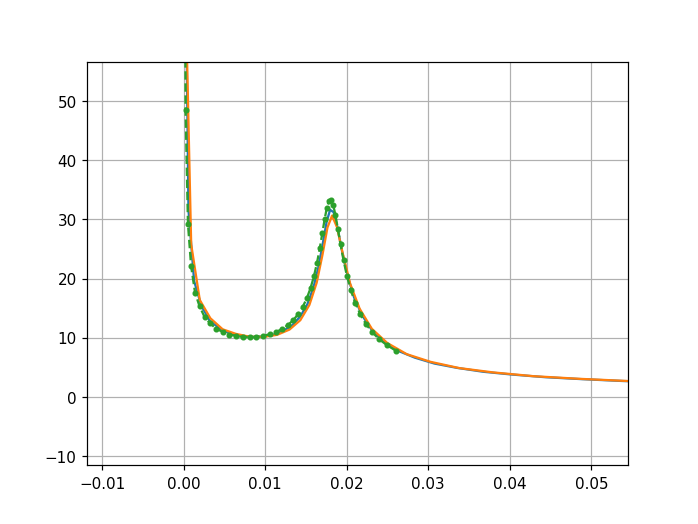

In [54]:
w_arr_ = -w_sorted[10,:][2:]

N_arr_ = np.arange(len(w_arr_))
plt.figure()
plt.plot(w_arr_, N_arr_/(h0_arr[10]/R_0_arr[10]))


w_arr_ = -w_sorted[20,:][2:]

N_arr_ = np.arange(len(w_arr_))

plt.plot(w_arr_, N_arr_/(h0_arr[20]/R_0_arr[20]))



w_arr_ = -w_sorted[1,:][2:]

N_arr_ = np.arange(len(w_arr_))
plt.plot(w_arr_, N_arr_/(h0_arr[1]/R_0_arr[1]))
plt.yscale('log')
plt.xscale('log')
plt.grid()


w_arr_ = -w_sorted[10,:][2:]

N_arr_ = np.arange(len(w_arr_))


plt.figure()
plt.plot(w_arr_[1:], 1/(h0_arr[10]/R_0_arr[10])/(w_arr_[1:]-w_arr_[:-1]))


w_arr_ = -w_sorted[20,:][2:]

N_arr_ = np.arange(len(w_arr_))

plt.plot(w_arr_[1:], 1/(h0_arr[20]/R_0_arr[20])/(w_arr_[1:]-w_arr_[:-1]))


w_arr_ = -w_sorted[1,:][2:]

N_arr_ = np.arange(len(w_arr_))

plt.plot(w_arr_[1:], 1/(h0_arr[1]/R_0_arr[1])/(w_arr_[1:]-w_arr_[:-1]),'.--')
#plt.plot(np.logspace(-2,0,100), 1e-1*np.logspace(-2,0,100)**(-3/4))
#plt.plot(np.logspace(-5,0,100), 7e-1*np.logspace(-5,0,100)**(-1/2))

plt.grid()
#plt.yscale('log')
#plt.xscale('log')

<IPython.core.display.Javascript object>


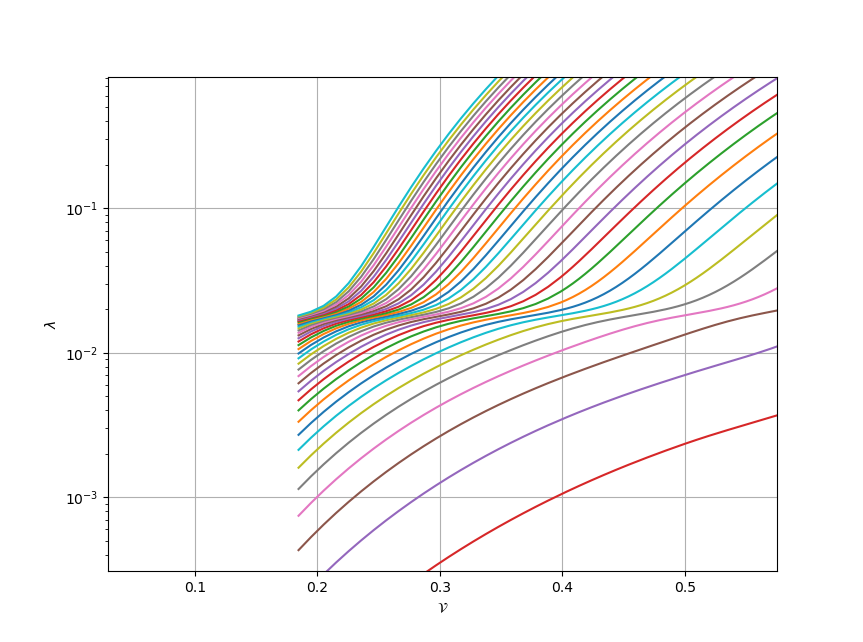

In [222]:
%matplotlib notebook
plt.figure()
#for i in range(6):
#    plt.plot(Vcal_arr, w_slow_all_arr_resize[i],'.', color='C0')
plt.plot(Vcal_arr,-w_sorted[:,0],'.-',label='Slowest mode')
for i in range(1,40):
    plt.plot(Vcal_arr,-w_sorted[:,i],'-')
plt.grid()


#for i in range(5):
#    plt.plot(Vcal_arr,-w_sigma_arr_resize[:,i],',--')

#plt.plot(Vcal_arr_sorted, w_unstable_sorted,'.-', color='blue')
#plt.plot(Vcal_arr,np.array(h0_arr)/Sqr_arr**(1/2),'.', color='blue')
#plt.axvline(0.51, color='red', label='Critical point')
plt.axhline(0, color='k')
plt.axvline(0, color='k')

#plt.axvline(0.503, color='red', ls='dashed', label='Self-intersection')
plt.xlabel(r'$\mathcal{V}$')
plt.ylabel(r'$\lambda$')
#plt.legend(loc='left')


plt.yscale('log')
#plt.yscale('symlog')

<IPython.core.display.Javascript object>


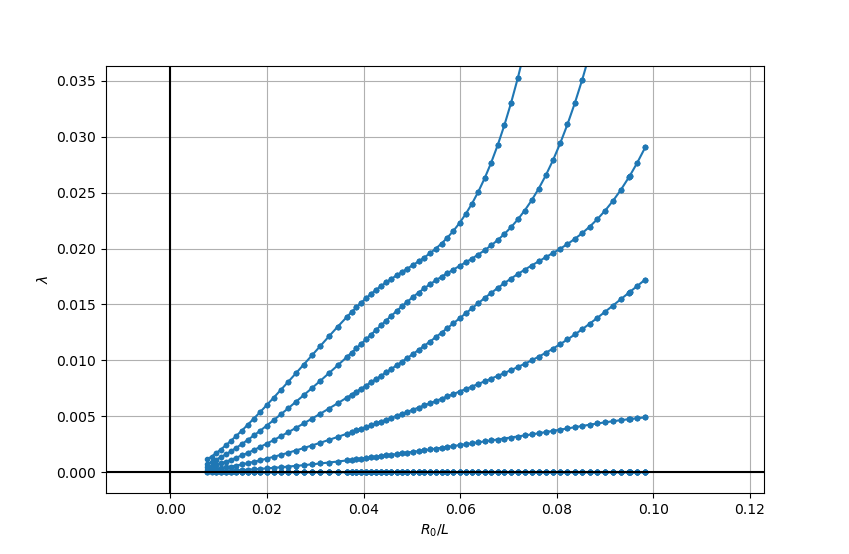

Text(0, 0.5, '$\\lambda$')

In [199]:
%matplotlib notebook
plt.figure()
#for i in range(6):
#    plt.plot(Vcal_arr, w_slow_all_arr_resize[i],'.', color='C0')
plt.plot(R_0_arr/h0_arr,-w_sorted[:,0],'.-',label='Slowest mode', color='C0')
for i in range(1,8):
    plt.plot(R_0_arr/h0_arr,-w_sorted[:,i],'.-', color='C0')
plt.grid()


#for i in range(5):
#    plt.plot(R_0_arr/h0_arr,-w_sigma_arr_resize[:,i],'.--', color='C1')

#plt.plot(Vcal_arr_sorted, w_unstable_sorted,'.-', color='blue')
#plt.plot(Vcal_arr,np.array(h0_arr)/Sqr_arr**(1/2),'.', color='blue')
#plt.axvline(0.51, color='red', label='Critical point')
plt.axhline(0, color='k')
plt.axvline(0, color='k')

#plt.axvline(0.503, color='red', ls='dashed', label='Self-intersection')
plt.xlabel(r'$R_0/L$')
plt.ylabel(r'$\lambda$')
#plt.legend(loc='left')


#plt.yscale('log')
#plt.yscale('symlog')

<IPython.core.display.Javascript object>


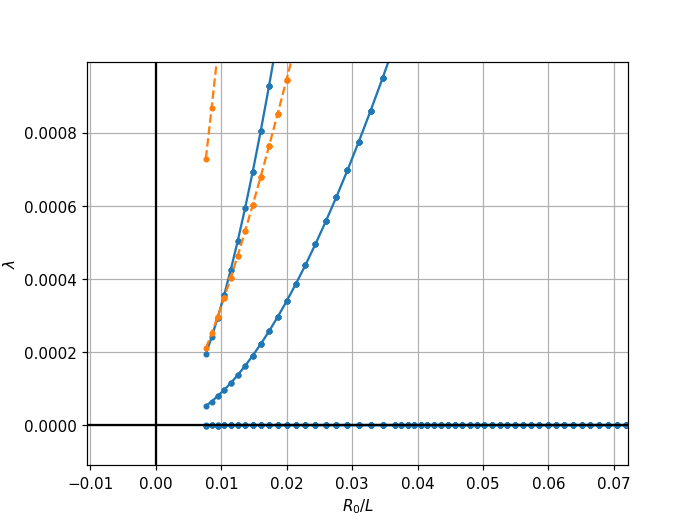

Text(0, 0.5, '$\\lambda$')

In [55]:
%matplotlib notebook
plt.figure()
#for i in range(6):
#    plt.plot(Vcal_arr, w_slow_all_arr_resize[i],'.', color='C0')
plt.plot(R_0_arr/h0_arr,-w_sorted[:,0],'.-',label='Slowest mode', color='C0')
for i in range(1,5):
    plt.plot(R_0_arr/h0_arr,-w_sorted[:,i],'.-', color='C0')
plt.grid()


for i in range(5):
    plt.plot(R_0_arr/h0_arr,-w_sigma_arr_resize[:,i],'.--', color='C1')

#plt.plot(Vcal_arr_sorted, w_unstable_sorted,'.-', color='blue')
#plt.plot(Vcal_arr,np.array(h0_arr)/Sqr_arr**(1/2),'.', color='blue')
#plt.axvline(0.51, color='red', label='Critical point')
plt.axhline(0, color='k')
plt.axvline(0, color='k')

#plt.axvline(0.503, color='red', ls='dashed', label='Self-intersection')
plt.xlabel(r'$R_0/L$')
plt.ylabel(r'$\lambda$')
#plt.legend(loc='left')


#plt.yscale('log')
#plt.yscale('symlog')

<IPython.core.display.Javascript object>


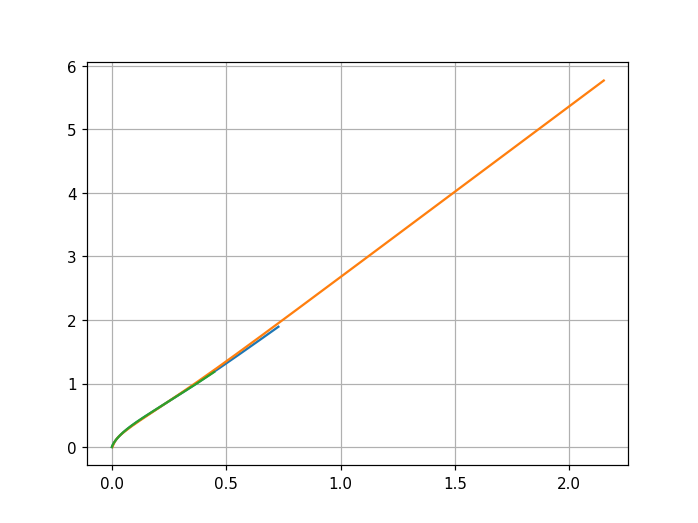

<IPython.core.display.Javascript object>


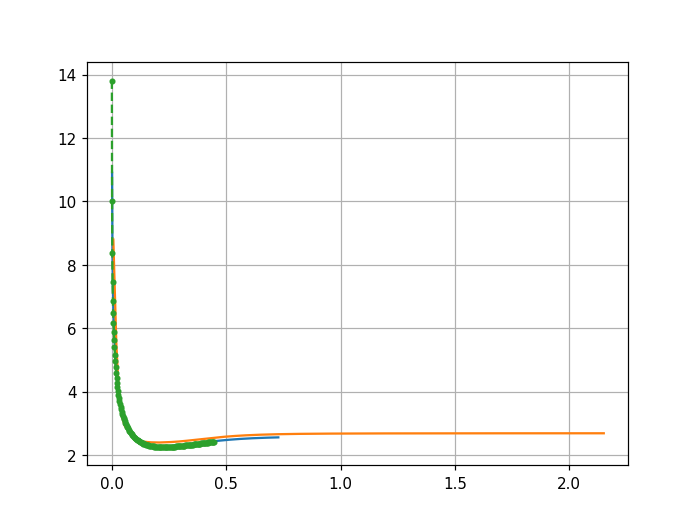

In [110]:
w_arr_ = -w_sigma_arr_resize[10,:]

N_arr_ = np.arange(len(w_arr_))
plt.figure()
plt.plot(w_arr_, N_arr_/(h0_arr[10]/R_0_arr[10]))


w_arr_ = -w_sigma_arr_resize[80,:]

N_arr_ = np.arange(len(w_arr_))

plt.plot(w_arr_, N_arr_/(h0_arr[80]/R_0_arr[80]))



w_arr_ = -w_sigma_arr_resize[1,:]

N_arr_ = np.arange(len(w_arr_))
plt.plot(w_arr_, N_arr_/(h0_arr[1]/R_0_arr[1]))
# plt.yscale('log')
# plt.xscale('log')
plt.grid()


w_arr_ = -w_sigma_arr_resize[10,:]

N_arr_ = np.arange(len(w_arr_))


plt.figure()
plt.plot(w_arr_[1:], 1/(h0_arr[10]/R_0_arr[10])/(w_arr_[1:]-w_arr_[:-1]))


w_arr_ = -w_sigma_arr_resize[80,:]

N_arr_ = np.arange(len(w_arr_))

plt.plot(w_arr_[1:], 1/(h0_arr[80]/R_0_arr[80])/(w_arr_[1:]-w_arr_[:-1]))


w_arr_ = -w_sigma_arr_resize[1,:]

N_arr_ = np.arange(len(w_arr_))

plt.plot(w_arr_[1:], 1/(h0_arr[1]/R_0_arr[1])/(w_arr_[1:]-w_arr_[:-1]),'.--')
#plt.plot(np.logspace(-2,0,100), 1e-1*np.logspace(-2,0,100)**(-3/4))
#plt.plot(np.logspace(-5,0,100), 7e-1*np.logspace(-5,0,100)**(-1/2))

plt.grid()
#plt.yscale('log')
#plt.xscale('log')

<IPython.core.display.Javascript object>


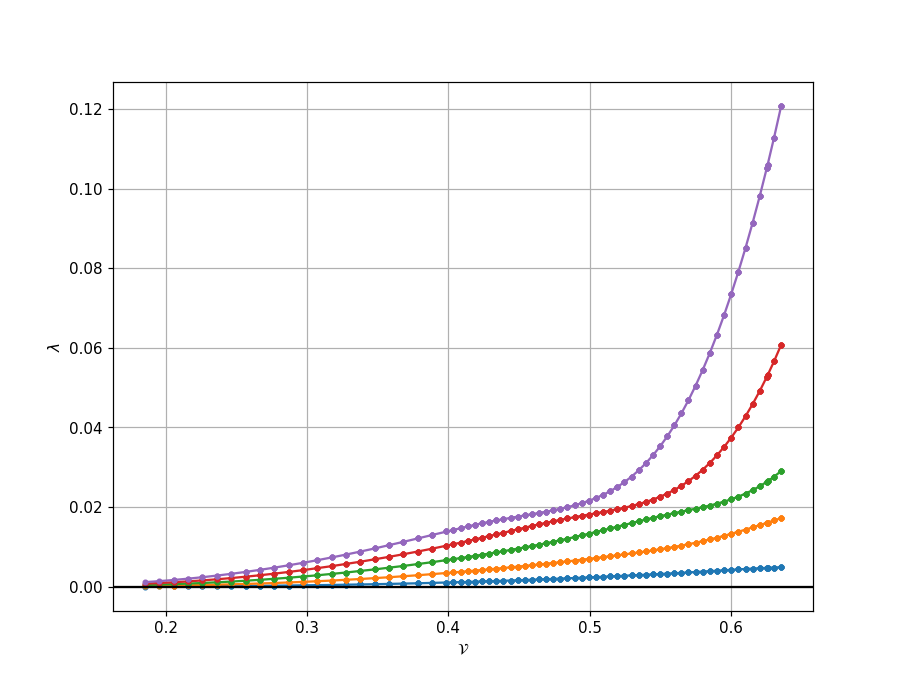

Text(0, 0.5, '$\\lambda$')

In [128]:
%matplotlib notebook
plt.figure()
#for i in range(6):
#    plt.plot(Vcal_arr, w_slow_all_arr_resize[i],'.', color='C0')
plt.plot(Vcal_arr,-w_sorted[:,0],'.-',label='Slowest mode')
for i in range(1,5):
    plt.plot(Vcal_arr,-w_sorted[:,i],'.-')
plt.grid()
#plt.plot(Vcal_arr_sorted, w_unstable_sorted,'.-', color='blue')
#plt.plot(Vcal_arr,np.array(h0_arr)/Sqr_arr**(1/2),'.', color='blue')
#plt.axvline(0.51, color='red', label='Critical point')
plt.axhline(0, color='k')

#plt.axvline(0.503, color='red', ls='dashed', label='Self-intersection')
plt.xlabel(r'$\mathcal{V}$')
plt.ylabel(r'$\lambda$')
#plt.legend(loc='left')



#plt.yscale('symlog')

<IPython.core.display.Javascript object>


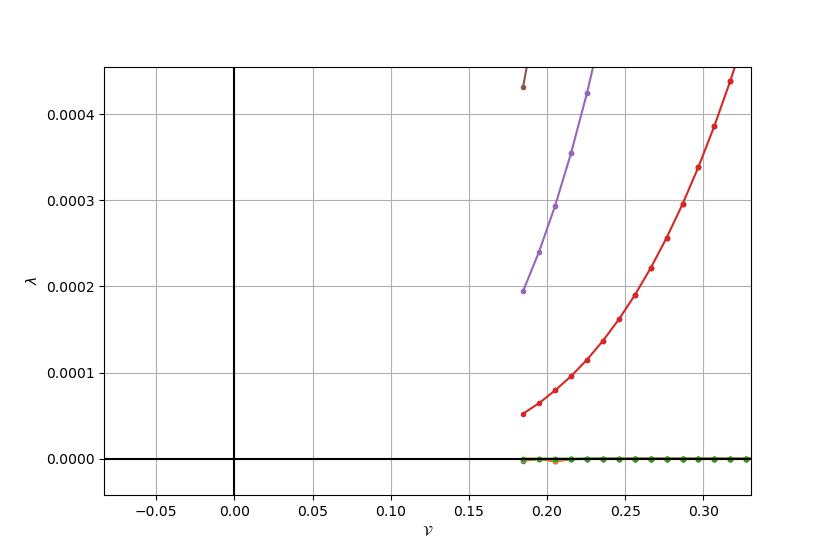

Text(0, 0.5, '$\\lambda$')

In [186]:
%matplotlib notebook
plt.figure()
#for i in range(6):
#    plt.plot(Vcal_arr, w_slow_all_arr_resize[i],'.', color='C0')
plt.plot(Vcal_arr,-w_sorted[:,0],'.-',label='Slowest mode')
for i in range(1,8):
    plt.plot(Vcal_arr,-w_sorted[:,i],'.-')
plt.grid()


#for i in range(5):
#    plt.plot(Vcal_arr,-w_sigma_arr_resize[:,i],',--')

#plt.plot(Vcal_arr_sorted, w_unstable_sorted,'.-', color='blue')
#plt.plot(Vcal_arr,np.array(h0_arr)/Sqr_arr**(1/2),'.', color='blue')
#plt.axvline(0.51, color='red', label='Critical point')
plt.axhline(0, color='k')
plt.axvline(0, color='k')

#plt.axvline(0.503, color='red', ls='dashed', label='Self-intersection')
plt.xlabel(r'$\mathcal{V}$')
plt.ylabel(r'$\lambda$')
#plt.legend(loc='left')


#plt.yscale('log')
#plt.yscale('symlog')

<IPython.core.display.Javascript object>


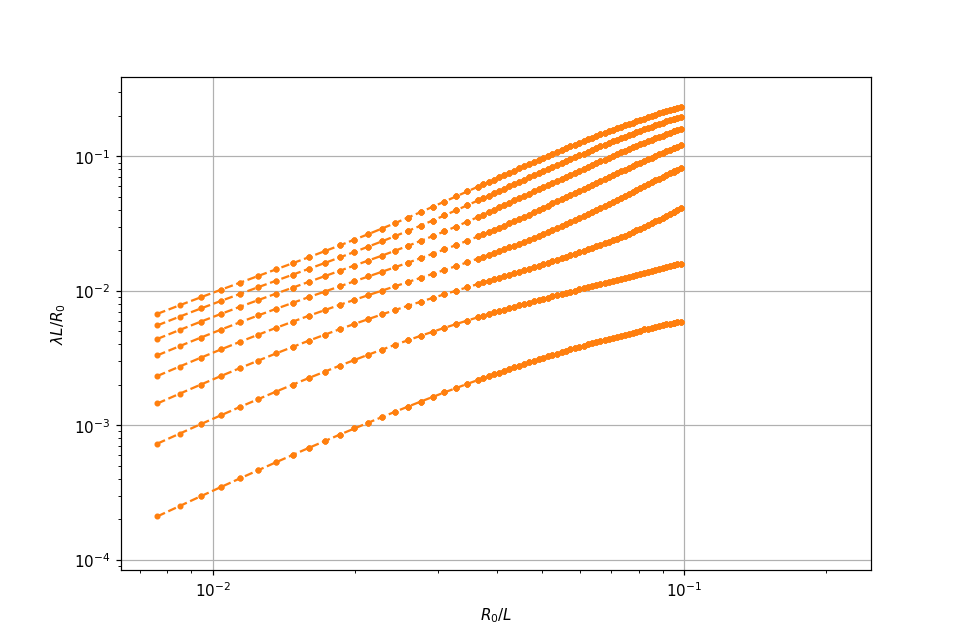

In [167]:
%matplotlib notebook
plt.figure()
#for i in range(6):
#    plt.plot(Vcal_arr, w_slow_all_arr_resize[i],'.', color='C0')
#plt.plot(R_0_arr/h0_arr,-w_sorted[:,0]/(R_0_arr/h0_arr)**3,'.-',label='Slowest mode', color='C0')
#for i in range(1,5):
#    plt.plot(R_0_arr/h0_arr,-w_sorted[:,i]/(R_0_arr/h0_arr)**3,'.-', color='C0')
plt.grid()


for i in range(8):
    plt.plot(R_0_arr/h0_arr,-w_sigma_arr_resize[:,i],'.--', color='C1')

#plt.plot(Vcal_arr_sorted, w_unstable_sorted,'.-', color='blue')
#plt.plot(Vcal_arr,np.array(h0_arr)/Sqr_arr**(1/2),'.', color='blue')
#plt.axvline(0.51, color='red', label='Critical point')
plt.axhline(0, color='k')
plt.axvline(0, color='k')

#plt.axvline(0.503, color='red', ls='dashed', label='Self-intersection')
plt.xlabel(r'$R_0/L$')
plt.ylabel(r'$\lambda L/R_0$')
#plt.legend(loc='left')

plt.xscale('log')
plt.yscale('log')
#plt.yscale('symlog')

<IPython.core.display.Javascript object>


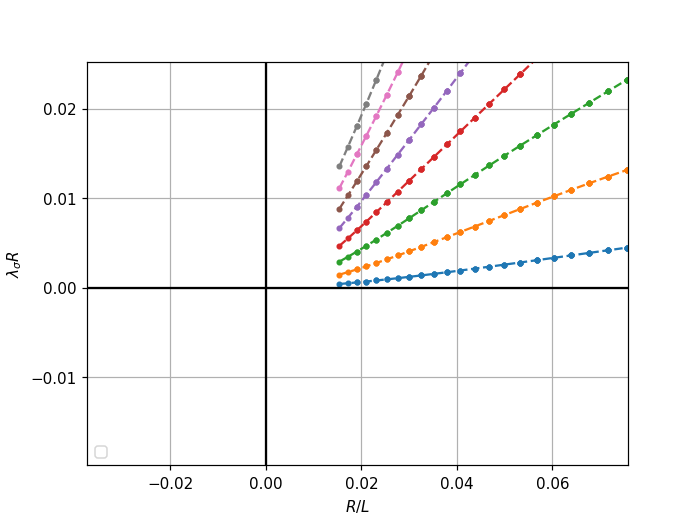

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


In [104]:
plt.figure()
#for i in range(6):
#    plt.plot(Vcal_arr, w_slow_all_arr_resize[i],'.', color='C0')
for i in range(8):
    plt.plot(r_arr/h0_arr,-w_sigma_arr[:,i]*r_arr,'.--')
plt.grid()
#plt.plot(Vcal_arr_sorted, w_unstable_sorted,'.-', color='blue')
#plt.plot(Vcal_arr,np.array(h0_arr)/Sqr_arr**(1/2),'.', color='blue')
plt.axhline(0, color='k')
plt.axvline(0, color='k')

#plt.axvline(0.503, color='red', ls='dashed', label='Self-intersection')
plt.xlabel(r'$R/L$')
plt.ylabel(r'$\lambda_\sigma R $')
plt.legend(loc='lower left')
#plt.yscale('log')

<IPython.core.display.Javascript object>


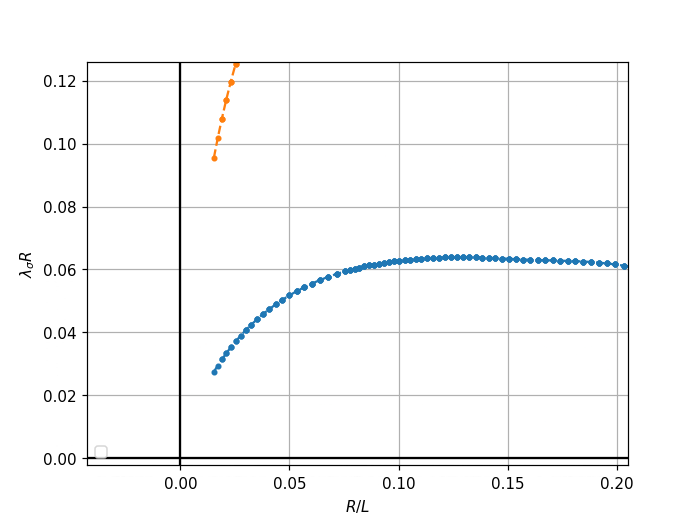

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


In [105]:
plt.figure()
#for i in range(6):
#    plt.plot(Vcal_arr, w_slow_all_arr_resize[i],'.', color='C0')
for i in range(8):
    plt.plot(r_arr/h0_arr,-w_sigma_arr[:,i]*r_arr/(r_arr/h0_arr),'.--')
plt.grid()
#plt.plot(Vcal_arr_sorted, w_unstable_sorted,'.-', color='blue')
#plt.plot(Vcal_arr,np.array(h0_arr)/Sqr_arr**(1/2),'.', color='blue')
plt.axhline(0, color='k')
plt.axvline(0, color='k')

#plt.axvline(0.503, color='red', ls='dashed', label='Self-intersection')
plt.xlabel(r'$R/L$')
plt.ylabel(r'$\lambda_\sigma R $')
plt.legend(loc='lower left')
#plt.yscale('log')

In [106]:
w_slow_all_arr_resize = w_slow_all_arr.T*(r_arr**(3))

w_sorted=[]
for i in range(w_slow_all_arr_resize.shape[1]):
    w_arr_ = w_slow_all_arr_resize[:,i]
    w_sorted.append(np.sort(w_arr_[abs(w_arr_)>1e-4])[::-1][:10])
w_sorted = np.array(w_sorted)

<IPython.core.display.Javascript object>


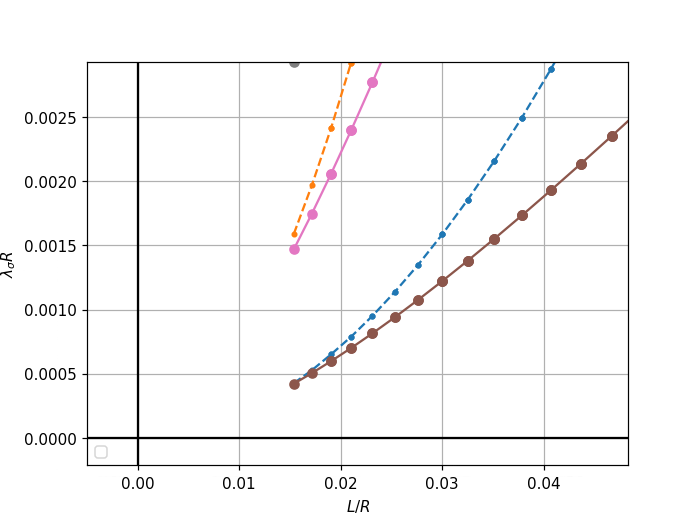

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


In [107]:
plt.figure()
#for i in range(6):
#    plt.plot(Vcal_arr, w_slow_all_arr_resize[i],'.', color='C0')
for i in range(5):
    plt.plot(r_arr/h0_arr,-w_sorted[:,i],'.--')
plt.grid()

for i in range(8):
    plt.plot(r_arr/h0_arr,-w_sigma_arr[:,i]*r_arr,'o-')
#plt.plot(Vcal_arr_sorted, w_unstable_sorted,'.-', color='blue')
#plt.plot(Vcal_arr,np.array(h0_arr)/Sqr_arr**(1/2),'.', color='blue')
plt.axhline(0, color='k')
plt.axvline(0, color='k')

#plt.axvline(0.503, color='red', ls='dashed', label='Self-intersection')
plt.xlabel(r'$L/R$')
plt.ylabel(r'$\lambda_\sigma R $')
plt.legend(loc='lower left')
#plt.yscale('log')

<IPython.core.display.Javascript object>


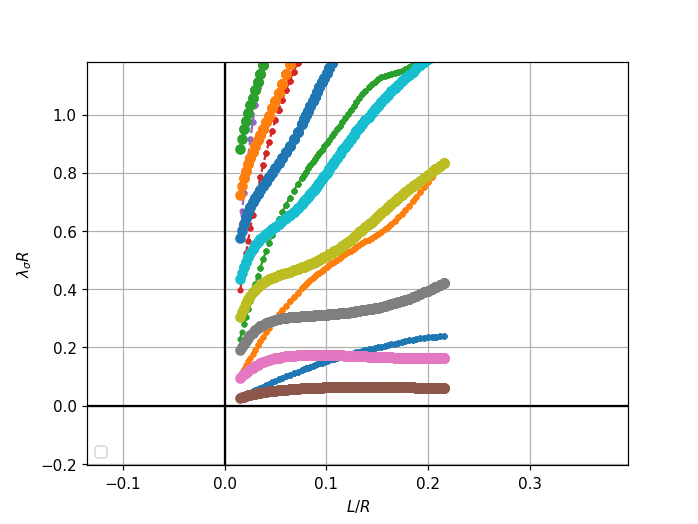

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


In [108]:
plt.figure()
#for i in range(6):
#    plt.plot(Vcal_arr, w_slow_all_arr_resize[i],'.', color='C0')
for i in range(5):
    plt.plot(r_arr/h0_arr,-w_sorted[:,i]/(r_arr/h0_arr),'.--')
plt.grid()

for i in range(8):
    plt.plot(r_arr/h0_arr,-w_sigma_arr[:,i]*r_arr/(r_arr/h0_arr),'o-')
#plt.plot(Vcal_arr_sorted, w_unstable_sorted,'.-', color='blue')
#plt.plot(Vcal_arr,np.array(h0_arr)/Sqr_arr**(1/2),'.', color='blue')
plt.axhline(0, color='k')
plt.axvline(0, color='k')

#plt.axvline(0.503, color='red', ls='dashed', label='Self-intersection')
plt.xlabel(r'$L/R$')
plt.ylabel(r'$\lambda_\sigma R $')
plt.legend(loc='lower left')
#plt.yscale('log')

<IPython.core.display.Javascript object>


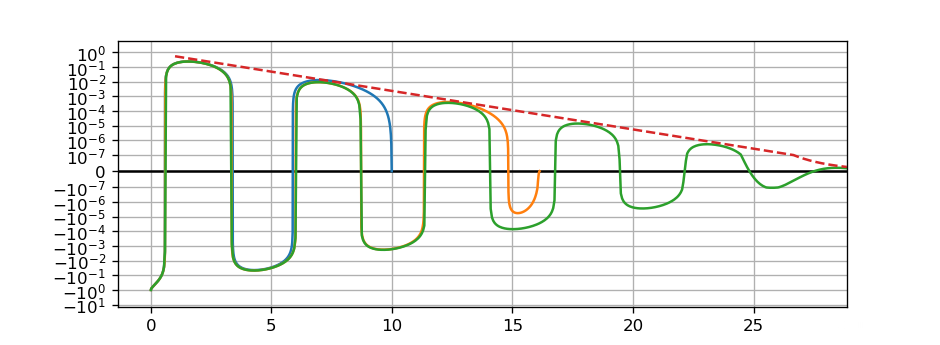

interactive(children=(IntSlider(value=34, description='j', max=69), Button(description='Run Interact', style=B…

In [119]:
%matplotlib notebook
plt.figure()
plt.xlim(0,20)
plt.grid()
plt.yscale('symlog', linthresh=1e-7)
plt.axhline(0, color='k')
@interact_manual(j=(0,len(prolate_data_names)-1))
def plot_state_j(j):
    data_path = prolate_data_names[Vcal_index_sort[j]]
    data = np.load(data_path, allow_pickle=True).item()
    

    
    pz = data['initial']['pz']
    P_fur_,Z_fur_ = get_PZ_fur_from_pz_sym(pz)
    
    
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_)
    R0 = P[N_int//2]
    P/= R0
    Z/=R0
    h_0 = Z[0]
    V = np.sqrt(P1**2+Z1**2)
    l_rho = -Z1/V;l_z = P1/V;
    H, force =get_H_force_from_ar(P_fur_,Z_fur_)
    
    
    #plt.plot((1/Sqr)**(1/2)*np.hstack([-P[::-1],P]),(1/Sqr)**(1/2)*np.hstack([Z[::-1],Z]),'--')
    #plt.plot((1/Sqr)**(1/2)*np.hstack([-P_corr[::-1],P_corr]),(1/Sqr)**(1/2)*np.hstack([Z_corr[::-1],Z_corr]))
    
    
    plt.plot(Z[N_int//2:]+h_0, P[N_int//2:]-1)
    
    #plt.ylim(-2,1)


<IPython.core.display.Javascript object>


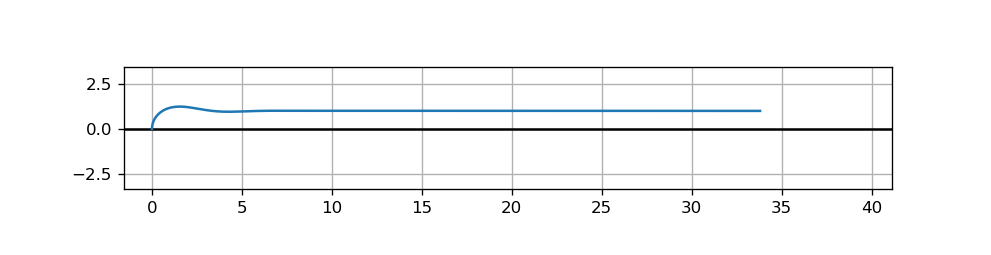

interactive(children=(IntSlider(value=34, description='j', max=69), Button(description='Run Interact', style=B…

In [136]:
%matplotlib notebook
plt.figure()
plt.xlim(0,20)
plt.grid()
#plt.yscale('symlog', linthresh=1e-7)
plt.axhline(0, color='k')
@interact_manual(j=(0,len(prolate_data_names)-1))
def plot_state_j(j):
    data_path = prolate_data_names[Vcal_index_sort[j]]
    data = np.load(data_path, allow_pickle=True).item()
    

    
    pz = data['initial']['pz']
    P_fur_,Z_fur_ = get_PZ_fur_from_pz_sym(pz)
    
    
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_)
    R0 = P[N_int//2]
    P/= R0
    Z/=R0
    h_0 = Z[0]
    V = np.sqrt(P1**2+Z1**2)
    l_rho = -Z1/V;l_z = P1/V;
    H, force =get_H_force_from_ar(P_fur_,Z_fur_)
    
    
    #plt.plot((1/Sqr)**(1/2)*np.hstack([-P[::-1],P]),(1/Sqr)**(1/2)*np.hstack([Z[::-1],Z]),'--')
    #plt.plot((1/Sqr)**(1/2)*np.hstack([-P_corr[::-1],P_corr]),(1/Sqr)**(1/2)*np.hstack([Z_corr[::-1],Z_corr]))
    
    
    plt.plot(Z[N_int//2:]+h_0, P[N_int//2:])
    
    #plt.ylim(-2,1)
    plt.axis('scaled')

In [120]:
z_plt = np.linspace(1, 60, 4000)
kappa = np.sqrt((np.sqrt(3)-1)/2)
k_osc = np.sqrt((np.sqrt(3)+1)/2)
exp_envelope = np.exp(-kappa*z_plt)
z_star=22.14 
phi_0 = -(k_osc*z_star) % (2*np.pi)

In [121]:
plt.plot(z_plt,exp_envelope,'--')

In [115]:
osc_part = np.sin(z_plt*k_osc+phi_0)

In [116]:
plt.plot(z_plt, osc_part*exp_envelope,'-', lw=0.8, color='blue')

In [117]:
phi_0 = - np.pi/4
osc_part = np.sin(z_plt*k_osc+phi_0)
plt.plot(z_plt, osc_part*exp_envelope,'--', lw=0.8, color='red')

<IPython.core.display.Javascript object>


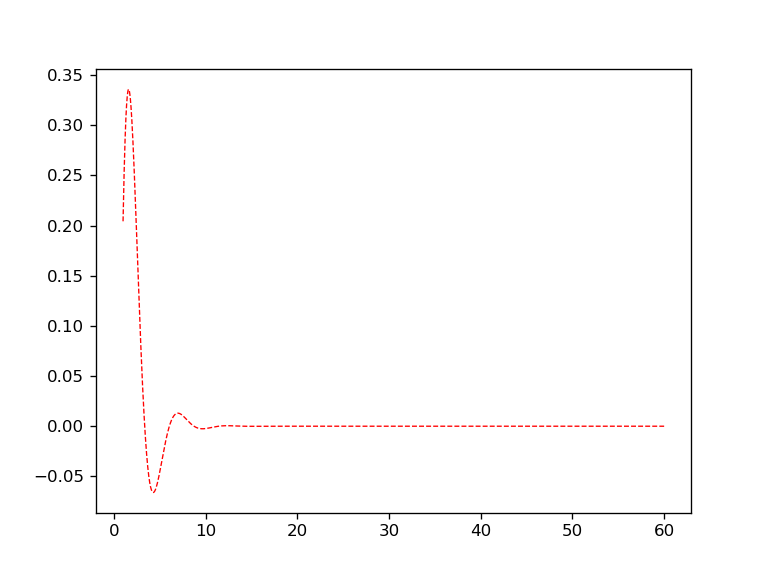

<IPython.core.display.Javascript object>


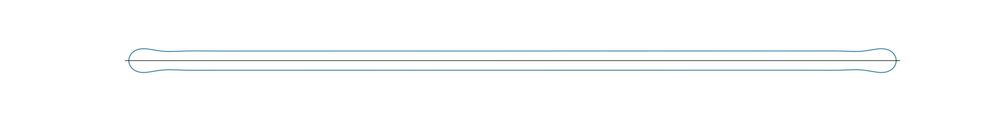

In [150]:
%matplotlib notebook
fig, ax = plt.subplots(figsize=(25,3))
#ax.grid()
j=5
m=3
scale=100

data_path = prolate_data_names[j]
data = np.load(data_path, allow_pickle=True).item()


pz = data['initial']['pz']
P_fur_,Z_fur_ = get_PZ_fur_from_pz_sym(pz)


P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_)
V = np.sqrt(P1**2+Z1**2)
Z/= P[N_int//2]
P/= P[N_int//2]

line_0,= plt.plot(np.hstack([Z[::-1],Z]),np.hstack([-P[::-1],P]),'-')


plt.axhline(0, color='k', lw=1)
ax.axis('off')
ax.axis('scaled')
plt.xlim(Z[0]*(1.01), Z[-1]*(1.01))

plt.savefig('long.png', bbox_inches="tight", pad_inches = 0, dpi=1000, transparent=True)
#ax.set_title(f'$v={Vcal:.2e}$'+'\n'+f'w={w_m.real:.2e}')

<IPython.core.display.Javascript object>


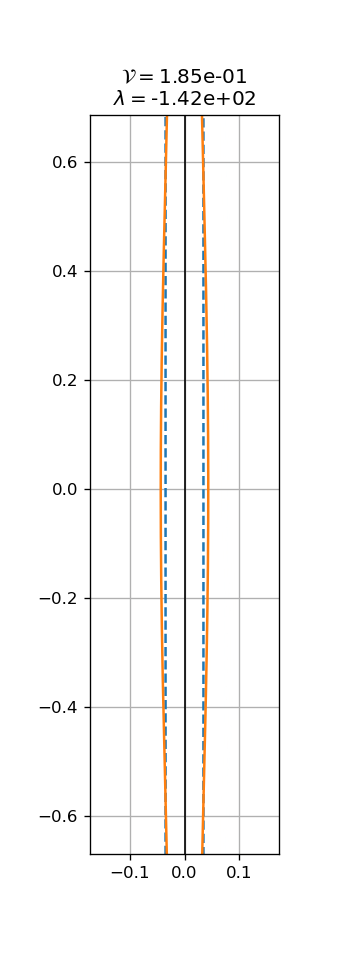

interactive(children=(IntSlider(value=34, description='j', max=69), IntSlider(value=5, description='m', max=10…

In [45]:
%matplotlib notebook
fig, ax = plt.subplots(figsize=(3,8))
ax.grid()
j=-1
m=3
scale=100

data_path = prolate_data_names[Vcal_index_sort[j]]
data = np.load(data_path, allow_pickle=True).item()

Vcal = data['Vcal']
Sqr = data['Sqr']
Sigma = data['Sigma']
Pressure = data['Pressure']

pz = data['initial']['pz']
P_fur_,Z_fur_ = get_PZ_fur_from_pz_sym(pz)


P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_)
V = np.sqrt(P1**2+Z1**2)
l_rho = -Z1/V;l_z = P1/V;
H, force =get_H_force_from_ar(P_fur_,Z_fur_)

J = data['initial']['J']

w,U = sc.linalg.eig(J[:J.shape[1]])

w *= Sqr**(3/2)
w_m = np.sort(w)[::-1][m]
#index_m = np.argmin(np.abs(w - w_m))
index_m, = np.where(np.isclose(w, w_m))

v_m = U[:, index_m].real.reshape(-1)

v_m /= scale
dN = get_int_field(v_m)
#plt.figure()

P_corr = P+l_rho*dN; Z_corr = Z+l_z*dN
line_0,= plt.plot((1/Sqr)**(1/2)*np.hstack([-P[::-1],P]),(1/Sqr)**(1/2)*np.hstack([Z[::-1],Z]),'--')
line_pert,=plt.plot((1/Sqr)**(1/2)*np.hstack([-P_corr[::-1],P_corr]),(1/Sqr)**(1/2)*np.hstack([Z_corr[::-1],Z_corr]))


plt.axvline(0, color='k', lw=1)


ax.axis('scaled')

ax.set_title(f'$v={Vcal:.2e}$'+'\n'+f'w={w_m.real:.2e}')


@interact(j=(0,len(prolate_data_names)-1),m=(0,10), scale=(20,1000,40))
def plot_m_pert(j,m,scale):
    data_path = prolate_data_names[Vcal_index_sort[j]]
    data = np.load(data_path, allow_pickle=True).item()
    
    Vcal = data['Vcal']
    Sqr = data['Sqr']
    Sigma = data['Sigma']
    Pressure = data['Pressure']
    
    pz = data['initial']['pz']
    P_fur_,Z_fur_ = get_PZ_fur_from_pz_sym(pz)
    
    
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_)
    V = np.sqrt(P1**2+Z1**2)
    l_rho = -Z1/V;l_z = P1/V;
    H, force =get_H_force_from_ar(P_fur_,Z_fur_)
    
    
    
    J = data['initial']['J']
    
    
    
    
    w,U = sc.linalg.eig(J[:J.shape[1]])
    
    w *= Sqr**(3/2)
    w_m = np.sort(w[abs(w)>1e-4])[::-1][m]
    #index_m = np.argmin(np.abs(w - w_m))
    index_m, = np.where(np.isclose(w, w_m))
    
    v_m = U[:, index_m].real.reshape(-1)
    #plt.figure()
    #plt.plot(v_m, '.--',label=f'w={w_m.real:.2e}')
    #plt.yscale('symlog', linthresh=1e-4)
    #plt.legend(loc='upper right')
    #plt.grid()
    
    v_m /= scale
    dN = get_int_field(v_m)
    dN *= -dN[0]/np.abs(dN[0])
    #plt.figure()
    
    P_corr = P+l_rho*dN; Z_corr = Z+l_z*dN
    #plt.plot((1/Sqr)**(1/2)*np.hstack([-P[::-1],P]),(1/Sqr)**(1/2)*np.hstack([Z[::-1],Z]),'--')
    #plt.plot((1/Sqr)**(1/2)*np.hstack([-P_corr[::-1],P_corr]),(1/Sqr)**(1/2)*np.hstack([Z_corr[::-1],Z_corr]))
    
    
    line_0.set_ydata((1/Sqr)**(1/2)*np.hstack([Z[::-1],Z]));line_0.set_xdata((1/Sqr)**(1/2)*np.hstack([-P[::-1],P]))
    line_pert.set_ydata((1/Sqr)**(1/2)*np.hstack([Z_corr[::-1],Z_corr]));line_pert.set_xdata((1/Sqr)**(1/2)*np.hstack([-P_corr[::-1],P_corr]))
    ax.set_title( r'$\mathcal{V}=$'+f'{Vcal:.2e}'+'\n'+fr'$\lambda=${w_m.real:.2e}')

In [ ]:
%matplotlib notebook
fig, ax = plt.subplots(figsize=(3,8))
ax.grid()
j=-1
m=3
scale=100

data_path = prolate_data_names[Vcal_index_sort[j]]
data = np.load(data_path, allow_pickle=True).item()

Vcal = data['Vcal']
Sqr = data['Sqr']
Sigma = data['Sigma']
Pressure = data['Pressure']

pz = data['initial']['pz']
P_fur_,Z_fur_ = get_PZ_fur_from_pz_sym(pz)


P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_)
V = np.sqrt(P1**2+Z1**2)
l_rho = -Z1/V;l_z = P1/V;
H, force =get_H_force_from_ar(P_fur_,Z_fur_)

J = data['initial']['J']

w,U = sc.linalg.eig(J[:J.shape[1]])

w *= Sqr**(3/2)
w_m = np.sort(w)[::-1][m]
#index_m = np.argmin(np.abs(w - w_m))
index_m, = np.where(np.isclose(w, w_m))

v_m = U[:, index_m].real.reshape(-1)

v_m /= scale
dN = get_int_field(v_m)
#plt.figure()

P_corr = P+l_rho*dN; Z_corr = Z+l_z*dN
line_0,= plt.plot((1/Sqr)**(1/2)*np.hstack([-P[::-1],P]),(1/Sqr)**(1/2)*np.hstack([Z[::-1],Z]),'--')
line_pert,=plt.plot((1/Sqr)**(1/2)*np.hstack([-P_corr[::-1],P_corr]),(1/Sqr)**(1/2)*np.hstack([Z_corr[::-1],Z_corr]))


plt.axvline(0, color='k', lw=1)


ax.axis('scaled')

ax.set_title(f'$v={Vcal:.2e}$'+'\n'+f'w={w_m.real:.2e}')


@interact(j=(0,len(prolate_data_names)-1),m=(0,10), scale=(20,1000,40))
def plot_m_pert(j,m,scale):
    data_path = prolate_data_names[Vcal_index_sort[j]]
    data = np.load(data_path, allow_pickle=True).item()
    
    Vcal = data['Vcal']
    Sqr = data['Sqr']
    Sigma = data['Sigma']
    Pressure = data['Pressure']
    
    pz = data['initial']['pz']
    P_fur_,Z_fur_ = get_PZ_fur_from_pz_sym(pz)
    
    
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_)
    V = np.sqrt(P1**2+Z1**2)
    l_rho = -Z1/V;l_z = P1/V;
    H, force =get_H_force_from_ar(P_fur_,Z_fur_)
    
    
    
    J = data['initial']['J']
    
    
    
    
    w,U = sc.linalg.eig(J[:J.shape[1]])
    
    w *= Sqr**(3/2)
    w_m = np.sort(w[abs(w)>1e-4])[::-1][m]
    #index_m = np.argmin(np.abs(w - w_m))
    index_m, = np.where(np.isclose(w, w_m))
    
    v_m = U[:, index_m].real.reshape(-1)
    #plt.figure()
    #plt.plot(v_m, '.--',label=f'w={w_m.real:.2e}')
    #plt.yscale('symlog', linthresh=1e-4)
    #plt.legend(loc='upper right')
    #plt.grid()
    
    v_m /= scale
    dN = get_int_field(v_m)
    dN *= -dN[0]/np.abs(dN[0])
    #plt.figure()
    
    P_corr = P+l_rho*dN; Z_corr = Z+l_z*dN
    #plt.plot((1/Sqr)**(1/2)*np.hstack([-P[::-1],P]),(1/Sqr)**(1/2)*np.hstack([Z[::-1],Z]),'--')
    #plt.plot((1/Sqr)**(1/2)*np.hstack([-P_corr[::-1],P_corr]),(1/Sqr)**(1/2)*np.hstack([Z_corr[::-1],Z_corr]))
    
    
    line_0.set_ydata((1/Sqr)**(1/2)*np.hstack([Z[::-1],Z]));line_0.set_xdata((1/Sqr)**(1/2)*np.hstack([-P[::-1],P]))
    line_pert.set_ydata((1/Sqr)**(1/2)*np.hstack([Z_corr[::-1],Z_corr]));line_pert.set_xdata((1/Sqr)**(1/2)*np.hstack([-P_corr[::-1],P_corr]))
    ax.set_title( r'$\mathcal{V}=$'+f'{Vcal:.2e}'+'\n'+fr'$\lambda=${w_m.real:.2e}')

## State analys

In [407]:
w_asym,vr_asym =sc.linalg.eig(jac[1::2,1::2])
np.sort(w_asym)[::-1]

array([ 2.30356618e-06+0.j, -5.89636691e-04+0.j, -9.06466912e-01+0.j,
       -2.81298357e+00+0.j, -6.06672597e+00+0.j, -1.10065980e+01+0.j,
       -1.79792539e+01+0.j, -2.74893954e+01+0.j, -3.97198261e+01+0.j,
       -5.19281213e+01+0.j, -7.10376878e+01+0.j, -1.37264459e+02+0.j,
       -4.43339150e+02+0.j, -1.85983981e+03+0.j, -1.01181862e+04+0.j])

In [367]:
@interact(m=(0,6))
def plot_m_pert_sym(m):
    w_m = np.sort(w_sym)[::-1][m]
    index_m = np.argmin(np.abs(w_sym - w_m))
    v_m = np.real(vr_sym[:, index_m])
    plt.figure()
    plt.plot(v_m, '.--',label=f'w={w_m.real:.2e}')
    
    plt.legend(loc='upper right')
    plt.grid()
    
    delta_norm_fur = np.zeros(N)
    delta_norm_fur[::2]=v_m/50
    normal_delta_P,normal_delta_Z = get_normal_delta_PZ(P_fur_j, Z_fur_j, delta_norm_fur)
    plt.figure()
    plt.plot(P,Z,'--')
    plt.plot(P+normal_delta_P, Z+normal_delta_Z)

interactive(children=(IntSlider(value=3, description='m', max=6), Output()), _dom_classes=('widget-interact',)…

In [408]:
@interact(m=(0,6))
def plot_m_pert_asym(m):
    w_m = np.sort(w_asym)[::-1][m]
    index_m = np.argmin(np.abs(w_asym - w_m))
    v_m = np.real(vr_asym[:, index_m])
    plt.figure()
    plt.plot(v_m, '.--',label=f'w={w_m.real:.2e}')
    
    plt.legend(loc='upper right')
    plt.grid()
    
    delta_norm_fur = np.zeros(N)
    delta_norm_fur[1::2]=v_m/50
    normal_delta_P,normal_delta_Z = get_normal_delta_PZ(P_fur_j, Z_fur_j, delta_norm_fur)
    plt.figure()
    plt.plot(P,Z,'--')
    plt.plot(P+normal_delta_P, Z+normal_delta_Z)

interactive(children=(IntSlider(value=3, description='m', max=6), Output()), _dom_classes=('widget-interact',)…

## Dynamic analys

### Spectrum

In [478]:
len(sol_t)

95

In [348]:
sym_spec_arr =[]
#t_range = np.linspace(0,t_max,50)
asym_spec_arr =[]
t_range = sol_t[::len(sol_t)//50]

t_range = sol_t[::len(sol_t)//50]

for t_j in tqdm(t_range):
    j = np.argmin(np.abs(sol_t-t_j))

    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_y[N//2:,j]
    
    jac_norm_fun = nd.Jacobian(lambda normal_delta_fur:
                            get_normal_velo_normal_delta(P_fur_j, Z_fur_j, normal_delta_fur), step=1e-6)
    jac = jac_norm_fun(np.zeros(N))

    w_sym,vr_sym =sc.linalg.eig(jac[::2,::2])
    sym_spec_arr.append(np.sort(w_sym)[::-1][:4])
    
    w_asym,vr_asym =sc.linalg.eig(jac[1::2,1::2])
    asym_spec_arr.append(np.sort(w_asym)[::-1][:4])
    
sym_spec_arr=np.array(sym_spec_arr)
asym_spec_arr=np.array(asym_spec_arr)

  0%|          | 0/89 [00:00<?, ?it/s]

In [349]:
np.save(f'spec_dyn_bdf_a={a}_to_t={t_max}_N={N}_n_int={n_int}_BDF_atol={atol:.2e}.npy', [sym_spec_arr, asym_spec_arr])

<IPython.core.display.Javascript object>


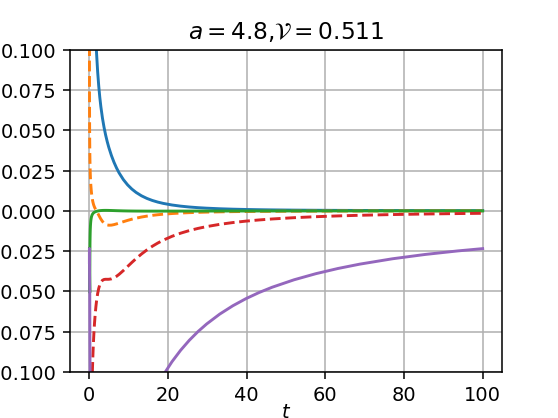

Text(0.5, 1.0, '$a=4.8$,$\\mathcal{V}=$$0.511$')

In [474]:
%matplotlib notebook
plt.figure(figsize=(4,3))
for m in [0,1,2]:
    plt.plot(t_range, sym_spec_arr[:,m])
    plt.plot(t_range, asym_spec_arr[:,m],'--')

#plt.yscale('log')
#plt.plot(t_range,sigma_arr[:,1], label=r'$\sigma_1$')
plt.grid()
#plt.legend()
plt.xlabel(r'$t$', labelpad=-1)
plt.ylabel(r'$\lambda$', labelpad=-1)

#plt.ylabel(r'$z$', labelpad=-1)
#Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
#
plt.ylim(-1e-1,1e-1)
plt.title(fr'$a={a}$,'+r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

<IPython.core.display.Javascript object>


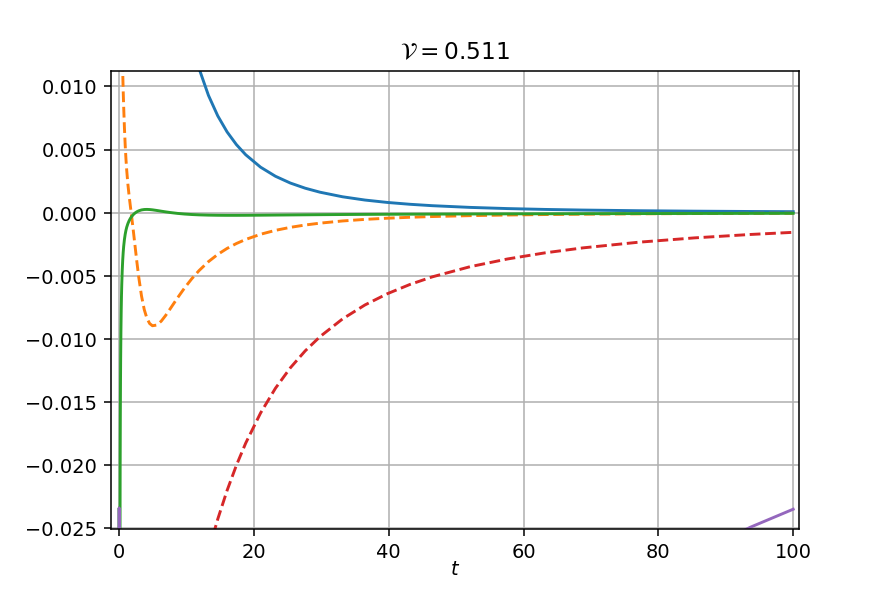

Text(0.5, 1.0, '$\\mathcal{V}=$$0.511$')

In [467]:
%matplotlib notebook
plt.figure()
for m in [0,1,2]:
    plt.plot(t_range, sym_spec_arr[:,m])
    plt.plot(t_range, asym_spec_arr[:,m],'--')

#plt.yscale('log')
#plt.plot(t_range,sigma_arr[:,1], label=r'$\sigma_1$')
plt.grid()
#plt.legend()
plt.xlabel(r'$t$', labelpad=-1)
#plt.ylabel(r'$z$', labelpad=-1)
#Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
#
plt.title(r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

<IPython.core.display.Javascript object>


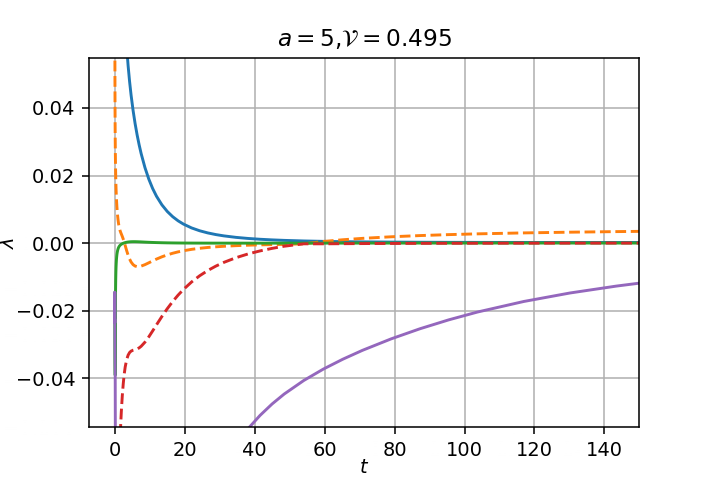

/home/maxkway/anaconda3/lib/python3.8/site-packages/matplotlib/cbook/__init__.py:1369: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


Text(0.5, 1.0, '$a=5$,$\\mathcal{V}=$$0.495$')

In [509]:
%matplotlib notebook
plt.figure(figsize=(4,3))
for m in [0,1,2]:
    plt.plot(t_range, sym_spec_arr[:,m])
    plt.plot(t_range, asym_spec_arr[:,m],'--')

#plt.yscale('log')
#plt.plot(t_range,sigma_arr[:,1], label=r'$\sigma_1$')
plt.grid()
#plt.legend()
plt.xlabel(r'$t$', labelpad=-1)
plt.ylabel(r'$\lambda$', labelpad=-1)

#plt.ylabel(r'$z$', labelpad=-1)
#Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
#
plt.ylim(-1e-1,1e-1)
plt.title(fr'$a={a}$,'+r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')